<a href="https://colab.research.google.com/github/paulandrea0/Curtos-e-fases-ABC/blob/main/Artigo_Andreia_Curtos_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Usar GPU

In [ ]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

D:\Anaconda\python.exe
3.11.7 | packaged by Anaconda, Inc. | (main, Dec 15 2023, 18:05:47) [MSC v.1916 64 bit (AMD64)]
sys.version_info(major=3, minor=11, micro=7, releaselevel='final', serial=0)


In [ ]:
import tensorflow as tf

In [ ]:
gpus = tf.config.list_physical_devices("GPU")
if gpus:
    for gpu in gpus:
        print("Found a GPU with the name:", gpu)
        print("Name:", gpu.name)
else:
    print("Failed to detect a GPU.")

Failed to detect a GPU.


In [ ]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 3491605432864111000
xla_global_id: -1
]


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sat Apr 27 02:19:13 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 551.86                 Driver Version: 551.86         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3050 OEM  WDDM  |   00000000:01:00.0  On |                  N/A |
|  0%   50C    P8              9W /  120W |     629MiB /   8192MiB |      7%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
import platform

# Informações gerais sobre o sistema
print("Sistema Operacional:", platform.system())
print("Versão do Sistema Operacional:", platform.version())

# Informações específicas da CPU
print("Processador:", platform.processor())
print("Arquitetura da CPU:", platform.architecture())

Sistema Operacional: Windows
Versão do Sistema Operacional: 10.0.22631
Processador: Intel64 Family 6 Model 183 Stepping 1, GenuineIntel
Arquitetura da CPU: ('64bit', 'WindowsPE')


In [ ]:
if platform.system() == 'Linux':
    !cat /proc/cpuinfo

## Verificar Memória

In [ ]:
import psutil
import sys

In [ ]:
# Obtém as informações de uso de memória
memory_info = psutil.virtual_memory()

# Exibe o total de memória RAM disponível
print("Total de memória RAM disponível:", memory_info.total / (1024 * 1024), "MB")

# Exibe a quantidade de memória RAM atualmente em uso
print("Memória RAM em uso:", memory_info.used / (1024 * 1024), "MB")

# Obtém uma lista de todos os processos em execução
processos = list(psutil.process_iter())

# Itera sobre os processos e exibe os que estão usando memória
for processo in processos:
    try:
        nome = processo.name() # Nome do processo
        memoria = processo.memory_info().rss / (1024 * 1024) # Memória em MB
        print(f"Processo: {nome}, Memória Utilizada: {memoria:.2f} MB")
    except psutil.AccessDenied:
        # Ignora processos que não podem ser acessados devido a permissões
        pass

Total de memória RAM disponível: 16072.73046875 MB
Memória RAM em uso: 10078.22265625 MB
Processo: System Idle Process, Memória Utilizada: 0.01 MB
Processo: System, Memória Utilizada: 11.74 MB
Processo: , Memória Utilizada: 47.98 MB
Processo: Registry, Memória Utilizada: 48.97 MB
Processo: nvcontainer.exe, Memória Utilizada: 8.43 MB
Processo: uihost.exe, Memória Utilizada: 21.68 MB
Processo: smss.exe, Memória Utilizada: 0.22 MB
Processo: csrss.exe, Memória Utilizada: 3.10 MB
Processo: svchost.exe, Memória Utilizada: 2.85 MB
Processo: HxOutlook.exe, Memória Utilizada: 1.79 MB
Processo: svchost.exe, Memória Utilizada: 4.89 MB
Processo: wininit.exe, Memória Utilizada: 1.09 MB
Processo: csrss.exe, Memória Utilizada: 3.57 MB
Processo: services.exe, Memória Utilizada: 8.12 MB
Processo: LsaIso.exe, Memória Utilizada: 1.44 MB
Processo: lsass.exe, Memória Utilizada: 20.96 MB
Processo: conhost.exe, Memória Utilizada: 1.49 MB
Processo: svchost.exe, Memória Utilizada: 9.23 MB
Processo: svchost.exe

In [ ]:
# Função para listar variáveis e seus tamanhos de memória em MB
def listar_variaveis_mb():
    # Lista de tuplas contendo o nome e o tamanho de cada variável global
    variaveis_mb = [(nome, sys.getsizeof(variavel) / (1024 * 1024)) for nome, variavel in globals().items() if not nome.startswith('_')]

    # Classificar as variáveis em ordem decrescente de tamanho
    variaveis_mb_sorted = sorted(variaveis_mb, key=lambda x: x[1], reverse=True)

    # Imprimir as variáveis e seus tamanhos em MB
    for nome, tamanho_mb in variaveis_mb_sorted:
        print(f'{nome}: {tamanho_mb:.2f} MB')

listar_variaveis_mb()


gpu_info: 0.00 MB
processos: 0.00 MB
In: 0.00 MB
open: 0.00 MB
listar_variaveis_mb: 0.00 MB
memory_info: 0.00 MB
sys: 0.00 MB
tf: 0.00 MB
device_lib: 0.00 MB
platform: 0.00 MB
psutil: 0.00 MB
nome: 0.00 MB
Out: 0.00 MB
get_ipython: 0.00 MB
exit: 0.00 MB
quit: 0.00 MB
gpus: 0.00 MB
processo: 0.00 MB
memoria: 0.00 MB


## Biblioteca/Pacotes

In [18]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.model_selection import StratifiedKFold, cross_val_score, train_test_split, KFold
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef
from sklearn.metrics import roc_curve, roc_auc_score, ConfusionMatrixDisplay, auc, classification_report
from sklearn.utils import shuffle

from imblearn.metrics import specificity_score

from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier

import sys
from itertools import product, combinations
import time
from tqdm import tqdm

import plotly.express as px
from joblib import Parallel, delayed


from sklearn.utils import shuffle, class_weight
from sklearn.ensemble import IsolationForest

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Dense, LeakyReLU
from keras.activations import relu, sigmoid, tanh
import keras.backend as K

from sklearn.preprocessing import OneHotEncoder, LabelEncoder
import cv2

from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier, ExtraTreeClassifier
from sklearn.linear_model import LogisticRegression

In [19]:
import os
import random
import numpy as np
import tensorflow as tf

def set_seed(seed_value):
    """Configura as sementes aleatórias para garantir a reprodutibilidade."""
    os.environ['PYTHONHASHSEED'] = str(seed_value)
    random.seed(seed_value)
    np.random.seed(seed_value)
    tf.random.set_seed(seed_value)

# Defina uma semente específica
seed_value = 42
set_seed(seed_value)

## Modelos

### Funções

#### Testar Varios Modelos AUTOENCODER

In [20]:
class colors:
    RESET = "\033[0m"
    RED = "\033[31m"
    GREEN = "\033[32m"
    YELLOW = "\033[33m"
    BLUE = "\033[34m"
    PURPLE = "\033[35m"
    CYAN = "\033[36m"
    WHITE = "\033[37m"

def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols=columns, sheet_name=sheetname)
    return df

def determine_problem_type(y):
    num_classes = len(np.unique(y))
    return 'binary' if num_classes == 2 else 'multiclass'

def build_autoencoder(params):
    # Parâmetros padrão
    default_params = {
        'input_dim': None,
        'output_dim': None,
        'latent_dim': 32,
        'encoder_layers': [128, 64],
        'decoder_layers': [64, 128],
        'activation': 'relu',
        'optimizer': 'adam',
        'loss': 'mse',
        'metrics': 'mse'
    }

    # Atualiza os parâmetros padrão com os fornecidos
    autoencoder_params = {**default_params, **params}

    # Verifica se input_dim e output_dim foram fornecidos
    if autoencoder_params['input_dim'] is None or autoencoder_params['output_dim'] is None:
        raise ValueError("Os parâmetros input_dim e output_dim são obrigatórios.")

    input_dim = autoencoder_params['input_dim']
    output_dim = autoencoder_params['output_dim']
    latent_dim = autoencoder_params['latent_dim']
    encoder_layers = autoencoder_params['encoder_layers']
    decoder_layers = autoencoder_params['decoder_layers']
    activation = autoencoder_params['activation']
    loss = autoencoder_params['loss']
    metrics = autoencoder_params['metrics']
    optimizer =  autoencoder_params['optimizer']

    input_layer = Input(shape=(input_dim,))
    encoded = input_layer
    for units in encoder_layers:
        encoded = Dense(units, activation=activation)(encoded)
    encoded = Dense(latent_dim, activation=activation)(encoded)
    decoded = encoded
    for units in decoder_layers:
        decoded = Dense(units, activation=activation)(decoded)
    decoded = Dense(output_dim, activation=activation)(decoded)
    autoencoder = Model(input_layer, decoded)
    autoencoder_tranformed = Model(input_layer, encoded)
    autoencoder.compile(optimizer=optimizer, loss=loss, metrics=[metrics])
    return autoencoder, autoencoder_tranformed


def visualize_training_history(history):
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history["loss"], label="Training Loss")
    plt.plot(history.history["val_loss"], label="Validation Loss")
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.plot(history.history["mse"], label="Training MSE")
    plt.plot(history.history["val_mse"], label="Validation MSE")
    plt.xlabel('Epochs')
    plt.legend()
    plt.show()

def autoencoder_transform(X, autoencoder_model, verbose):
    return autoencoder_model.predict(X, verbose=verbose)

def test_model(model, param_grid, X, X_test, y, y_test, problem_type, class_labels, parallel):
    if parallel:
        grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
    else:
        grid_search = GridSearch_simples(model, param_grid, scoring='AUC', cv=5)

    if isinstance(X, pd.DataFrame) and isinstance(X_test, pd.DataFrame):
        X = X.values.astype(np.float32)
        X_test = X_test.values.astype(np.float32)
    if isinstance(y, pd.Series) and isinstance(y_test, pd.Series):
        y = y.values.astype(np.float32)
        y_test = y_test.values.astype(np.float32)

    ini = time.time()
    best_params, best_score, all_results = grid_search.fit(X, y)
    fim = time.time()

    print(f"Tempo de execução Busca em grade: {fim - ini:.2f} segundos")

    print("Best parameters found:", best_params)
    print("Best AUC ROC:", best_score)

    if problem_type == 'binary':
        roc_auc, accuracy, recall, specificity = test_and_evaluate_model_bin(X, y, X_test, y_test, model, class_labels, best_params)
    else:
        roc_auc, accuracy, recall, specificity = test_and_evaluate_model(X, y, X_test, y_test, model, class_labels, best_params)

    return roc_auc, accuracy, recall, specificity

def test_models_scenarios_phases_autoencoder(models, param_grids, file_path, file_path_Normal, columns, columns_to_open_normal, sheet_names, autoencoder_params, parallel=True):
    ini = time.time()
    if 'verbose' not in autoencoder_params:
        autoencoder_params['verbose'] = 0  # Define o valor padrão para 'verbose'

    df_normal = open_file(file_path_Normal, columns_to_open_normal, 0)
    dfs = [open_file(file_path, columns, sheet_name) for sheet_name in sheet_names]

    all_results_Macro = []
    all_results_Micro = []

    for i, df in enumerate(dfs):
        print(colors.GREEN + sheet_names[i] + colors.RESET)
        df.dropna(inplace=True)
        np.set_printoptions(suppress=False)
        grupos_pv = df.groupby('Tipo de GD')
        dataframes_separated = {tipo: grupo for tipo, grupo in grupos_pv}

        max_iterations = len(dfs) * len(models) * len(dataframes_separated)
        print(colors.GREEN + f"Total iterations: {max_iterations}" + colors.RESET)

        for j, (model, param_grid) in enumerate(zip(models, param_grids)):
            for key, df_pv in dataframes_separated.items():

                # Defina uma semente específica
                seed_value = 42
                set_seed(seed_value) #Função criada na seção Bibliotecas/Pacotes

                print(colors.BLUE + "_"*40 + colors.RESET)
                print(colors.BLUE + f"Model: {model} - Dataset {key}:" + colors.RESET)
                df_merged = pd.concat([df_pv, df_normal], ignore_index=True)

                if sheet_names[i] == 'Curto-Monofásico':
                    fases_array = df_merged[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()
                    indices_max = np.argmax(fases_array, axis=1)
                    indices_max[fases_array.max(axis=1) != 1] = -1
                    df_merged['Classe'] = indices_max + 1

                if sheet_names[i] == 'Curto-Bifásico':
                    mapping = {'Normal': 0, 'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
                    df_merged['Classe'] = df_merged['Curto'].str.strip().replace(mapping)

                if sheet_names[i] == 'Curto-Trifásico':
                    mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
                    df_merged['Classe'] = df_merged['Curto'].str.strip().replace(mapping)

                X_train, X_test, y_train, y_test = train_test_split(df_merged[['Med_A', 'Med_B', 'Med_C']], df_merged['Classe'], test_size=0.3, random_state=43, stratify=df_merged['Classe'])

                problem_type = determine_problem_type(y_train)

                if sheet_names[i] == 'Curto-Monofásico':
                    class_labels = ["Normal","Fase A", "Fase B", "Fase C"]
                elif sheet_names[i] == 'Curto-Bifásico':
                    class_labels = ["Normal", "AC", "BC", "AB"]
                elif sheet_names[i] == 'Curto-Trifásico':
                    class_labels = ["Normal", "ABC"]


                # Separa os dados em treino e teste, estratificando a amostra
                X_train_valid, X_valid, y_train_valid, y_valid = train_test_split(X_train, y_train,
                                                                    test_size=0.3, random_state=43,
                                                                    stratify=y_train)

                autoencoder_params['input_dim'] = X_train_valid.shape[1]
                autoencoder_params['output_dim'] = X_train_valid.shape[1]

                K.clear_session()

                autoencoder, autoencoder_tranformed = build_autoencoder(autoencoder_params)
                autoencoder.summary()
                history = autoencoder.fit(X_train_valid, X_train_valid, epochs=autoencoder_params['epochs'],
                                          batch_size=autoencoder_params['batch_size'], shuffle=True,
                                          validation_data=(X_valid, X_valid), verbose=autoencoder_params['verbose'])
                visualize_training_history(history)

                X_train_encoded = autoencoder_transform(X_train, autoencoder_tranformed, verbose=autoencoder_params['verbose'])
                X_test_encoded = autoencoder_transform(X_test, autoencoder_tranformed, verbose=autoencoder_params['verbose'])

                roc_auc, accuracy, recall, specificity = test_model(model, param_grid, X_train_encoded, X_test_encoded, y_train, y_test, problem_type, class_labels, parallel)

                del autoencoder, autoencoder_tranformed
                K.clear_session()

                print(" ")
                print(" ")
                print(" ")

                if problem_type == 'binary':
                    all_results_Macro.append((roc_auc, accuracy, recall, specificity))
                    all_results_Micro.append((roc_auc, accuracy, recall, specificity))
                else:
                    all_results_Macro.append((roc_auc[0], accuracy, recall[0], specificity[0]))
                    all_results_Micro.append((roc_auc[1], accuracy, recall[1], specificity[1]))

    # Calcula a média de todas as métricas
    mean_roc_auc_macro = np.mean([result[0] for result in all_results_Macro])
    mean_roc_auc_micro = np.mean([result[0] for result in all_results_Micro])
    mean_accuracy = np.mean([result[1] for result in all_results_Macro])
    mean_recall_macro = np.mean([result[2] for result in all_results_Macro])
    mean_recall_micro = np.mean([result[2] for result in all_results_Micro])
    mean_specificity_macro = np.mean([result[3] for result in all_results_Macro])
    mean_specificity_micro = np.mean([result[3] for result in all_results_Micro])

    print(f"ROC AUC média (macro) de todas as iterações: {mean_roc_auc_macro}")
    print(f"ROC AUC média (micro) de todas as iterações: {mean_roc_auc_micro}")
    print(f"Acurácia média de todas as iterações: {mean_accuracy}")
    print(f"Recall médio (macro) de todas as iterações: {mean_recall_macro}")
    print(f"Recall médio (micro) de todas as iterações: {mean_recall_micro}")
    print(f"Especificidade média (macro) de todas as iterações: {mean_specificity_macro}")
    print(f"Especificidade média (micro) de todas as iterações: {mean_specificity_micro}")

    fim = time.time()
    print(' ')
    print(colors.RED + '#'*60 + colors.RESET)
    print(colors.RED + f"Tempo de execução Total: {fim - ini:.4f} segundos" + colors.RESET)

#### Testar Varios Modelos

In [21]:
def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols=columns, sheet_name=sheetname)
    return df

def determine_problem_type(y):
    num_classes = len(np.unique(y))
    return 'binary' if num_classes == 2 else 'multiclass'

def test_model(model, param_grid, X, X_test, y, y_test, problem_type, class_labels, parallel):
    if parallel:
        grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
    else:
        grid_search = GridSearch_simples(model, param_grid, scoring='AUC', cv=5)

    if isinstance(X, pd.DataFrame) and isinstance(X_test, pd.DataFrame):
        X = X.values
        X_test = X_test.values
    if isinstance(y, pd.Series) and isinstance(y_test, pd.Series):
        y = y.values
        y_test = y_test.values

    ini = time.time()
    best_params, best_score, all_results = grid_search.fit(X, y)
    fim = time.time()

    print(f"Tempo de execução Busca em grade: {fim - ini:.2f} segundos")

    print("Best parameters found:", best_params)
    print("Best AUC ROC:", best_score)

    if problem_type == 'binary':
        roc_auc, accuracy, recall, specificity = test_and_evaluate_model_bin(X, y, X_test, y_test, model, class_labels, best_params)
    else:
        roc_auc, accuracy, recall, specificity = test_and_evaluate_model(X, y, X_test, y_test, model, class_labels, best_params)

    return roc_auc, accuracy, recall, specificity

def test_models_cenarios_fases(modelos, param_grids, file_path, file_path_Normal, columns, columns_to_open_normal,
                               sheet_names, parallel = True):
    iterações = 0
    df_normal = open_file(file_path_Normal, columns_to_open_normal, 0)

    dfs = [open_file(file_path, columns, sheet_name) for sheet_name in sheet_names]


    for i, df in enumerate(dfs):
        print(sheet_names[i])
        df.dropna(inplace=True)
        np.set_printoptions(suppress=False)
        grupos_pv = df.groupby('Tipo de GD')
        dataframes_separados = {}
        for tipo, grupo in grupos_pv:
            dataframes_separados[tipo] = grupo

        max_iteracoes = len(dfs) * len(modelos) * len(dataframes_separados)
        print(f"Total de iterações: {max_iteracoes}")

        for j, (modelo, param_grid) in enumerate(zip(modelos, param_grids)):
            for key, df_pv in dataframes_separados.items():
                print("_"*40)
                print(f"Modelo: {modelo} - Conjunto de dados {key}:")
                df_merged = pd.concat([df_pv, df_normal], ignore_index=True)

                if sheet_names[i] == 'Curto-Monofásico':
                    # Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
                    fases_array = df_merged[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

                    # Encontra o índice do máximo apenas se o máximo for igual a 1
                    indices_max = np.argmax(fases_array, axis=1)
                    indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

                    # Adiciona a coluna 'Classe' ao DataFrame com base nos índices encontrados
                    df_merged['Classe'] = indices_max + 1

                if sheet_names[i] == 'Curto-Bifásico':
                    mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
                    df_merged['Classe'] = df_merged['Curto'].str.strip().replace(mapping)

                if sheet_names[i] == 'Curto-Trifásico':
                    mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
                    df_merged['Classe'] = df_merged['Curto'].str.strip().replace(mapping)

                X_train, X_test, y_train, y_test = train_test_split(df_merged[['Med_A', 'Med_B', 'Med_C']],
                                                                    df_merged['Classe'], test_size=0.3,
                                                                    random_state=43, stratify=df_merged['Classe'])

                problem_type = determine_problem_type(y_train)

                if sheet_names[i] == 'Curto-Monofásico':
                    class_labels = ["Normal","Fase A", "Fase B", "Fase C"]
                elif sheet_names[i] == 'Curto-Bifásico':
                    class_labels = ["Normal", "AC", "BC", "AB"]
                elif sheet_names[i] == 'Curto-Trifásico':
                    class_labels = ["Normal", "ABC"]


                roc_auc, accuracy, recall, specificity = test_model(modelo, param_grid, X_train.values, X_test.values, y_train.values, y_test.values,
                           problem_type, class_labels, parallel)

                if problem_type == 'binary':
                    all_results_Macro.append((roc_auc, accuracy, recall, specificity))
                    all_results_Micro.append((roc_auc, accuracy, recall, specificity))
                else:
                    all_results_Macro.append((roc_auc[0], accuracy, recall[0], specificity[0]))
                    all_results_Micro.append((roc_auc[1], accuracy, recall[1], specificity[1]))

    # Calcula a média de todas as métricas
    mean_roc_auc_macro = np.mean([result[0] for result in all_results_Macro])
    mean_roc_auc_micro = np.mean([result[0] for result in all_results_Micro])
    mean_accuracy = np.mean([result[1] for result in all_results_Macro])
    mean_recall_macro = np.mean([result[2] for result in all_results_Macro])
    mean_recall_micro = np.mean([result[2] for result in all_results_Micro])
    mean_specificity_macro = np.mean([result[3] for result in all_results_Macro])
    mean_specificity_micro = np.mean([result[3] for result in all_results_Micro])

    print(f"ROC AUC média (macro) de todas as iterações: {mean_roc_auc_macro}")
    print(f"ROC AUC média (micro) de todas as iterações: {mean_roc_auc_micro}")
    print(f"Acurácia média de todas as iterações: {mean_accuracy}")
    print(f"Recall médio (macro) de todas as iterações: {mean_recall_macro}")
    print(f"Recall médio (micro) de todas as iterações: {mean_recall_micro}")
    print(f"Especificidade média (macro) de todas as iterações: {mean_specificity_macro}")
    print(f"Especificidade média (micro) de todas as iterações: {mean_specificity_micro}")

#### Funções de teste binárias

In [22]:
def train_and_evaluate_model_bin(X, y, model, class_labels, best_params, k=5, lw=1):
    attribute_colors = sns.color_palette("mako", k)

    # inicializar a lista para armazenar os tempos de treinamento
    training_times = []

    # Inicializar listas vazias para armazenar taxas de falsos positivos e verdadeiros positivos de cada classe
    all_fpr = []
    all_tpr = []
    all_roc_auc = []

    tprs = []
    mean_fpr = np.linspace(0, 1, 100)

    # Criar o objeto para realizar a validação cruzada k-fold estratificado
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

    # Loop para treinar e avaliar o modelo em cada fold
    for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X, y)):

        # Separa os dados de treino e teste
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]

        # Codificar variável de destino em formato one-hot
        label_encoder = LabelEncoder()
        y_train_encoded = to_categorical(label_encoder.fit_transform(y_train))
        y_test_encoded = to_categorical(label_encoder.transform(y_test))

        # armazenar o tempo de início do treinamento
        start_time = time.time()

        model_instance = model(**best_params)
        model_instance.fit(np.array(X_train), y_train_encoded)

        # armazenar o tempo de fim do treinamento
        end_time = time.time()

        # calcular o tempo de treinamento em segundos
        training_time = end_time - start_time

        # armazenar o tempo de treinamento na lista
        training_times.append(training_time)

        y_proba = model_instance.predict_proba(np.array(X_test))

        y_pred = np.argmax(y_proba, axis=1)
        y_test = np.argmax(y_test_encoded, axis=1)

        # Calcular métricas de avaliação
        cm = confusion_matrix(y_test, y_pred)
        acc = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        mcc = matthews_corrcoef(y_test, y_pred)

        # Plotar a matriz de confusão
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
        disp.plot(cmap=sns.color_palette("mako", as_cmap=True), values_format='d')
        plt.title(f'Fold {fold_idx + 1} - Matriz de Confusão')
        plt.xlabel('Classe Predita')
        plt.ylabel('Classe Real')
        plt.show()

        # Exibir informações sobre os dados de treino e teste do fold atual
        print(f"Fold {fold_idx + 1}: {len(X_train)} Amostras de Treino ({len(np.where(y_train == 0)[0])} Controle (0) e {len(np.where(y_train == 1)[0])} Cancer (1))")
        print(f"Fold {fold_idx + 1}: {len(X_test)} Amostras de Teste ({len(np.where(y_test == 0)[0])} Controle (0) e {len(np.where(y_test == 1)[0])} Cancer (1))")

        # Exibir informações sobre os dados de treino e teste do fold atual
        score_auc = roc_auc_score(y_test_encoded, y_proba, average='macro', multi_class='ovo')

        # Exibir métricas de avaliação
        print(f"Fold {fold_idx + 1}: Acurácia = {acc:.4f}")
        print(f"Fold {fold_idx + 1}: Precisão = {precision:.4f}")
        print(f"Fold {fold_idx + 1}: Sensibilidade = {recall:.4f}")
        print(f"Fold {fold_idx + 1}: F-score = {f1:.4f}")
        print(f"Fold {fold_idx + 1}: Coeficiente de Correlação de Matthews = {mcc:.4f}")
        print(f"Fold {fold_idx + 1}: AUC = {score_auc:.4f}")
        print('#' * 60)

        # Calcula a curva ROC e a AUC para cada classe
        fpr, tpr, _ = roc_curve(y_test_encoded[:, 1], y_proba[:, 1])
        roc_auc = auc(fpr, tpr)

        interp_tpr = np.interp(mean_fpr, fpr, tpr)
        interp_tpr[0] = 0.0
        tprs.append(interp_tpr)

        # Armazenar taxas de falsos positivos, verdadeiros positivos e AUC
        all_fpr.append(fpr)
        all_tpr.append(tpr)
        all_roc_auc.append(roc_auc)
        print('#' * 60)

    # Plotar todas as curvas ROC em um único gráfico
    fig, ax = plt.subplots(figsize=(7, 4))
    for i in range(len(all_fpr)):
        plt.plot(all_fpr[i], all_tpr[i], lw=lw, color=attribute_colors[i],
                 alpha=0.4,
                 label=f'ROC Fold {i+1} (AUC = {all_roc_auc[i]:0.4f})')

    # Calcular a média das áreas sob as curvas ROC (AUC) e o desvio padrão
    mean_auc = np.mean(all_roc_auc)
    #mean_auc = auc(mean_fpr, mean_tpr)
    std_auc = np.std(all_roc_auc)

    mean_tpr = np.mean(tprs, axis=0)
    mean_tpr[-1] = 1.0

    ax.plot(
        mean_fpr,
        mean_tpr,
        color="darkblue",
        label=r"ROC média (AUC = %0.4f $\pm$ %0.4f)" % (mean_auc, std_auc),
        lw=1.5,
        alpha=0.8,
    )

    std_tpr = np.std(tprs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)

    ax.fill_between(
        mean_fpr,
        tprs_lower,
        tprs_upper,
        color="grey",
        alpha=0.2,
        label=r"$\pm$ 1 Standard deviation",
    )

    # Plotar a curva ROC média
    plt.plot([0, 1], [0, 1], color='red', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('1 - Especificidade')
    plt.ylabel('Sensibilidade')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    #plt.legend(fontsize = 12)

    plt.show()


In [23]:
def test_and_evaluate_model_bin(X_train, y_train, X_test, y_test0, model, class_labels, best_params):
    # Obter a paleta de cores do cmap 'mako' do Seaborn
    attribute_colors = sns.color_palette("mako", len(class_labels))

    # Definir o modelo com os parâmetros dados
    model_instance = model(**best_params)
    # Tempo de treinamento
    start_time_training = time.time()
    model_instance.fit(np.array(X_train), y_train)
    training_time = time.time() - start_time_training

    # Tempo de previsão
    start_time_prediction = time.time()
    predicted_labels = model_instance.predict(np.array(X_test))
    prediction_time = time.time() - start_time_prediction

    # Probabilidades previstas
    predicted_probabilities = model_instance.predict_proba(np.array(X_test))

    # Calcular métricas de avaliação
    accuracy = accuracy_score(y_test0, predicted_labels)
    cm = confusion_matrix(y_test0, predicted_labels)
    precision = precision_score(y_test0, predicted_labels)
    recall = recall_score(y_test0, predicted_labels)
    specificity = specificity_score(y_test0, predicted_labels)
    f1 = f1_score(y_test0, predicted_labels)
    mcc = matthews_corrcoef(y_test0, predicted_labels)
    score_auc = roc_auc_score(y_test0, predicted_probabilities[:,1])
    y_test1 = to_categorical(y_test0)

    print(f"Tempo de Treinamento: {training_time:.4f} segundos")
    print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
    print(f"Acurácia = {accuracy:.4f}")
    print(f"Precisão = {precision:.4f}")
    print(f"Sensibilidade = {recall:.4f}")
    print(f"Especificidade = {specificity:.4f}")
    print(f"F-score = {f1:.4f}")
    print(f"Coeficiente de Correlação de Matthews = {mcc:.4f}")
    print(f"AUC = {score_auc:.4f}")
    print('#' * 60)

    # Plotar a matriz de confusão
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
    disp.plot(cmap=sns.color_palette("mako", as_cmap=True), values_format='d')
    plt.title('Matriz de Confusão')
    plt.xlabel('Classe Predita')
    plt.ylabel('Classe Real')
    plt.show()

    # Calcular a curva ROC
    fpr, tpr, _ = roc_curve(y_test1[:, 1], predicted_probabilities[:, 1])
    roc_auc = auc(fpr, tpr)

    # Plotar a curva ROC
    plt.figure(figsize = (7,6))
    plt.plot(fpr, tpr, color='darkblue', lw=1.5,
             label='Curva ROC (AUC = %0.4f)' % roc_auc)

    plt.plot([0, 1], [0, 1], color='red', lw=1, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('1 - Especificidade', size = 15)
    plt.ylabel('Sensibilidade', size = 15)
    plt.legend(loc="lower right", fontsize = 13)

    plt.tick_params(labelsize=15)
    plt.show()
    return roc_auc, accuracy, recall, specificity

#### Funções de teste Multiclasse

In [24]:
def train_and_evaluate_model(X, y, model, class_labels, best_params, k=5, lw=1):
    attribute_colors = sns.color_palette("mako", len(class_labels))
    training_times = []
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

    for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X, y)):
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]

        label_encoder = LabelEncoder()
        y_train_encoded = to_categorical(label_encoder.fit_transform(y_train))
        y_test_encoded = to_categorical(label_encoder.transform(y_test))

        model_instance = model(**best_params)
        start_time = time.time()
        model_instance.fit(np.array(X_train), y_train_encoded)
        end_time = time.time()
        training_time = end_time - start_time
        training_times.append(training_time)

        y_proba = model_instance.predict_proba(np.array(X_test))
        y_pred = np.argmax(y_proba, axis=1)
        y_test = np.argmax(y_test_encoded, axis=1)

        Acc = accuracy_score(y_test, y_pred)
        cm = confusion_matrix(y_test, y_pred)
        print(f"Fold {fold_idx + 1}: {len(X_train)} Amostras de Treino ({len(np.where(y_train == 0)[0])} Controle (0) e {len(np.where(y_train == 1)[0])} Benigno (1) e {len(np.where(y_train == 2)[0])} Cancer (2))")
        print(f"Fold {fold_idx + 1}: {len(X_test)} Amostras de Teste ({len(np.where(y_test == 0)[0])} Controle (0) e {len(np.where(y_test == 1)[0])} Benigno (1) e {len(np.where(y_test == 2)[0])} Cancer (2))")
        print(f"Fold {fold_idx + 1}: Acurácia = {Acc:.4f}")
        score_auc = roc_auc_score(y_test_encoded, y_proba, average='macro', multi_class='ovo')
        print(f"Fold {fold_idx + 1}: AUC = {score_auc:.4f}")

        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        for i in range(len(label_encoder.classes_)):
            fpr[i], tpr[i], _ = roc_curve(y_test_encoded[:, i], y_proba[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        plt.figure()
        for i in range(len(class_labels)):
            plt.plot(fpr[i], tpr[i], lw=lw,
                     label='Curva ROC classe "{0}" (AUC = {1:0.4f})'
                     ''.format(class_labels[i], roc_auc[i]), color=attribute_colors[i])

        plt.plot([0, 1], [0, 1], color='red', lw=lw, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('1 - Especificidade', size=12)
        plt.ylabel('Sensibilidade', size=12)
        plt.legend(loc="lower right", fontsize=12)
        plt.tick_params(labelsize=12)
        plt.show()
        print('#'*60)

    # return training_times

In [25]:
def test_and_evaluate_model(X_train, y_train, X_test, y_test, model, class_labels, best_params):
    attribute_colors = sns.color_palette("mako", len(class_labels))

    model_instance = model(**best_params)
    start_time_training = time.time()
    model_instance.fit(np.array(X_train), y_train)
    training_time = time.time() - start_time_training

    start_time_prediction = time.time()
    predicted_labels = model_instance.predict(np.array(X_test))
    prediction_time = time.time() - start_time_prediction

    predicted_probabilities = model_instance.predict_proba(np.array(X_test))

    accuracy = accuracy_score(y_test, predicted_labels)
    auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

    y_test_encoded = to_categorical(y_test)

    recall_macro = recall_score(y_test, predicted_labels, average='macro')
    recall_micro = recall_score(y_test, predicted_labels, average='micro')
    specificity_macro = specificity_score(y_test, predicted_labels, average='macro')
    specificity_micro = specificity_score(y_test, predicted_labels, average='micro')

    print(f"Tempo de Treinamento: {training_time:.4f} segundos")
    print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
    print(f"Acurácia: {accuracy * 100:.8f}%")
    print(f"Sensitivity (Recall) Macro:{recall_macro:.4f}")
    print(f"Sensitivity (Recall) Micro: {recall_micro:.4f}")
    print(f"Especificidade (specificity) macro: {specificity_macro:.4f}")
    print(f"Especificidade (specificity) micro: {specificity_micro:.4f}")
    print(f"AUC: {auc_macro:.4f}")

    # Calculate Sensitivity, Specificity, and F-score for each class manually
    conf_matrix = confusion_matrix(y_test, predicted_labels)
    print('Matriz de Confusão')
    print(conf_matrix)

    num_classes = len(conf_matrix)

    macro_f_score = 0

    for i in range(num_classes):
        TP = conf_matrix[i, i]
        FP = np.sum(conf_matrix[:, i]) - TP
        FN = np.sum(conf_matrix[i, :]) - TP
        TN = np.sum(conf_matrix) - TP - FP - FN

        sensitivity = TP / (TP + FN)
        specificity = TN / (TN + FP)
        f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

        macro_f_score += f_score

        print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")


    macro_f_score /= num_classes

    print(f"Macro F-score: {macro_f_score:.4f}")


    fpr_micro, tpr_micro, _ = roc_curve(y_test_encoded.ravel(), predicted_probabilities.ravel())
    roc_auc_micro = auc(fpr_micro, tpr_micro)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(len(class_labels)):
        fpr[i], tpr[i], _ = roc_curve(y_test_encoded[:, i], predicted_probabilities[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fpr_grid = np.linspace(0.0, 1.0, 1000)

    mean_tpr = np.zeros_like(fpr_grid)

    for i in range(len(class_labels)):
        mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])

    mean_tpr /= len(class_labels)

    fpr_macro = fpr_grid
    tpr_macro = mean_tpr
    roc_auc_macro = auc(fpr_macro, tpr_macro)

    plt.figure(figsize=(7, 6))
    for i in range(len(class_labels)):
        plt.plot(fpr[i], tpr[i], lw=1,
                 label='Curva ROC classe "{0}" (AUC = {1:0.4f})'
                 ''.format(class_labels[i], roc_auc[i]), color=attribute_colors[i])

    plt.plot(fpr_macro, tpr_macro, color='deeppink', linestyle=":", linewidth=2,
             label=f'Curva ROC macro (AUC = {roc_auc_macro:0.4f})')
    plt.plot(fpr_micro, tpr_micro, color='navy', linestyle=":", linewidth=2,
             label=f'Curva ROC micro (AUC = {roc_auc_micro:0.4f})')
    plt.plot([0, 1], [0, 1], color='black', lw=1, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('1 - Especificidade', size=15)
    plt.ylabel('Sensibilidade', size=15)
    plt.legend(loc="lower right", fontsize=13)
    plt.tick_params(labelsize=15)

    # plt.savefig(f'(ROC)_Teste_(Classificação_3_Classes)(com_CA19-9).pdf', format='pdf', bbox_inches="tight")
    plt.show()

    # roc_auc_list = [roc_auc_macro, roc_auc_micro]
    # recall_list = [recall_macro, recall_micro]
    # specificity_list = [specificity_macro, specificity_micro]

    # return  roc_auc_list, accuracy, recall_list, specificity_list
    return [roc_auc_macro, roc_auc_micro], accuracy, [recall_macro, recall_micro], [specificity_macro, specificity_micro]

#### Funções Rede ART

In [26]:
def to_categorical(y, num_classes=None, dtype="float32"):
    y = np.array(y, dtype="int")
    input_shape = y.shape

    if input_shape and input_shape[-1] == 1 and len(input_shape) > 1:
        input_shape = tuple(input_shape[:-1])

    y = y.reshape(-1)
    if not num_classes:
        num_classes = np.max(y) + 1
    n = y.shape[0]
    categorical = np.zeros((n, num_classes), dtype=dtype)
    categorical[np.arange(n), y] = 1
    output_shape = input_shape + (num_classes,)
    categorical = np.reshape(categorical, output_shape)
    return categorical

In [27]:
def check_parameter_range(value, name, min_val, max_val):
    if not min_val <= value <= max_val:
        raise ValueError(f"The parameter {name} must be between {min_val} and {max_val}.")

In [28]:
def check_metric(metric, ord_minkowski):
    if ord_minkowski < 1:
        raise ValueError("The parameter ord_minkowski must be greater than or equal to 1 for valid distance metric.")

    if metric not in ['euclidean', 'manhattan', 'minkowski']:
        raise ValueError("Invalid distance type. Choose either 'euclidean', 'manhattan', or 'minkowski'.")

    if metric == 'manhattan' and ord_minkowski != 1:
        raise ValueError("When using the Manhattan distance metric, ord_minkowski must be 1.")

    if metric == 'euclidean' and ord_minkowski != 2:
        raise ValueError("When using the Euclidean distance metric, ord_minkowski must be 2.")

    if metric == 'minkowski' and ord_minkowski in [1, 2]:
        raise ValueError("When using the 'minkowski' distance metric, ord_minkowski cannot be 1 or 2. Please choose between 'manhattan' (1) or 'euclidean' (2) for metric.")


In [29]:
def randomize_data(x, y):
    indices = np.arange(len(x))
    np.random.shuffle(indices)
    return x[indices], y[indices]

#### Rede ART Euclidiana

In [30]:
class ART_Minkowski_AE_Classifier:
    def __init__(self, beta= 0.2, rho=0.095, metric='euclidean', ord_minkowski = 2):

        check_parameter_range(beta, 'beta', 0, 1)
        check_parameter_range(rho, 'rho', 0, 1)
        check_metric(metric, ord_minkowski)

        self.beta = beta
        self.rho = rho
        self.weights = None
        self.ord_minkowski = ord_minkowski
        self.metric = metric

    def adjusted_metric(self):
        if self.metric == "euclidean":
            self.ord_minkowski = 2
        elif self.metric == "manhattan":
            self.ord_minkowski = 1
        elif self.metric == "minkowski":
            pass

    def check_categorical_labels(self, y):
        if len(y.shape) == 1 or y.shape[1] == 1:
            y = to_categorical(y)
            is_categorical = False
        else:
            is_categorical = True
        return y, is_categorical

    def _update_aux_labels(self, labels):
        lines_sum = np.sum(labels, axis=1)
        self.aux_labels_ = np.divide(labels.T, lines_sum).T
        self.labels_ = np.eye(labels.shape[1])[np.argmax(self.aux_labels_, axis=1)]

    def initialization(self, a, y):
        self.weights = np.array([a[0]]).astype(float)
        self.nCategories = 1
        self.target = np.zeros((1,len(y[0])))
        self.target[0] += y[0]

    def ressonance(self, Ic, T, y):
        indices = np.argsort(T.flatten())
        index = 0
        mismatch_flag = True
        while index < self.nCategories:
            bmu = indices[index]
            index += 1
            if self.similarity(Ic, bmu) < self.rho:
                self.learn(Ic, bmu)
                mismatch_flag = False
                self.target[bmu] += y
                return bmu, mismatch_flag
        else:
            bmu = self.create_cluster(Ic, y, mismatch_flag)
            return bmu, mismatch_flag

    def create_cluster(self, Ic, y, mismatch_flag):
        if mismatch_flag:
            self.weights = np.vstack([self.weights, Ic])
            bmu = self.nCategories
            self.nCategories += 1
            self.target = np.vstack((self.target, np.zeros(len(y))))
            self.target[bmu] += y
        return bmu

    def choice_function(self, Ic):
        T = np.linalg.norm(Ic - self.weights, ord = self.ord_minkowski, axis = 1)
        return T

    def similarity(self, Ic, index):
        numerator = np.linalg.norm(Ic - self.weights[index], ord= self.ord_minkowski)
        return numerator / max(np.linalg.norm(Ic, ord = self.ord_minkowski),  np.linalg.norm(self.weights[index], ord = self.ord_minkowski))

    def _update_mapping(self, Y, i, index, mismatch_flag): #Faz o mpeamento de quais amostras estao dentro de cada cluster
        if mismatch_flag:
            Y = np.hstack((Y, np.zeros((len(Y), 1))))
        Y[i][index] = 1
        return Y

    def learn(self, Ic, index):
        self.weights[index, :] = self.beta * Ic + (1 - self.beta) * self.weights[index, :]

    def check_stop_condition(self, x, y, tolerance, max_epochs):
        error = self.calculate_error(x, y)
        if tolerance is None:
            if self.Epoch >= max_epochs:
                return True, "Maximum number of epochs reached."
            else:
                return False, ""
        else:
            if error < tolerance:
                return True, f"Error is below tolerance: {error}"
            elif self.Epoch >= max_epochs:
                return True, "Maximum number of epochs reached."
            else:
                return False, ""

    def calculate_error(self, x, y):
        prob = self.predict_proba(x, verbose = False)
        return self.cross_entropy_loss_function(y, prob)

    def cross_entropy_loss_function(self, Y, P):
        epsilon = 1e-10
        loss = -np.mean(np.sum(Y * np.log(P + epsilon), axis=1))
        return loss

    def process_sample(self, x, y, linha, n_samples, ini, max_epochs, verbose):
        T = self.choice_function(x[linha])
        bmu, mismatch_flag = self.ressonance(x[linha], T, y[linha])
        if verbose:
            progbar(linha, n_samples, ini, self.Epoch, max_epochs)

    def fit(self, x, y=None, max_epochs=1, tol=None, verbose=False):
        self.adjusted_metric()
        y, is_categorical = self.check_categorical_labels(y)

        self.initialization(x, y)
        n_samples, self.dim = x.shape
        self.Epoch = 0
        while True:
            ini = time.time()
            self.Epoch += 1
            linha = 1
            while linha < n_samples:
                self.process_sample(x, y, linha, n_samples, ini, max_epochs, verbose)
                linha += 1

            self._update_aux_labels(self.target)
            stop, stop_message = self.check_stop_condition(x, y, tol, max_epochs)
            if stop:
                if verbose:
                    print(stop_message)
                break
            x, y = randomize_data(x, y)
        if not is_categorical:
            self.labels_ = np.argmax(self.labels_, axis=1)
        return self

    def predict(self, X, verbose = False):
        ini = time.time()
        n_samples = X.shape[0]
        predictions = [
            self.labels_[np.argsort(self.choice_function(X[linha]).flatten())[0]]
            for linha in range(n_samples)
        ]
        if verbose:
            #print('%0.3f Segundos' % (time.time() - ini))
            progbar(linha, n_samples, ini, verbose=verbose)
        return np.array(predictions)

    def predict_proba(self, X, verbose=False):
        ini = time.time()
        n_samples = X.shape[0]

        probabilities = [
            self.aux_labels_[np.argsort(self.choice_function(X[linha]).flatten())[0]]
            for linha in range(n_samples)
        ]
        if verbose:
            #print('%0.3f Segundos' % (time.time() - ini))
            progbar(linha, n_samples, ini, verbose=verbose)
        return np.array(probabilities)

#### Rede ART Fuzzy

In [31]:
class ART_Fuzzy_AE_Classifier:
    def __init__(self, beta=0.2, rho=0.92, alpha=0.05):
        check_parameter_range(beta, 'beta', 0, 1)
        check_parameter_range(rho, 'rho', 0, 1)
        check_parameter_range(alpha, 'alpha', 0, float('inf'))

        self.beta = beta
        self.rho = rho
        self.alpha = alpha
        self.weights = None

    def normalized_data(self, data):
        abs_matrix = np.abs(data)
        aux_a = np.sum(abs_matrix, axis=1)
        A = abs_matrix / aux_a[:, np.newaxis]
        return A

    def complement(self, I):
        Ic = np.column_stack((I, 1 - I))
        return Ic

    def initialization(self, a, y):
        I = self.normalized_data(a)
        Ic = self.complement(I)
        self.weights = np.array([Ic[0]]).astype(float)
        self.nCategories = 1
        self.target = np.zeros((1,len(y[0])))
        self.target[0] += y[0]
        return Ic

    def minimun_(self, Ic, index):
        x = np.minimum(Ic, self.weights[index])
        return x

    def ressonance(self, Ic, T, y):
        indices = np.argsort(T.flatten())[::-1]
        index = 0
        mismatch_flag = True
        while index < self.nCategories:
            bmu = indices[index]
            index += 1
            x = self.minimun_(Ic, bmu)
            if (x.sum() / Ic.sum()) >= self.rho:
                self.learn(Ic, bmu)
                mismatch_flag = False
                self.target[bmu] += y
                return bmu, mismatch_flag
        else:
            bmu = self.create_cluster(Ic, y, mismatch_flag)
            return bmu, mismatch_flag

    def create_cluster(self, Ic, y, mismatch_flag):
        if mismatch_flag:
            self.weights = np.vstack([self.weights, Ic])
            bmu = self.nCategories
            self.nCategories += 1
            self.target = np.vstack((self.target, np.zeros(len(y))))
            self.target[bmu] += y
        return bmu

    def learn(self, Ic, index):
        self.weights[index, :] = self.beta * self.minimun_(Ic, index) + (1 - self.beta) * self.weights[index, :]

    def choice_function(self, Ic):
        x = np.array([np.minimum(Ic, i) for i in self.weights])
        T = (x.sum(axis=1) / (self.alpha + self.weights.sum(axis=1)))
        return T

    def check_stop_condition(self, x, y, tolerance, max_epochs):
        error = self.calculate_error(x, y)
        if tolerance is None:
            if self.Epoch >= max_epochs:
                return True, "Maximum number of epochs reached."
            else:
                return False, ""
        else:
            if error < tolerance:
                return True, f"Error is below tolerance: {error}"
            elif self.Epoch >= max_epochs:
                return True, "Maximum number of epochs reached."
            else:
                return False, ""

    def _update_aux_labels(self, labels):
        lines_sum = np.sum(labels, axis=1)
        self.aux_labels_ = np.divide(labels.T, lines_sum).T
        self.labels_ = np.eye(labels.shape[1])[np.argmax(self.aux_labels_, axis=1)]

    def calculate_error(self, x, y):
        prob = self.predict_proba(x, verbose = False)
        return self.cross_entropy_loss_function(y, prob)

    def cross_entropy_loss_function(self, Y, P):
        epsilon = 1e-10
        loss = -np.mean(np.sum(Y * np.log(P + epsilon), axis=1))
        return loss

    def process_sample(self, x, y, linha, n_samples, ini, max_epochs, verbose):
        T = self.choice_function(x[linha])
        bmu, mismatch_flag = self.ressonance(x[linha], T, y[linha])
        if verbose:
            progbar(linha, n_samples, ini, self.Epoch, max_epochs)

    def check_categorical_labels(self, y):
        if len(y.shape) == 1 or y.shape[1] == 1:
            y = to_categorical(y)
            is_categorical = False
        else:
            is_categorical = True
        return y, is_categorical

    def fit(self, x, y=None, max_epochs=1, tol=None, verbose=False):
        y, is_categorical = self.check_categorical_labels(y)

        I_a = self.initialization(x, y)
        n_samples, self.dim = I_a.shape
        self.Epoch = 0
        while True:
            ini = time.time()
            self.Epoch += 1
            linha = 1
            while linha < n_samples:
                self.process_sample(I_a, y, linha, n_samples, ini, max_epochs, verbose)
                linha += 1

            self._update_aux_labels(self.target)
            stop, stop_message = self.check_stop_condition(x, y, tol, max_epochs)
            if stop:
                if verbose:
                    print(stop_message)
                break
            x, y = randomize_data(x, y)
        if not is_categorical:
            self.labels_ = np.argmax(self.labels_, axis=1)

        if verbose:
            print('Treinamento - OK!!!')
            print('%0.2f Segundos' % (time.time() - ini))

        return self

    def predict(self, X, verbose = False):
        ini = time.time()
        I = self.normalized_data(X)
        Ic = self.complement(I)
        n_samples = X.shape[0]

        predictions = [
            self.labels_[np.argsort(self.choice_function(Ic[linha]).flatten())[::-1][0]]
            for linha in range(n_samples)
        ]
        if verbose:
            #print('%0.3f Segundos' % (time.time() - ini))
            progbar(linha, n_samples, ini, verbose=verbose)
        return np.array(predictions)

    def predict_proba(self, X, verbose=False):
        ini = time.time()
        I = self.normalized_data(X)
        Ic = self.complement(I)
        n_samples = X.shape[0]

        probabilities = [
            self.aux_labels_[np.argsort(self.choice_function(Ic[linha]).flatten())[::-1][0]]
            for linha in range(n_samples)
        ]

        if verbose:
            #print('%0.3f Segundos' % (time.time() - ini))
            progbar(linha, n_samples, ini, verbose=verbose)
        return np.array(probabilities)

#### GridSearch

In [32]:
class Timer:
    def __init__(self):
        self.start_time = time.time()

    def get_elapsed_time(self):
        return time.time() - self.start_time

    def reset(self):
        self.start_time = time.time()

def format_time(seconds):
    hours, remainder = divmod(seconds, 3600)
    minutes, seconds = divmod(remainder, 60)
    if hours > 0:
        return f"{int(hours):02d}:{int(minutes):02d}:{int(seconds):02d}"
    else:
        return f"{int(minutes):02d}:{int(seconds):02d}"

def progress_bar(iteration, total, start_time, length=10):
    current_time = time.time()
    elapsed_time = current_time - start_time
    expected_time = (elapsed_time / (iteration + 1)) * (total - iteration - 1)
    iterations_per_second = (iteration + 1) / elapsed_time

    percent = int(100 * (iteration / float(total)))
    filled_length = int(length * iteration // total)
    bar = '█' * filled_length + '-' * (length - filled_length)
    sys.stdout.write(f'\r{percent}%|{bar}| {iteration}/{total} [{format_time(elapsed_time)}<{format_time(expected_time)}, {iterations_per_second:.2f}it/s]',)
    if iteration == total:
        sys.stdout.write('\n')
    sys.stdout.flush()

class GridSearch_simples:
    def __init__(self, model, param_grid, scoring='AUC', cv=5):
        self.model = model
        self.param_grid = param_grid
        self.scoring = scoring
        self.cv = cv

    def fit(self, X, y):
        best_score = -1
        best_params = {}
        all_results = []

        skf = StratifiedKFold(n_splits=self.cv, shuffle=True, random_state=42)
        total_iterations = self.cv * len(list(self._parameter_combinations()))
        progress = 0
        timer = Timer()

        for fold, params in enumerate(self._parameter_combinations()):
            fold_results = []
            fold_times = []

            for train_index, valid_index in skf.split(X, y):
                fold_start_time = time.time()

                X_train, X_valid = X[train_index], X[valid_index]
                y_train, y_valid = y[train_index], y[valid_index]

                model_instance = self.model(**params)
                # print(params)
                model_instance.fit(X_train, y_train)
                y_pred = model_instance.predict(X_valid)

                if self._is_multiclass(y):
                    if self.scoring == 'AUC':
                        y_pred_prob = model_instance.predict_proba(X_valid)
                        fold_score = roc_auc_score(y_valid, y_pred_prob, average='macro', multi_class='ovo')
                    else:
                        raise ValueError("Invalid scoring method for multiclass classification.")
                else:
                    if self.scoring == 'matthews_corrcoef':
                        fold_score = matthews_corrcoef(y_valid, y_pred)
                    elif self.scoring == 'AUC':
                        y_pred_prob = model_instance.predict_proba(X_valid)[:, 1]
                        fold_score = roc_auc_score(y_valid, y_pred_prob)
                    elif self.scoring == 'accuracy':
                        fold_score = accuracy_score(y_valid, y_pred)
                    else:
                        raise ValueError("Invalid scoring method.")

                fold_results.append(fold_score)

                fold_end_time = time.time()
                fold_times.append(fold_end_time - fold_start_time)

                progress += 1
                progress_bar(progress, total_iterations, timer.start_time)

            elapsed_time = timer.get_elapsed_time()

            mean_score = np.mean(fold_results)
            all_results.append((params, mean_score, fold_results, fold_times))

            if mean_score > best_score:
                best_score = mean_score
                best_params = params

        print('\n')
        return best_params, best_score, all_results

    def _parameter_combinations(self):
        keys = list(self.param_grid.keys())
        values = list(self.param_grid.values())
        for combination in product(*values):
            yield dict(zip(keys, combination))

    def _is_multiclass(self, y):
        return len(np.unique(y)) > 2


In [33]:
import joblib

class GridSearch:
    def __init__(self, model, param_grid, scoring='AUC', cv=5, n_jobs=None):
        self.model = model
        self.param_grid = param_grid
        self.scoring = scoring
        self.cv = cv
        self.n_jobs = n_jobs if n_jobs is not None else joblib.cpu_count()-1

    def fit(self, X, y):
        best_score = -1
        best_params = {}
        all_results = []

        skf = StratifiedKFold(n_splits=self.cv, shuffle=True, random_state=42)
        total_iterations = self.cv * len(list(self._parameter_combinations()))

        def process_parameter_combination(params):
            fold_results = []
            fold_times = []

            for train_index, valid_index in skf.split(X, y):
                fold_start_time = time.time()
                X_train, X_valid = X[train_index], X[valid_index]
                y_train, y_valid = y[train_index], y[valid_index]

                model_instance = self.model(**params)
                model_instance.fit(X_train, y_train)
                y_pred = model_instance.predict(X_valid)

                if self._is_multiclass(y):
                    if self.scoring == 'AUC':
                        y_pred_prob = model_instance.predict_proba(X_valid)
                        fold_score = roc_auc_score(y_valid, y_pred_prob, average='macro', multi_class='ovo')
                    else:
                        raise ValueError("Invalid scoring method for multiclass classification.")
                else:
                    if self.scoring == 'matthews_corrcoef':
                        fold_score = matthews_corrcoef(y_valid, y_pred)
                    elif self.scoring == 'AUC':
                        y_pred_prob = model_instance.predict_proba(X_valid)[:, 1]
                        fold_score = roc_auc_score(y_valid, y_pred_prob)
                    elif self.scoring == 'accuracy':
                        fold_score = accuracy_score(y_valid, y_pred)
                    else:
                        raise ValueError("Invalid scoring method.")

                fold_results.append(fold_score)

                fold_end_time = time.time()
                fold_times.append(fold_end_time - fold_start_time)

            mean_score = np.mean(fold_results)
            return (params, mean_score, fold_results, fold_times)

        results = joblib.Parallel(n_jobs=self.n_jobs, verbose= 0)(joblib.delayed(process_parameter_combination)(params) for params in self._parameter_combinations())

        for result in results:
            params, mean_score, fold_results, fold_times = result
            all_results.append((params, mean_score, fold_results, fold_times))
            if mean_score > best_score:
                best_score = mean_score
                best_params = params

        return best_params, best_score, all_results

    def _parameter_combinations(self):
        keys = list(self.param_grid.keys())
        values = list(self.param_grid.values())
        for combination in product(*values):
            yield dict(zip(keys, combination))

    def _is_multiclass(self, y):
        return len(np.unique(y)) > 2


### Impressão Progresso

In [34]:
def progbar(current_sample, total_samples, start_time=None, epoch=None, total_epochs=None, length=40):
    import time
    current_sample += 1

    if start_time is not None:
        elapsed_time = time.time() - start_time
        time_per_sample = elapsed_time / current_sample if current_sample > 0 else 0
        remaining_samples = total_samples - current_sample
        expected_remaining_time = remaining_samples * time_per_sample

    if epoch is not None:
        percent_epoch = "{0:.1f}".format(100 * (epoch / float(total_epochs)))
        percent_sample = "{0:.1f}".format(100 * (current_sample / float(total_samples)))
        filled_length = int(length * current_sample // total_samples)
        bar = "#" * filled_length + "=" * (length - filled_length)
        if start_time is not None:
            print(f"\rEpoch {epoch}/{total_epochs} - Sample {current_sample}/{total_samples} - [{bar}] {percent_epoch}% Complete ({percent_sample}% Sample) - Elapsed Time: {elapsed_time:.2f} seconds - Expected Remaining Time: {expected_remaining_time:.2f} seconds", end="", flush=True)
        else:
            print(f"\rEpoch {epoch}/{total_epochs} - Sample {current_sample}/{total_samples} - [{bar}] {percent_epoch}% Complete ({percent_sample}% Sample)", end="", flush=True)
        if current_sample == total_samples:
            print("\n")
    else:
        percent_sample = "{0:.1f}".format(100 * (current_sample / float(total_samples)))
        filled_length = int(length * current_sample // total_samples)
        bar = "#" * filled_length + "=" * (length - filled_length)
        if start_time is not None:
            print(f"\rSample {current_sample}/{total_samples} - [{bar}] ({percent_sample}% Sample) - Elapsed Time: {elapsed_time:.2f} seconds - Expected Remaining Time: {expected_remaining_time:.2f} seconds", end="", flush=True)
        else:
            print(f"\rSample {current_sample}/{total_samples} - [{bar}] ({percent_sample}% Sample)", end="", flush=True)
        if current_sample == total_samples:
            print("\n")


## Processar Dados

In [ ]:
def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols = columns, sheet_name=sheetname)
    return df

### Curto Monofásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Monofásico')
df_mono.head()

FileNotFoundError: [Errno 2] No such file or directory: '/content/Banco de dados-V3.xlsx'

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

#### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
df_sem['Classe'] = np.argmax(df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy(), axis=1)

In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.1, 0.3, 0.001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono1, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono1)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono1 = {'beta': 0.1, 'rho': 0.1}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 1, 'rho': 0.005}
model = ART_Minkowski_AE_Classifier(**best_params_Mono1)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
A = test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

#### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
df_pv1['Classe'] = np.argmax(df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy(), axis=1)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono2, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono2)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
# best_params_Mono2 = {'beta': 0.1, 'rho': 0.07780000000000001}
best_params_Mono2 = {'beta': 0.1, 'rho': 0.07780000000000001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono2 = {'beta': 0.1, 'rho': 0.1}
model = ART_Minkowski_AE_Classifier(**best_params_Mono2)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
df_pv2['Classe'] = np.argmax(df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy(), axis=1)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono3, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono3)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono3 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono3)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

#### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
df_pv3['Classe'] = np.argmax(df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy(), axis=1)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono4, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono4)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono4 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

In [ ]:
#_____________________TESTE_____________________

best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono4)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

### Curto Bifásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Bifásico')
df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

#### Cenário Base - 100%

In [ ]:
df_sem

In [ ]:
mapping = {'ACg': 0, 'AC': 0, 'BCg': 1, 'BC': 1, 'ABg': 2, 'AB': 2}
df_sem['Classe'] = df_sem['Curto'].str.strip().replace(mapping)

In [ ]:
df_sem

In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.001, 0.1, 0.001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono1, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono1)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono1 = {'beta': 0.1, 'rho': 0.001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 1, 'rho': 0.005}
model = ART_Minkowski_AE_Classifier(**best_params_Mono1)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

#### Cenário 1PV - 100%

In [ ]:
df_pv1

In [ ]:
mapping = {'ACg': 0, 'AC': 0, 'BCg': 1, 'BC': 1, 'ABg': 2, 'AB': 2}
df_pv1['Classe'] = df_pv1['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono2, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono2)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono2 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono2 = {'beta': 0.1, 'rho': 0.1}
model = ART_Minkowski_AE_Classifier(**best_params_Mono2)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
mapping = {'ACg': 0, 'AC': 0, 'BCg': 1, 'BC': 1, 'ABg': 2, 'AB': 2}
df_pv2['Classe'] = df_pv2['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono3, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono3)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono3 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono3)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

#### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
mapping = {'ACg': 0, 'AC': 0, 'BCg': 1, 'BC': 1, 'ABg': 2, 'AB': 2}
df_pv3['Classe'] = df_pv3['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono4, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono4)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono4 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

In [ ]:
#_____________________TESTE_____________________

best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono4)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

### Curto Trifásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Trifásico')
df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['SEM GD']

#### Cenário Base - 100%

In [ ]:
df_sem

In [ ]:
mapping = {'ABCg': 0, 'ABC': 0, 'Ruído': 1}
df_sem['Classe'] = df_sem['Curto'].str.strip().replace(mapping)

In [ ]:
df_sem

In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

In [ ]:
np.unique(y, return_counts=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.001, 0.1, 0.001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono1, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono1)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono1 = {'beta': 0.1, 'rho': 0.001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase ABC", "Normal"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model_bin(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 1, 'rho': 0.005}
model = ART_Minkowski_AE_Classifier(**best_params_Mono1)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

#### Cenário 1PV - 100%

In [ ]:
df_pv1

In [ ]:
mapping = {'ABCg': 0, 'ABC': 0, 'Ruído': 1}
df_pv1['Classe'] = df_pv1['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono2, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono2)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono2 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

In [ ]:
#_____________________TESTE_____________________

model = ART_Minkowski_AE_Classifier(**best_params_Mono2)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
mapping = {'ABCg': 0, 'ABC': 0, 'Ruído': 1}
df_pv2['Classe'] = df_pv2['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono3, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono3)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono3 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

In [ ]:
#_____________________TESTE_____________________

model = ART_Minkowski_AE_Classifier(**best_params_Mono3)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

#### Cenário 3PV  - 99,28%

In [ ]:
df_pv3

In [ ]:
mapping = {'ABCg': 0, 'ABC': 0, 'Ruído': 1}
df_pv3['Classe'] = df_pv3['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono4, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono4)
print("Best AUC ROC:", best_score)

###### Teste Melhor Parametro

In [ ]:
best_params_Mono4 = {'beta': 0.1, 'rho': 0.0001}

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

In [ ]:
#_____________________TESTE_____________________

model = ART_Minkowski_AE_Classifier(**best_params_Mono4)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

## Processar Dados Com Normal

In [ ]:
def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols = columns, sheet_name=sheetname)
    return df

In [ ]:
file_path_Normal = '/content/Sistema normal.xlsx'
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

df_normal = open_file(file_path_Normal, columns_to_open_normal, 0)
df_normal.head()

,Curto,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Normal,0.363102,0.325921,0.310976,0,0,0
1,Normal,0.359694,0.331659,0.308647,0,0,0
2,Normal,0.364445,0.329305,0.306251,0,0,0
3,Normal,0.363511,0.329129,0.307360,0,0,0
4,Normal,0.368292,0.332670,0.299037,0,0,0


### Curto Monofásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Monofásico')
df_mono.head()

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,PV,0.085963,0.837879,0.076158,0,1,0
1,Ag,PV,0.841008,0.075763,0.083229,1,0,0
2,Cg,PV,0.083535,0.089299,0.827166,0,0,1
3,Bg,PV,0.088309,0.835994,0.075697,0,1,0
4,Ag,PV,0.830501,0.080201,0.089298,1,0,0


In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

Valores ausentes antes de remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64

Valores ausentes após remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64


In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

#### Cenário Base 100%

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,Bg,Sem GD,1.000000,0.136462,0.092848,1,0,0,1
1,Ag,Sem GD,0.142753,0.121070,1.000000,0,0,1,3
2,Cg,Sem GD,0.136181,1.000000,0.117918,0,1,0,2
3,Bg,Sem GD,1.000000,0.140095,0.096271,1,0,0,1
4,Ag,Sem GD,0.146335,0.124809,1.000000,0,0,1,3
...,...,...,...,...,...,...,...,...,...
884,Normal,NaN,0.359337,0.326926,0.313737,0,0,0,0
885,Normal,NaN,0.358834,0.328183,0.312982,0,0,0,0
886,Normal,NaN,0.354266,0.332146,0.313589,0,0,0,0
887,Normal,NaN,0.350639,0.333987,0.315374,0,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.3, 0.0005)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono1, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono1)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono1 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 497 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 126 Cancer (2))
Fold 1: 125 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 31 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


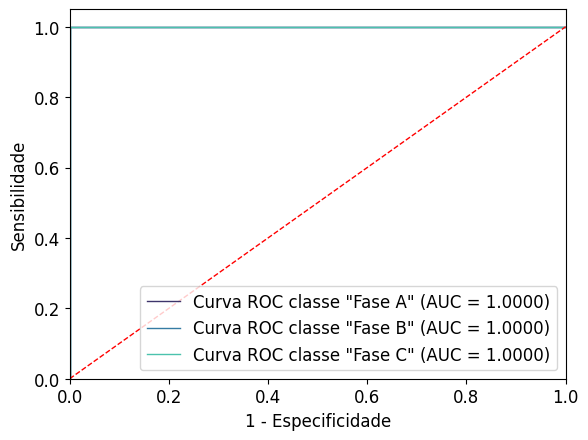

############################################################
Fold 2: 497 Amostras de Treino (120 Controle (0) e 127 Benigno (1) e 125 Cancer (2))
Fold 2: 125 Amostras de Teste (31 Controle (0) e 31 Benigno (1) e 32 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


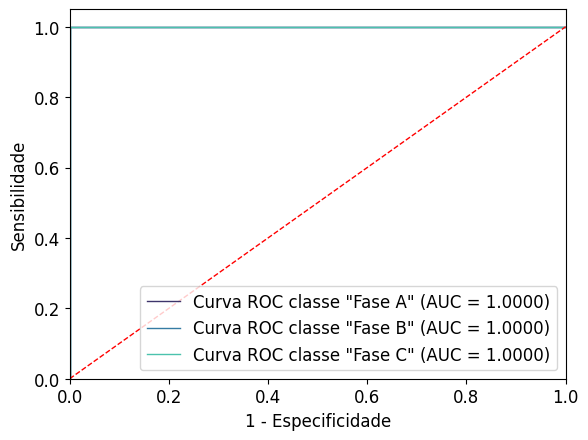

############################################################
Fold 3: 498 Amostras de Treino (121 Controle (0) e 127 Benigno (1) e 125 Cancer (2))
Fold 3: 124 Amostras de Teste (30 Controle (0) e 31 Benigno (1) e 32 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


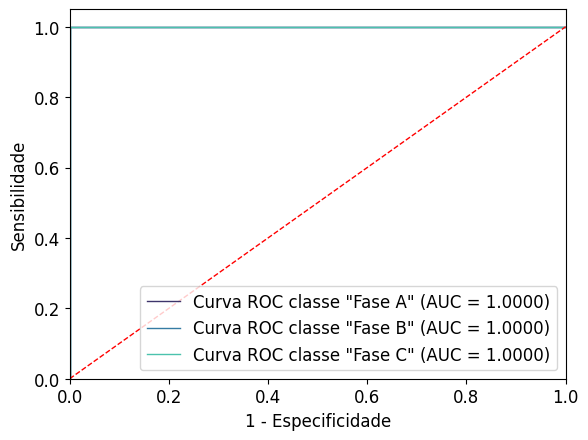

############################################################
Fold 4: 498 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 126 Cancer (2))
Fold 4: 124 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 31 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


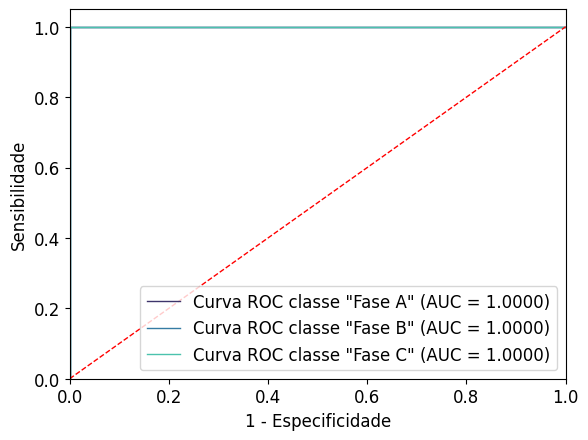

############################################################
Fold 5: 498 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 126 Cancer (2))
Fold 5: 124 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 31 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


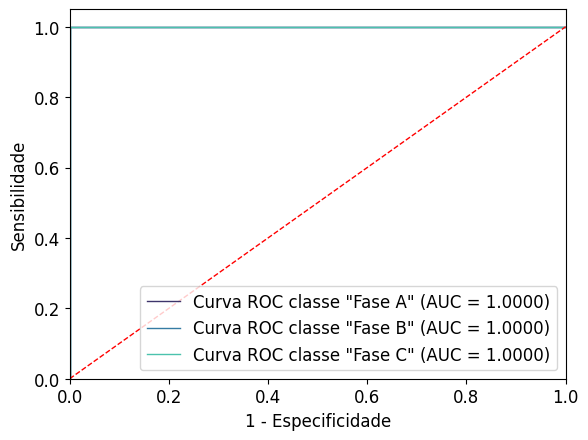

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 1, 'rho': 0.005}
model = ART_Minkowski_AE_Classifier(**best_params_Mono1)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 1.0351 segundos
Tempo de Previsão: 0.0134 segundos
Accuracy: 0.9962546816479401
Sensitivity (Recall) Macro: 0.9963235294117647
Sensitivity (Recall) Micro: 0.9962546816479401
Especificidade (specificity) macro: 0.99875
Especificidade (specificity) micro: 0.9987515605493134
----------------------
AUC: 0.9975490196078431
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 0.9963
Macro Specificity: 0.9988
Macro F-score: 0.9975


Tempo de Treinamento: 1.0179 segundos
Tempo de Previsão: 0.0128 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro: 0.9963235294117647
Sensitivity (Recall) Micro: 0.9962546816479401
Especificidade (specificity) macro: 0.99875
Especificidade (specificity) micro: 0.9987515605493134
AUC: 0.9975490196078431


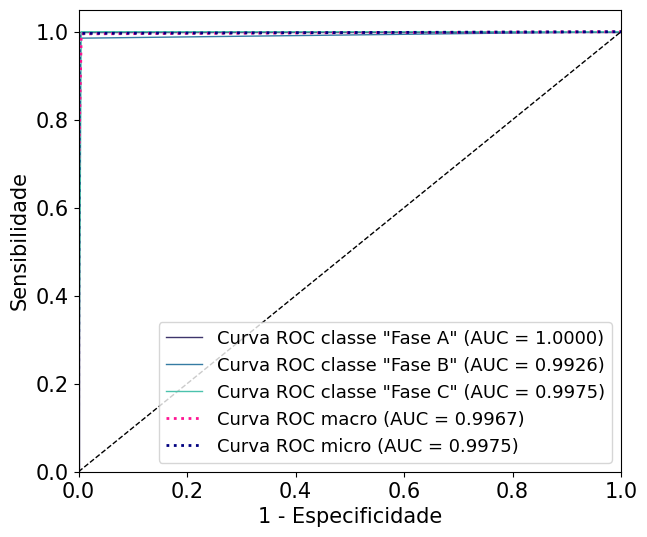

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

#### Cenário 1PV - 99%

In [ ]:
df_pv1

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,Bg,PV,0.085963,0.837879,0.076158,0,1,0,2
1,Ag,PV,0.841008,0.075763,0.083229,1,0,0,1
2,Cg,PV,0.083535,0.089299,0.827166,0,0,1,3
3,Bg,PV,0.088309,0.835994,0.075697,0,1,0,2
4,Ag,PV,0.830501,0.080201,0.089298,1,0,0,1
...,...,...,...,...,...,...,...,...,...
883,Normal,NaN,0.359337,0.326926,0.313737,0,0,0,0
884,Normal,NaN,0.358834,0.328183,0.312982,0,0,0,0
885,Normal,NaN,0.354266,0.332146,0.313589,0,0,0,0
886,Normal,NaN,0.350639,0.333987,0.315374,0,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono2, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono2)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.13999999999999999, 'rho': 0.054200000000000005}
Best AUC ROC: 0.9961586091509856


###### Teste Melhor Parametro

In [ ]:
best_params_Mono2 = {'beta': 0.13999999999999999, 'rho': 0.054200000000000005}

Fold 1: 496 Amostras de Treino (121 Controle (0) e 120 Benigno (1) e 128 Cancer (2))
Fold 1: 125 Amostras de Teste (30 Controle (0) e 31 Benigno (1) e 32 Cancer (2))
Fold 1: Acurácia = 0.9840
Fold 1: AUC = 0.9910


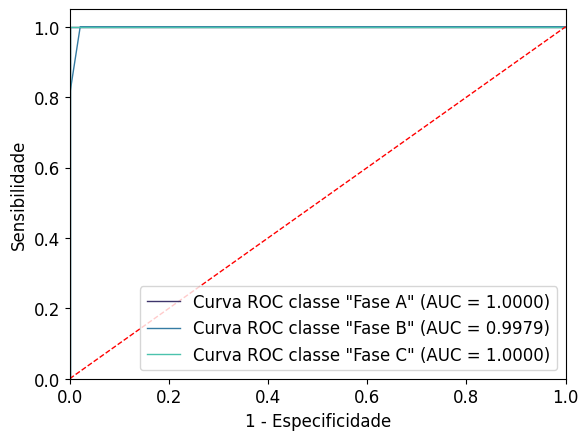

############################################################
Fold 2: 497 Amostras de Treino (120 Controle (0) e 121 Benigno (1) e 128 Cancer (2))
Fold 2: 124 Amostras de Teste (31 Controle (0) e 30 Benigno (1) e 32 Cancer (2))
Fold 2: Acurácia = 0.9839
Fold 2: AUC = 0.9980


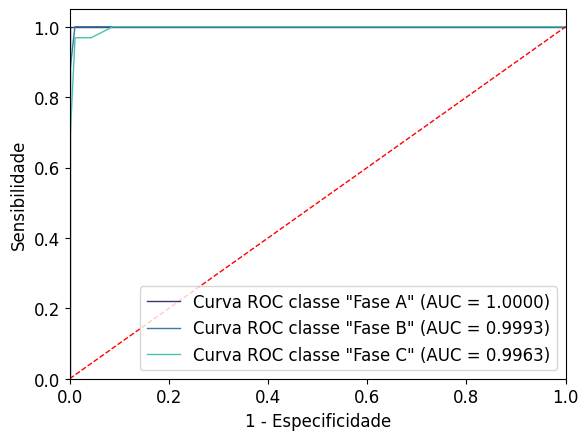

############################################################
Fold 3: 497 Amostras de Treino (121 Controle (0) e 121 Benigno (1) e 128 Cancer (2))
Fold 3: 124 Amostras de Teste (30 Controle (0) e 30 Benigno (1) e 32 Cancer (2))
Fold 3: Acurácia = 0.9839
Fold 3: AUC = 0.9986


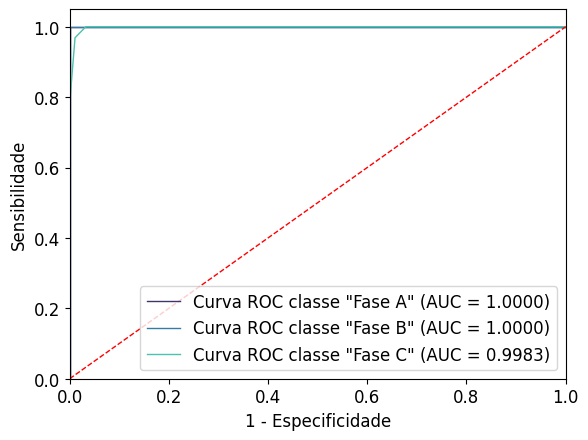

############################################################
Fold 4: 497 Amostras de Treino (121 Controle (0) e 121 Benigno (1) e 128 Cancer (2))
Fold 4: 124 Amostras de Teste (30 Controle (0) e 30 Benigno (1) e 32 Cancer (2))
Fold 4: Acurácia = 0.9839
Fold 4: AUC = 0.9970


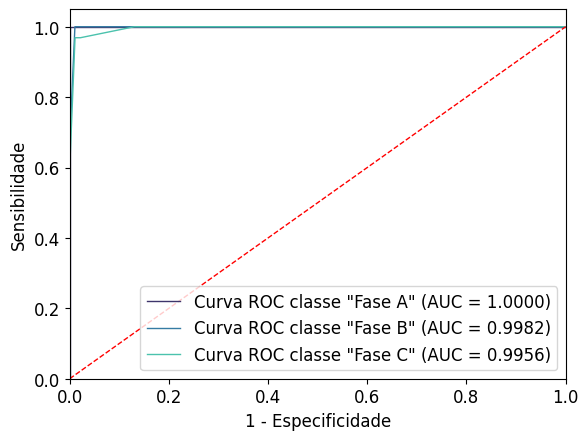

############################################################
Fold 5: 497 Amostras de Treino (121 Controle (0) e 121 Benigno (1) e 128 Cancer (2))
Fold 5: 124 Amostras de Teste (30 Controle (0) e 30 Benigno (1) e 32 Cancer (2))
Fold 5: Acurácia = 0.9677
Fold 5: AUC = 0.9961


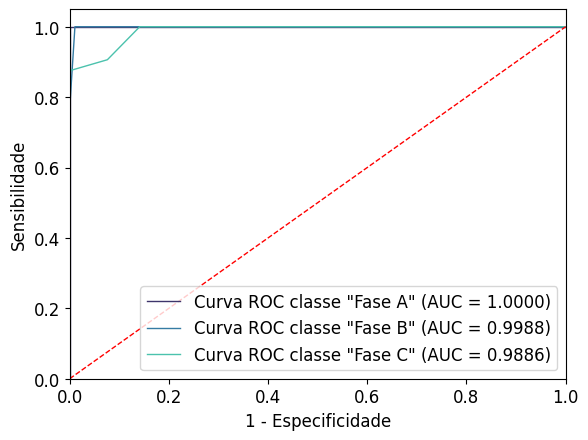

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono2 = {'beta': 0.1, 'rho': 0.1}
model = ART_Minkowski_AE_Classifier(**best_params_Mono2)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 0.0408 segundos
Tempo de Previsão: 0.0036 segundos
Accuracy: 0.9850187265917603
Sensitivity (Recall) Macro: 0.985347399829497
Sensitivity (Recall) Micro: 0.9850187265917603
Especificidade (specificity) macro: 0.995024502450245
Especificidade (specificity) micro: 0.9950062421972534
----------------------
AUC: 0.9978181629396463
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9851, F-score = 0.9925
Class 2: Sensitivity = 0.9855, Specificity = 0.9949, F-score = 0.9902
Class 3: Sensitivity = 0.9559, Specificity = 1.0000, F-score = 0.9774
\Macro Sensitivity: 0.9853
Macro Specificity: 0.9950
Macro F-score: 0.9900


Tempo de Treinamento: 0.0372 segundos
Tempo de Previsão: 0.0032 segundos
Acurácia: 98.50187266%
Sensitivity (Recall) Macro: 0.985347399829497
Sensitivity (Recall) Micro: 0.9850187265917603
Especificidade (specificity) macro: 0.995024502450245
Especificidade (specificity) micro: 0.9950062421972534
AUC: 0.9978181629396463


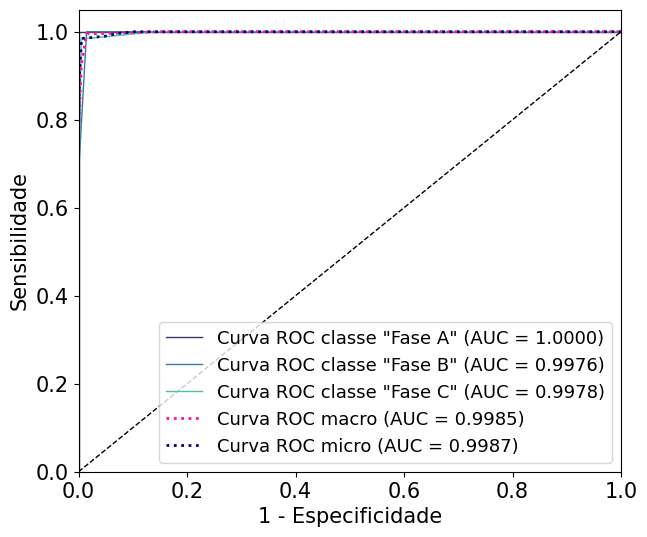

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,2PV,0.256889,0.474118,0.268993,0,1,0
1,Ag,2PV,0.456659,0.288096,0.255245,1,0,0
2,Cg,2PV,0.281233,0.272649,0.446117,0,0,1
3,Bg,2PV,0.277260,0.458462,0.264278,0,1,0
4,Ag,2PV,0.444514,0.285635,0.269851,1,0,0
...,...,...,...,...,...,...,...,...
884,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
885,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
886,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
887,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono3, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono3)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono3 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 497 Amostras de Treino (121 Controle (0) e 125 Benigno (1) e 125 Cancer (2))
Fold 1: 125 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 31 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


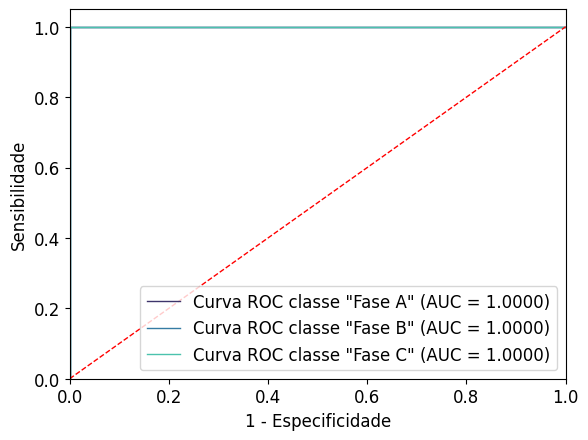

############################################################
Fold 2: 497 Amostras de Treino (121 Controle (0) e 125 Benigno (1) e 124 Cancer (2))
Fold 2: 125 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 32 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


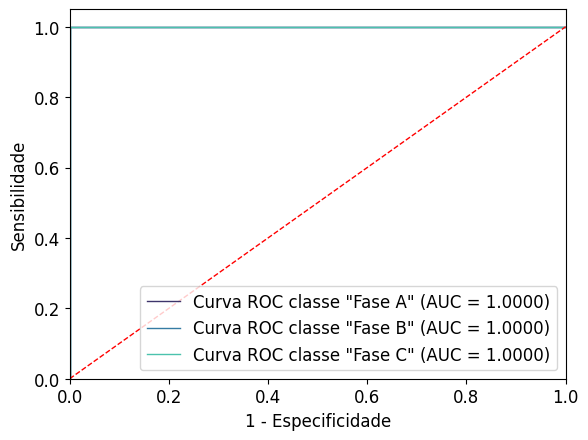

############################################################
Fold 3: 498 Amostras de Treino (120 Controle (0) e 126 Benigno (1) e 125 Cancer (2))
Fold 3: 124 Amostras de Teste (31 Controle (0) e 31 Benigno (1) e 31 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


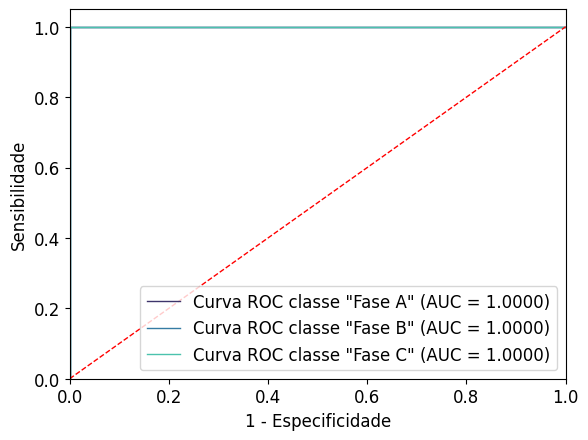

############################################################
Fold 4: 498 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 125 Cancer (2))
Fold 4: 124 Amostras de Teste (30 Controle (0) e 31 Benigno (1) e 31 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


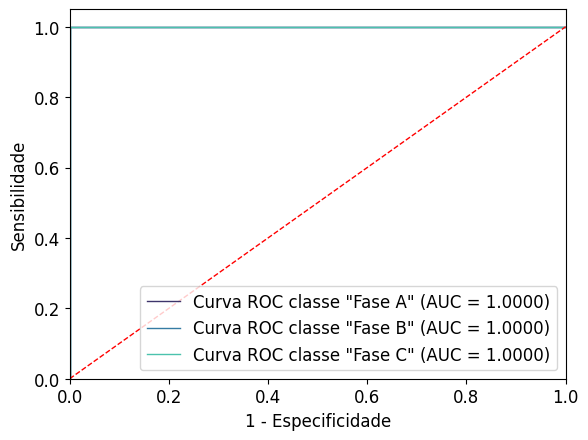

############################################################
Fold 5: 498 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 125 Cancer (2))
Fold 5: 124 Amostras de Teste (30 Controle (0) e 31 Benigno (1) e 31 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


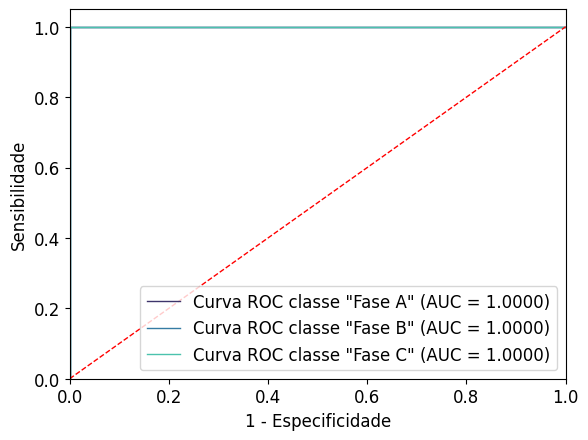

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono3)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 2.2755 segundos
Tempo de Previsão: 0.0186 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
\Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 2.2778 segundos
Tempo de Previsão: 0.0192 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


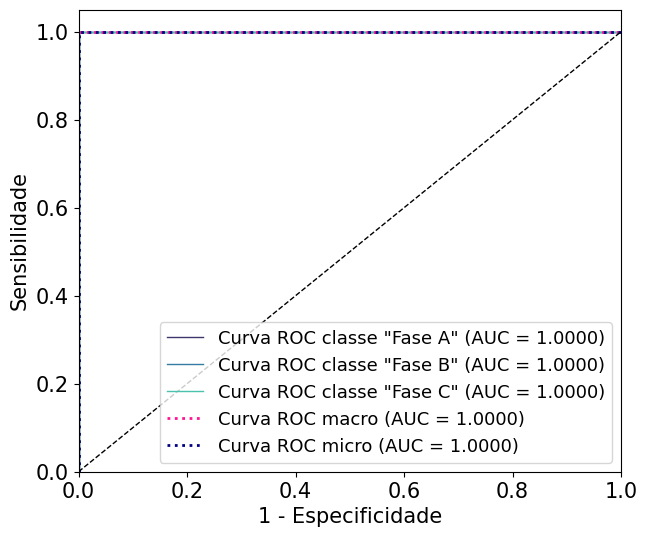

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

#### Cenário 3PV  - 100%

In [ ]:
df_pv3

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,3PV,0.300864,0.381521,0.317615,0,1,0
1,Ag,3PV,0.373230,0.328740,0.298029,1,0,0
2,Cg,3PV,0.322597,0.306574,0.370828,0,0,1
3,Bg,3PV,0.305971,0.377429,0.316601,0,1,0
4,Ag,3PV,0.370176,0.330604,0.299220,1,0,0
...,...,...,...,...,...,...,...,...
883,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
884,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
885,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
886,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono4, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono4)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.13, 'rho': 0.0173}
Best AUC ROC: 0.9968080124869927


###### Teste Melhor Parametro

In [ ]:
best_params_Mono4 = {'beta': 0.13, 'rho': 0.0173}

Fold 1: 496 Amostras de Treino (121 Controle (0) e 125 Benigno (1) e 125 Cancer (2))
Fold 1: 125 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 32 Cancer (2))
Fold 1: Acurácia = 0.9360
Fold 1: AUC = 0.9955


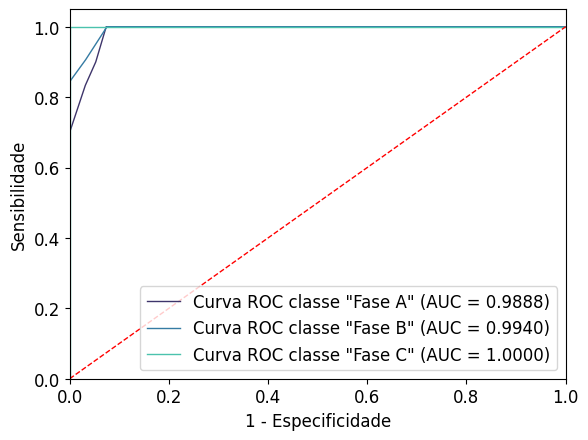

############################################################
Fold 2: 497 Amostras de Treino (121 Controle (0) e 125 Benigno (1) e 126 Cancer (2))
Fold 2: 124 Amostras de Teste (30 Controle (0) e 32 Benigno (1) e 31 Cancer (2))
Fold 2: Acurácia = 0.9677
Fold 2: AUC = 0.9997


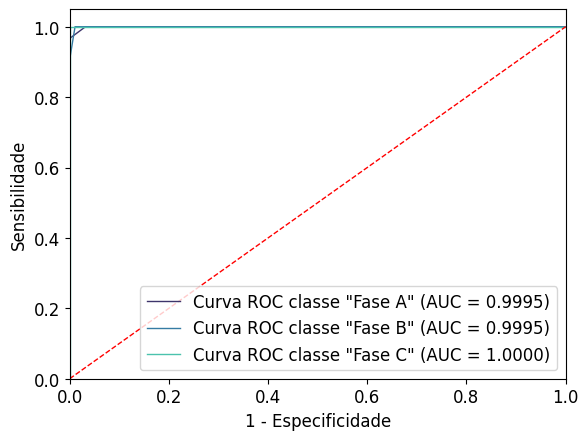

############################################################
Fold 3: 497 Amostras de Treino (120 Controle (0) e 126 Benigno (1) e 126 Cancer (2))
Fold 3: 124 Amostras de Teste (31 Controle (0) e 31 Benigno (1) e 31 Cancer (2))
Fold 3: Acurácia = 0.9435
Fold 3: AUC = 0.9963


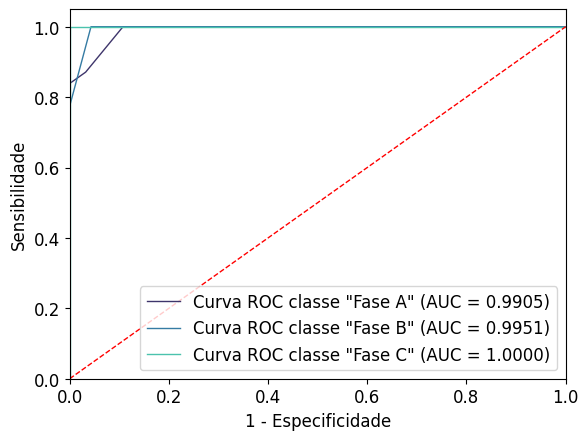

############################################################
Fold 4: 497 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 126 Cancer (2))
Fold 4: 124 Amostras de Teste (30 Controle (0) e 31 Benigno (1) e 31 Cancer (2))
Fold 4: Acurácia = 0.9758
Fold 4: AUC = 0.9992


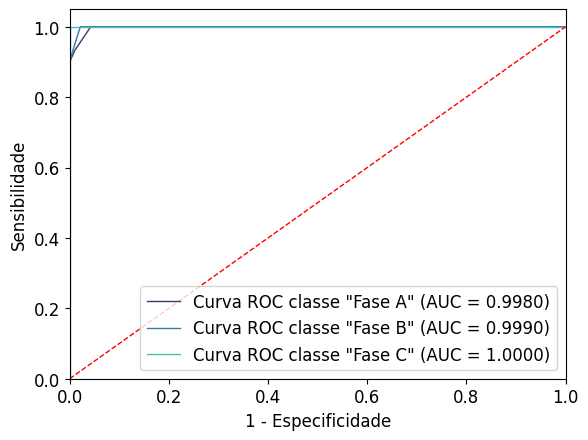

############################################################
Fold 5: 497 Amostras de Treino (121 Controle (0) e 126 Benigno (1) e 125 Cancer (2))
Fold 5: 124 Amostras de Teste (30 Controle (0) e 31 Benigno (1) e 32 Cancer (2))
Fold 5: Acurácia = 0.9274
Fold 5: AUC = 0.9935


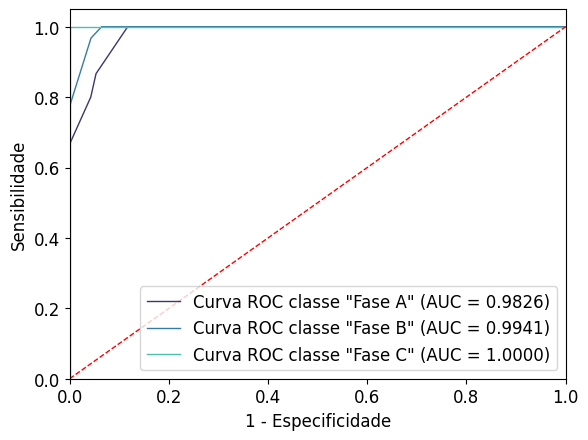

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

In [ ]:
#_____________________TESTE_____________________

best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono4)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 0.0613 segundos
Tempo de Previsão: 0.0045 segundos
Accuracy: 0.9737827715355806
Sensitivity (Recall) Macro: 0.9734162895927603
Sensitivity (Recall) Micro: 0.9737827715355806
Especificidade (specificity) macro: 0.9912621896611771
Especificidade (specificity) micro: 0.9912609238451935
----------------------
AUC: 0.9987702888273565
Class 0: Sensitivity = 0.9231, Specificity = 0.9901, F-score = 0.9554
Class 1: Sensitivity = 1.0000, Specificity = 0.9850, F-score = 0.9924
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9706, Specificity = 0.9899, F-score = 0.9802
\Macro Sensitivity: 0.9734
Macro Specificity: 0.9913
Macro F-score: 0.9820


Tempo de Treinamento: 0.0619 segundos
Tempo de Previsão: 0.0045 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro: 0.9734162895927603
Sensitivity (Recall) Micro: 0.9737827715355806
Especificidade (specificity) macro: 0.9912621896611771
Especificidade (specificity) micro: 0.9912609238451935
AUC: 0.9987702888273565


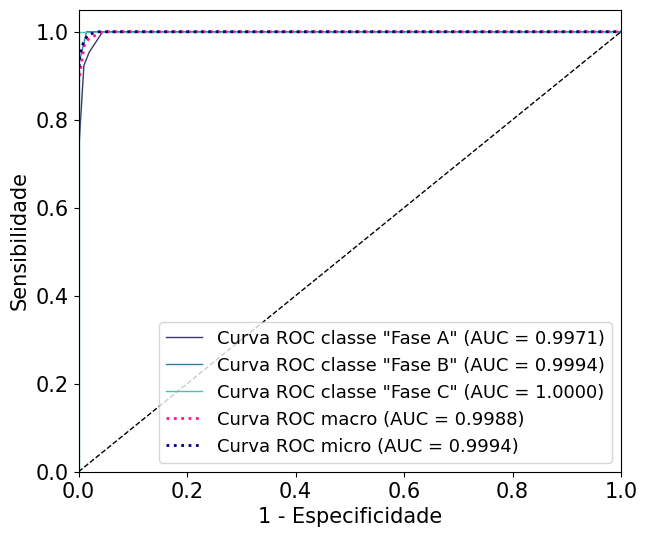

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

### Curto Bifásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Bifásico')
df_mono.head()

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,PV,0.425944,0.172468,0.401587,1.0,0.0,1.0
1,BCg,PV,0.152086,0.427308,0.420606,0.0,1.0,1.0
2,ABg,PV,0.415248,0.453407,0.131345,1.0,1.0,0.0
3,AC,PV,0.432785,0.199104,0.368111,1.0,0.0,1.0
4,BC,PV,0.204604,0.380720,0.414675,0.0,1.0,1.0


In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

Valores ausentes antes de remover linhas:
Curto         4
Tipo de GD    4
Med_A         4
Med_B         3
Med_C         4
FASE A        4
FASE B        4
FASE C        4
dtype: int64

Valores ausentes após remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64


In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

#### Cenário Base - 100%

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,Sem GD,0.825285,0.026547,1.000000,1.0,0.0,1.0
1,BCg,Sem GD,0.029526,1.000000,0.819196,0.0,1.0,1.0
2,ABg,Sem GD,1.000000,0.833272,0.021076,1.0,1.0,0.0
3,AC,Sem GD,0.949180,0.058432,1.000000,1.0,0.0,1.0
4,BC,Sem GD,0.065444,1.000000,0.947361,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...
1560,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1561,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1562,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1563,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_sem['Classe'] = df_sem['Curto'].str.strip().replace(mapping)

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,ACg,Sem GD,0.825285,0.026547,1.000000,1.0,0.0,1.0,1
1,BCg,Sem GD,0.029526,1.000000,0.819196,0.0,1.0,1.0,2
2,ABg,Sem GD,1.000000,0.833272,0.021076,1.0,1.0,0.0,3
3,AC,Sem GD,0.949180,0.058432,1.000000,1.0,0.0,1.0,1
4,BC,Sem GD,0.065444,1.000000,0.947361,0.0,1.0,1.0,2
...,...,...,...,...,...,...,...,...,...
1560,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0,0
1561,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0,0
1562,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0,0
1563,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0,0


In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0005)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono1, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono1)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono1 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 876 Amostras de Treino (121 Controle (0) e 253 Benigno (1) e 251 Cancer (2))
Fold 1: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


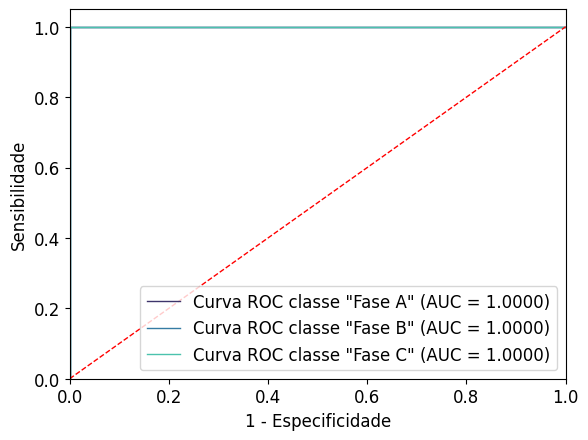

############################################################
Fold 2: 876 Amostras de Treino (121 Controle (0) e 253 Benigno (1) e 251 Cancer (2))
Fold 2: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


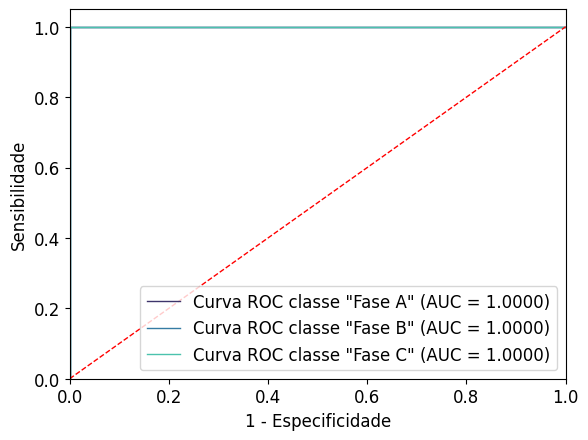

############################################################
Fold 3: 876 Amostras de Treino (121 Controle (0) e 253 Benigno (1) e 251 Cancer (2))
Fold 3: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


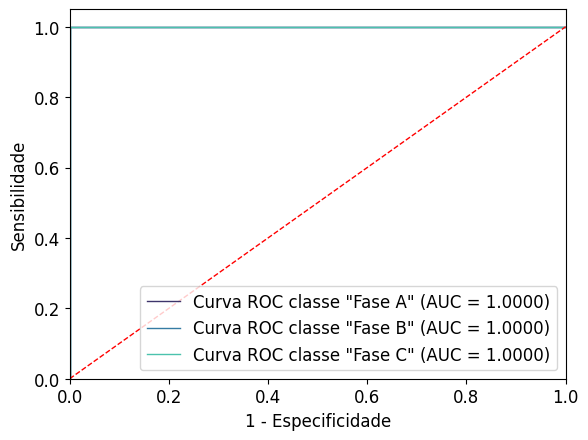

############################################################
Fold 4: 876 Amostras de Treino (121 Controle (0) e 253 Benigno (1) e 251 Cancer (2))
Fold 4: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


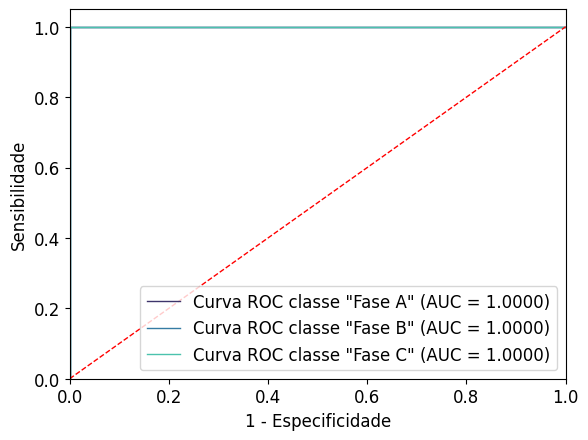

############################################################
Fold 5: 876 Amostras de Treino (120 Controle (0) e 252 Benigno (1) e 252 Cancer (2))
Fold 5: 219 Amostras de Teste (31 Controle (0) e 64 Benigno (1) e 62 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


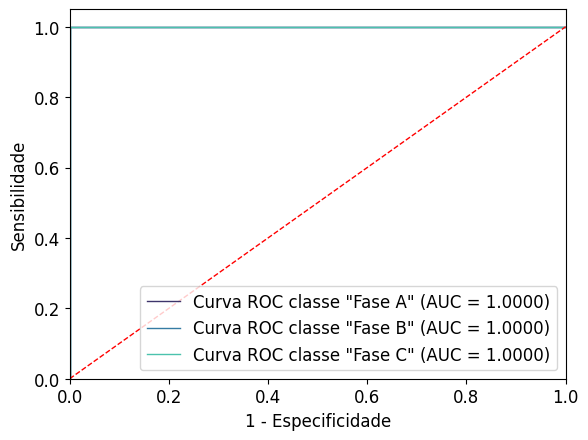

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 1, 'rho': 0.005}
model = ART_Minkowski_AE_Classifier(**best_params_Mono1)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 2.2325 segundos
Tempo de Previsão: 0.0355 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 2.2730 segundos
Tempo de Previsão: 0.0332 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


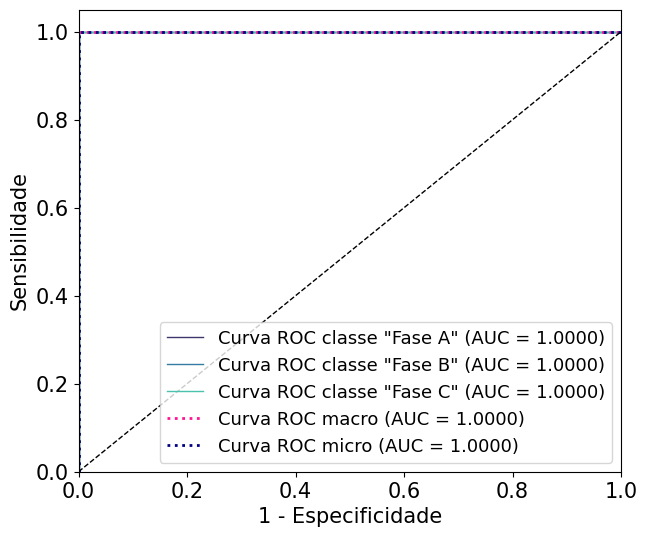

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

#### Cenário 1PV - 100%

In [ ]:
df_pv1

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,PV,0.425944,0.172468,0.401587,1.0,0.0,1.0
1,BCg,PV,0.152086,0.427308,0.420606,0.0,1.0,1.0
2,ABg,PV,0.415248,0.453407,0.131345,1.0,1.0,0.0
3,AC,PV,0.432785,0.199104,0.368111,1.0,0.0,1.0
4,BC,PV,0.204604,0.380720,0.414675,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...
1555,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1556,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1557,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1558,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_pv1['Classe'] = df_pv1['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono2, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono2)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono2 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 873 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 1: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


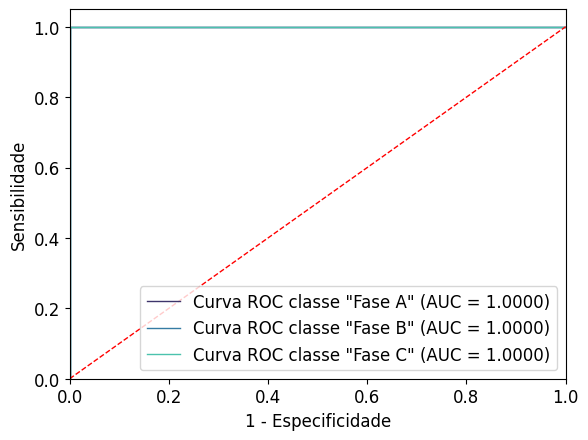

############################################################
Fold 2: 873 Amostras de Treino (120 Controle (0) e 251 Benigno (1) e 252 Cancer (2))
Fold 2: 219 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 62 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


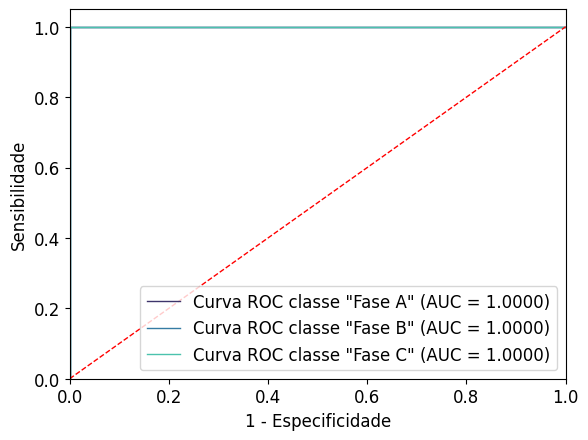

############################################################
Fold 3: 874 Amostras de Treino (121 Controle (0) e 252 Benigno (1) e 251 Cancer (2))
Fold 3: 218 Amostras de Teste (30 Controle (0) e 62 Benigno (1) e 63 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


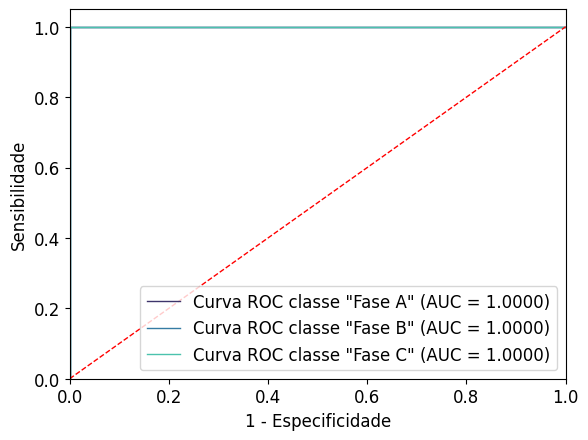

############################################################
Fold 4: 874 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 4: 218 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


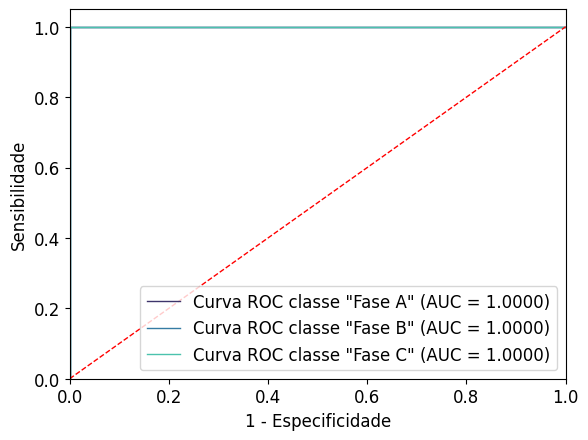

############################################################
Fold 5: 874 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 5: 218 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


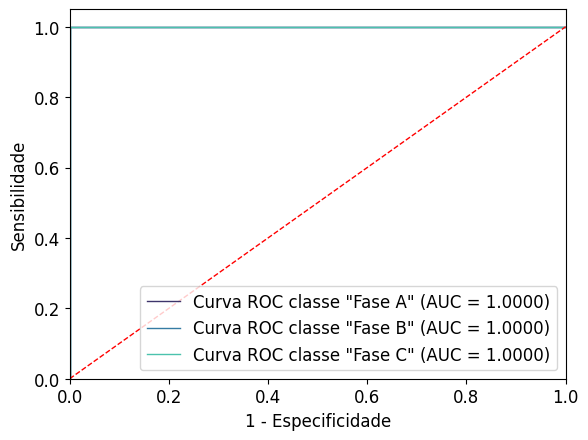

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono2 = {'beta': 0.1, 'rho': 0.1}
model = ART_Minkowski_AE_Classifier(**best_params_Mono2)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 4.5585 segundos
Tempo de Previsão: 0.0464 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
\Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 4.6182 segundos
Tempo de Previsão: 0.0444 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


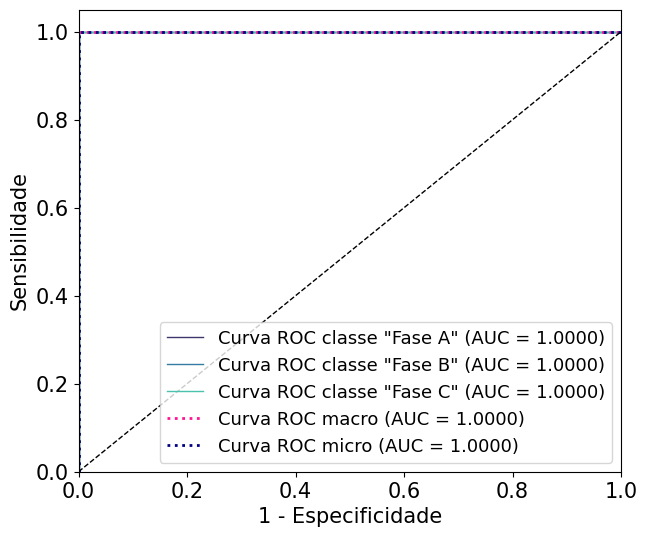

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,BCg,2PV,0.107321,0.489054,0.403624,0.0,1.0,1.0
1,ABg,2PV,0.485277,0.467065,0.047658,1.0,1.0,0.0
2,AC,2PV,0.442965,0.090000,0.467035,1.0,0.0,1.0
3,BC,2PV,0.120597,0.485231,0.394172,0.0,1.0,1.0
4,AB,2PV,0.499229,0.450149,0.050622,1.0,1.0,0.0
...,...,...,...,...,...,...,...,...
1555,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1556,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1557,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1558,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_pv2['Classe'] = df_pv2['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono3, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono3)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono3 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 873 Amostras de Treino (121 Controle (0) e 250 Benigno (1) e 251 Cancer (2))
Fold 1: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


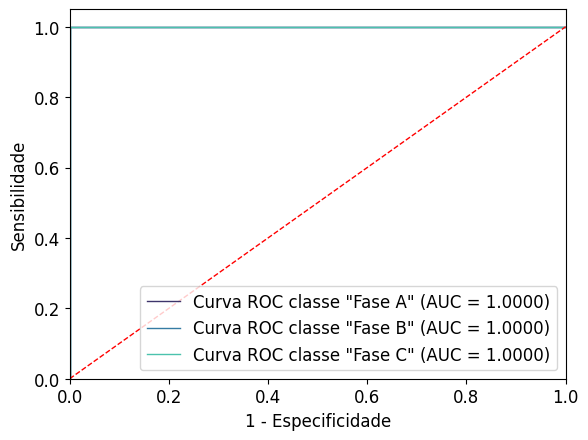

############################################################
Fold 2: 873 Amostras de Treino (120 Controle (0) e 250 Benigno (1) e 252 Cancer (2))
Fold 2: 219 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 62 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


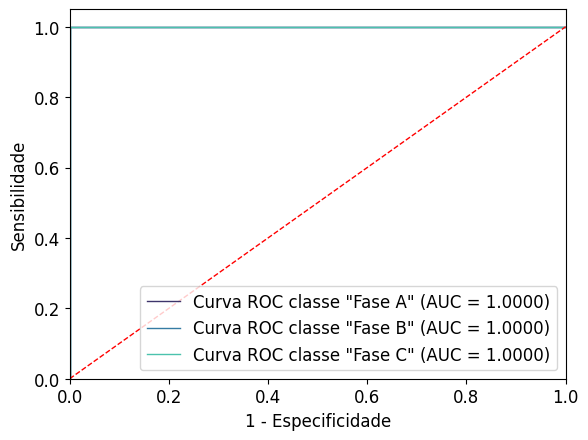

############################################################
Fold 3: 874 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 3: 218 Amostras de Teste (30 Controle (0) e 62 Benigno (1) e 63 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


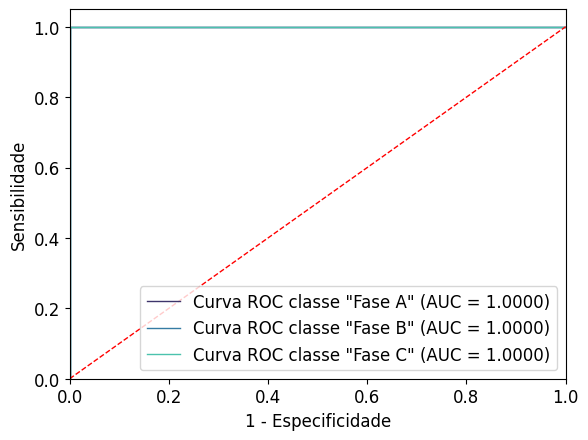

############################################################
Fold 4: 874 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 4: 218 Amostras de Teste (30 Controle (0) e 62 Benigno (1) e 63 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


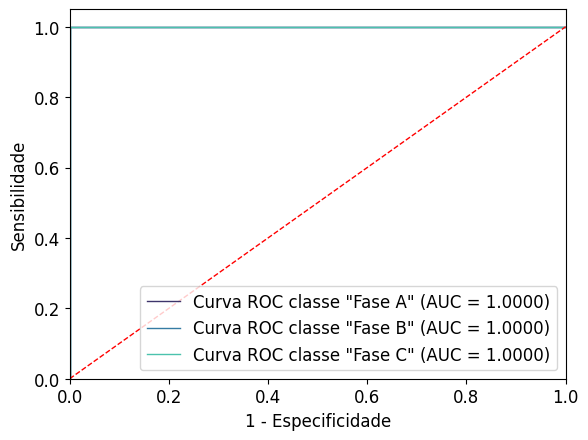

############################################################
Fold 5: 874 Amostras de Treino (121 Controle (0) e 250 Benigno (1) e 251 Cancer (2))
Fold 5: 218 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


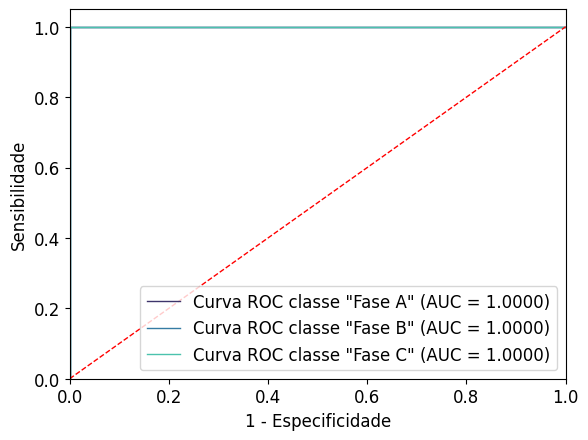

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono3)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 6.1914 segundos
Tempo de Previsão: 0.0564 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
\Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 6.1724 segundos
Tempo de Previsão: 0.0517 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


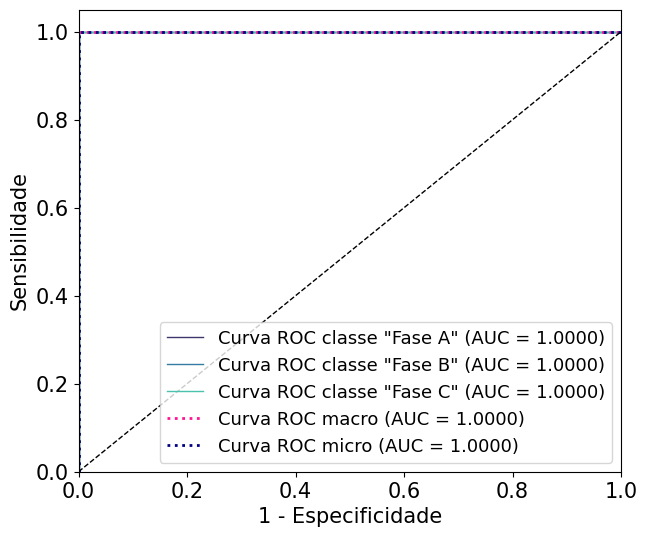

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

#### Cenário 3PV  - 100%

In [ ]:
df_pv3

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,3PV,0.383774,0.244009,0.372217,1.0,0.0,1.0
1,BCg,3PV,0.227219,0.392287,0.380493,0.0,1.0,1.0
2,ABg,3PV,0.380190,0.400903,0.218907,1.0,1.0,0.0
3,AC,3PV,0.393906,0.247290,0.358804,1.0,0.0,1.0
4,BC,3PV,0.233677,0.368877,0.397446,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...
1555,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1556,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1557,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1558,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_pv3['Classe'] = df_pv3['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono4, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono4)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono4 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 873 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 1: 219 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


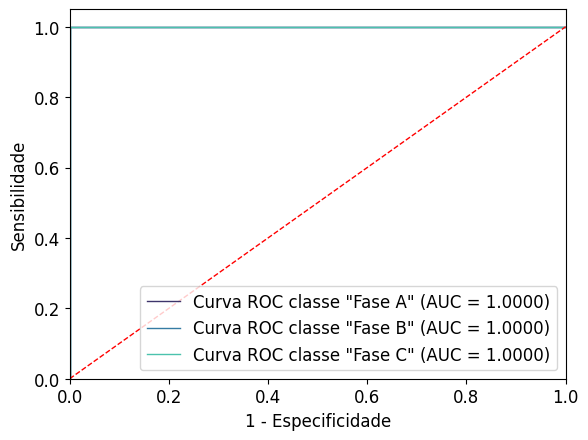

############################################################
Fold 2: 873 Amostras de Treino (120 Controle (0) e 251 Benigno (1) e 252 Cancer (2))
Fold 2: 219 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 62 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


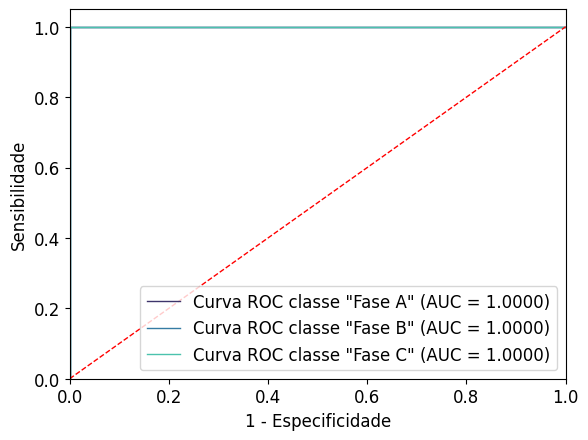

############################################################
Fold 3: 874 Amostras de Treino (121 Controle (0) e 252 Benigno (1) e 251 Cancer (2))
Fold 3: 218 Amostras de Teste (30 Controle (0) e 62 Benigno (1) e 63 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


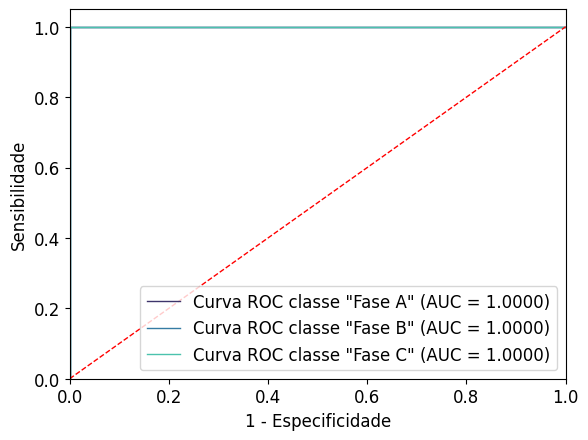

############################################################
Fold 4: 874 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 4: 218 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


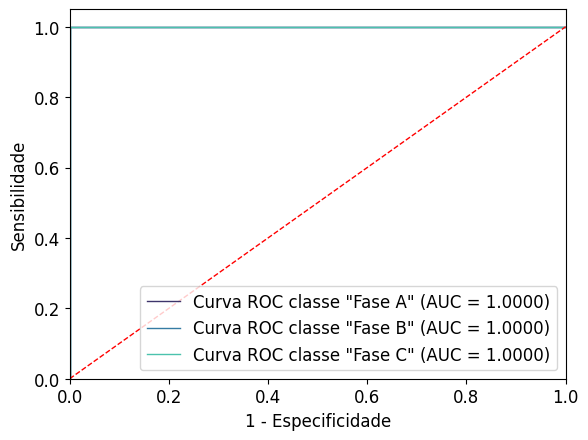

############################################################
Fold 5: 874 Amostras de Treino (121 Controle (0) e 251 Benigno (1) e 251 Cancer (2))
Fold 5: 218 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 63 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


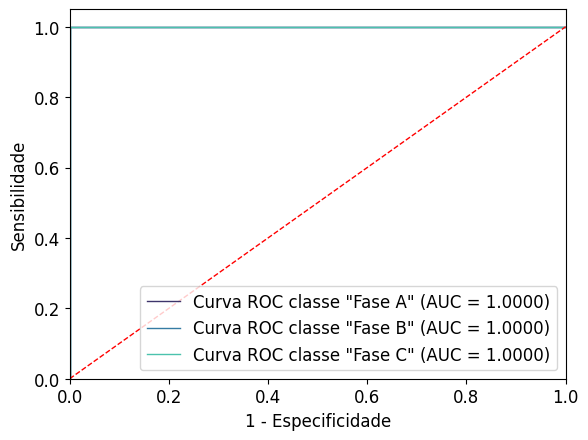

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

In [ ]:
#_____________________TESTE_____________________

best_params_Mono1 = {'beta': 0.1, 'rho': 0.04}
model = ART_Minkowski_AE_Classifier(**best_params_Mono4)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\Macro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

Tempo de Treinamento: 7.2296 segundos
Tempo de Previsão: 0.0609 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
\Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 7.2419 segundos
Tempo de Previsão: 0.0603 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


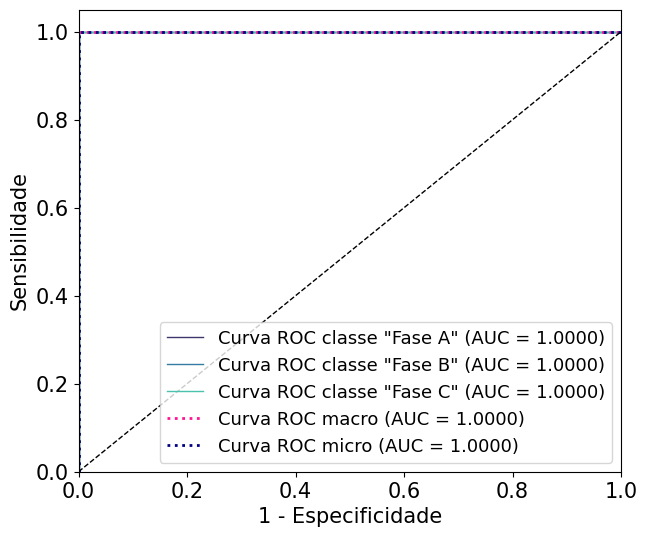

In [ ]:
test_and_evaluate_model(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

### Curto Trifásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Trifásico')
df_mono.head()

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,PV,0.325948,0.340872,0.333180,1,1,1
1,ABCg,PV,0.328829,0.339757,0.331414,1,1,1
2,ABCg,PV,0.325523,0.341083,0.333395,1,1,1
3,ABCg,PV,0.327916,0.340147,0.331936,1,1,1
4,ABCg,PV,0.325130,0.341213,0.333657,1,1,1


In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

Valores ausentes antes de remover linhas:
Curto         1
Tipo de GD    1
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64

Valores ausentes após remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64


In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['SEM GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

#### Cenário Base - 100%

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,SEM GD,0.330884,0.346779,0.322337,1,1,1
1,Ruído,SEM GD,0.065536,0.065536,0.065536,0,0,0
2,Ruído,SEM GD,0.029519,0.029519,0.029519,0,0,0
3,Ruído,SEM GD,0.021078,0.021078,0.021078,0,0,0
4,Ruído,SEM GD,0.026481,0.026481,0.026481,0,0,0
...,...,...,...,...,...,...,...,...
666,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
667,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
668,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
669,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_sem['Classe'] = df_sem['Curto'].str.strip().replace(mapping)

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,ABCg,SEM GD,0.330884,0.346779,0.322337,1,1,1,1
1,Ruído,SEM GD,0.065536,0.065536,0.065536,0,0,0,0
2,Ruído,SEM GD,0.029519,0.029519,0.029519,0,0,0,0
3,Ruído,SEM GD,0.021078,0.021078,0.021078,0,0,0,0
4,Ruído,SEM GD,0.026481,0.026481,0.026481,0,0,0,0
...,...,...,...,...,...,...,...,...,...
666,Normal,NaN,0.359337,0.326926,0.313737,0,0,0,0
667,Normal,NaN,0.358834,0.328183,0.312982,0,0,0,0
668,Normal,NaN,0.354266,0.332146,0.313589,0,0,0,0
669,Normal,NaN,0.350639,0.333987,0.315374,0,0,0,0


In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

In [ ]:
np.unique(y, return_counts=True)

(array([0, 1, 2, 3]), array([151, 314, 314, 313]))

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.001, 0.1, 0.001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono1, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono1)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'beta': 0.1, 'rho': 0.001}
Best AUC ROC: 0.9870967741935484


###### Teste Melhor Parametro

In [ ]:
best_params_Mono1 = {'beta': 0.1, 'rho': 0.001}

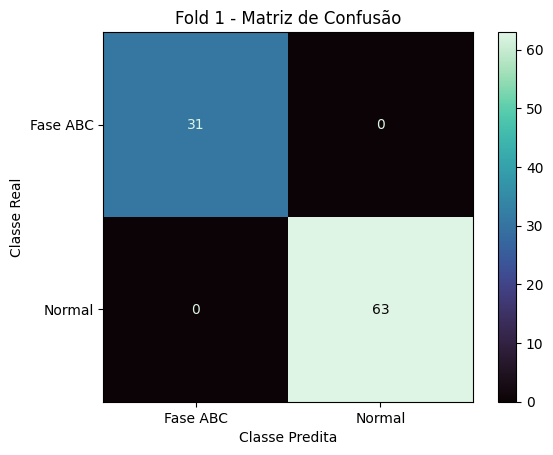

Fold 1: 375 Amostras de Treino (123 Controle (0) e 252 Cancer (1))
Fold 1: 94 Amostras de Teste (31 Controle (0) e 63 Cancer (1))
Fold 1: Acurácia = 1.0000
Fold 1: Precisão = 1.0000
Fold 1: Sensibilidade = 1.0000
Fold 1: F-score = 1.0000
Fold 1: Coeficiente de Correlação de Matthews = 1.0000
Fold 1: AUC = 1.0000
############################################################
############################################################


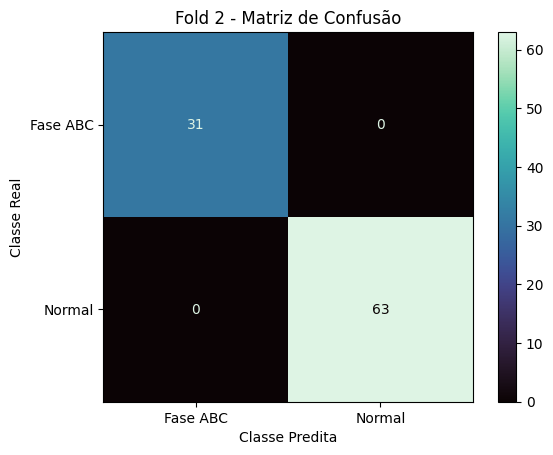

Fold 2: 375 Amostras de Treino (123 Controle (0) e 252 Cancer (1))
Fold 2: 94 Amostras de Teste (31 Controle (0) e 63 Cancer (1))
Fold 2: Acurácia = 1.0000
Fold 2: Precisão = 1.0000
Fold 2: Sensibilidade = 1.0000
Fold 2: F-score = 1.0000
Fold 2: Coeficiente de Correlação de Matthews = 1.0000
Fold 2: AUC = 1.0000
############################################################
############################################################


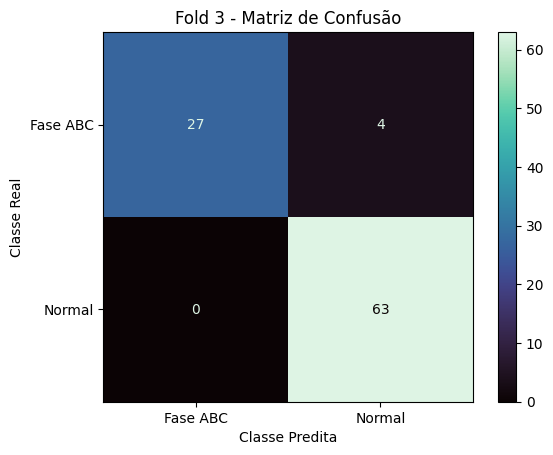

Fold 3: 375 Amostras de Treino (123 Controle (0) e 252 Cancer (1))
Fold 3: 94 Amostras de Teste (31 Controle (0) e 63 Cancer (1))
Fold 3: Acurácia = 0.9574
Fold 3: Precisão = 0.9403
Fold 3: Sensibilidade = 1.0000
Fold 3: F-score = 0.9692
Fold 3: Coeficiente de Correlação de Matthews = 0.9050
Fold 3: AUC = 0.9355
############################################################
############################################################


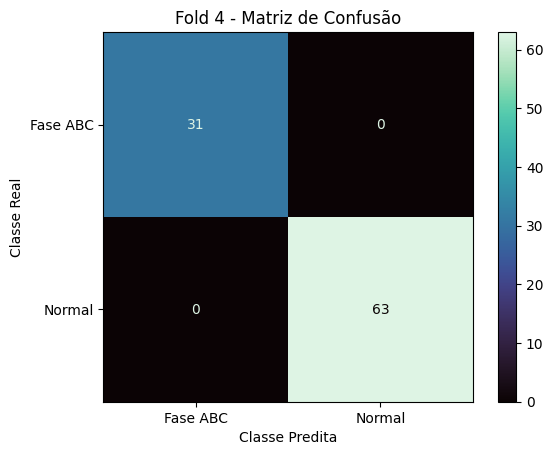

Fold 4: 375 Amostras de Treino (123 Controle (0) e 252 Cancer (1))
Fold 4: 94 Amostras de Teste (31 Controle (0) e 63 Cancer (1))
Fold 4: Acurácia = 1.0000
Fold 4: Precisão = 1.0000
Fold 4: Sensibilidade = 1.0000
Fold 4: F-score = 1.0000
Fold 4: Coeficiente de Correlação de Matthews = 1.0000
Fold 4: AUC = 1.0000
############################################################
############################################################


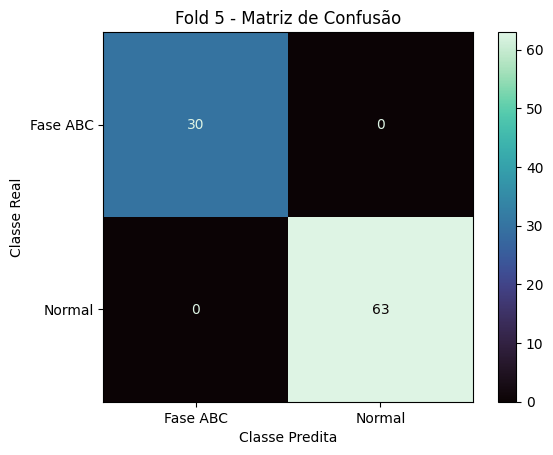

Fold 5: 376 Amostras de Treino (124 Controle (0) e 252 Cancer (1))
Fold 5: 93 Amostras de Teste (30 Controle (0) e 63 Cancer (1))
Fold 5: Acurácia = 1.0000
Fold 5: Precisão = 1.0000
Fold 5: Sensibilidade = 1.0000
Fold 5: F-score = 1.0000
Fold 5: Coeficiente de Correlação de Matthews = 1.0000
Fold 5: AUC = 1.0000
############################################################
############################################################


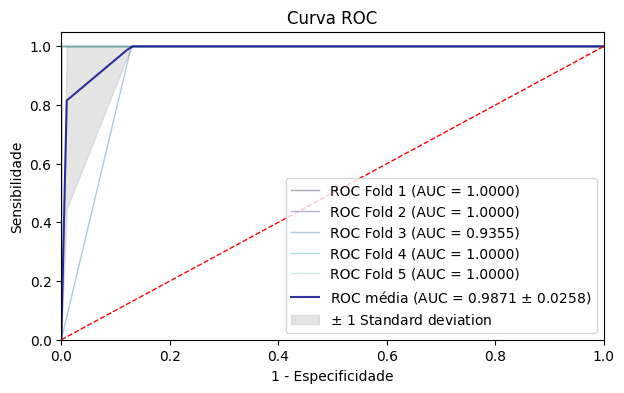

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase ABC", "Normal"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model_bin(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

In [ ]:
#_____________________TESTE_____________________

# best_params_Mono1 = {'beta': 1, 'rho': 0.005}
model = ART_Minkowski_AE_Classifier(**best_params_Mono1)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


Tempo de Treinamento: 0.0915 segundos
Tempo de Previsão: 0.0041 segundos
Accuracy: 1.0
Sensitivity (Recall): 1.0
Specificity: 1.0
----------------------
AUC: 1.0000


Tempo de Treinamento: 0.0863 segundos
Tempo de Previsão: 0.0043 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


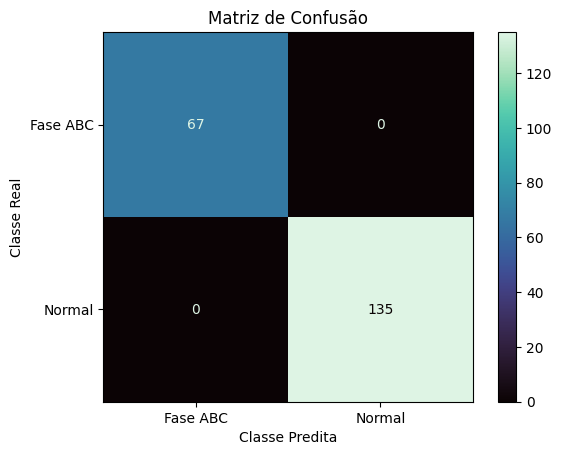

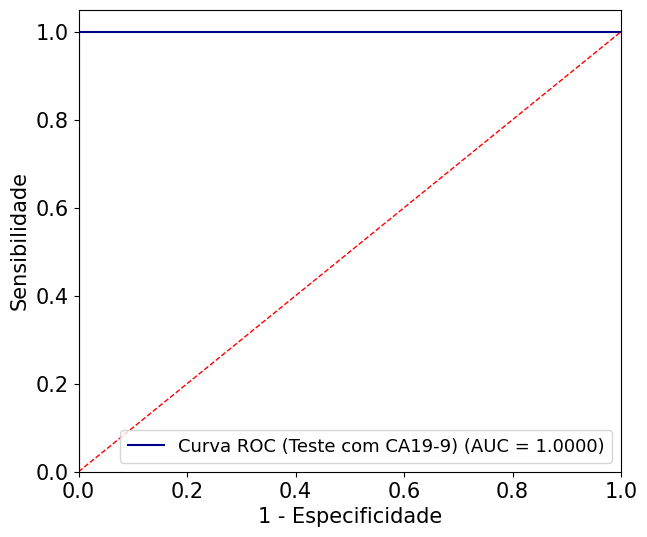

In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono1)

#### Cenário 1PV - 100%

In [ ]:
df_pv1

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,PV,0.325948,0.340872,0.333180,1,1,1
1,ABCg,PV,0.328829,0.339757,0.331414,1,1,1
2,ABCg,PV,0.325523,0.341083,0.333395,1,1,1
3,ABCg,PV,0.327916,0.340147,0.331936,1,1,1
4,ABCg,PV,0.325130,0.341213,0.333657,1,1,1
...,...,...,...,...,...,...,...,...
663,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
664,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
665,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
666,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_pv1['Classe'] = df_pv1['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono2, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono2)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
best_params_Mono2 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 373 Amostras de Treino (123 Controle (0) e 250 Benigno (1) e 0 Cancer (2))
Fold 1: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


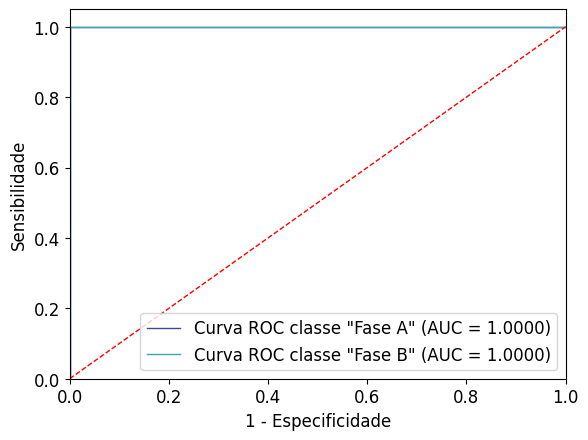

############################################################
Fold 2: 373 Amostras de Treino (123 Controle (0) e 250 Benigno (1) e 0 Cancer (2))
Fold 2: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


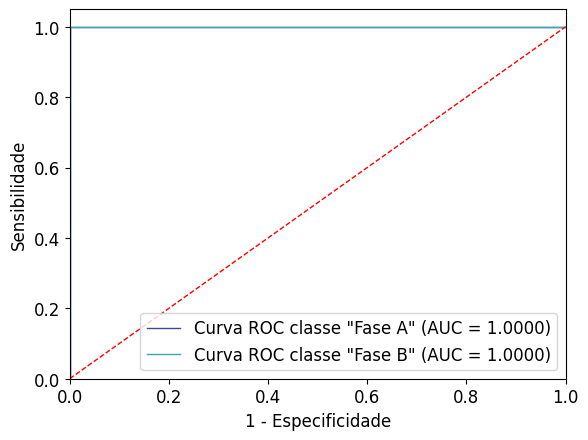

############################################################
Fold 3: 374 Amostras de Treino (124 Controle (0) e 250 Benigno (1) e 0 Cancer (2))
Fold 3: 93 Amostras de Teste (30 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


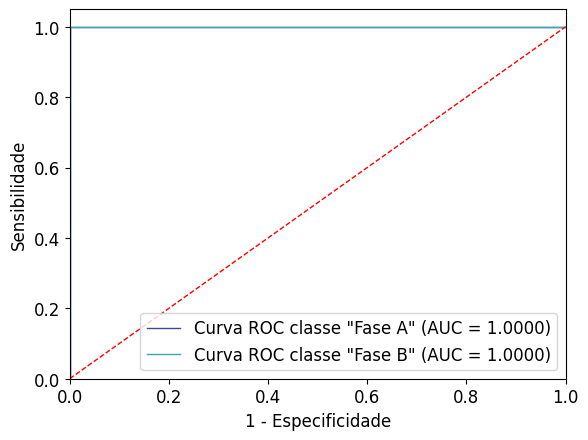

############################################################
Fold 4: 374 Amostras de Treino (123 Controle (0) e 251 Benigno (1) e 0 Cancer (2))
Fold 4: 93 Amostras de Teste (31 Controle (0) e 62 Benigno (1) e 0 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


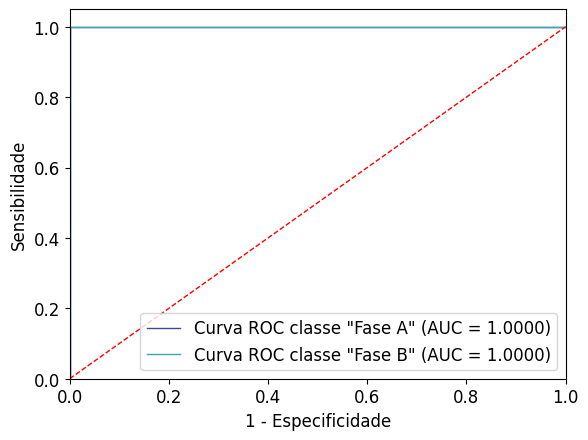

############################################################
Fold 5: 374 Amostras de Treino (123 Controle (0) e 251 Benigno (1) e 0 Cancer (2))
Fold 5: 93 Amostras de Teste (31 Controle (0) e 62 Benigno (1) e 0 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


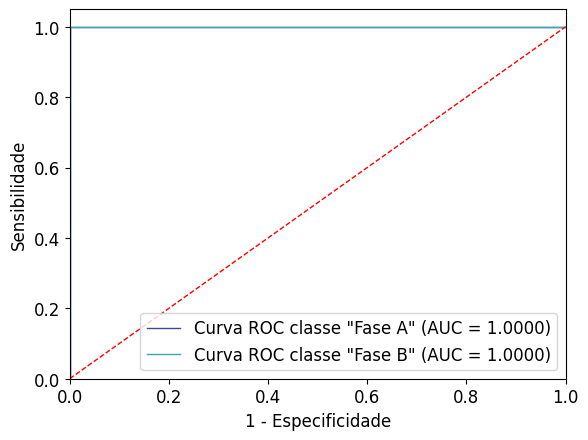

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

In [ ]:
#_____________________TESTE_____________________

model = ART_Minkowski_AE_Classifier(**best_params_Mono2)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


Tempo de Treinamento: 0.6163 segundos
Tempo de Previsão: 0.0085 segundos
Accuracy: 1.0
Sensitivity (Recall): 1.0
Specificity: 1.0
----------------------
AUC: 1.0000


Tempo de Treinamento: 0.6119 segundos
Tempo de Previsão: 0.0092 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


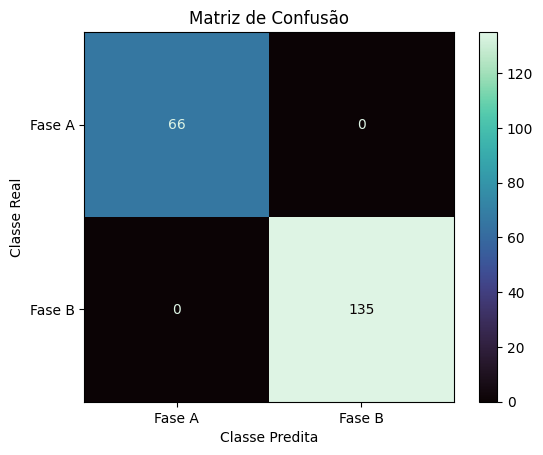

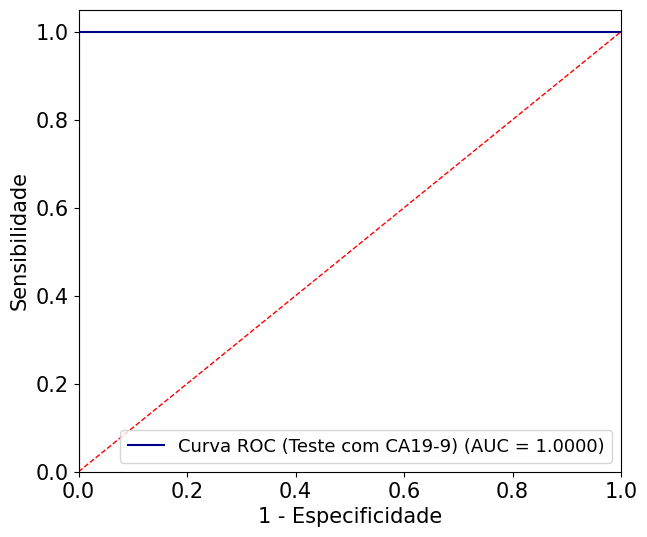

In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono2)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,2PV,0.330876,0.346613,0.322511,1,1,1
1,ABC,2PV,0.335206,0.345518,0.319276,1,1,1
2,ABCg,2PV,0.330878,0.346578,0.322544,1,1,1
3,ABC,2PV,0.335195,0.345522,0.319283,1,1,1
4,ABCg,2PV,0.330901,0.346608,0.322491,1,1,1
...,...,...,...,...,...,...,...,...
668,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
669,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
670,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
671,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_pv2['Classe'] = df_pv2['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono3, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono3)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.1, 'rho': 0.0001}
Best AUC ROC: 0.9998479902713774


###### Teste Melhor Parametro

In [ ]:
best_params_Mono3 = {'beta': 0.1, 'rho': 0.0001}

Fold 1: 376 Amostras de Treino (124 Controle (0) e 252 Benigno (1) e 0 Cancer (2))
Fold 1: 95 Amostras de Teste (32 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 1: Acurácia = 0.9895
Fold 1: AUC = 0.9998


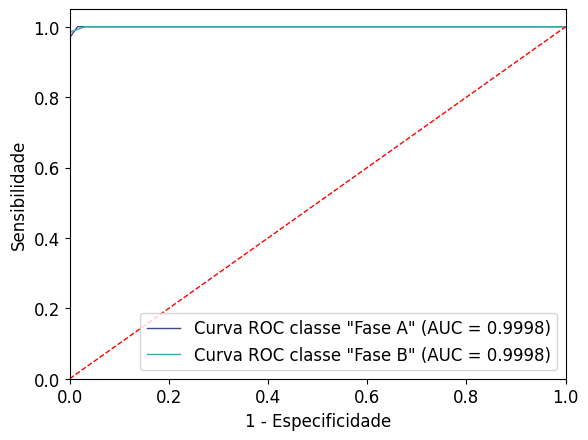

############################################################
Fold 2: 377 Amostras de Treino (125 Controle (0) e 252 Benigno (1) e 0 Cancer (2))
Fold 2: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 2: Acurácia = 1.0000
Fold 2: AUC = 1.0000


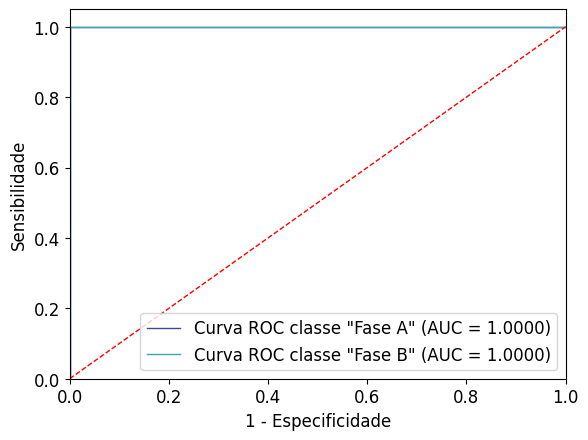

############################################################
Fold 3: 377 Amostras de Treino (125 Controle (0) e 252 Benigno (1) e 0 Cancer (2))
Fold 3: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


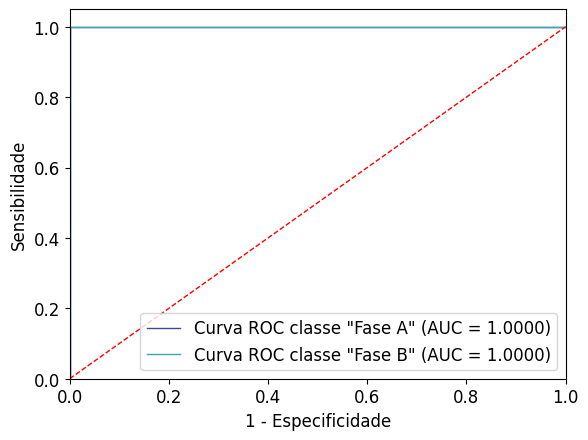

############################################################
Fold 4: 377 Amostras de Treino (125 Controle (0) e 252 Benigno (1) e 0 Cancer (2))
Fold 4: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


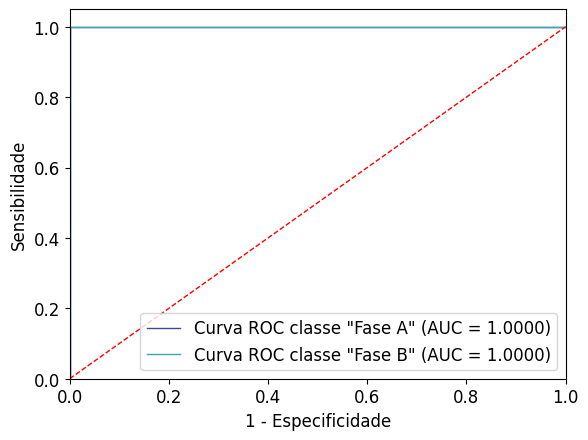

############################################################
Fold 5: 377 Amostras de Treino (125 Controle (0) e 252 Benigno (1) e 0 Cancer (2))
Fold 5: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 5: Acurácia = 0.9894
Fold 5: AUC = 0.9995


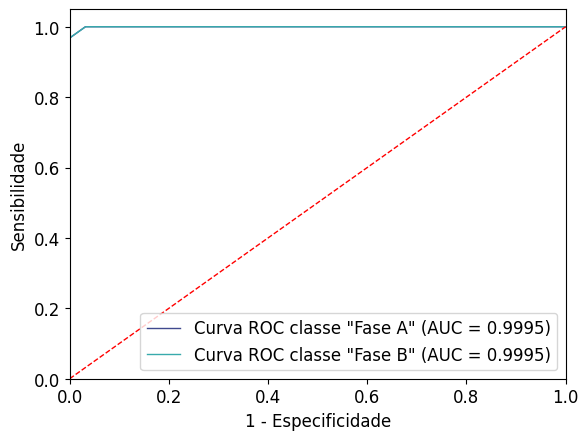

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

In [ ]:
#_____________________TESTE_____________________

model = ART_Minkowski_AE_Classifier(**best_params_Mono3)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


Tempo de Treinamento: 0.6161 segundos
Tempo de Previsão: 0.0082 segundos
Accuracy: 1.0
Sensitivity (Recall): 1.0
Specificity: 1.0
----------------------
AUC: 1.0000


Tempo de Treinamento: 0.7435 segundos
Tempo de Previsão: 0.0080 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


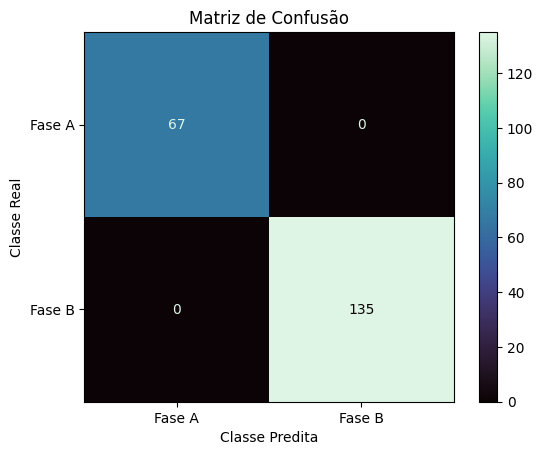

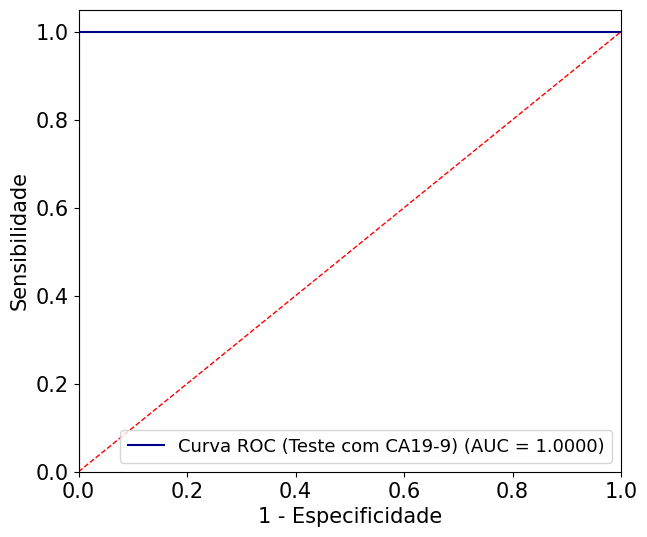

In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono3)

#### Cenário 3PV  - 99,28%

In [ ]:
df_pv3

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABC,3PV,0.331014,0.343910,0.325076,1,1,1
1,ABCg,3PV,0.330355,0.344608,0.325037,1,1,1
2,ABC,3PV,0.330424,0.344367,0.325209,1,1,1
3,ABCg,3PV,0.329682,0.345893,0.324425,1,1,1
4,ABC,3PV,0.331674,0.343926,0.324400,1,1,1
...,...,...,...,...,...,...,...,...
668,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
669,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
670,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
671,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_pv3['Classe'] = df_pv3['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=42,
                                                    stratify=rotulos)

##### ART Euclidiana

###### Busca Parametros

In [ ]:
param_grid = {
    'beta': np.arange(0.1, 0.15, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}

model = ART_Minkowski_AE_Classifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_Mono4, best_score, all_results = grid_search.fit(X.values, y.values)

print("Best parameters found:", best_params_Mono4)
print("Best AUC ROC:", best_score)

Best parameters found: {'beta': 0.1, 'rho': 0.00030000000000000003}
Best AUC ROC: 0.9967741935483871


###### Teste Melhor Parametro

In [ ]:
best_params_Mono4 = {'beta': 0.1, 'rho': 0.00030000000000000003}

Fold 1: 376 Amostras de Treino (126 Controle (0) e 250 Benigno (1) e 0 Cancer (2))
Fold 1: 95 Amostras de Teste (32 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 1: Acurácia = 1.0000
Fold 1: AUC = 1.0000


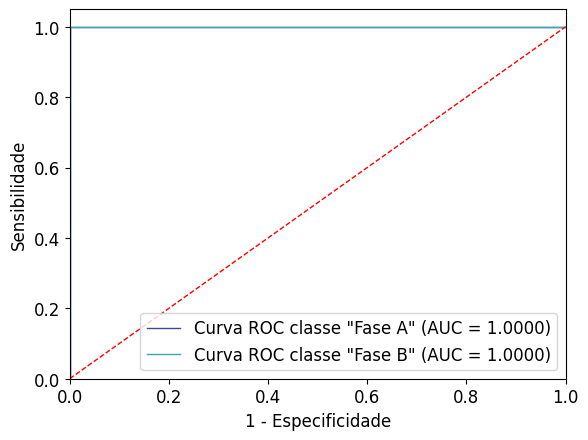

############################################################
Fold 2: 377 Amostras de Treino (127 Controle (0) e 250 Benigno (1) e 0 Cancer (2))
Fold 2: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 2: Acurácia = 0.9894
Fold 2: AUC = 0.9839


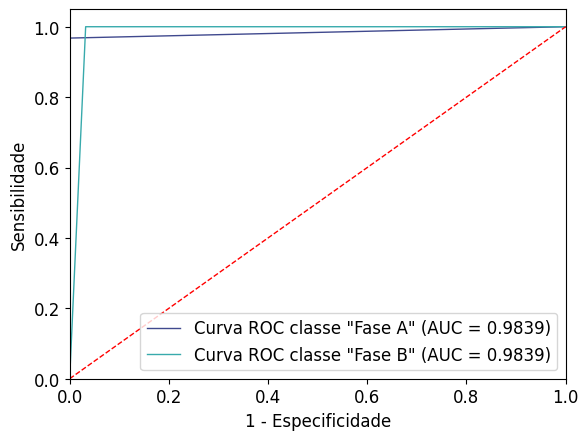

############################################################
Fold 3: 377 Amostras de Treino (127 Controle (0) e 250 Benigno (1) e 0 Cancer (2))
Fold 3: 94 Amostras de Teste (31 Controle (0) e 63 Benigno (1) e 0 Cancer (2))
Fold 3: Acurácia = 1.0000
Fold 3: AUC = 1.0000


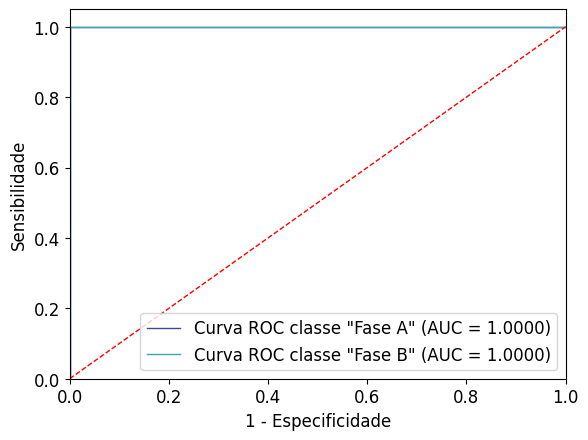

############################################################
Fold 4: 377 Amostras de Treino (126 Controle (0) e 251 Benigno (1) e 0 Cancer (2))
Fold 4: 94 Amostras de Teste (32 Controle (0) e 62 Benigno (1) e 0 Cancer (2))
Fold 4: Acurácia = 1.0000
Fold 4: AUC = 1.0000


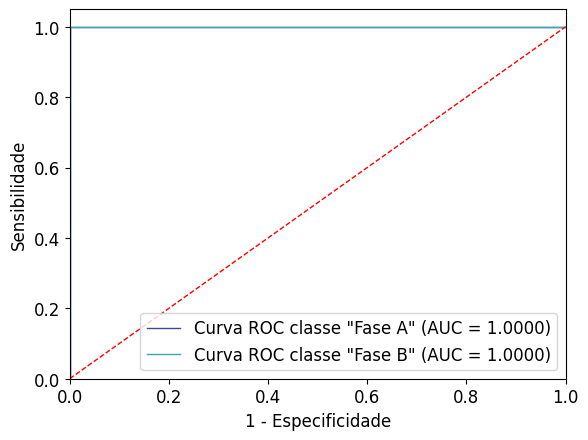

############################################################
Fold 5: 377 Amostras de Treino (126 Controle (0) e 251 Benigno (1) e 0 Cancer (2))
Fold 5: 94 Amostras de Teste (32 Controle (0) e 62 Benigno (1) e 0 Cancer (2))
Fold 5: Acurácia = 1.0000
Fold 5: AUC = 1.0000


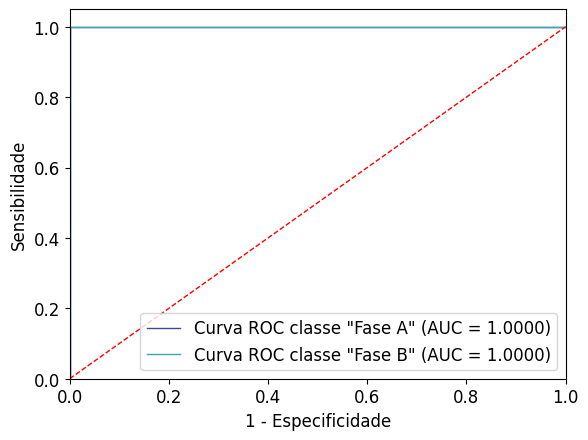

############################################################


In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

train_and_evaluate_model(X, y, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

In [ ]:
#_____________________TESTE_____________________

model = ART_Minkowski_AE_Classifier(**best_params_Mono4)
start_time_training = time.time()
model.fit(np.array(X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(X_test0))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(X_test0))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")


Tempo de Treinamento: 0.5206 segundos
Tempo de Previsão: 0.0084 segundos
Accuracy: 0.995049504950495
Sensitivity (Recall): 1.0
Specificity: 0.9852941176470589
----------------------
AUC: 0.9925


In [ ]:
test_and_evaluate_model_bin(X, y, X_test0, y_test0, ART_Minkowski_AE_Classifier, class_labels, best_params_Mono4)

## Análise de dados - Graficos

### Médias

In [19]:
def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols = columns, sheet_name=sheetname)
    return df

In [20]:
file_path_Normal = '/content/Sistema normal.xlsx'
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

df_normal = open_file(file_path_Normal, columns_to_open_normal, 0)
df_normal.head()

FileNotFoundError: [Errno 2] No such file or directory: '/content/Sistema normal.xlsx'

#### Curto Monofásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Monofásico')
df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

##### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_sem, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - Base')

fig.show()

##### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv1, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - 1PV')

fig.show()

##### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv2, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - 2PV')

fig.show()

##### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv3, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - 3PV')

fig.show()

#### Curto Bifásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Bifásico')
df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

##### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_sem, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - Base')

fig.show()

##### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv1, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - 1PV')

fig.show()

##### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv2, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - 2PV')
fig.show()

##### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv3, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - 3PV')

fig.show()

#### Curto Trifásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Trifásico')
df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['SEM GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

##### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_sem, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - Base')

fig.show()

##### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv1, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - 1PV')
fig.show()

##### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv2, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - 2PV')

fig.show()

##### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv3, x='Med_A', y='Med_B', z='Med_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - 3PV')

fig.show()

### Coeficiente

In [ ]:
def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols = columns, sheet_name=sheetname)
    return df

#### Curto Monofásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'd_A', 'd_B', 'd_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Monofásico')

df_mono[['d_A', 'd_B', 'd_C']] = abs(df_mono[['d_A', 'd_B', 'd_C']])

df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

##### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_sem, x='d_A', y='d_B', z='d_C',
              color='Classe')

fig.update_layout(title='Gráfico 3D Mono - Base')

fig.show()

##### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv1, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - 1PV')

fig.show()

##### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv2, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - 2PV')

fig.show()

##### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv3, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Mono - 3PV')

fig.show()

#### Curto Bifásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'd_A', 'd_B', 'd_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Bifásico')

df_mono[['d_A', 'd_B', 'd_C']] = abs(df_mono[['d_A', 'd_B', 'd_C']])

df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

##### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_sem, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - Base')

fig.show()

##### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv1, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - 1PV')

fig.show()

##### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv2, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - 2PV')
fig.show()

##### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv3, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Bi - 3PV')

fig.show()

#### Curto Trifásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'd_A', 'd_B', 'd_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Trifásico')

df_mono[['d_A', 'd_B', 'd_C']] = abs(df_mono[['d_A', 'd_B', 'd_C']])

df_mono.head()

In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['SEM GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

##### Cenário Base 100%

In [ ]:
df_sem

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_sem, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - Base')

fig.show()

##### Cenário 1PV - 99%

In [ ]:
df_pv1

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv1, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - 1PV')
fig.show()

##### Cenário 2PV - 100%

In [ ]:
df_pv2

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv2, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - 2PV')

fig.show()

##### Cenário 3PV  - 100%

In [ ]:
df_pv3

In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
fig = px.scatter_3d(df_pv3, x='d_A', y='d_B', z='d_C',
              color='Classe')
fig.update_layout(title='Gráfico 3D Tri - 3PV')

fig.show()

## Teste Autoencoder

In [ ]:
def open_file(file_path, columns, sheetname):
    # Load the Excel file
    df = pd.read_excel(file_path, usecols = columns, sheet_name=sheetname)
    return df

In [ ]:
file_path_Normal = '/content/Sistema normal.xlsx'
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

df_normal = open_file(file_path_Normal, columns_to_open_normal, 0)
df_normal.head()

,Curto,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Normal,0.363102,0.325921,0.310976,0,0,0
1,Normal,0.359694,0.331659,0.308647,0,0,0
2,Normal,0.364445,0.329305,0.306251,0,0,0
3,Normal,0.363511,0.329129,0.307360,0,0,0
4,Normal,0.368292,0.332670,0.299037,0,0,0


### Curto Monofásico

In [ ]:
file_path_Curto = '/content/Banco de dados-V3.xlsx'

columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path_Curto, columns_to_open, sheetname = 'Curto-Monofásico')
df_mono.head()

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,PV,0.085963,0.837879,0.076158,0,1,0
1,Ag,PV,0.841008,0.075763,0.083229,1,0,0
2,Cg,PV,0.083535,0.089299,0.827166,0,0,1
3,Bg,PV,0.088309,0.835994,0.075697,0,1,0
4,Ag,PV,0.830501,0.080201,0.089298,1,0,0


In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

Valores ausentes antes de remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64

Valores ausentes após remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64


In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

#### Cenário Base 100%

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,Sem GD,1.000000,0.136462,0.092848,1,0,0
1,Ag,Sem GD,0.142753,0.121070,1.000000,0,0,1
2,Cg,Sem GD,0.136181,1.000000,0.117918,0,1,0
3,Bg,Sem GD,1.000000,0.140095,0.096271,1,0,0
4,Ag,Sem GD,0.146335,0.124809,1.000000,0,0,1
...,...,...,...,...,...,...,...,...
884,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
885,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
886,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
887,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_sem[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_sem['Classe'] = indices_max + 1

In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_20 (Dense)            (None, 6)                 24        
                                                                 
 dense_21 (Dense)            (None, 8)                 56        
                                                                 
 dense_22 (Dense)            (None, 6)                 54        
                                                                 
 dense_23 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
28/28 [==============================] - 1s 8ms/step - loss: 0.1793 - mse: 0.1793 - val_loss: 0.1347 - val_mse: 0.1347
Epoch 2/100
28/28 [==============================] - 0s 5ms/step - loss: 0.1262 - mse: 0.1262 - val_loss: 0.1135 - val_mse: 0.1135
Epoch 3/100
28/28 [==============================] - 0s 3ms/step - loss: 0.1130 - mse: 0.1130 - val_loss: 0.1057 - val_mse: 0.1057
Epoch 4/100
28/28 [==============================] - 0s 4ms/step - loss: 0.1065 - mse: 0.1065 - val_loss: 0.1002 - val_mse: 0.1002
Epoch 5/100
28/28 [==============================] - 0s 5ms/step - loss: 0.1010 - mse: 0.1010 - val_loss: 0.0947 - val_mse: 0.0947
Epoch 6/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0953 - mse: 0.0953 - val_loss: 0.0888 - val_mse: 0.0888
Epoch 7/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0884 - mse: 0.0884 - val_loss: 0.0815 - val_mse: 0.0815
Epoch 8/100
28/28 [==============================] - 0s 5ms/step - loss: 0.0793 - m

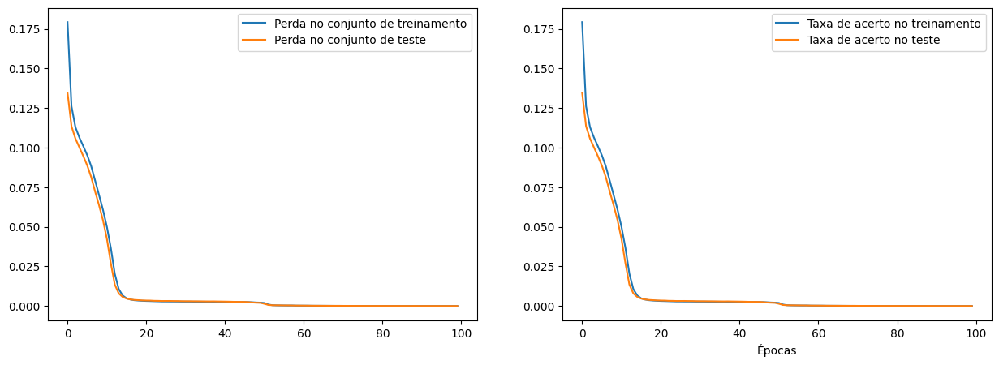

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

9/9 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

Best parameters found: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.0436 segundos
Tempo de Previsão: 0.0004 segundos
Accuracy: 0.9962546816479401
Sensitivity (Recall) Macro: 0.9963235294117647
Sensitivity (Recall) Micro: 0.9962546816479401
Especificidade (specificity) macro: 0.99875
Especificidade (specificity) micro: 0.9987515605493134
----------------------
AUC Micro: 0.9951675574071737
AUC Macro: 0.9957107843137255
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 0.9963
Macro Specificity: 0.9988
Macro F-score: 0.9975


Tempo de Treinamento: 0.0427 segundos
Tempo de Previsão: 0.0004 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro: 0.9963235294117647
Sensitivity (Recall) Micro: 0.9962546816479401
Especificidade (specificity) macro: 0.99875
Especificidade (specificity) micro: 0.9987515605493134
AUC: 0.9957107843137255


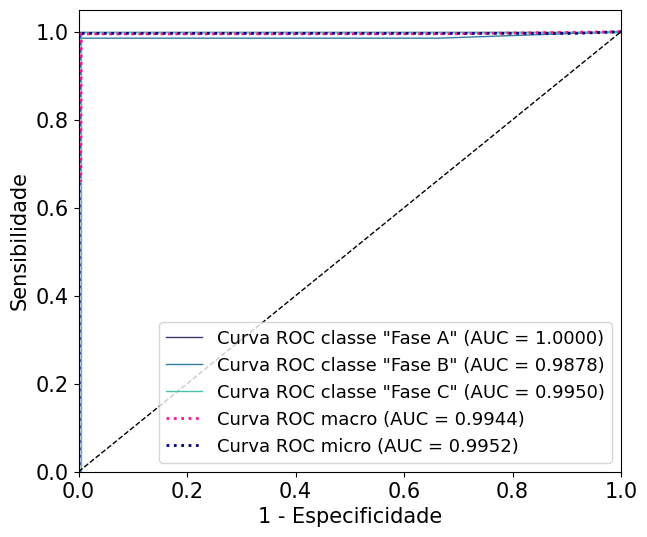

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 1PV - 99%

In [ ]:
df_pv1

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,PV,0.085963,0.837879,0.076158,0,1,0
1,Ag,PV,0.841008,0.075763,0.083229,1,0,0
2,Cg,PV,0.083535,0.089299,0.827166,0,0,1
3,Bg,PV,0.088309,0.835994,0.075697,0,1,0
4,Ag,PV,0.830501,0.080201,0.089298,1,0,0
...,...,...,...,...,...,...,...,...
883,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
884,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
885,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
886,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv1[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv1['Classe'] = indices_max + 1

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_4 (Dense)             (None, 6)                 24        
                                                                 
 dense_5 (Dense)             (None, 8)                 56        
                                                                 
 dense_6 (Dense)             (None, 6)                 54        
                                                                 
 dense_7 (Dense)             (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
28/28 [==============================] - 1s 11ms/step - loss: 0.0939 - mse: 0.0939 - val_loss: 0.0579 - val_mse: 0.0579
Epoch 2/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0539 - mse: 0.0539 - val_loss: 0.0453 - val_mse: 0.0453
Epoch 3/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457 - val_loss: 0.0397 - val_mse: 0.0397
Epoch 4/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0420 - mse: 0.0420 - val_loss: 0.0371 - val_mse: 0.0371
Epoch 5/100
28/28 [==============================] - 0s 5ms/step - loss: 0.0400 - mse: 0.0400 - val_loss: 0.0356 - val_mse: 0.0356
Epoch 6/100
28/28 [==============================] - 0s 5ms/step - loss: 0.0384 - mse: 0.0384 - val_loss: 0.0334 - val_mse: 0.0334
Epoch 7/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0355 - mse: 0.0355 - val_loss: 0.0305 - val_mse: 0.0305
Epoch 8/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0324 - 

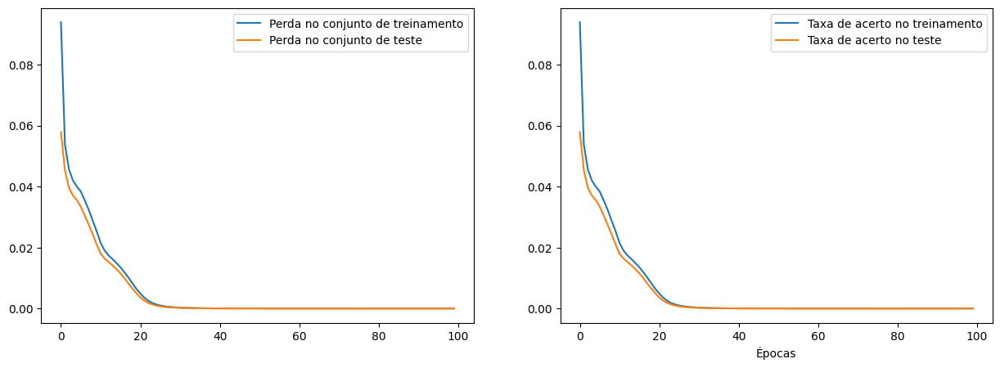

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

9/9 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'hidden_layer_sizes': 16, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 0.9972028309811828


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 16, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.0740 segundos
Tempo de Previsão: 0.0043 segundos
Accuracy: 0.9775280898876404
Sensitivity (Recall) Macro: 0.9781010230179028
Sensitivity (Recall) Micro: 0.9775280898876404
Especificidade (specificity) macro: 0.9925555997810837
Especificidade (specificity) micro: 0.9925093632958801
----------------------
AUC Micro: 0.9988216975971047
AUC Macro: 0.998149878680569
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750

Macro Sensitivity: 0.9781
Macro Specificity: 0.9926
Macro F-score: 0.9851


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.0687 segundos
Tempo de Previsão: 0.0015 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro: 0.9781010230179028
Sensitivity (Recall) Micro: 0.9775280898876404
Especificidade (specificity) macro: 0.9925555997810837
Especificidade (specificity) micro: 0.9925093632958801
AUC: 0.998149878680569


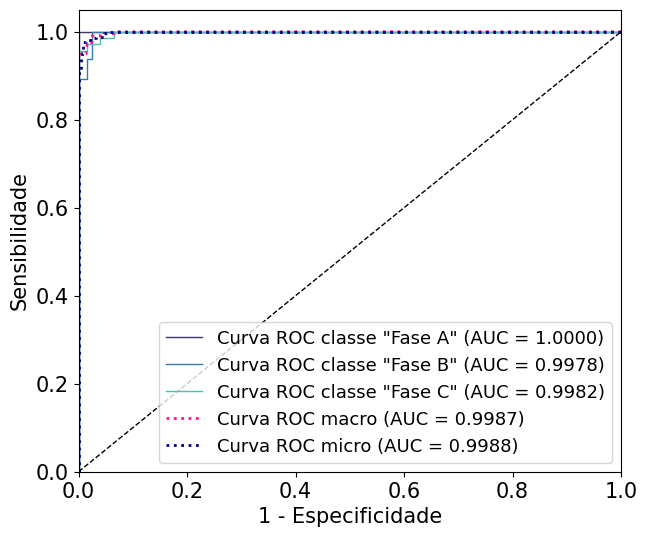

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,Bg,2PV,0.256889,0.474118,0.268993,0,1,0
1,Ag,2PV,0.456659,0.288096,0.255245,1,0,0
2,Cg,2PV,0.281233,0.272649,0.446117,0,0,1
3,Bg,2PV,0.277260,0.458462,0.264278,0,1,0
4,Ag,2PV,0.444514,0.285635,0.269851,1,0,0
...,...,...,...,...,...,...,...,...
884,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
885,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
886,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
887,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv2[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv2['Classe'] = indices_max + 1

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_8 (Dense)             (None, 6)                 24        
                                                                 
 dense_9 (Dense)             (None, 8)                 56        
                                                                 
 dense_10 (Dense)            (None, 6)                 54        
                                                                 
 dense_11 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
28/28 [==============================] - 1s 9ms/step - loss: 0.0679 - mse: 0.0679 - val_loss: 0.0325 - val_mse: 0.0325
Epoch 2/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254 - val_loss: 0.0199 - val_mse: 0.0199
Epoch 3/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175 - val_loss: 0.0151 - val_mse: 0.0151
Epoch 4/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142 - val_loss: 0.0132 - val_mse: 0.0132
Epoch 5/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128 - val_loss: 0.0124 - val_mse: 0.0124
Epoch 6/100
28/28 [==============================] - 0s 5ms/step - loss: 0.0122 - mse: 0.0122 - val_loss: 0.0121 - val_mse: 0.0121
Epoch 7/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119 - val_loss: 0.0119 - val_mse: 0.0119
Epoch 8/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0116 - m

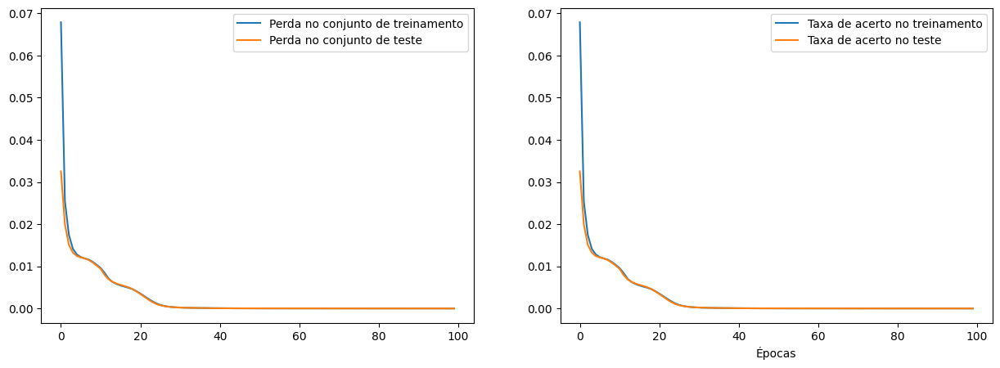

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

9/9 [==============================] - 0s 4ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 50}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 50}
Tempo de Treinamento: 0.0161 segundos
Tempo de Previsão: 0.0004 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC Micro: 1.0
AUC Macro: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 0.0154 segundos
Tempo de Previsão: 0.0003 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


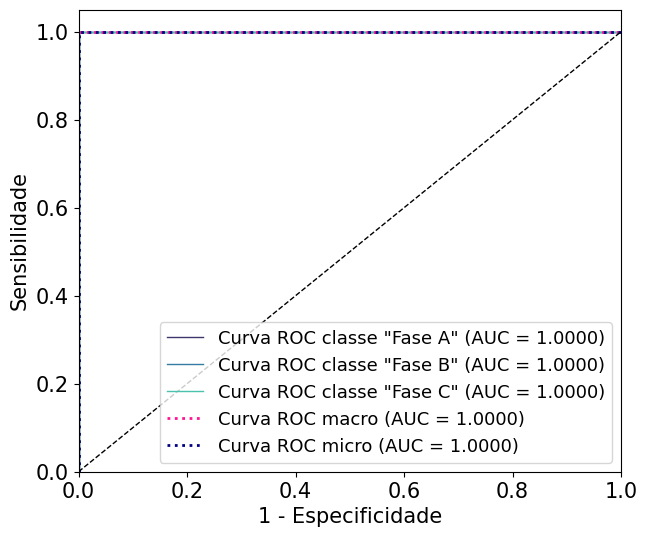

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 3PV  - 100%

In [ ]:
df_pv3

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,Bg,3PV,0.300864,0.381521,0.317615,0,1,0,2
1,Ag,3PV,0.373230,0.328740,0.298029,1,0,0,1
2,Cg,3PV,0.322597,0.306574,0.370828,0,0,1,3
3,Bg,3PV,0.305971,0.377429,0.316601,0,1,0,2
4,Ag,3PV,0.370176,0.330604,0.299220,1,0,0,1
...,...,...,...,...,...,...,...,...,...
883,Normal,NaN,0.359337,0.326926,0.313737,0,0,0,0
884,Normal,NaN,0.358834,0.328183,0.312982,0,0,0,0
885,Normal,NaN,0.354266,0.332146,0.313589,0,0,0,0
886,Normal,NaN,0.350639,0.333987,0.315374,0,0,0,0


In [ ]:
# Converte as colunas 'FASE A', 'FASE B' e 'FASE C' para numpy array
fases_array = df_pv3[['FASE A', 'FASE B', 'FASE C']].astype(float).to_numpy()

# Encontra o índice do máximo apenas se o máximo for igual a 1
indices_max = np.argmax(fases_array, axis=1)
indices_max[fases_array.max(axis=1) != 1] = -1  # Define como -1 quando o máximo não for 1

# Adiciona a coluna 'Classe' ao DataFrame 'df_sem' com base nos índices encontrados
df_pv3['Classe'] = indices_max + 1

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_12 (Dense)            (None, 6)                 24        
                                                                 
 dense_13 (Dense)            (None, 8)                 56        
                                                                 
 dense_14 (Dense)            (None, 6)                 54        
                                                                 
 dense_15 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
28/28 [==============================] - 1s 9ms/step - loss: 0.0622 - mse: 0.0622 - val_loss: 0.0257 - val_mse: 0.0257
Epoch 2/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190 - val_loss: 0.0131 - val_mse: 0.0131
Epoch 3/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113 - val_loss: 0.0085 - val_mse: 0.0085
Epoch 4/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0082 - mse: 0.0082 - val_loss: 0.0067 - val_mse: 0.0067
Epoch 5/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0069 - mse: 0.0069 - val_loss: 0.0061 - val_mse: 0.0061
Epoch 6/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0064 - mse: 0.0064 - val_loss: 0.0058 - val_mse: 0.0058
Epoch 7/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0062 - mse: 0.0062 - val_loss: 0.0056 - val_mse: 0.0056
Epoch 8/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0061 - m

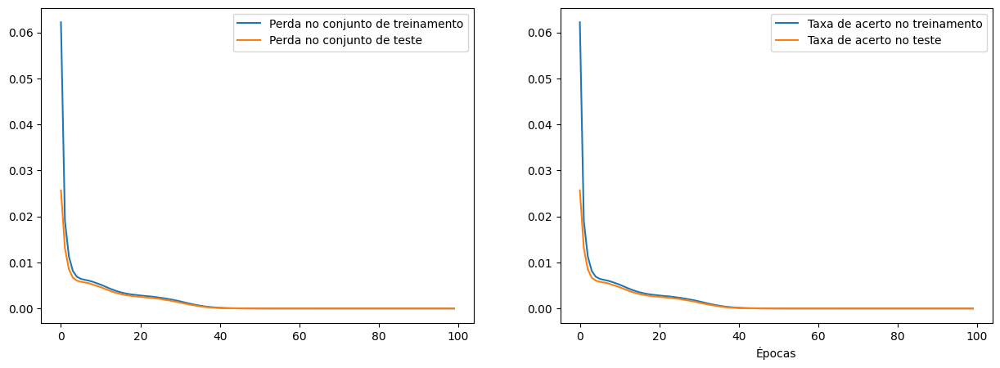

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

9/9 [==============================] - 0s 1ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

Best parameters found: {'hidden_layer_sizes': (12, 18), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 0.9978924406000693


###### Teste Melhor Parametro

In [ ]:
ddddddddeprint('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': (12, 18), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.1074 segundos
Tempo de Previsão: 0.0013 segundos
Accuracy: 0.9588014981273408
Sensitivity (Recall) Macro: 0.9581464847707166
Sensitivity (Recall) Micro: 0.9588014981273408
Especificidade (specificity) macro: 0.9862431588636251
Especificidade (specificity) micro: 0.9862671660424469
----------------------
AUC Micro: 0.9988170217939186
AUC Macro: 0.9980527228112829
Class 0: Sensitivity = 0.8769, Specificity = 0.9851, F-score = 0.9279
Class 1: Sensitivity = 0.9706, Specificity = 0.9648, F-score = 0.9677
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 0.9950, F-score = 0.9900

Macro Sensitivity: 0.9581
Macro Specificity: 0.9862
Macro F-score: 0.9714


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.1003 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 95.88014981%
Sensitivity (Recall) Macro: 0.9581464847707166
Sensitivity (Recall) Micro: 0.9588014981273408
Especificidade (specificity) macro: 0.9862431588636251
Especificidade (specificity) micro: 0.9862671660424469
AUC: 0.9980527228112829


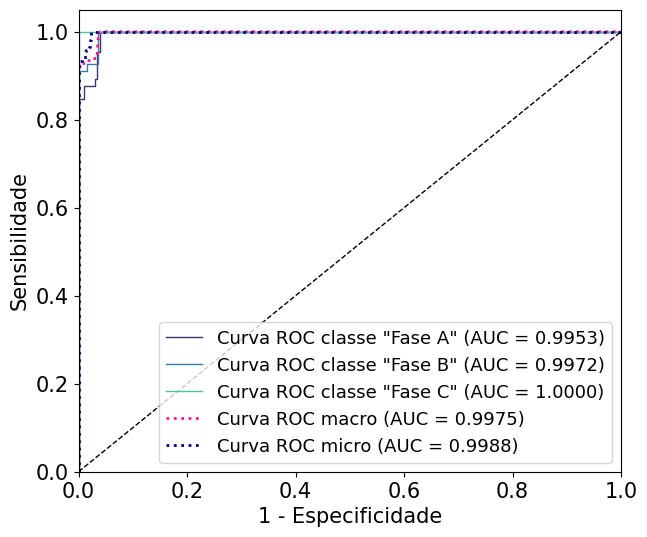

In [ ]:
# Defina os rótulos das classes
class_labels = ["Fase A", "Fase B", "Fase C"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

### Curto Bifásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Bifásico')
df_mono.head()

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,PV,0.425944,0.172468,0.401587,1.0,0.0,1.0
1,BCg,PV,0.152086,0.427308,0.420606,0.0,1.0,1.0
2,ABg,PV,0.415248,0.453407,0.131345,1.0,1.0,0.0
3,AC,PV,0.432785,0.199104,0.368111,1.0,0.0,1.0
4,BC,PV,0.204604,0.380720,0.414675,0.0,1.0,1.0


In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

Valores ausentes antes de remover linhas:
Curto         4
Tipo de GD    4
Med_A         4
Med_B         3
Med_C         4
FASE A        4
FASE B        4
FASE C        4
dtype: int64

Valores ausentes após remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64


In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['Sem GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

#### Cenário Base - 100%

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,Sem GD,0.825285,0.026547,1.000000,1.0,0.0,1.0
1,BCg,Sem GD,0.029526,1.000000,0.819196,0.0,1.0,1.0
2,ABg,Sem GD,1.000000,0.833272,0.021076,1.0,1.0,0.0
3,AC,Sem GD,0.949180,0.058432,1.000000,1.0,0.0,1.0
4,BC,Sem GD,0.065444,1.000000,0.947361,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...
1560,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1561,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1562,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1563,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_sem['Classe'] = df_sem['Curto'].str.strip().replace(mapping)

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,ACg,Sem GD,0.825285,0.026547,1.000000,1.0,0.0,1.0,1
1,BCg,Sem GD,0.029526,1.000000,0.819196,0.0,1.0,1.0,2
2,ABg,Sem GD,1.000000,0.833272,0.021076,1.0,1.0,0.0,3
3,AC,Sem GD,0.949180,0.058432,1.000000,1.0,0.0,1.0,1
4,BC,Sem GD,0.065444,1.000000,0.947361,0.0,1.0,1.0,2
...,...,...,...,...,...,...,...,...,...
1560,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0,0
1561,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0,0
1562,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0,0
1563,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0,0


In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_28 (Dense)            (None, 6)                 24        
                                                                 
 dense_29 (Dense)            (None, 8)                 56        
                                                                 
 dense_30 (Dense)            (None, 6)                 54        
                                                                 
 dense_31 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
48/48 [==============================] - 1s 7ms/step - loss: 0.2490 - mse: 0.2490 - val_loss: 0.1802 - val_mse: 0.1802
Epoch 2/100
48/48 [==============================] - 0s 4ms/step - loss: 0.1458 - mse: 0.1458 - val_loss: 0.1386 - val_mse: 0.1386
Epoch 3/100
48/48 [==============================] - 0s 3ms/step - loss: 0.1198 - mse: 0.1198 - val_loss: 0.1192 - val_mse: 0.1192
Epoch 4/100
48/48 [==============================] - 0s 3ms/step - loss: 0.1028 - mse: 0.1028 - val_loss: 0.1001 - val_mse: 0.1001
Epoch 5/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0814 - mse: 0.0814 - val_loss: 0.0731 - val_mse: 0.0731
Epoch 6/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0559 - mse: 0.0559 - val_loss: 0.0470 - val_mse: 0.0470
Epoch 7/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0350 - mse: 0.0350 - val_loss: 0.0292 - val_mse: 0.0292
Epoch 8/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0229 - m

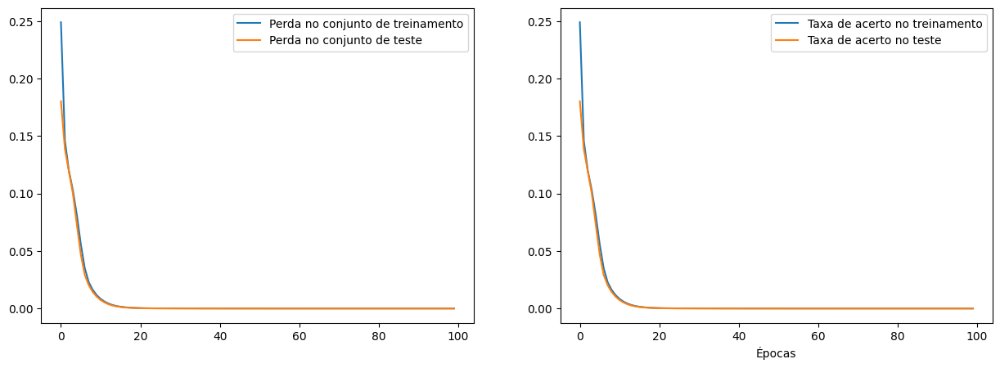

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

15/15 [==============================] - 0s 1ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

Best parameters found: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 50}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 50}
Tempo de Treinamento: 0.0217 segundos
Tempo de Previsão: 0.0005 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC Micro: 1.0
AUC Macro: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


Tempo de Treinamento: 0.0223 segundos
Tempo de Previsão: 0.0004 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


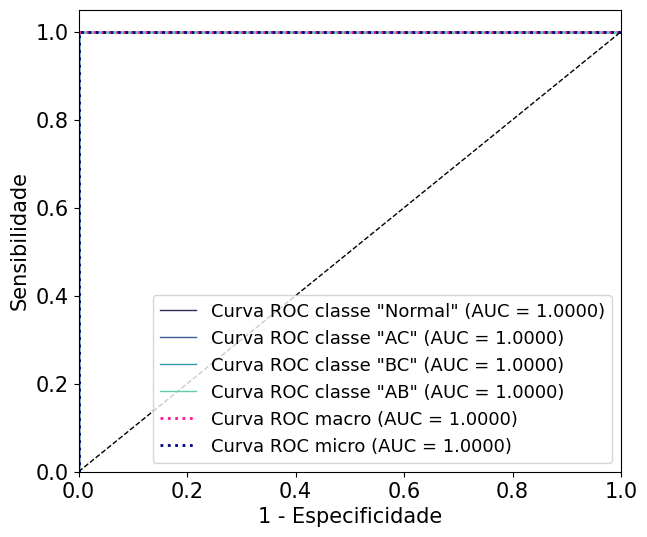

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "AC", "BC", "AB"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 1PV - 100%

In [ ]:
df_pv1

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,PV,0.425944,0.172468,0.401587,1.0,0.0,1.0
1,BCg,PV,0.152086,0.427308,0.420606,0.0,1.0,1.0
2,ABg,PV,0.415248,0.453407,0.131345,1.0,1.0,0.0
3,AC,PV,0.432785,0.199104,0.368111,1.0,0.0,1.0
4,BC,PV,0.204604,0.380720,0.414675,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...
1555,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1556,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1557,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1558,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_pv1['Classe'] = df_pv1['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_20 (Dense)            (None, 6)                 24        
                                                                 
 dense_21 (Dense)            (None, 8)                 56        
                                                                 
 dense_22 (Dense)            (None, 6)                 54        
                                                                 
 dense_23 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
48/48 [==============================] - 1s 7ms/step - loss: 0.0515 - mse: 0.0515 - val_loss: 0.0242 - val_mse: 0.0242
Epoch 2/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198 - val_loss: 0.0162 - val_mse: 0.0162
Epoch 3/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155 - val_loss: 0.0142 - val_mse: 0.0142
Epoch 4/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139 - val_loss: 0.0128 - val_mse: 0.0128
Epoch 5/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121 - val_loss: 0.0109 - val_mse: 0.0109
Epoch 6/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105 - val_loss: 0.0096 - val_mse: 0.0096
Epoch 7/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093 - val_loss: 0.0084 - val_mse: 0.0084
Epoch 8/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0079 - m

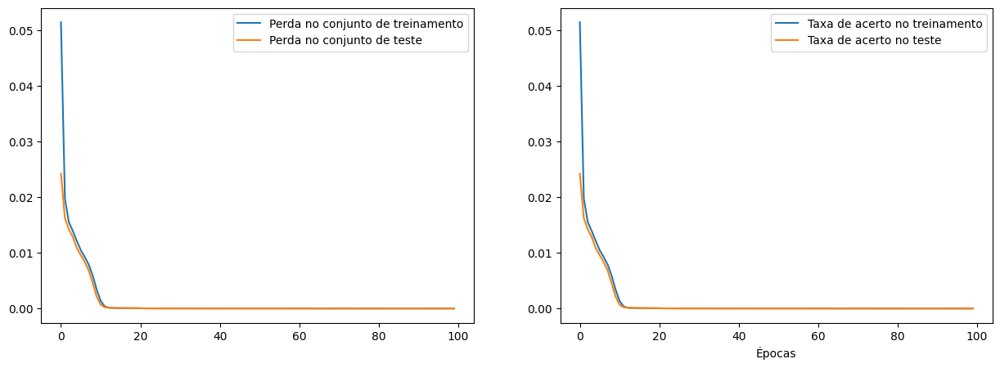

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

15/15 [==============================] - 0s 1ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'sgd', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'sgd', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 2.3880 segundos
Tempo de Previsão: 0.0013 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC Micro: 1.0
AUC Macro: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Tempo de Treinamento: 2.3455 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


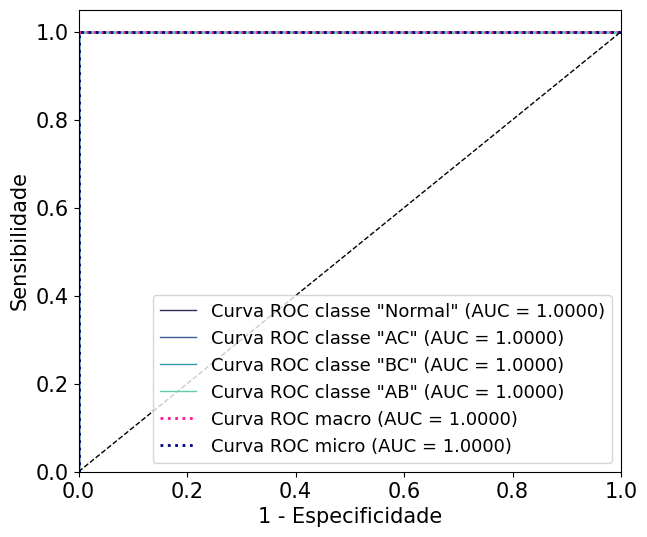

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "AC", "BC", "AB"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,BCg,2PV,0.107321,0.489054,0.403624,0.0,1.0,1.0
1,ABg,2PV,0.485277,0.467065,0.047658,1.0,1.0,0.0
2,AC,2PV,0.442965,0.090000,0.467035,1.0,0.0,1.0
3,BC,2PV,0.120597,0.485231,0.394172,0.0,1.0,1.0
4,AB,2PV,0.499229,0.450149,0.050622,1.0,1.0,0.0
...,...,...,...,...,...,...,...,...
1555,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1556,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1557,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1558,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_pv2['Classe'] = df_pv2['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense_32 (Dense)            (None, 6)                 24        
                                                                 
 dense_33 (Dense)            (None, 8)                 56        
                                                                 
 dense_34 (Dense)            (None, 6)                 54        
                                                                 
 dense_35 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
48/48 [==============================] - 1s 6ms/step - loss: 0.0500 - mse: 0.0500 - val_loss: 0.0226 - val_mse: 0.0226
Epoch 2/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181 - val_loss: 0.0148 - val_mse: 0.0148
Epoch 3/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140 - val_loss: 0.0130 - val_mse: 0.0130
Epoch 4/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127 - val_loss: 0.0119 - val_mse: 0.0119
Epoch 5/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112 - val_loss: 0.0101 - val_mse: 0.0101
Epoch 6/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095 - val_loss: 0.0087 - val_mse: 0.0087
Epoch 7/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0080 - mse: 0.0080 - val_loss: 0.0071 - val_mse: 0.0071
Epoch 8/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0061 - m

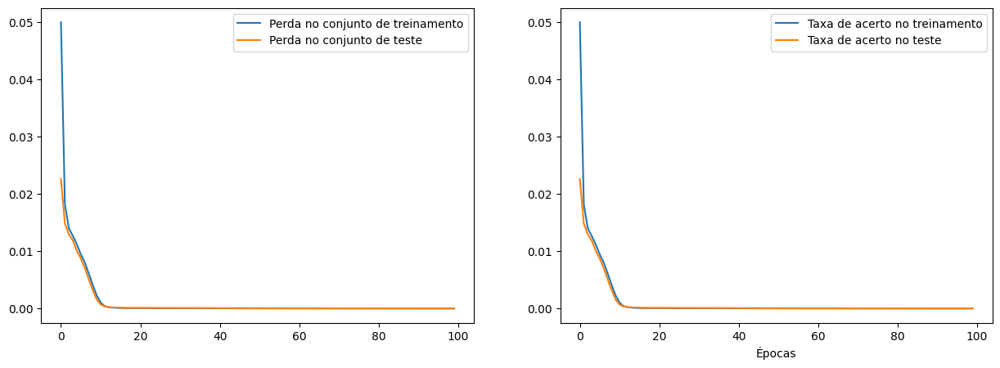

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

15/15 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'adam', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 4, 'activation': 'relu', 'solver': 'adam', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 2.7887 segundos
Tempo de Previsão: 0.0011 segundos
Accuracy: 1.0
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
----------------------
AUC Micro: 1.0
AUC Macro: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 1.0000
Macro Specificity: 1.0000
Macro F-score: 1.0000


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Tempo de Treinamento: 2.8964 segundos
Tempo de Previsão: 0.0012 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro: 1.0
Sensitivity (Recall) Micro: 1.0
Especificidade (specificity) macro: 1.0
Especificidade (specificity) micro: 1.0
AUC: 1.0


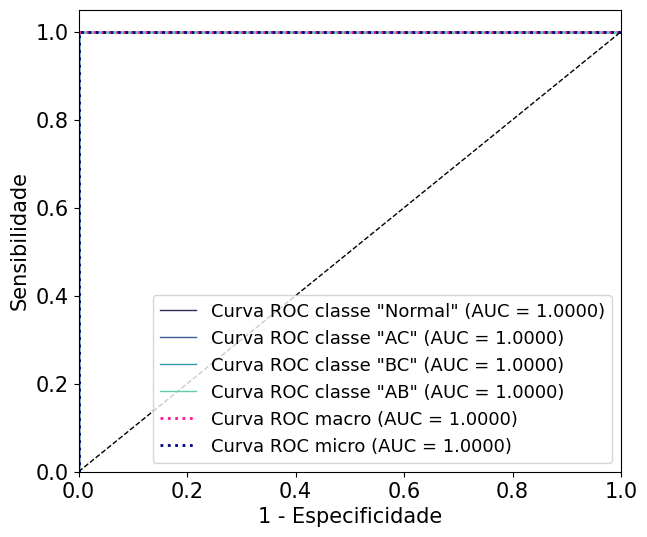

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "AC", "BC", "AB"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 3PV  - 100%

In [ ]:
df_pv3

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ACg,3PV,0.383774,0.244009,0.372217,1.0,0.0,1.0
1,BCg,3PV,0.227219,0.392287,0.380493,0.0,1.0,1.0
2,ABg,3PV,0.380190,0.400903,0.218907,1.0,1.0,0.0
3,AC,3PV,0.393906,0.247290,0.358804,1.0,0.0,1.0
4,BC,3PV,0.233677,0.368877,0.397446,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...
1555,Normal,NaN,0.359337,0.326926,0.313737,0.0,0.0,0.0
1556,Normal,NaN,0.358834,0.328183,0.312982,0.0,0.0,0.0
1557,Normal,NaN,0.354266,0.332146,0.313589,0.0,0.0,0.0
1558,Normal,NaN,0.350639,0.333987,0.315374,0.0,0.0,0.0


In [ ]:
mapping = {'Normal': 0,'ACg': 1, 'AC': 1, 'BCg': 2, 'BC': 2, 'ABg': 3, 'AB': 3}
df_pv3['Classe'] = df_pv3['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 3)]               0         
                                                                 
 dense_36 (Dense)            (None, 6)                 24        
                                                                 
 dense_37 (Dense)            (None, 8)                 56        
                                                                 
 dense_38 (Dense)            (None, 6)                 54        
                                                                 
 dense_39 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
48/48 [==============================] - 1s 6ms/step - loss: 0.0425 - mse: 0.0425 - val_loss: 0.0140 - val_mse: 0.0140
Epoch 2/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096 - val_loss: 0.0066 - val_mse: 0.0066
Epoch 3/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0059 - mse: 0.0059 - val_loss: 0.0051 - val_mse: 0.0051
Epoch 4/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0053 - mse: 0.0053 - val_loss: 0.0048 - val_mse: 0.0048
Epoch 5/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0049 - mse: 0.0049 - val_loss: 0.0043 - val_mse: 0.0043
Epoch 6/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0044 - mse: 0.0044 - val_loss: 0.0038 - val_mse: 0.0038
Epoch 7/100
48/48 [==============================] - 0s 3ms/step - loss: 0.0040 - mse: 0.0040 - val_loss: 0.0034 - val_mse: 0.0034
Epoch 8/100
48/48 [==============================] - 0s 4ms/step - loss: 0.0036 - m

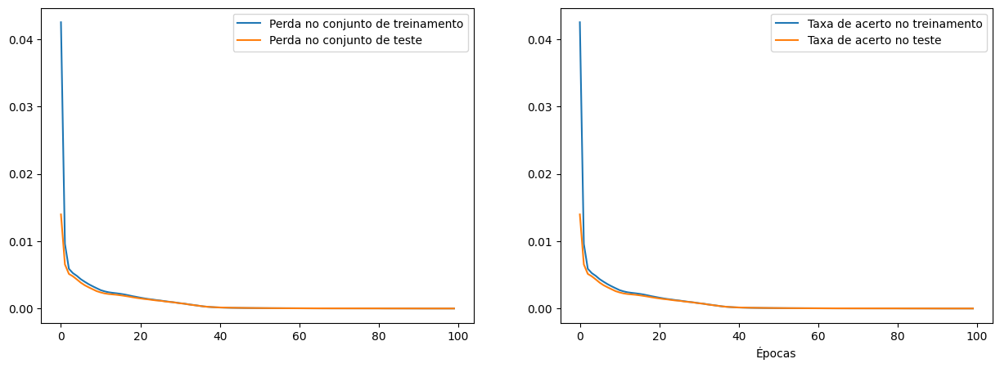

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

15/15 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

Best parameters found: {'hidden_layer_sizes': 10, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

recall_macro = recall_score(y_true, y_pred_classes, average='macro')
recall_micro = recall_score(y_true, y_pred_classes, average='micro')
specificity_macro = specificity_score(y_true, y_pred_classes, average='macro')
specificity_micro = specificity_score(y_true, y_pred_classes, average='micro')

auc_macro = roc_auc_score(y_test, predicted_probabilities, average='macro', multi_class='ovo')
auc_micro = roc_auc_score(y_test, predicted_probabilities, average='micro', multi_class='ovr')

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall) Macro:", recall_macro)
print("Sensitivity (Recall) Micro:", recall_micro)
print("Especificidade (specificity) macro:", specificity_macro)
print("Especificidade (specificity) micro:", specificity_micro)
print("----------------------")
print(f"AUC Micro: {auc_micro}")
print(f"AUC Macro: {auc_macro}")

# Calculate Sensitivity, Specificity, and F-score for each class manually
conf_matrix = confusion_matrix(y_test, predicted_labels)
num_classes = len(conf_matrix)

macro_sensitivity = 0
macro_specificity = 0
macro_f_score = 0

for i in range(num_classes):
    TP = conf_matrix[i, i]
    FP = np.sum(conf_matrix[:, i]) - TP
    FN = np.sum(conf_matrix[i, :]) - TP
    TN = np.sum(conf_matrix) - TP - FP - FN

    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)
    f_score = 2 * (sensitivity * specificity) / (sensitivity + specificity)

    macro_sensitivity += sensitivity
    macro_specificity += specificity
    macro_f_score += f_score

    print(f"Class {i}: Sensitivity = {sensitivity:.4f}, Specificity = {specificity:.4f}, F-score = {f_score:.4f}")

macro_sensitivity /= num_classes
macro_specificity /= num_classes
macro_f_score /= num_classes

print(f"\nMacro Sensitivity: {macro_sensitivity:.4f}")
print(f"Macro Specificity: {macro_specificity:.4f}")
print(f"Macro F-score: {macro_f_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 10, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.0996 segundos
Tempo de Previsão: 0.0013 segundos
Accuracy: 0.9978632478632479
Sensitivity (Recall) Macro: 0.9981481481481481
Sensitivity (Recall) Micro: 0.9978632478632479
Especificidade (specificity) macro: 0.999379652605459
Especificidade (specificity) micro: 0.9992877492877493
----------------------
AUC Micro: 0.9999984780967688
AUC Macro: 1.0
Class 0: Sensitivity = 1.0000, Specificity = 0.9975, F-score = 0.9988
Class 1: Sensitivity = 0.9926, Specificity = 1.0000, F-score = 0.9963
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

Macro Sensitivity: 0.9981
Macro Specificity: 0.9994
Macro F-score: 0.9988


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.0781 segundos
Tempo de Previsão: 0.0018 segundos
Acurácia: 99.78632479%
Sensitivity (Recall) Macro: 0.9981481481481481
Sensitivity (Recall) Micro: 0.9978632478632479
Especificidade (specificity) macro: 0.999379652605459
Especificidade (specificity) micro: 0.9992877492877493
AUC: 1.0


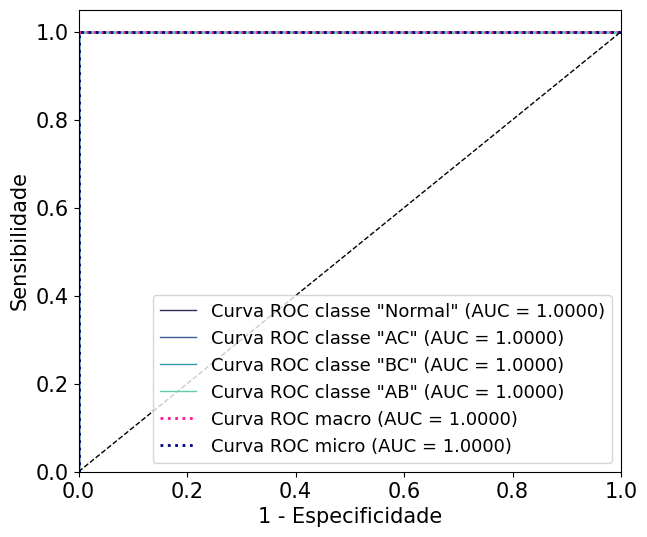

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "AC", "BC", "AB"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

### Curto Trifásico

In [ ]:
file_path = '/content/Banco de dados-V3.xlsx'
columns_to_open = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']

# Call the function with the file path and columns
df_mono = open_file(file_path, columns_to_open, sheetname = 'Curto-Trifásico')
df_mono.head()

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,PV,0.325948,0.340872,0.333180,1,1,1
1,ABCg,PV,0.328829,0.339757,0.331414,1,1,1
2,ABCg,PV,0.325523,0.341083,0.333395,1,1,1
3,ABCg,PV,0.327916,0.340147,0.331936,1,1,1
4,ABCg,PV,0.325130,0.341213,0.333657,1,1,1


In [ ]:
# Verifica valores ausentes
print("Valores ausentes antes de remover linhas:")
print(df_mono.isnull().sum())

# Remove linhas com valores ausentes
df_mono.dropna(inplace=True)

# Verifica valores ausentes após remover linhas
print("\nValores ausentes após remover linhas:")
print(df_mono.isnull().sum())

Valores ausentes antes de remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64

Valores ausentes após remover linhas:
Curto         0
Tipo de GD    0
Med_A         0
Med_B         0
Med_C         0
FASE A        0
FASE B        0
FASE C        0
dtype: int64


In [ ]:
import numpy as np

# Configuração para exibir valores não suprimidos
np.set_printoptions(suppress=False)

# Agrupa o DataFrame pelo tipo de GD
grupos_pv = df_mono.groupby('Tipo de GD')

# Cria um dicionário para armazenar os DataFrames separados
dataframes_separados = {}

# Itera sobre cada grupo e cria um DataFrame separado para cada tipo de GD
for tipo, grupo in grupos_pv:
    dataframes_separados[tipo] = grupo

# Acessa os DataFrames separados por tipo de GD
df_pv1 = dataframes_separados['PV']
df_pv2 = dataframes_separados['2PV']
df_pv3 = dataframes_separados['3PV']
df_sem = dataframes_separados['SEM GD']

# Concatena o DataFrame 'Normal' com cada DataFrame
df_pv1 = pd.concat([df_pv1, df_normal], ignore_index=True)
df_pv2 = pd.concat([df_pv2, df_normal], ignore_index=True)
df_pv3 = pd.concat([df_pv3, df_normal], ignore_index=True)
df_sem = pd.concat([df_sem, df_normal], ignore_index=True)

#### Cenário Base - 100%

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,SEM GD,0.330884,0.346779,0.322337,1,1,1
1,Ruído,SEM GD,0.065536,0.065536,0.065536,0,0,0
2,Ruído,SEM GD,0.029519,0.029519,0.029519,0,0,0
3,Ruído,SEM GD,0.021078,0.021078,0.021078,0,0,0
4,Ruído,SEM GD,0.026481,0.026481,0.026481,0,0,0
...,...,...,...,...,...,...,...,...
666,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
667,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
668,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
669,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_sem['Classe'] = df_sem['Curto'].str.strip().replace(mapping)

In [ ]:
df_sem

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C,Classe
0,ABCg,SEM GD,0.330884,0.346779,0.322337,1,1,1,1
1,Ruído,SEM GD,0.065536,0.065536,0.065536,0,0,0,0
2,Ruído,SEM GD,0.029519,0.029519,0.029519,0,0,0,0
3,Ruído,SEM GD,0.021078,0.021078,0.021078,0,0,0,0
4,Ruído,SEM GD,0.026481,0.026481,0.026481,0,0,0,0
...,...,...,...,...,...,...,...,...,...
666,Normal,NaN,0.359337,0.326926,0.313737,0,0,0,0
667,Normal,NaN,0.358834,0.328183,0.312982,0,0,0,0
668,Normal,NaN,0.354266,0.332146,0.313589,0,0,0,0
669,Normal,NaN,0.350639,0.333987,0.315374,0,0,0,0


In [ ]:
dados = df_sem[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_sem['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 3)]               0         
                                                                 
 dense_40 (Dense)            (None, 6)                 24        
                                                                 
 dense_41 (Dense)            (None, 8)                 56        
                                                                 
 dense_42 (Dense)            (None, 6)                 54        
                                                                 
 dense_43 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
21/21 [==============================] - 1s 11ms/step - loss: 0.3605 - mse: 0.3605 - val_loss: 0.2267 - val_mse: 0.2267
Epoch 2/100
21/21 [==============================] - 0s 4ms/step - loss: 0.1627 - mse: 0.1627 - val_loss: 0.0886 - val_mse: 0.0886
Epoch 3/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0751 - mse: 0.0751 - val_loss: 0.0531 - val_mse: 0.0531
Epoch 4/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0459 - mse: 0.0459 - val_loss: 0.0327 - val_mse: 0.0327
Epoch 5/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287 - val_loss: 0.0210 - val_mse: 0.0210
Epoch 6/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0185 - mse: 0.0185 - val_loss: 0.0143 - val_mse: 0.0143
Epoch 7/100
21/21 [==============================] - 0s 7ms/step - loss: 0.0125 - mse: 0.0125 - val_loss: 0.0102 - val_mse: 0.0102
Epoch 8/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0089 - 

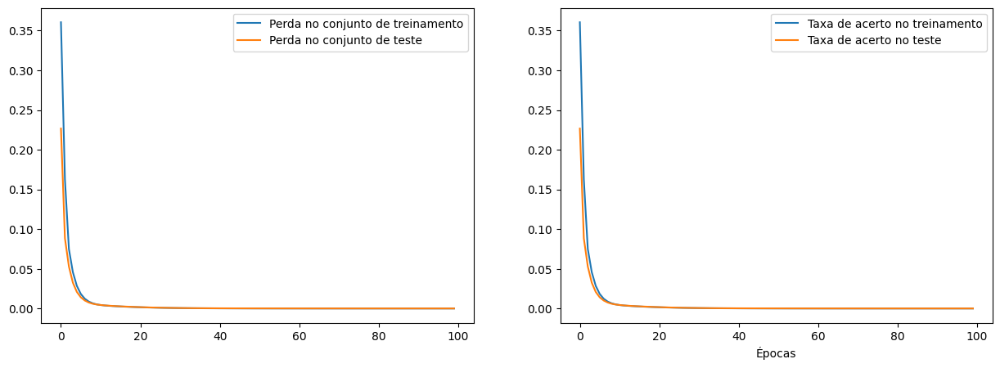

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

7/7 [==============================] - 0s 3ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'hidden_layer_sizes': (12, 6), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 0.9785970302099333


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")

melhores parametros: {'hidden_layer_sizes': (12, 6), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.0754 segundos
Tempo de Previsão: 0.0011 segundos
Accuracy: 0.9504950495049505
Sensitivity (Recall): 0.9259259259259259
Specificity: 1.0
----------------------
AUC: 0.9679


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.0907 segundos
Tempo de Previsão: 0.0013 segundos
Acurácia = 0.9505
Precisão = 1.0000
Sensibilidade = 0.9259
F-score = 0.9615
Coeficiente de Correlação de Matthews = 0.8976
AUC = 0.9679
############################################################


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


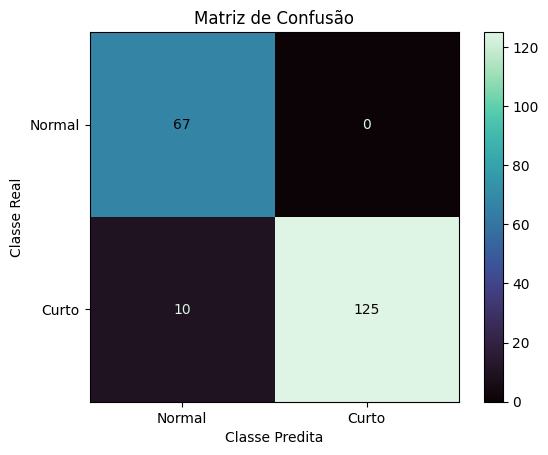

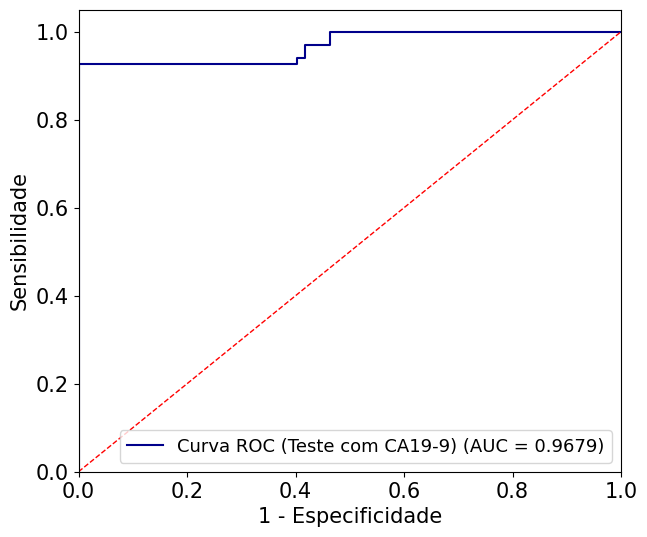

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "Curto"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model_bin(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 1PV - 100%

In [ ]:
df_pv1

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,PV,0.325948,0.340872,0.333180,1,1,1
1,ABCg,PV,0.328829,0.339757,0.331414,1,1,1
2,ABCg,PV,0.325523,0.341083,0.333395,1,1,1
3,ABCg,PV,0.327916,0.340147,0.331936,1,1,1
4,ABCg,PV,0.325130,0.341213,0.333657,1,1,1
...,...,...,...,...,...,...,...,...
663,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
664,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
665,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
666,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_pv1['Classe'] = df_pv1['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv1[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv1['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 3)]               0         
                                                                 
 dense_44 (Dense)            (None, 6)                 24        
                                                                 
 dense_45 (Dense)            (None, 8)                 56        
                                                                 
 dense_46 (Dense)            (None, 6)                 54        
                                                                 
 dense_47 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
21/21 [==============================] - 1s 13ms/step - loss: 0.0651 - mse: 0.0651 - val_loss: 0.0343 - val_mse: 0.0343
Epoch 2/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196 - val_loss: 0.0118 - val_mse: 0.0118
Epoch 3/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0088 - mse: 0.0088 - val_loss: 0.0059 - val_mse: 0.0059
Epoch 4/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0044 - mse: 0.0044 - val_loss: 0.0030 - val_mse: 0.0030
Epoch 5/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0023 - mse: 0.0023 - val_loss: 0.0016 - val_mse: 0.0016
Epoch 6/100
21/21 [==============================] - 0s 7ms/step - loss: 0.0012 - mse: 0.0012 - val_loss: 8.7913e-04 - val_mse: 8.7913e-04
Epoch 7/100
21/21 [==============================] - 0s 4ms/step - loss: 7.4130e-04 - mse: 7.4130e-04 - val_loss: 5.7288e-04 - val_mse: 5.7288e-04
Epoch 8/100
21/21 [==============================] - 0s 4m

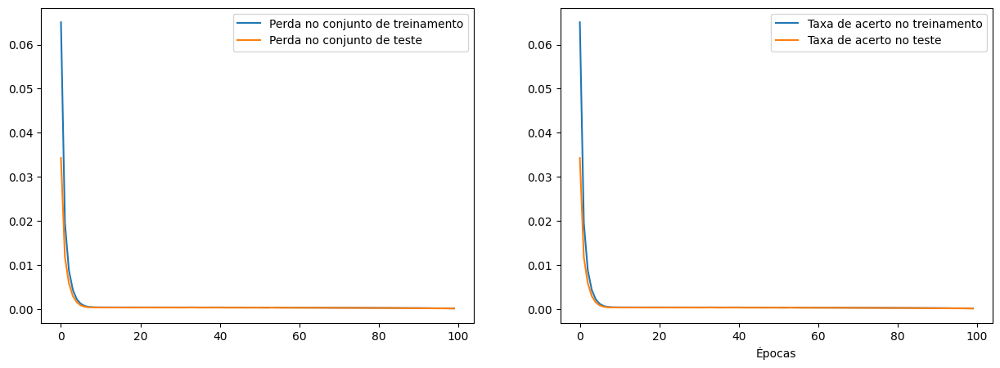

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

7/7 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters found: {'hidden_layer_sizes': 24, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 1.0


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")

melhores parametros: {'hidden_layer_sizes': 24, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.1217 segundos
Tempo de Previsão: 0.0005 segundos
Accuracy: 0.7611940298507462
Sensitivity (Recall): 0.7703703703703704
Specificity: 0.7424242424242424
----------------------
AUC: 0.9407


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.1256 segundos
Tempo de Previsão: 0.0004 segundos
Acurácia = 0.7612
Precisão = 0.8595
Sensibilidade = 0.7704
F-score = 0.8125
Coeficiente de Correlação de Matthews = 0.4920
AUC = 0.9407
############################################################


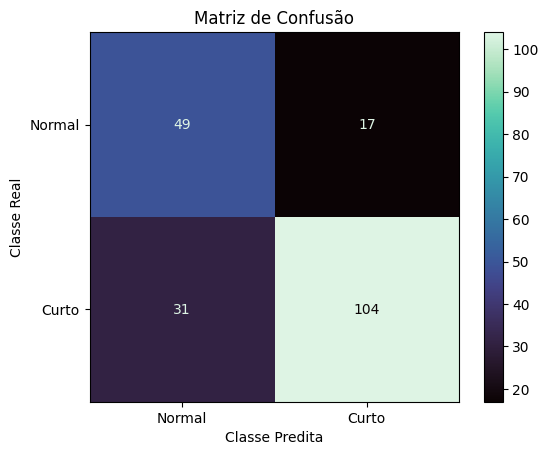

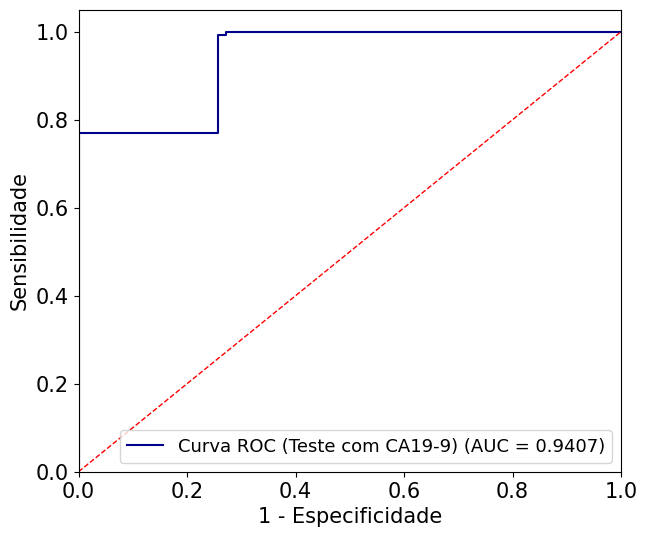

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "Curto"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model_bin(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 2PV - 100%

In [ ]:
df_pv2

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABCg,2PV,0.330876,0.346613,0.322511,1,1,1
1,ABC,2PV,0.335206,0.345518,0.319276,1,1,1
2,ABCg,2PV,0.330878,0.346578,0.322544,1,1,1
3,ABC,2PV,0.335195,0.345522,0.319283,1,1,1
4,ABCg,2PV,0.330901,0.346608,0.322491,1,1,1
...,...,...,...,...,...,...,...,...
668,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
669,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
670,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
671,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_pv2['Classe'] = df_pv2['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv2[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv2['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_13 (InputLayer)       [(None, 3)]               0         
                                                                 
 dense_48 (Dense)            (None, 6)                 24        
                                                                 
 dense_49 (Dense)            (None, 8)                 56        
                                                                 
 dense_50 (Dense)            (None, 6)                 54        
                                                                 
 dense_51 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
21/21 [==============================] - 1s 11ms/step - loss: 0.0647 - mse: 0.0647 - val_loss: 0.0335 - val_mse: 0.0335
Epoch 2/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190 - val_loss: 0.0118 - val_mse: 0.0118
Epoch 3/100
21/21 [==============================] - 0s 3ms/step - loss: 0.0087 - mse: 0.0087 - val_loss: 0.0059 - val_mse: 0.0059
Epoch 4/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0043 - mse: 0.0043 - val_loss: 0.0029 - val_mse: 0.0029
Epoch 5/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0022 - mse: 0.0022 - val_loss: 0.0015 - val_mse: 0.0015
Epoch 6/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0012 - mse: 0.0012 - val_loss: 7.9998e-04 - val_mse: 7.9998e-04
Epoch 7/100
21/21 [==============================] - 0s 5ms/step - loss: 7.7786e-04 - mse: 7.7786e-04 - val_loss: 5.2313e-04 - val_mse: 5.2313e-04
Epoch 8/100
21/21 [==============================] - 0s 3m

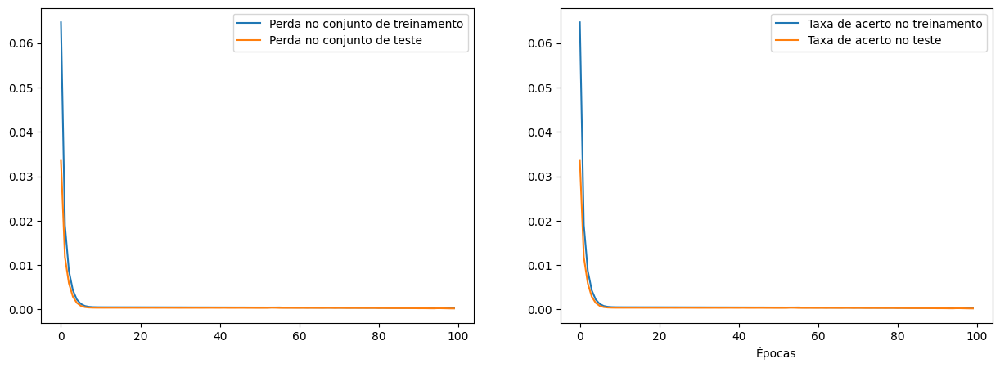

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

7/7 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

Best parameters found: {'hidden_layer_sizes': (12, 18), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Best AUC ROC: 0.9920122887864824


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")

melhores parametros: {'hidden_layer_sizes': (12, 18), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 100}
Tempo de Treinamento: 0.1017 segundos
Tempo de Previsão: 0.0015 segundos
Accuracy: 1.0
Sensitivity (Recall): 1.0
Specificity: 1.0
----------------------
AUC: 1.0000


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.0923 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


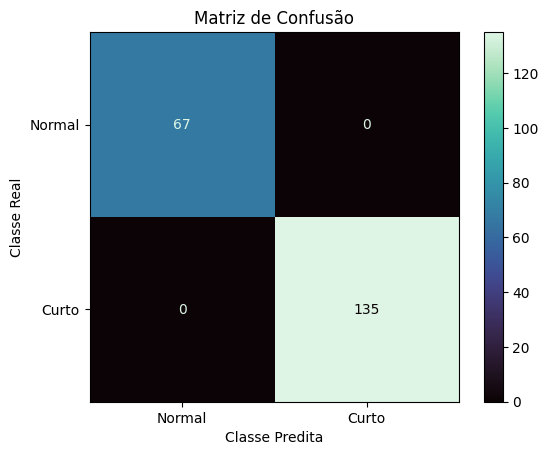

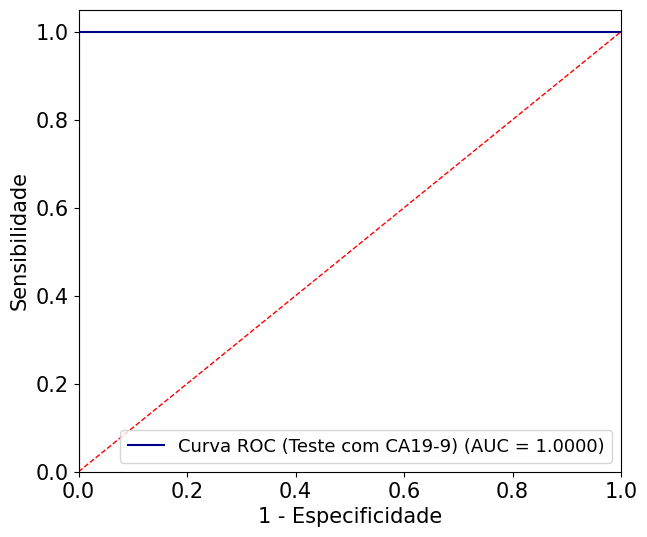

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "Curto"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model_bin(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

#### Cenário 3PV  - 99,28%

In [ ]:
df_pv3

,Curto,Tipo de GD,Med_A,Med_B,Med_C,FASE A,FASE B,FASE C
0,ABC,3PV,0.331014,0.343910,0.325076,1,1,1
1,Ruído,3PV,0.284256,0.284256,0.284256,0,0,0
2,ABCg,3PV,0.330355,0.344608,0.325037,1,1,1
3,ABC,3PV,0.330424,0.344367,0.325209,1,1,1
4,ABCg,3PV,0.329682,0.345893,0.324425,1,1,1
...,...,...,...,...,...,...,...,...
669,Normal,NaN,0.359337,0.326926,0.313737,0,0,0
670,Normal,NaN,0.358834,0.328183,0.312982,0,0,0
671,Normal,NaN,0.354266,0.332146,0.313589,0,0,0
672,Normal,NaN,0.350639,0.333987,0.315374,0,0,0


In [ ]:
mapping = {'ABCg': 1, 'ABC': 1, 'Ruído': 0, 'Normal': 0}
df_pv3['Classe'] = df_pv3['Curto'].str.strip().replace(mapping)

In [ ]:
dados = df_pv3[['Med_A', 'Med_B', 'Med_C']]
rotulos = df_pv3['Classe']

# # Reset index for 'dados' DataFrame
# dados = dados.reset_index(drop=True)

# # Reset index for 'rotulos' DataFrame
# rotulos = rotulos.reset_index(drop=True)

##### Preparação dos Dados (Treino, Teste e Validação)

In [ ]:
# Separa os dados em treino e teste, estratificando a amostra
X, X_test0, y, y_test0 = train_test_split(dados, rotulos,
                                                    test_size=0.3, random_state=43,
                                                    stratify=rotulos)

# Separa os dados em treino e teste, estratificando a amostra
X_train, X_valid, y_train, y_valid = train_test_split(X, y,
                                                    test_size=0.3, random_state=43,
                                                    stratify=y)

##### Autoencoder

In [ ]:
dim_entrada = X_train.shape[1]
entrada = Input(shape=(dim_entrada,))

# Encoder
x = Dense(6, activation='relu')(entrada)
encoded = Dense(8, activation='relu')(x)

# Decoder
x = Dense(6, activation='relu')(encoded)
decoder = Dense(3, activation='relu')(x)

# Autoencoder
autoencoder = Model(inputs=entrada, outputs=decoder)

# Apresenta a estrutura do autoencoder
autoencoder.summary()

Model: "model_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_14 (InputLayer)       [(None, 3)]               0         
                                                                 
 dense_52 (Dense)            (None, 6)                 24        
                                                                 
 dense_53 (Dense)            (None, 8)                 56        
                                                                 
 dense_54 (Dense)            (None, 6)                 54        
                                                                 
 dense_55 (Dense)            (None, 3)                 21        
                                                                 
Total params: 155 (620.00 Byte)
Trainable params: 155 (620.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse'])
historia = autoencoder.fit(X_train, X_train,
          epochs=100,
          batch_size=16,
          validation_data=(X_valid, X_valid),
          shuffle=True)

Epoch 1/100
21/21 [==============================] - 1s 13ms/step - loss: 0.0649 - mse: 0.0649 - val_loss: 0.0341 - val_mse: 0.0341
Epoch 2/100
21/21 [==============================] - 0s 7ms/step - loss: 0.0194 - mse: 0.0194 - val_loss: 0.0116 - val_mse: 0.0116
Epoch 3/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 0.0058 - val_mse: 0.0058
Epoch 4/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0043 - mse: 0.0043 - val_loss: 0.0029 - val_mse: 0.0029
Epoch 5/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0022 - mse: 0.0022 - val_loss: 0.0015 - val_mse: 0.0015
Epoch 6/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0012 - mse: 0.0012 - val_loss: 8.4244e-04 - val_mse: 8.4244e-04
Epoch 7/100
21/21 [==============================] - 0s 6ms/step - loss: 7.2775e-04 - mse: 7.2775e-04 - val_loss: 5.4956e-04 - val_mse: 5.4956e-04
Epoch 8/100
21/21 [==============================] - 0s 5m

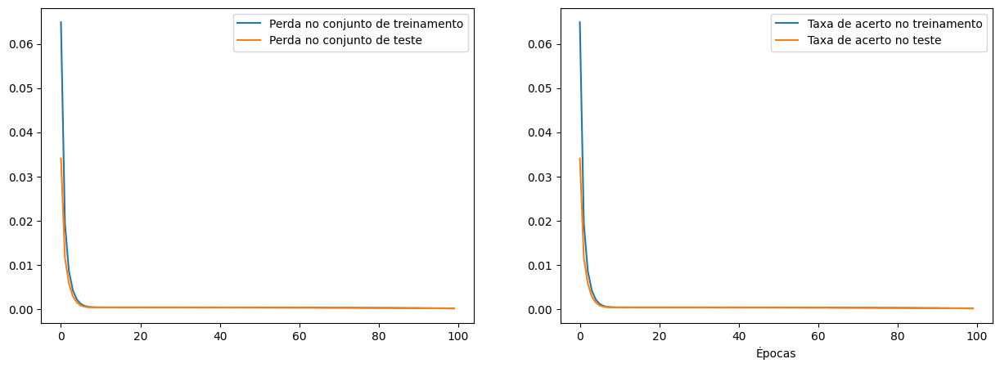

In [ ]:
plt.figure(5, figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(historia.history["loss"], label="Perda no conjunto de treinamento")
plt.plot(historia.history["val_loss"], label="Perda no conjunto de teste")
plt.legend()
plt.subplot(1,2,2)
plt.plot(historia.history["mse"], label="Taxa de acerto no treinamento")
plt.plot(historia.history["val_mse"], label="Taxa de acerto no teste")
plt.xlabel('Épocas')
plt.legend()


In [ ]:
espaco_latente = Model(entrada, encoded)
novo_X = espaco_latente.predict(X)
novo_X_test = espaco_latente.predict(X_test0)

7/7 [==============================] - 0s 2ms/step


###### Busca Parametros

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(4),(10),(12),(16),(24),(12, 6), (12, 18), (12, 16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [8, 16, 32, 64],
    'max_iter': [50,100],
}

model = MLPClassifier
grid_search = GridSearch(model, param_grid, scoring='AUC', cv=5)
best_params_mlp, best_score, all_results = grid_search.fit(novo_X, y.values)

print("Best parameters found:", best_params_mlp)
print("Best AUC ROC:", best_score)

Best parameters found: {'hidden_layer_sizes': (12, 16, 8), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 50}
Best AUC ROC: 0.990850614439324


###### Teste Melhor Parametro

In [ ]:
print('melhores parametros:', best_params_mlp)
model = MLPClassifier(**best_params_mlp)

start_time_training = time.time()
model.fit(np.array(novo_X), y)
training_time = time.time() - start_time_training

start_time_prediction = time.time()
predicted_labels = model.predict(np.array(novo_X_test))
prediction_time = time.time() - start_time_prediction

predicted_probabilities = model.predict_proba(np.array(novo_X_test))

y_test = np.array(y_test0)
correct_predictions = np.sum(predicted_labels == y_test.flatten())
accuracy = correct_predictions / len(y_test)

y_true = y_test0
y_pred_classes = predicted_labels

# Since it's a binary classification problem, we'll calculate metrics only for one class (positive class)

# Sensitivity (Recall) = TP / (TP + FN)
sensitivity = recall_score(y_true, y_pred_classes)

# Specificity = TN / (TN + FP)
tn, fp, fn, tp = confusion_matrix(y_true, y_pred_classes).ravel()
specificity = tn / (tn + fp)

# AUC score can still be calculated as before for binary classification
auc_score = roc_auc_score(y_test, predicted_probabilities[:, 1])

print(f"Tempo de Treinamento: {training_time:.4f} segundos")
print(f"Tempo de Previsão: {prediction_time:.4f} segundos")
print("Accuracy:", accuracy)
print("Sensitivity (Recall):", sensitivity)
print("Specificity:", specificity)
print("----------------------")
print(f"AUC: {auc_score:.4f}")

melhores parametros: {'hidden_layer_sizes': (12, 16, 8), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 8, 'max_iter': 50}
Tempo de Treinamento: 0.0715 segundos
Tempo de Previsão: 0.0024 segundos
Accuracy: 0.9704433497536946
Sensitivity (Recall): 1.0
Specificity: 0.9117647058823529
----------------------
AUC: 1.0000


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.0621 segundos
Tempo de Previsão: 0.0011 segundos
Acurácia = 0.9704
Precisão = 0.9574
Sensibilidade = 1.0000
F-score = 0.9783
Coeficiente de Correlação de Matthews = 0.9343
AUC = 1.0000
############################################################


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


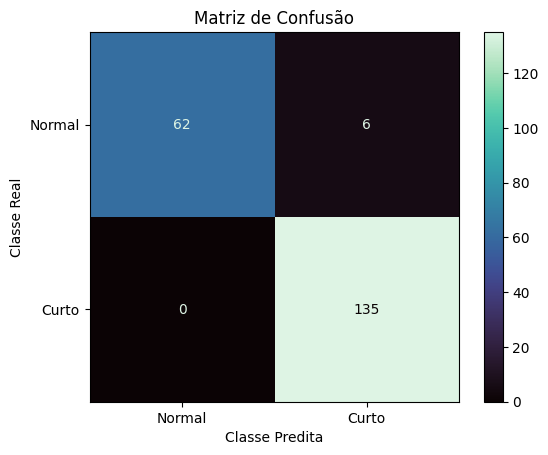

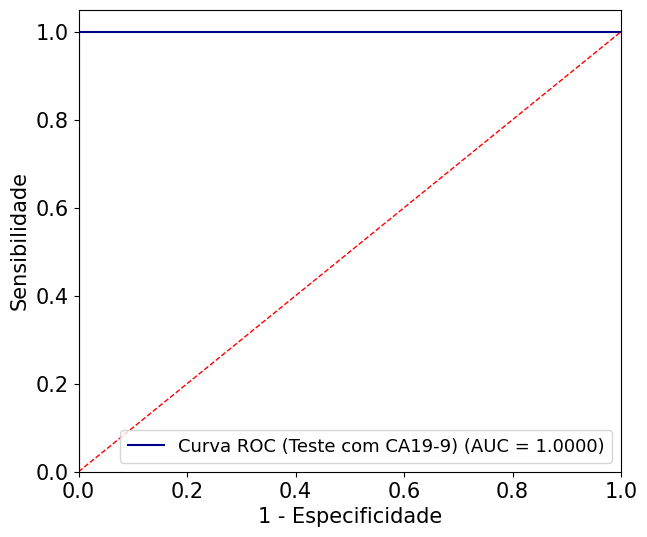

In [ ]:
# Defina os rótulos das classes
class_labels = ["Normal", "Curto"]

# Obter a paleta de cores do cmap 'mako' do Seaborn
attribute_colors = sns.color_palette("mako", len(class_labels))

test_and_evaluate_model_bin(novo_X, y, novo_X_test, y_test0, MLPClassifier, class_labels, best_params_mlp)

# Teste Modelos RF, KNN, SVM, GB, MLP, DT, NB

### RF

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 50.40 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-sc

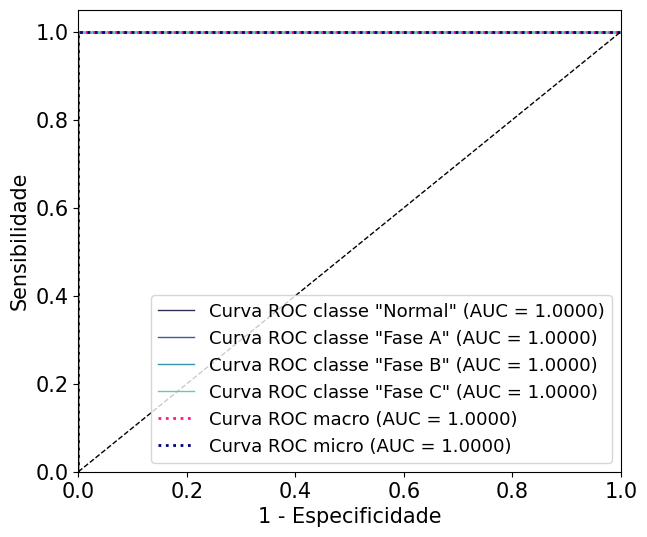

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 54.94 segundos
Best parameters found: {'n_estimators': 200, 'max_depth': None, 'criterion': 'entropy', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9993977717799746
Tempo de Treinamento: 0.2428 segundos
Tempo de Previsão: 0.0174 segundos
Acurácia: 98.12734082%
Sensitivity (Recall) Macro:0.9812
Sensitivity (Recall) Micro: 0.9813
Especificidade (specificity) macro: 0.9938
Especificidade (specificity) micro: 0.9938
AUC: 0.9997
Matriz de Confusão
[[63  1  0  1]
 [ 2 66  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.9692, Specificity = 0.9851, F-score = 0.9771
Class 1: Sensitivity = 0.9706, Specificity = 0.9950, F-score = 0.9826
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specifi

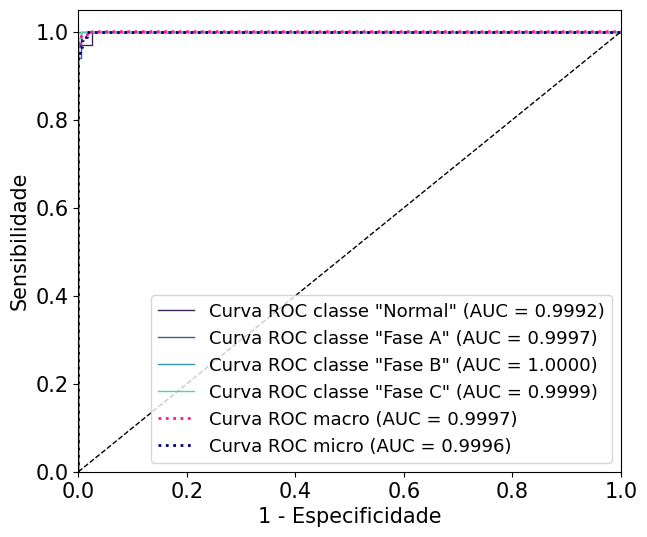

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 55.19 segundos
Best parameters found: {'n_estimators': 100, 'max_depth': 7, 'criterion': 'entropy', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9975057578685036
Tempo de Treinamento: 0.0825 segundos
Tempo de Previsão: 0.0045 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro:0.9745
Sensitivity (Recall) Micro: 0.9738
Especificidade (specificity) macro: 0.9913
Especificidade (specificity) micro: 0.9913
AUC: 0.9978
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 65  2]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9420, Specificity = 1.0000, F-score = 0.9701
Class 3: Sensitivity = 0.9559, Specificity

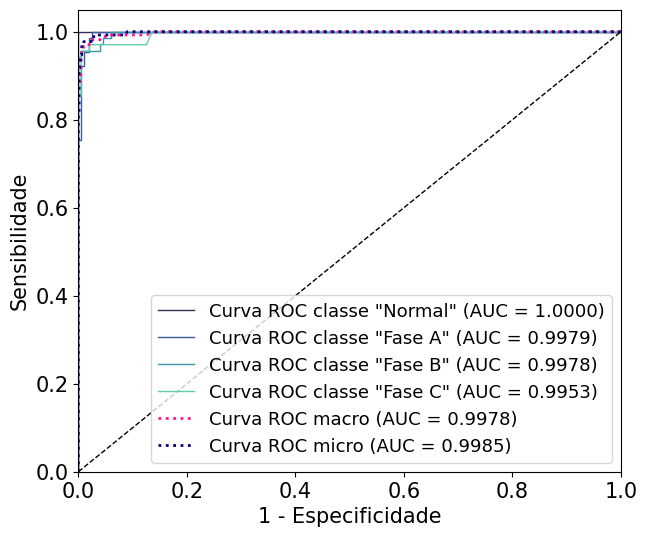

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 51.57 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-

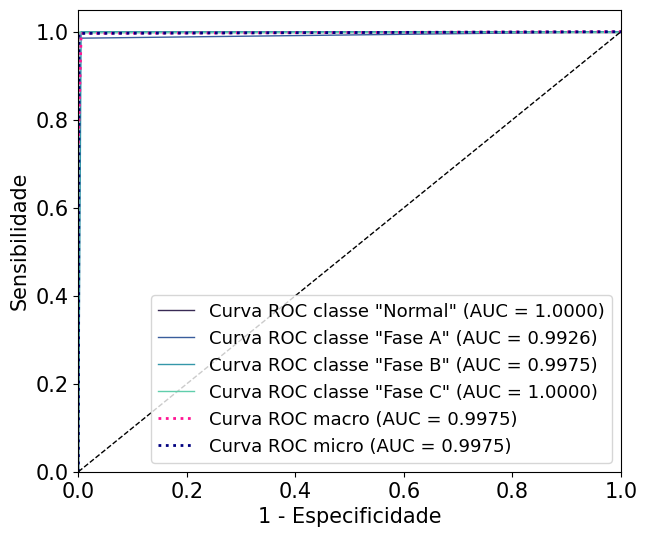

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 57.39 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0070 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Cla

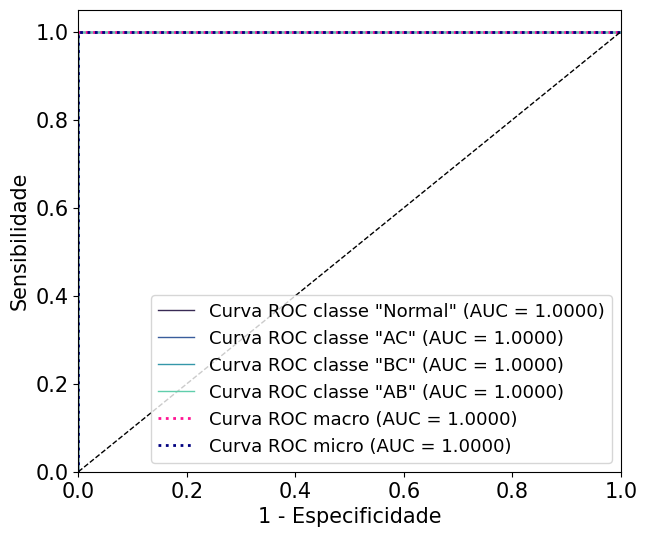

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 57.50 segundos
Best parameters found: {'n_estimators': 40, 'max_depth': 6, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0410 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity 

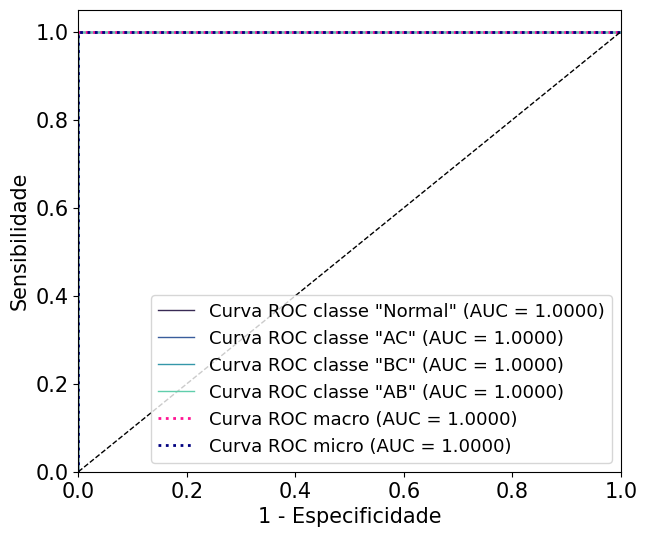

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 55.05 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0090 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity

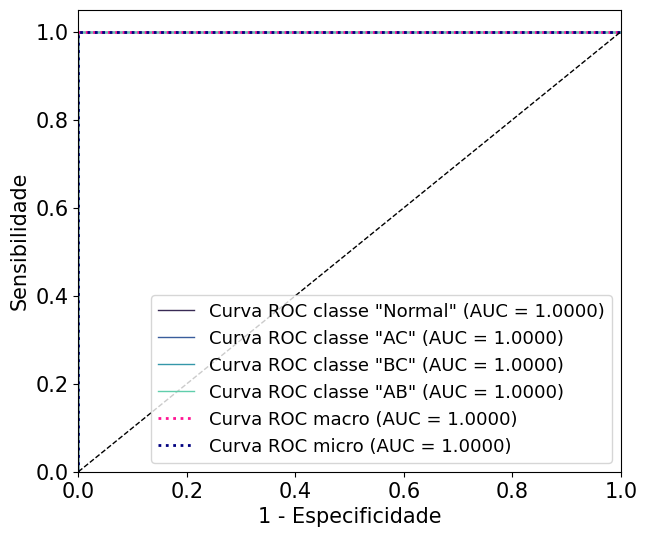

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 50.86 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specifi

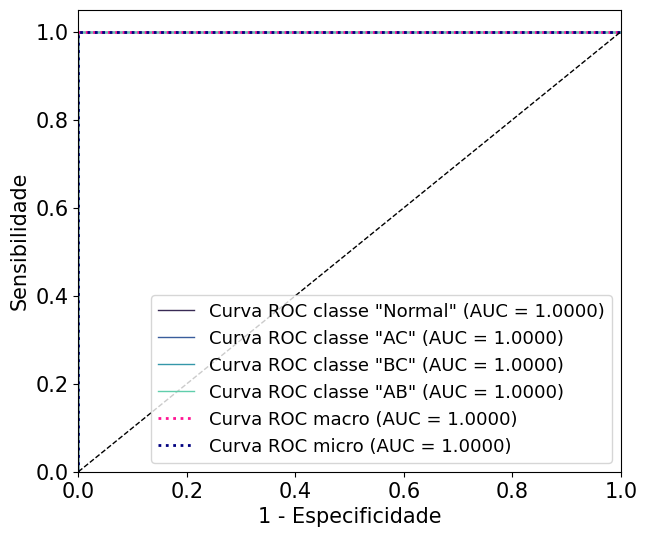

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 42.95 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': 1, 'criterion': 'gini', 'max_features': None, 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0064 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


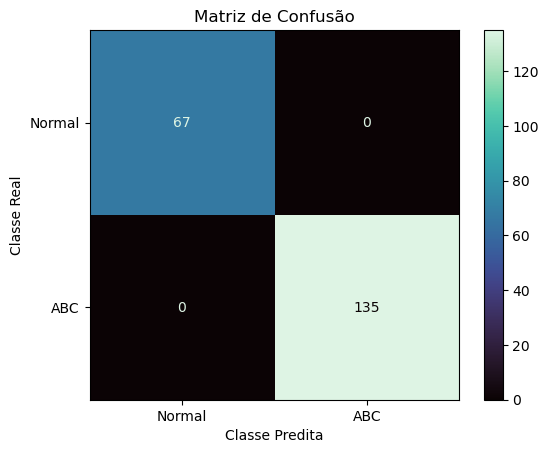

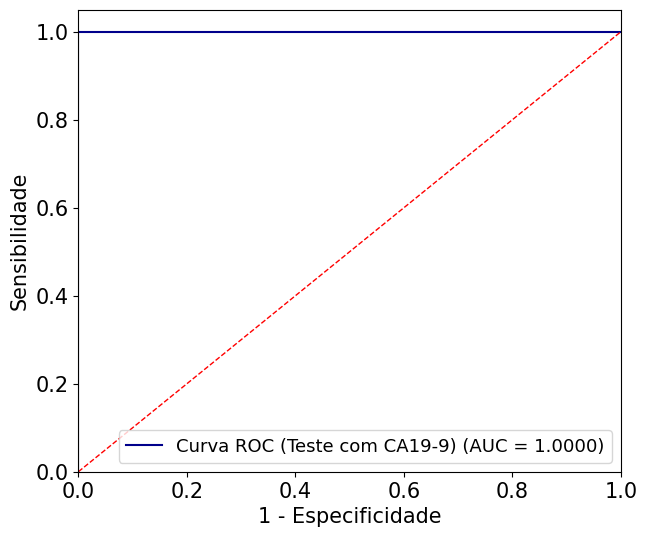

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 42.56 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': 2, 'criterion': 'gini', 'max_features': None, 'random_state': 42}
Best AUC ROC: 0.9952924987199181
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


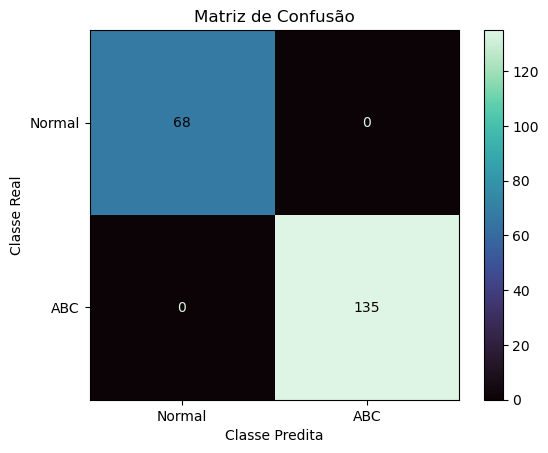

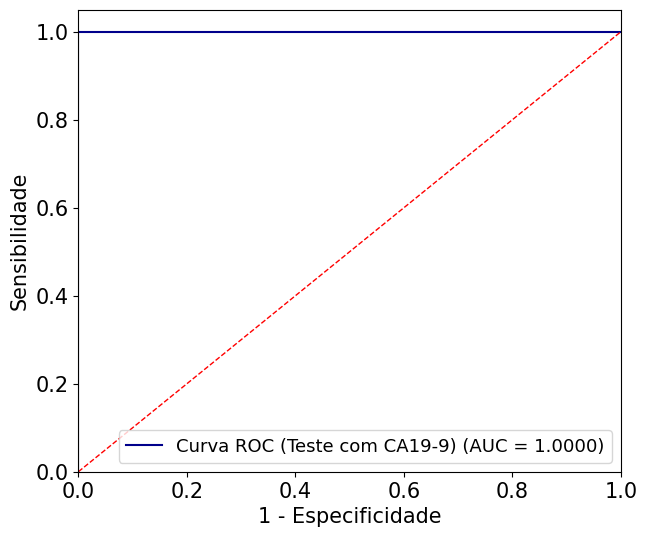

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 44.55 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


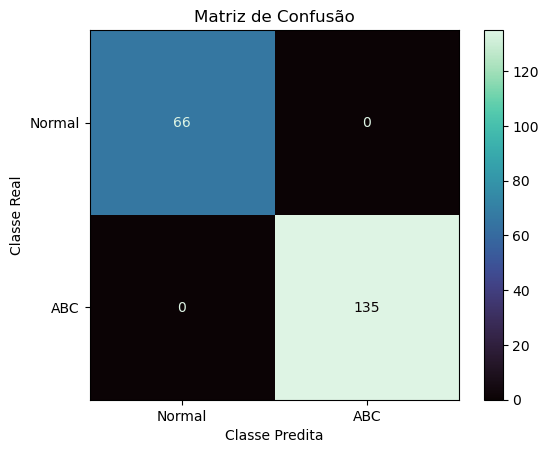

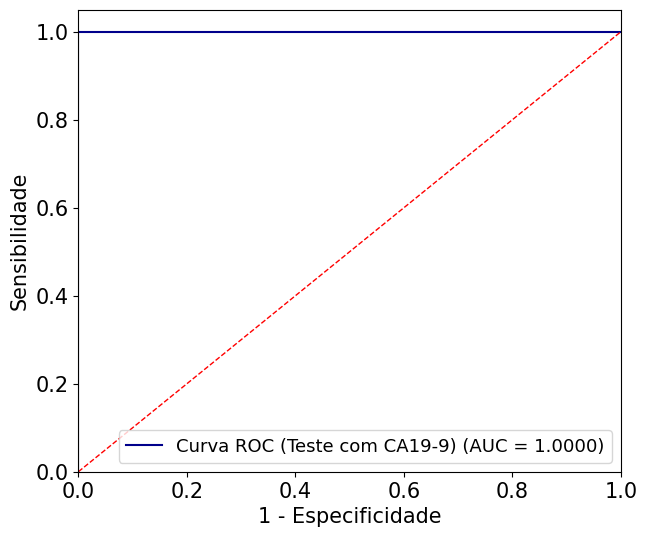

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 46.00 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0063 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


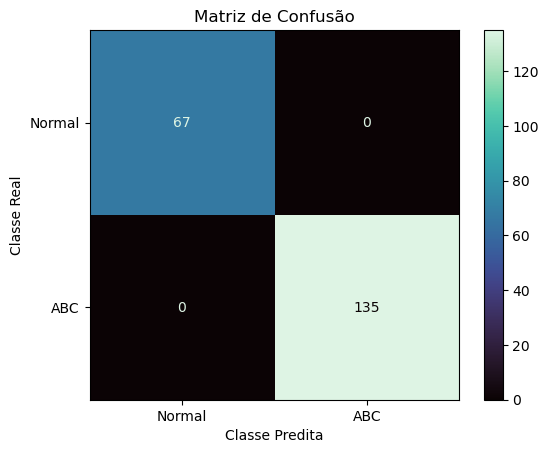

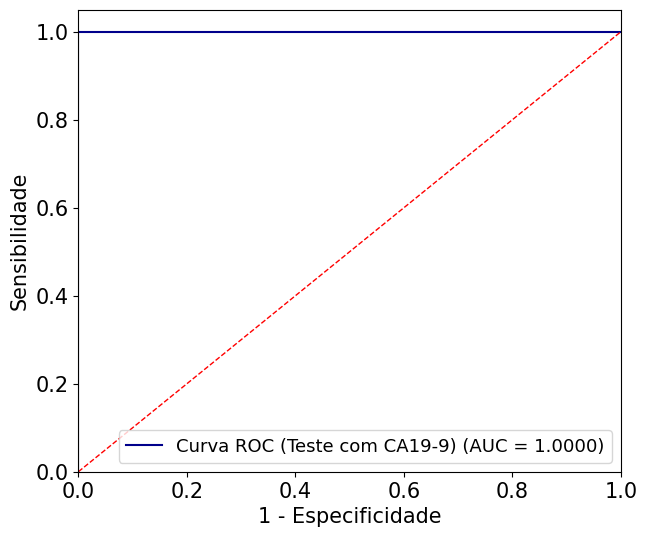

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("RF.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [RandomForestClassifier]
param_grid_rf = {
    'n_estimators': [5, 10, 15, 20, 25, 30, 35, 40, 50, 100, 150, 200],
    'max_depth': [None, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 30, 40],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_features': ['sqrt', 'log2', None],
    'random_state': [42]
}
param_grids = [param_grid_rf]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### KNN

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 1.96 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0084 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


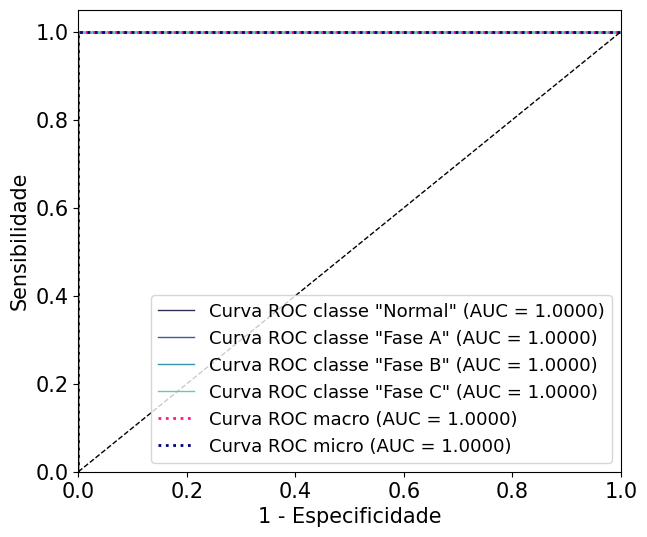

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 1.90 segundos
Best parameters found: {'n_neighbors': 7, 'weights': 'distance', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 0.9996836339461208
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 98.50187266%
Sensitivity (Recall) Macro:0.9852
Sensitivity (Recall) Micro: 0.9850
Especificidade (specificity) macro: 0.9950
Especificidade (specificity) micro: 0.9950
AUC: 0.9999
Matriz de Confusão
[[65  0  0  0]
 [ 3 65  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9802, F-score = 0.9900
Class 1: Sensitivity = 0.9559, Specificity = 1.0000, F-score = 0.9774
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925


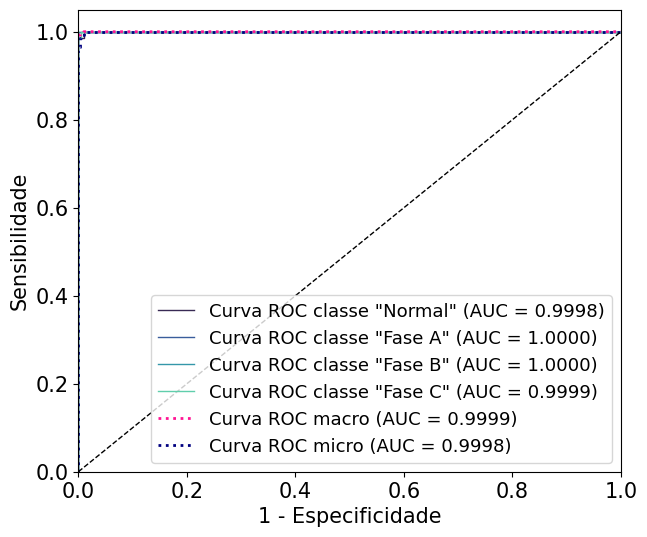

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 1.90 segundos
Best parameters found: {'n_neighbors': 11, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 0.9961629144265233
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9968
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
M

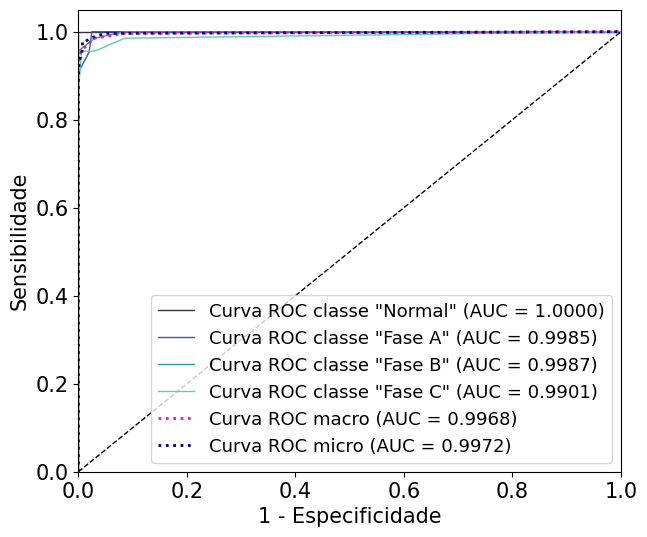

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 1.92 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0060 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score

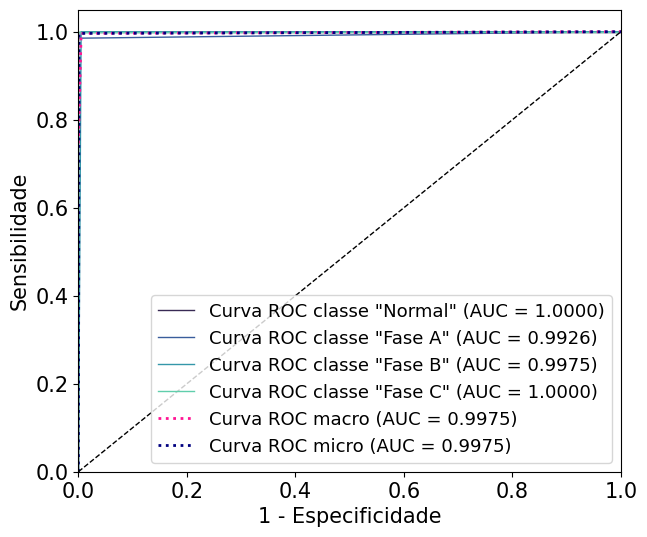

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 2.95 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0120 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, 

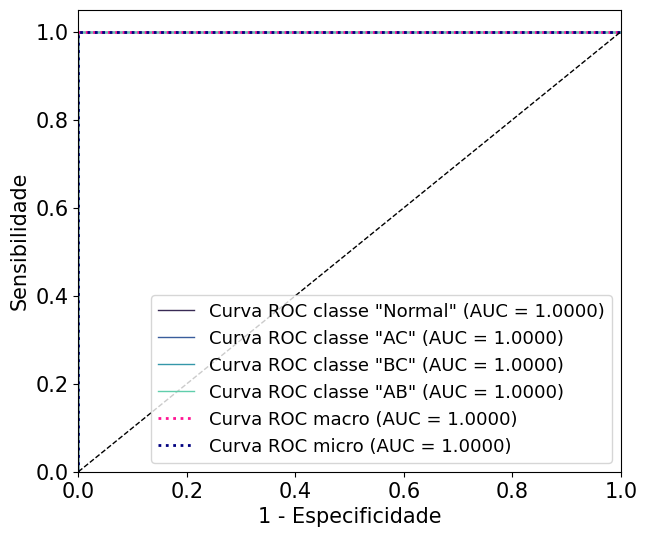

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 2.69 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0133 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

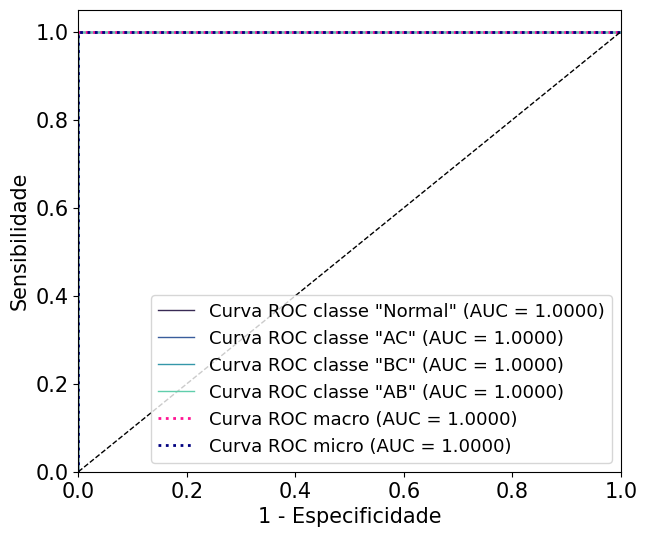

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 2.80 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0095 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000


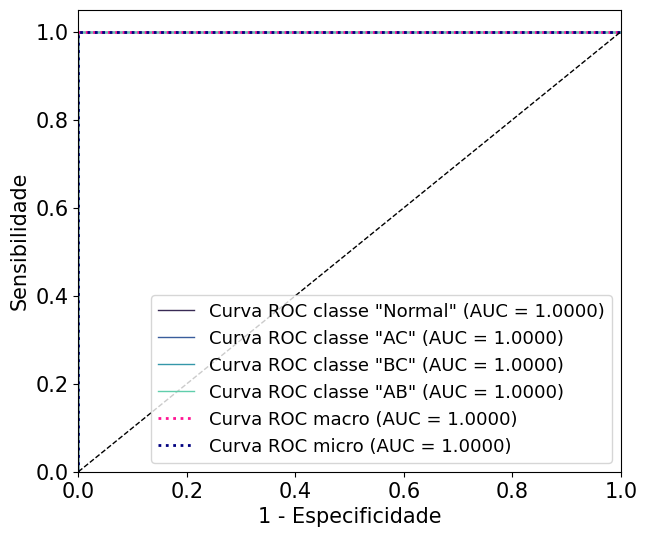

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 2.86 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0030 segundos
Tempo de Previsão: 0.0269 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0

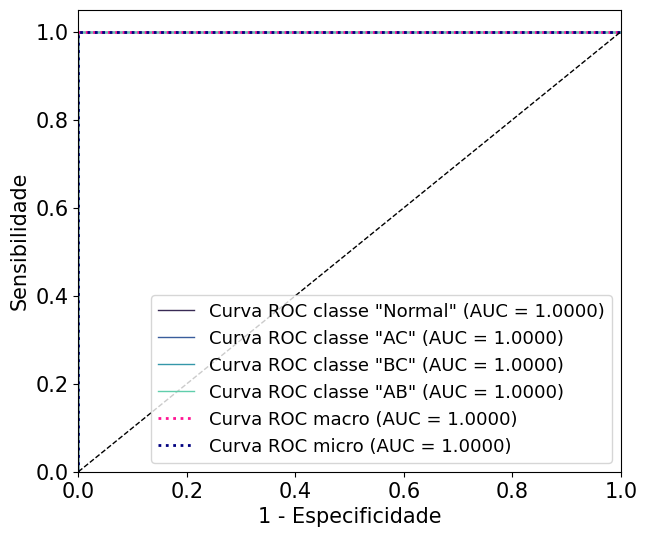

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 1.47 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia = 0.9950
Precisão = 1.0000
Sensibilidade = 0.9926
Especificidade = 1.0000
F-score = 0.9963
Coeficiente de Correlação de Matthews = 0.9889
AUC = 1.0000
############################################################


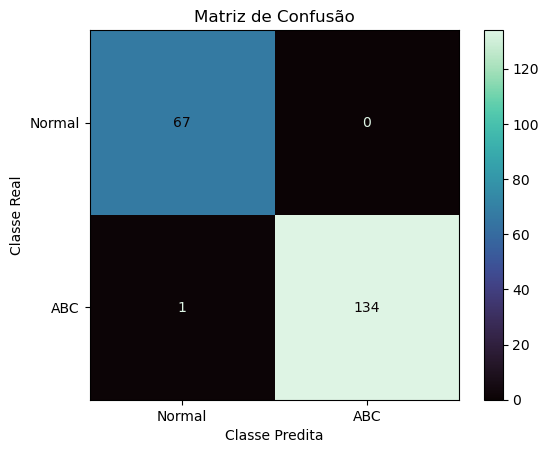

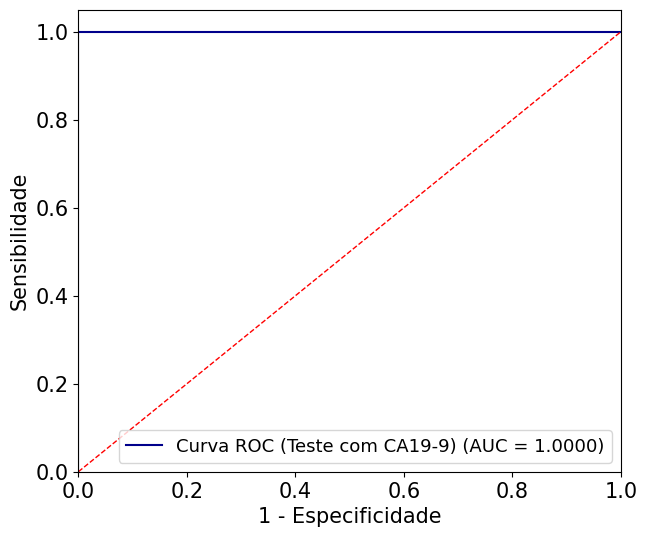

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 1.52 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 0.9935979902713774
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


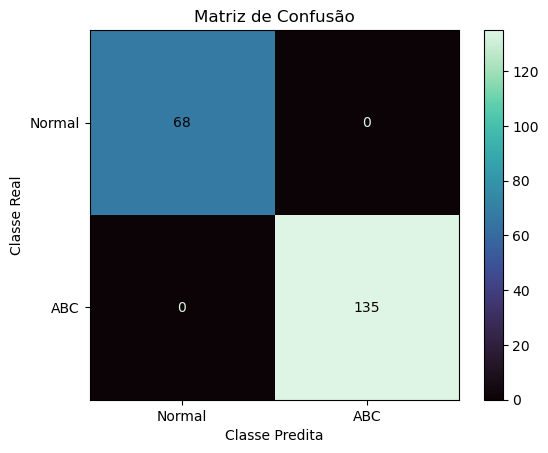

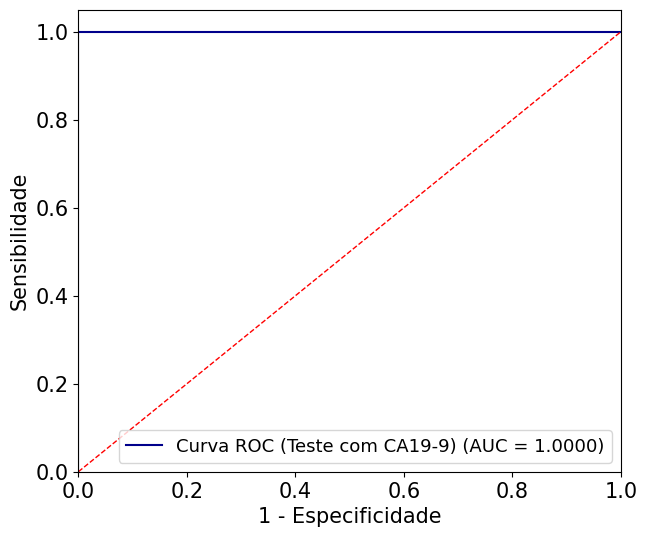

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 1.58 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


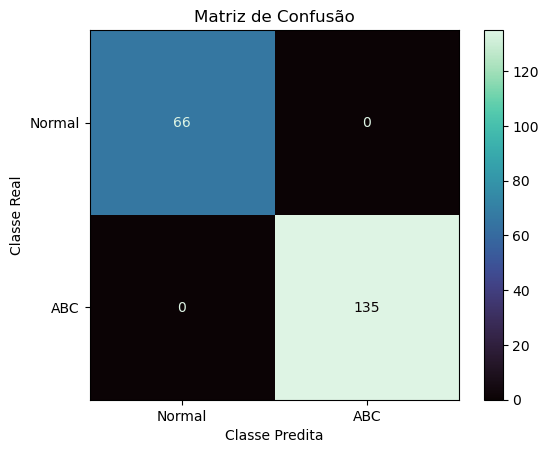

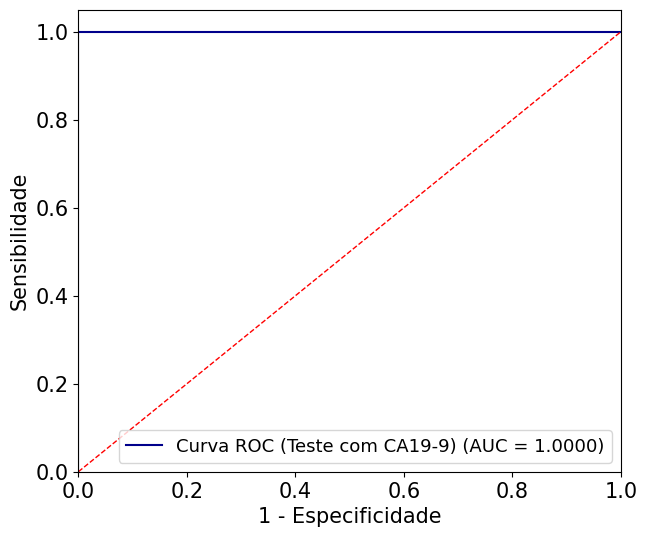

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 1.51 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


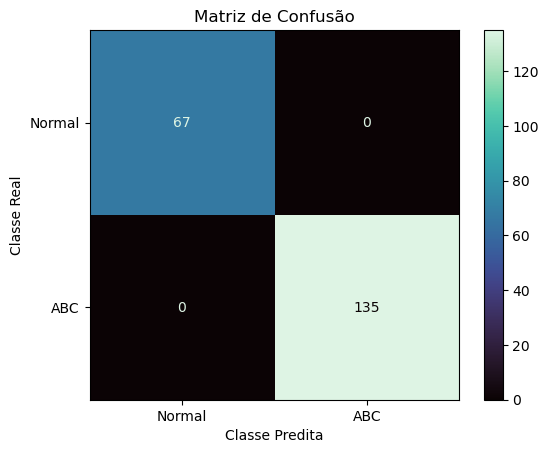

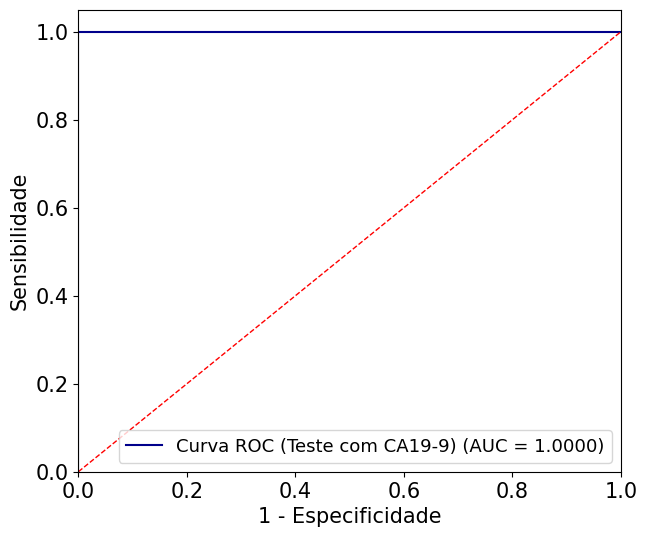

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("KNN.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [KNeighborsClassifier]
param_grid_knn = {
    'n_neighbors': [3, 5, 7, 9, 11, 13, 15],
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'p': [1, 2, 4, 8, 16, 32, 64]
}
param_grids = [param_grid_knn]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### SVC

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 1.11 segundos
Best parameters found: {'C': 0.1, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0160 segundos
Tempo de Previsão: 0.0030 segundos
Acurácia: 99.25093633%
Sensitivity (Recall) Macro:0.9925
Sensitivity (Recall) Micro: 0.9925
Especificidade (specificity) macro: 0.9975
Especificidade (specificity) micro: 0.9975
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 2  0  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9901, F-score = 0.9950
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9701, Specificity = 1.0000, F-score = 0.9848
Macro F-score: 0.9950


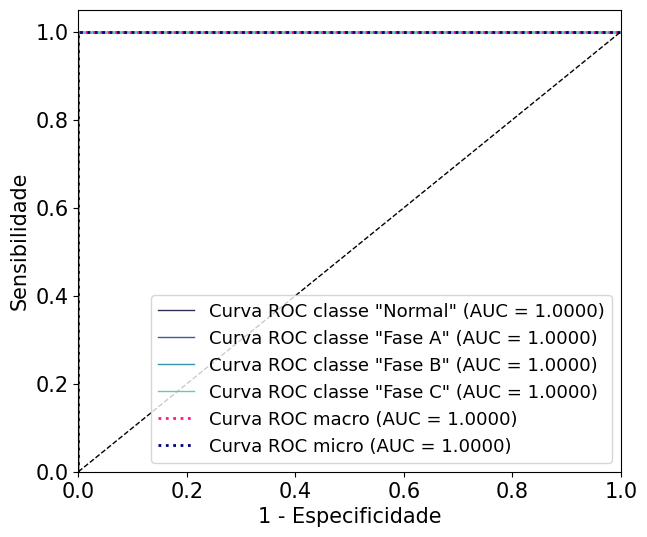

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 1.17 segundos
Best parameters found: {'C': 0.7, 'kernel': 'rbf', 'gamma': 'auto', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.987347128280726
Tempo de Treinamento: 0.0806 segundos
Tempo de Previsão: 0.0120 segundos
Acurácia: 80.89887640%
Sensitivity (Recall) Macro:0.8107
Sensitivity (Recall) Micro: 0.8090
Especificidade (specificity) macro: 0.9369
Especificidade (specificity) micro: 0.9363
AUC: 0.9730
Matriz de Confusão
[[65  0  0  0]
 [18 50  0  0]
 [20  0 47  0]
 [13  0  0 54]]
Class 0: Sensitivity = 1.0000, Specificity = 0.7475, F-score = 0.8555
Class 1: Sensitivity = 0.7353, Specificity = 1.0000, F-score = 0.8475
Class 2: Sensitivity = 0.7015, Specificity = 1.0000, F-score = 0.8246
Class 3: Sensitivity = 0.8060, Specificity = 1.0000, F-score = 0.8926
Macro F-score: 0

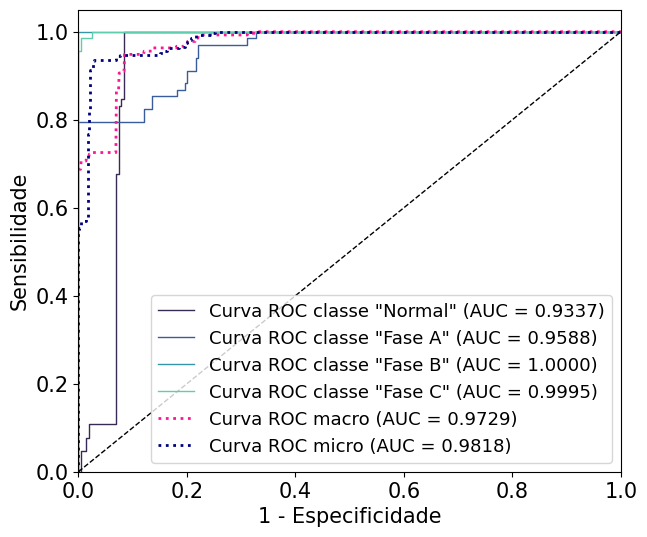

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.89 segundos
Best parameters found: {'C': 0.2, 'kernel': 'sigmoid', 'gamma': 'auto', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9902906235999105
Tempo de Treinamento: 0.0582 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 73.78277154%
Sensitivity (Recall) Macro:0.7380
Sensitivity (Recall) Micro: 0.7378
Especificidade (specificity) macro: 0.9133
Especificidade (specificity) micro: 0.9126
AUC: 0.9850
Matriz de Confusão
[[65  0  0  0]
 [34 31  0  0]
 [20  0 48  1]
 [15  0  0 53]]
Class 0: Sensitivity = 1.0000, Specificity = 0.6584, F-score = 0.7940
Class 1: Sensitivity = 0.4769, Specificity = 1.0000, F-score = 0.6458
Class 2: Sensitivity = 0.6957, Specificity = 1.0000, F-score = 0.8205
Class 3: Sensitivity = 0.7794, Specificity = 0.9950, F-score = 0.8741
Macro F-scor

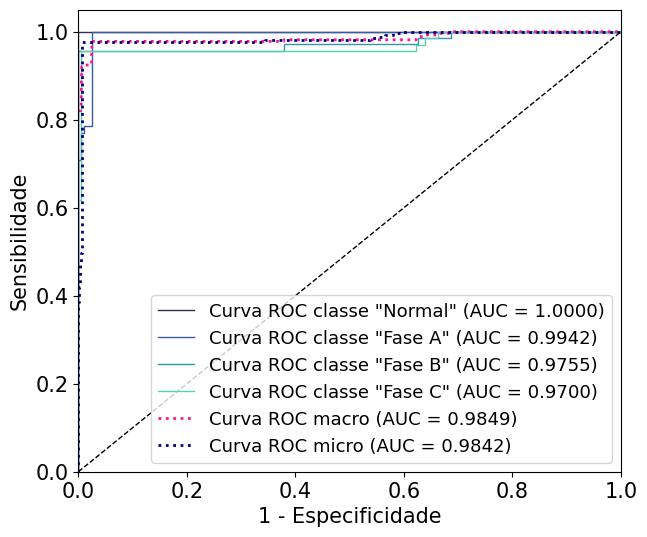

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.52 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0185 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9953
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


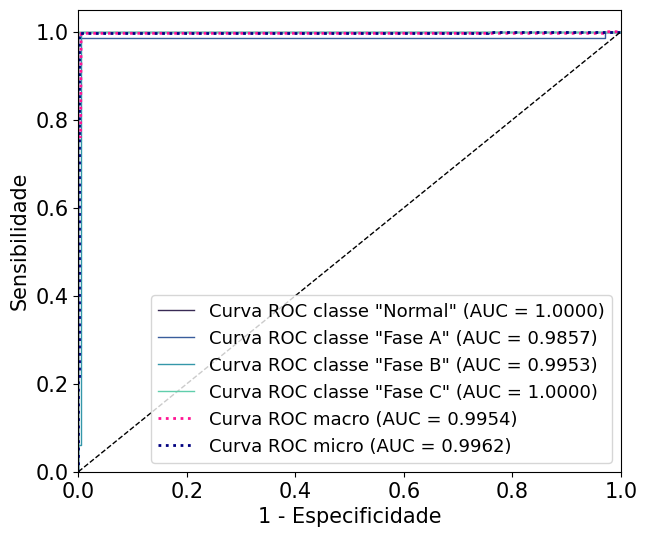

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 2.53 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1636 segundos
Tempo de Previsão: 0.0090 segundos
Acurácia: 86.11111111%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8611
Especificidade (specificity) macro: 0.9513
Especificidade (specificity) micro: 0.9537
AUC: 1.0000
Matriz de Confusão
[[  0  30   0  35]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9102, F-score = 0.9530
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity

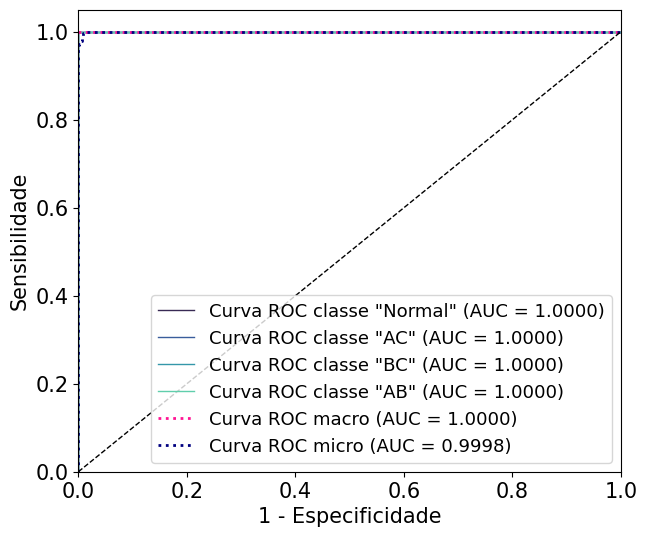

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 2.43 segundos
Best parameters found: {'C': 0.8, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9999741138988452
Tempo de Treinamento: 0.0250 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 98.29059829%
Sensitivity (Recall) Macro:0.9851
Sensitivity (Recall) Micro: 0.9829
Especificidade (specificity) macro: 0.9943
Especificidade (specificity) micro: 0.9943
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  2   0 126   6]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 0.9403, Specificity = 1.0000, F-score = 0.9692
Class 3: Sensitivity = 1.0000, Specificity = 0.9820, F-score = 0.990

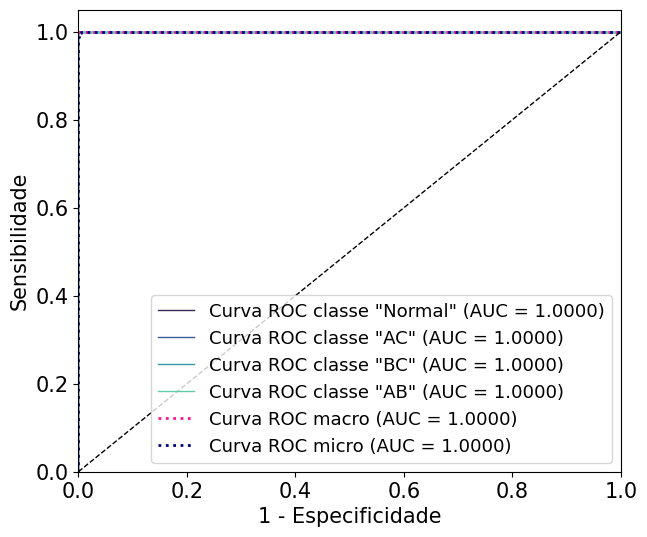

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 2.37 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1170 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 86.11111111%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8611
Especificidade (specificity) macro: 0.9513
Especificidade (specificity) micro: 0.9537
AUC: 1.0000
Matriz de Confusão
[[  0  10   0  55]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9700, F-score = 0.9848
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.8353, F-score = 0.9103
Macro F-sco

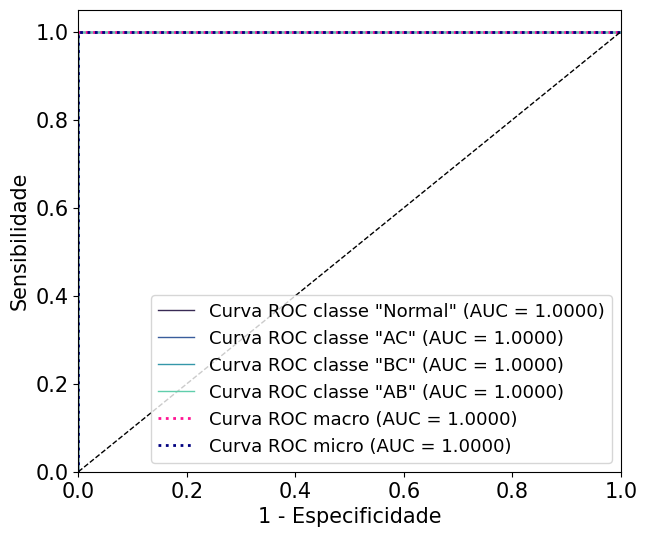

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 1.34 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0482 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia: 84.68085106%
Sensitivity (Recall) Macro:0.8666
Sensitivity (Recall) Micro: 0.8468
Especificidade (specificity) macro: 0.9556
Especificidade (specificity) micro: 0.9489
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [ 23 113   0   0]
 [ 25   0 109   0]
 [ 24   0   0 111]]
Class 0: Sensitivity = 1.0000, Specificity = 0.8222, F-score = 0.9024
Class 1: Sensitivity = 0.8309, Specificity = 1.0000, F-score = 0.9076
Class 2: Sensitivity = 0.8134, Specificity = 1.0000, F-score = 0.8971
Class 3: Sensitivity = 0.8222, Specificity = 1.0000, F-score = 0.9024
Macro F

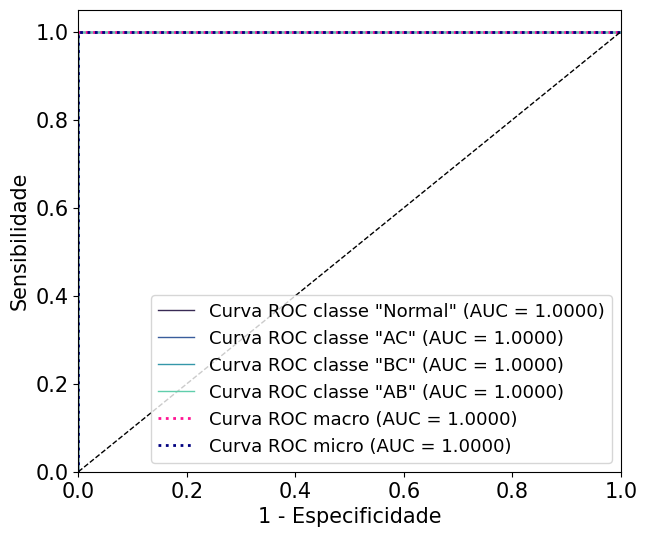

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.45 segundos
Best parameters found: {'C': 0.3, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9913978494623656
Tempo de Treinamento: 0.0110 segundos
Tempo de Previsão: 0.0011 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


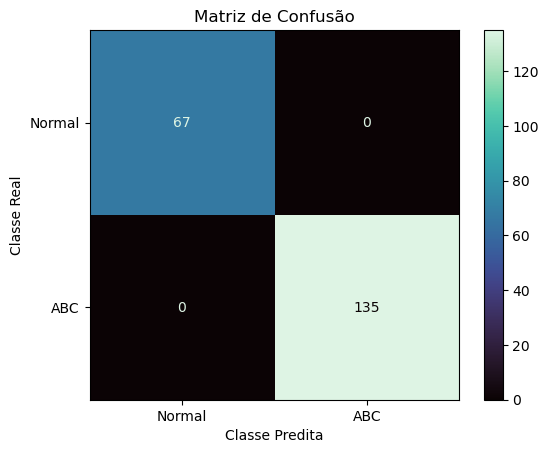

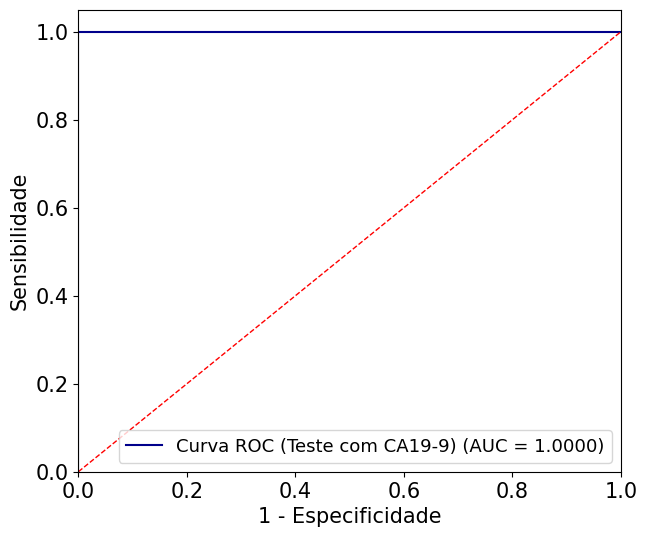

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.45 segundos
Best parameters found: {'C': 0.3, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9918602790578597
Tempo de Treinamento: 0.0118 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


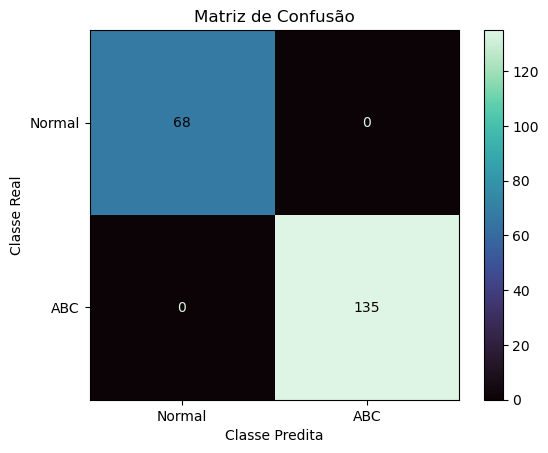

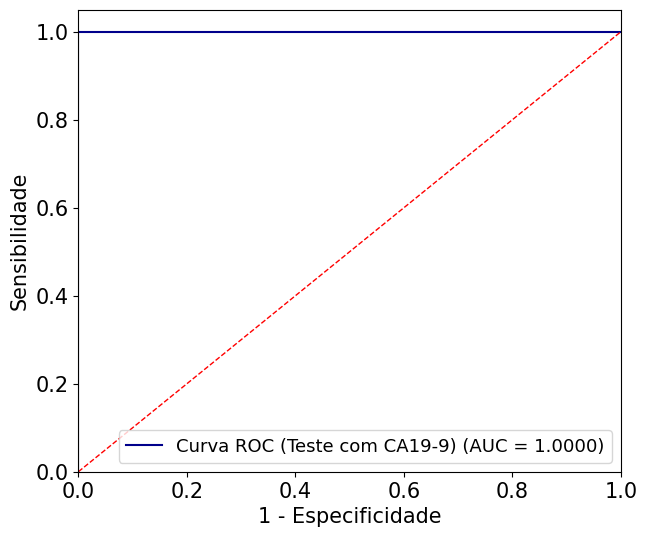

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.42 segundos
Best parameters found: {'C': 1.0, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0100 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia = 0.9502
Precisão = 1.0000
Sensibilidade = 0.9259
Especificidade = 1.0000
F-score = 0.9615
Coeficiente de Correlação de Matthews = 0.8967
AUC = 1.0000
############################################################


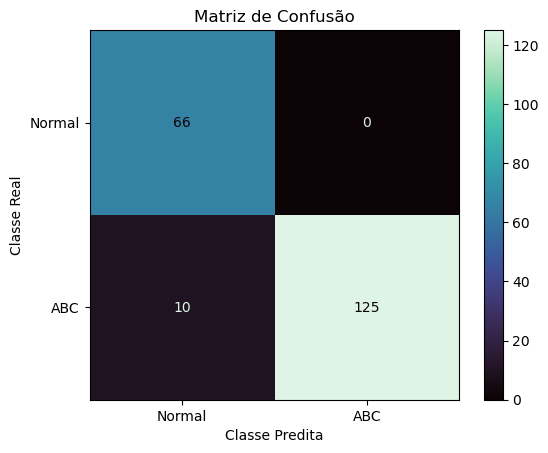

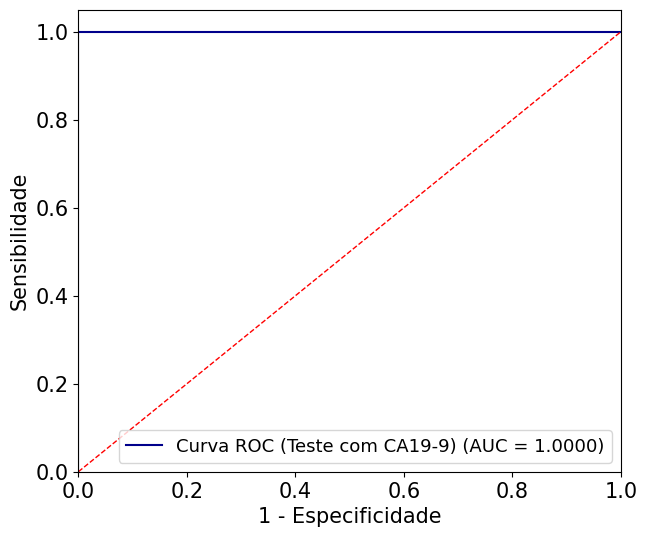

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.svm._classes.SVC'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 0.38 segundos
Best parameters found: {'C': 0.3, 'kernel': 'rbf', 'gamma': 'auto', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9967229902713773
Tempo de Treinamento: 0.0190 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia = 0.8020
Precisão = 1.0000
Sensibilidade = 0.7037
Especificidade = 1.0000
F-score = 0.8261
Coeficiente de Correlação de Matthews = 0.6638
AUC = 0.9991
############################################################


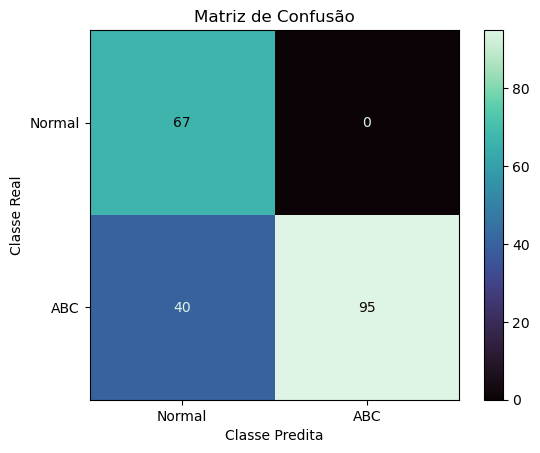

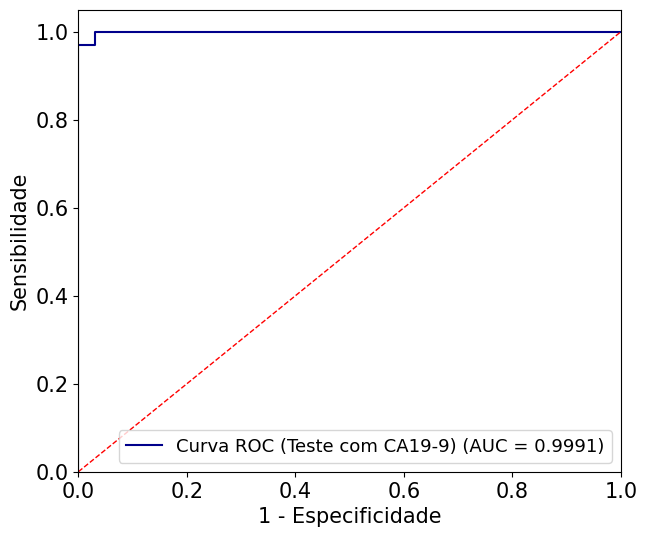

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("SVC.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [SVC]
param_grid_svc = {
    'C': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
    'kernel': ['linear', 'sigmoid', 'rbf'],
    'gamma':['scale', 'auto'],
    'random_state': [42],
    'probability': [True]
}
param_grids = [param_grid_svc]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### GB

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 8.26 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0930 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro 

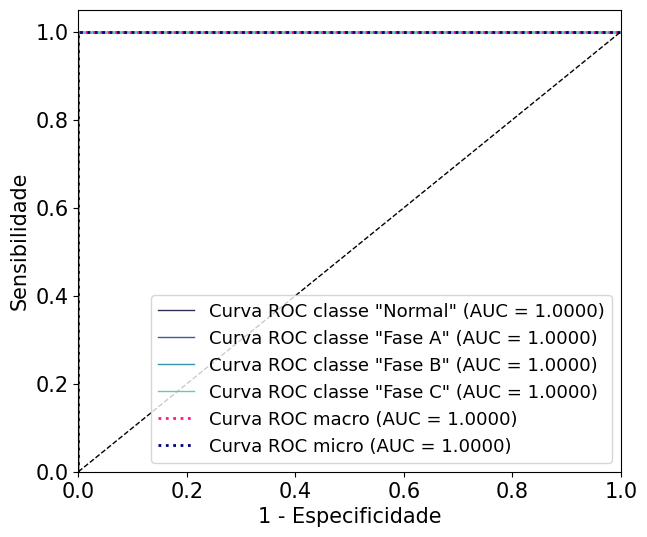

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 13.38 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 200, 'criterion': 'friedman_mse', 'max_depth': 5, 'random_state': 42}
Best AUC ROC: 0.9992244768181292
Tempo de Treinamento: 1.3710 segundos
Tempo de Previsão: 0.0060 segundos
Acurácia: 96.62921348%
Sensitivity (Recall) Macro:0.9665
Sensitivity (Recall) Micro: 0.9663
Especificidade (specificity) macro: 0.9888
Especificidade (specificity) micro: 0.9888
AUC: 0.9992
Matriz de Confusão
[[63  1  0  1]
 [ 6 62  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.9692, Specificity = 0.9653, F-score = 0.9673
Class 1: Sensitivity = 0.9118, Specificity = 0.9950, F-score = 0.9516
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specifici

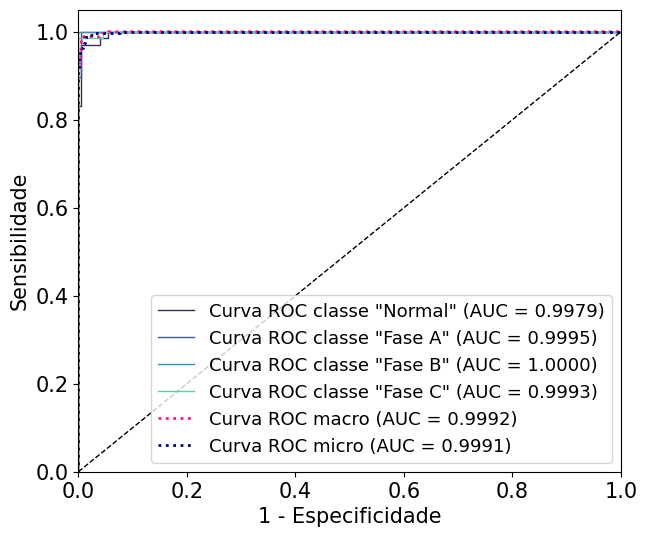

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 12.78 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 150, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.997765738136273
Tempo de Treinamento: 0.7215 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro:0.9745
Sensitivity (Recall) Micro: 0.9738
Especificidade (specificity) macro: 0.9913
Especificidade (specificity) micro: 0.9913
AUC: 0.9941
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 65  2]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9420, Specificity = 1.0000, F-score = 0.9701
Class 3: Sensitivity = 0.9559, Specificity

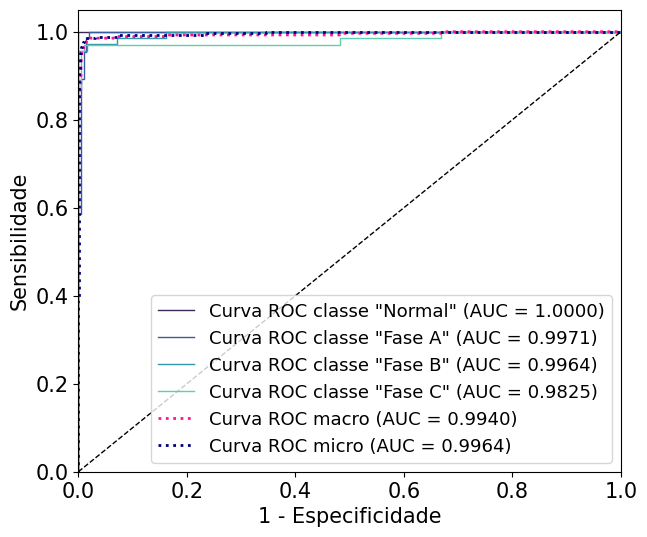

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 9.06 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0852 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9963
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000

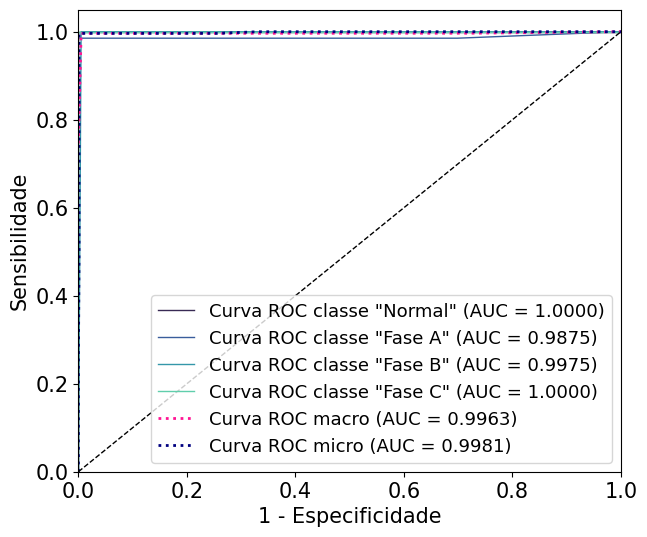

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 15.53 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1401 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.000

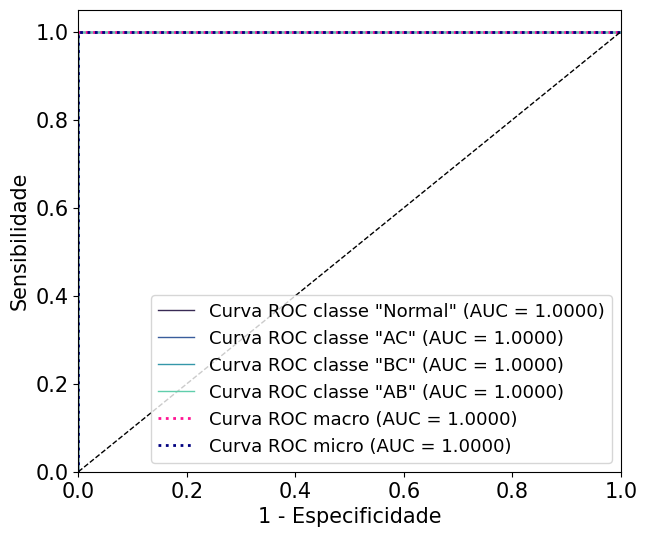

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 17.49 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 50, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.9999465210217899
Tempo de Treinamento: 0.3972 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1

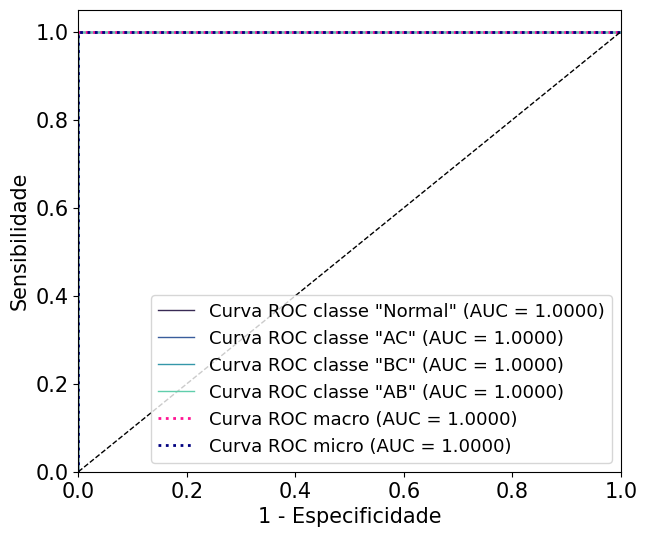

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 13.41 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0970 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specif

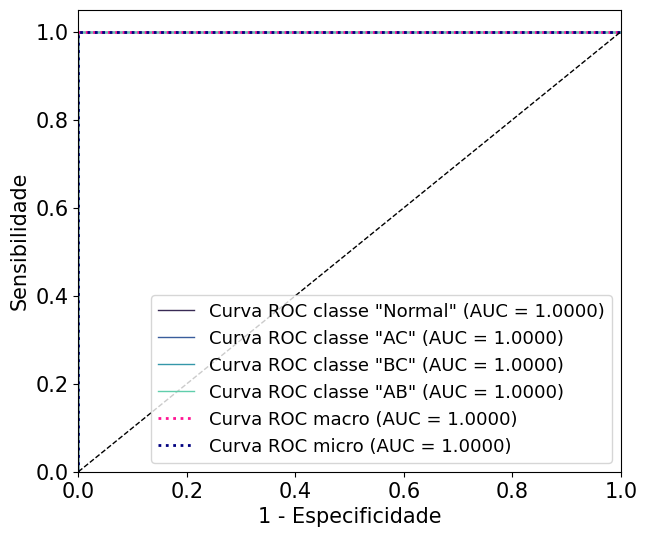

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 12.58 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1140 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Sp

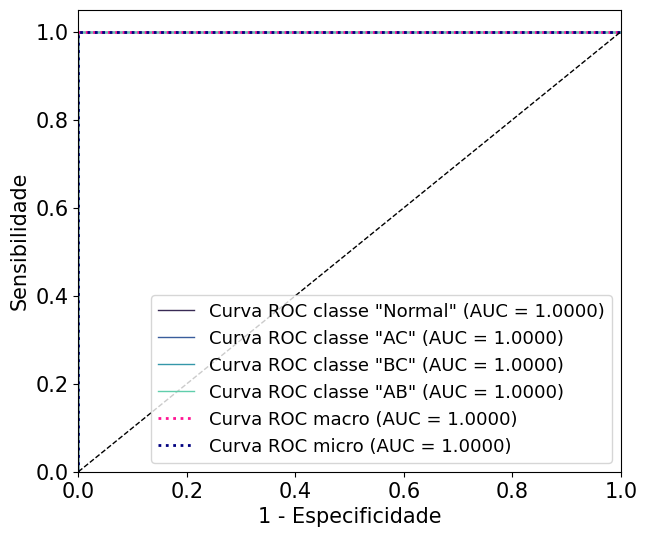

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 2.40 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 200, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.1416 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


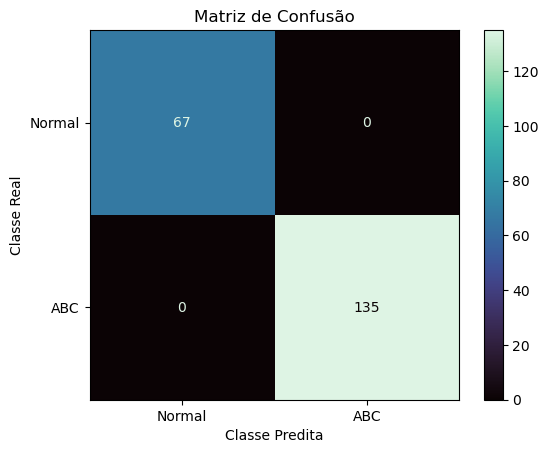

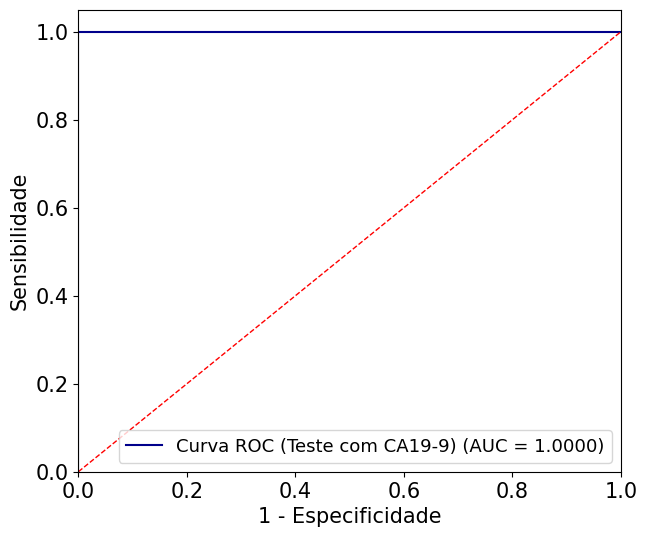

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 2.80 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.9934963837685613
Tempo de Treinamento: 0.0141 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.9951
Precisão = 1.0000
Sensibilidade = 0.9926
Especificidade = 1.0000
F-score = 0.9963
Coeficiente de Correlação de Matthews = 0.9890
AUC = 1.0000
############################################################


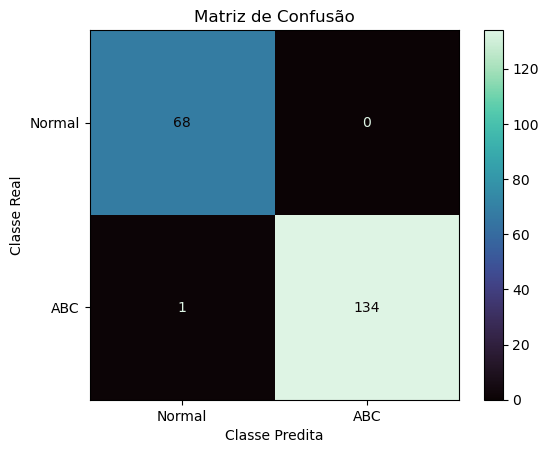

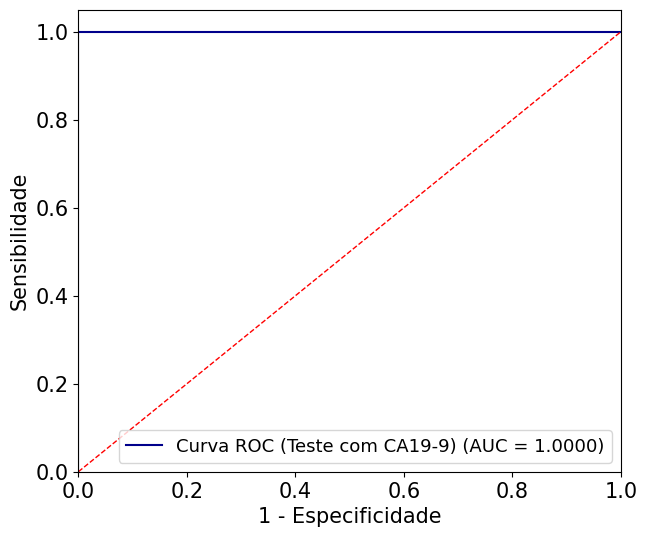

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 2.87 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 30, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0205 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


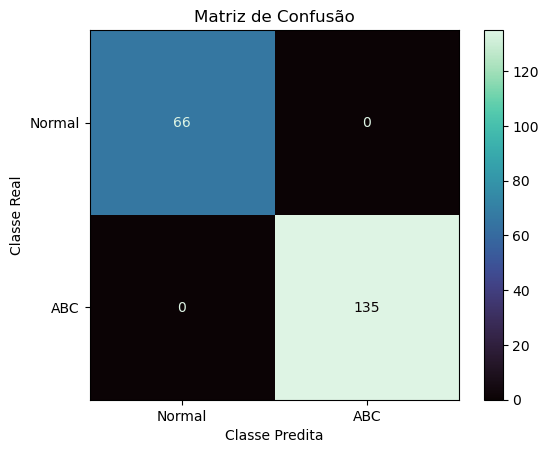

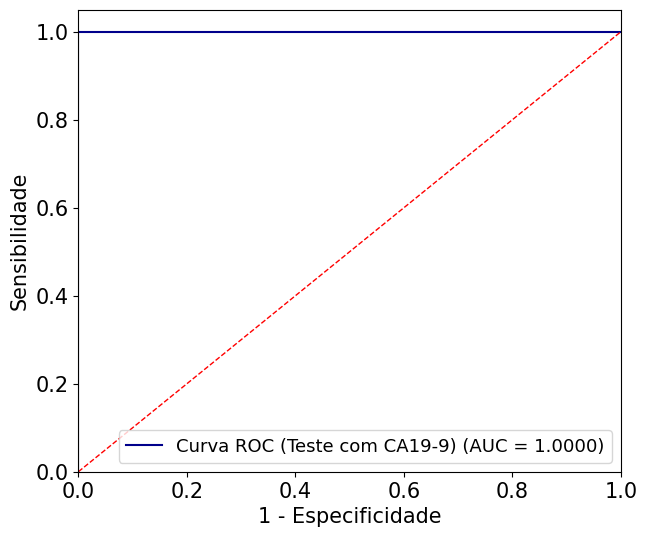

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 1.90 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0104 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


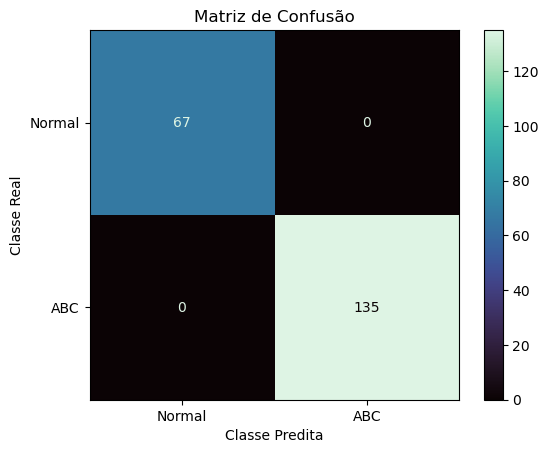

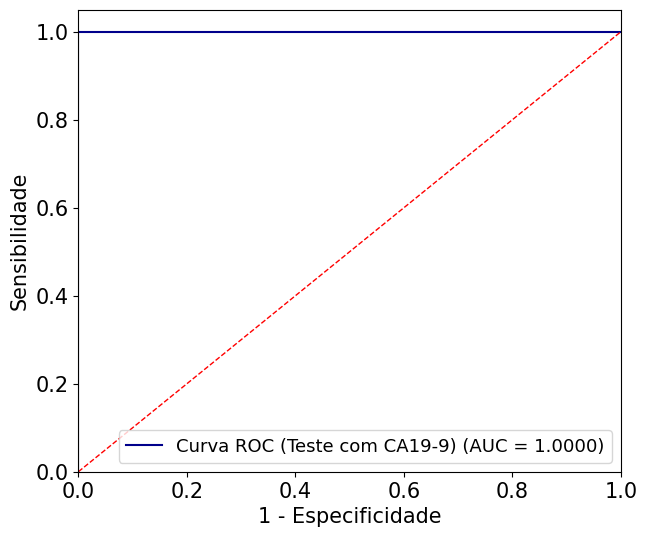

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("GB.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [GradientBoostingClassifier]
param_grid_gb = {
    'loss': ['log_loss'],# 'exponential'],
    'n_estimators': [20, 30, 50, 100, 150, 200],
    'criterion': ['friedman_mse', 'squared_error'],
    'max_depth': [None, 3, 5, 7, 10, 15, 20,30],
    'random_state': [42]
}
param_grids = [param_grid_gb]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### MLP

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 24.11 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0310 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.000

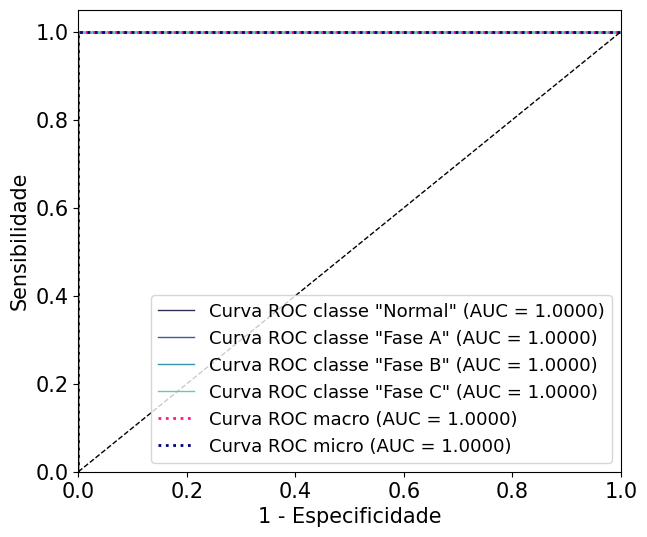

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 26.73 segundos
Best parameters found: {'hidden_layer_sizes': (8, 4), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 0.9980866285119667
Tempo de Treinamento: 0.1295 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 97.00374532%
Sensitivity (Recall) Macro:0.9699
Sensitivity (Recall) Micro: 0.9700
Especificidade (specificity) macro: 0.9900
Especificidade (specificity) micro: 0.9900
AUC: 0.9987
Matriz de Confusão
[[61  4  0  0]
 [ 4 64  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 0.9385, Specificity = 0.9802, F-score = 0.9589
Class 1: Sensitivity = 0.9412, Specificity = 0.9799, F-score = 0.9601
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3:

D:\Anaconda\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


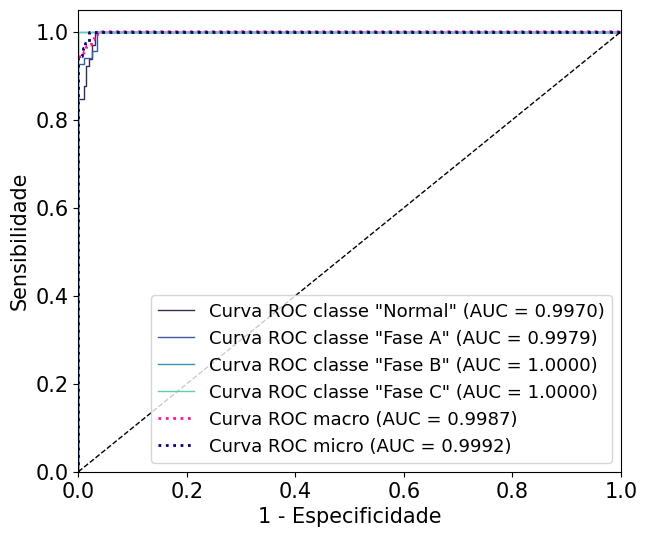

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 28.51 segundos
Best parameters found: {'hidden_layer_sizes': (10, 5), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 0.995406726030466
Tempo de Treinamento: 0.0466 segundos
Tempo de Previsão: 0.0009 segundos
Acurácia: 97.00374532%
Sensitivity (Recall) Macro:0.9709
Sensitivity (Recall) Micro: 0.9700
Especificidade (specificity) macro: 0.9900
Especificidade (specificity) micro: 0.9900
AUC: 0.9965
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 64  3]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9275, Specificity = 1.0000, F-score = 0.9624
Class 3: 

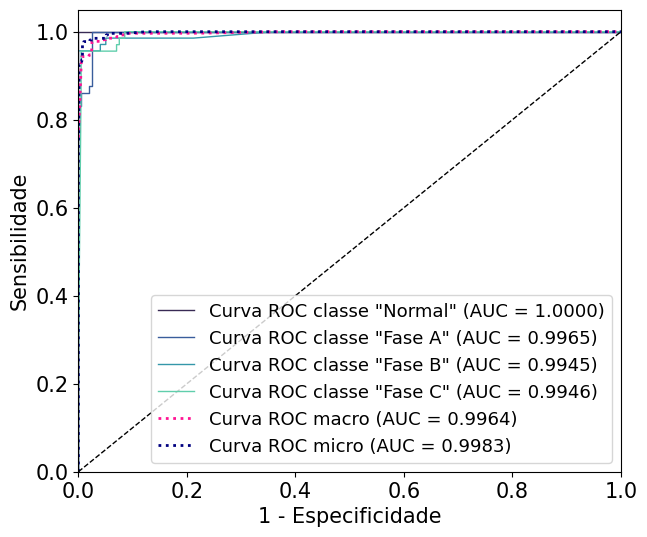

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 17.11 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0040 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9952
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.

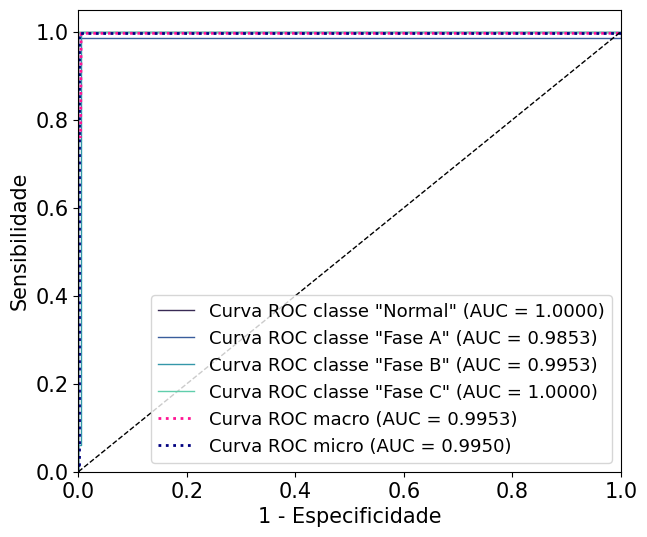

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 36.45 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0070 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity 

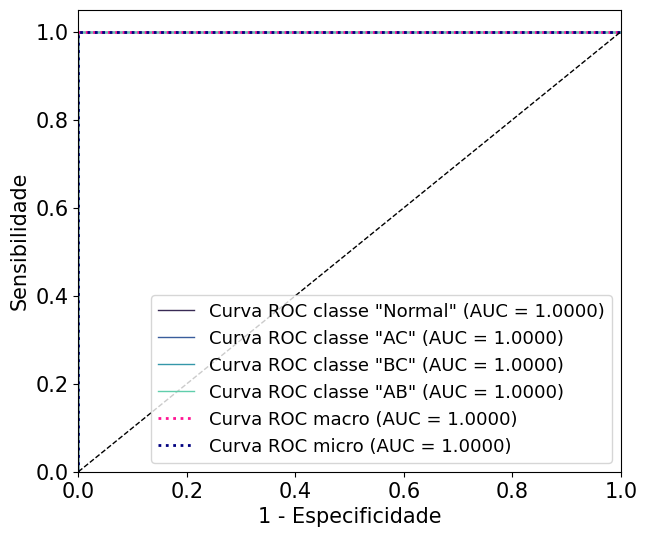

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 47.90 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0261 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.78632479%
Sensitivity (Recall) Macro:0.9981
Sensitivity (Recall) Micro: 0.9979
Especificidade (specificity) macro: 0.9993
Especificidade (specificity) micro: 0.9993
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   1   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9926, Specificity = 1.0000, F-score = 0.9963
Class 2: Sensitivity = 1.0000, Specificity = 0.9970, F-score = 0.9985
Class 3: Sen

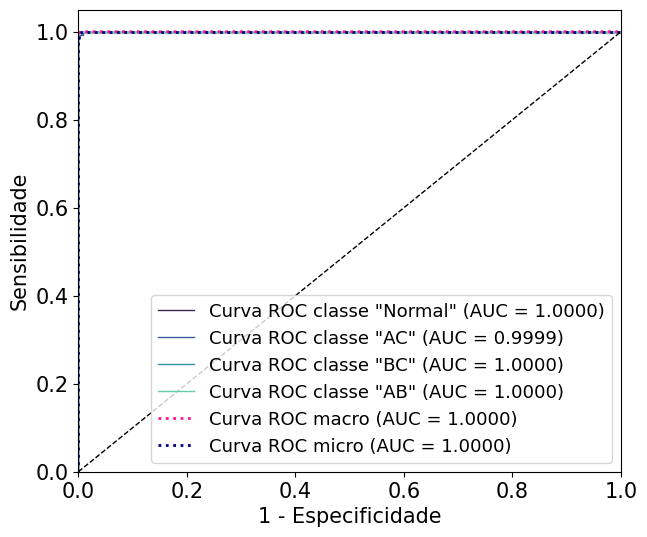

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 31.85 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sen

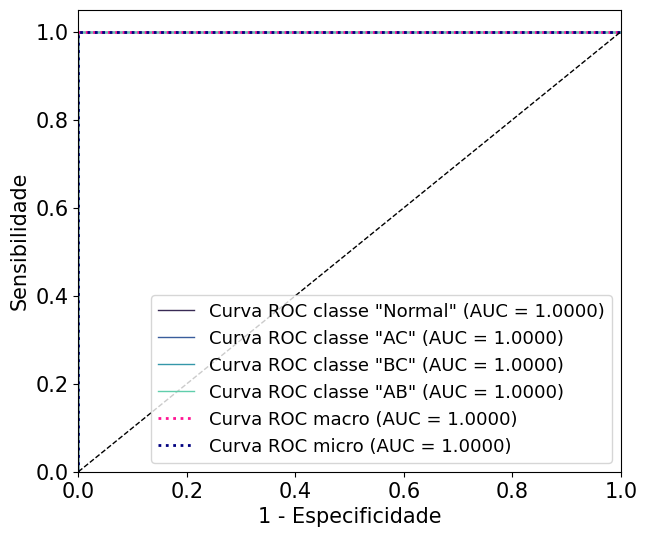

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 24.28 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3:

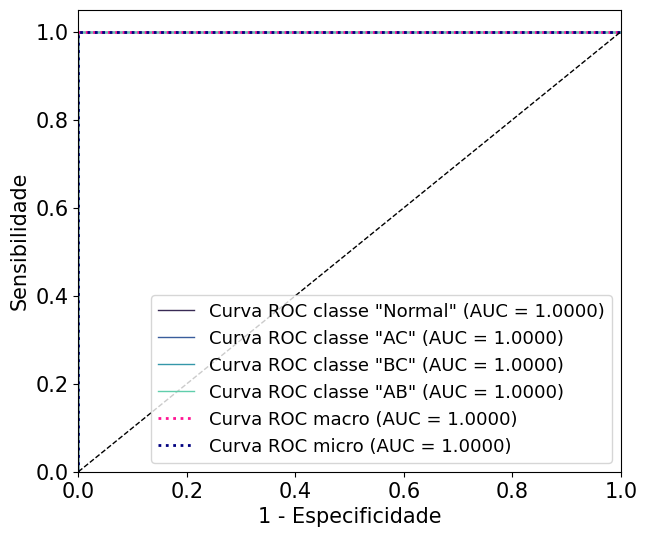

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 12.66 segundos
Best parameters found: {'hidden_layer_sizes': (10, 5), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 0.9920122887864824
Tempo de Treinamento: 0.5360 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


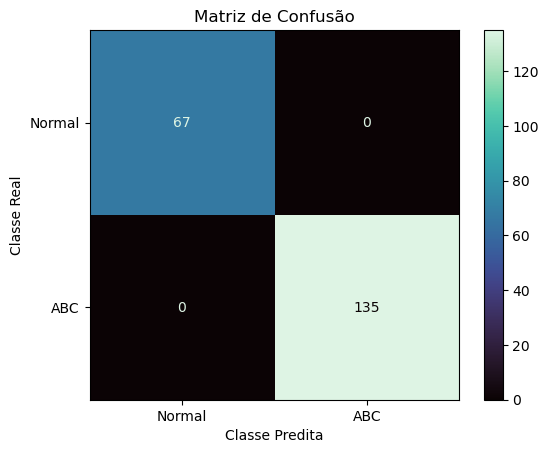

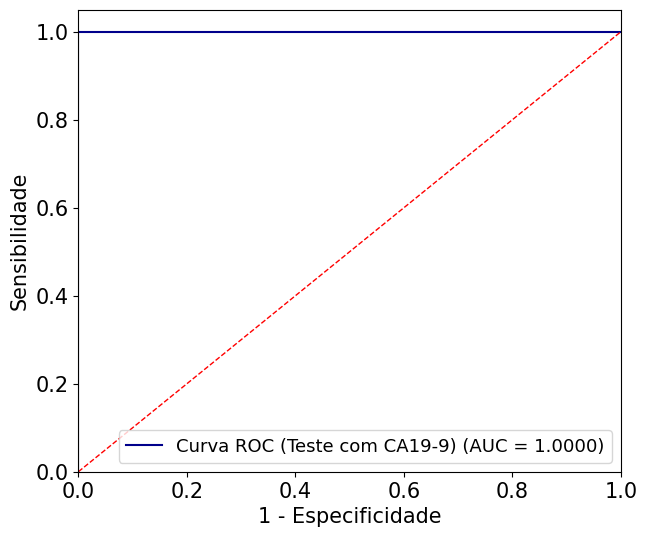

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 11.95 segundos
Best parameters found: {'hidden_layer_sizes': 10, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 0.9946140552995392
Tempo de Treinamento: 0.0099 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


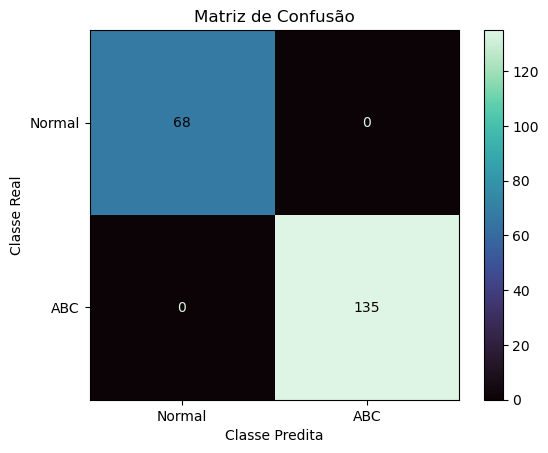

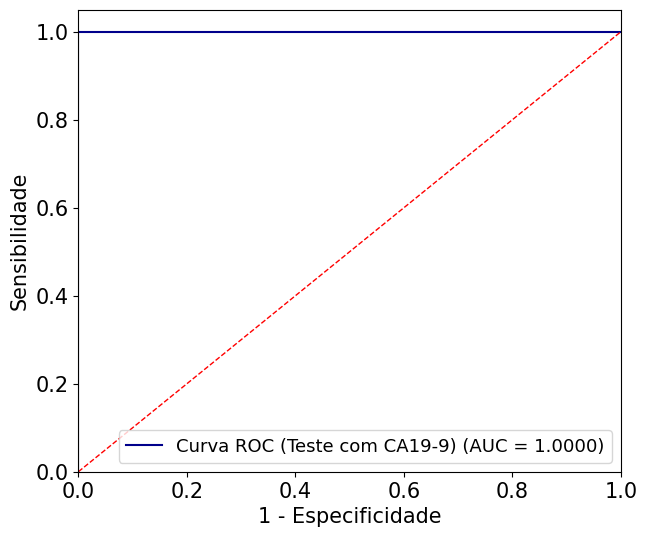

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 12.01 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0300 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


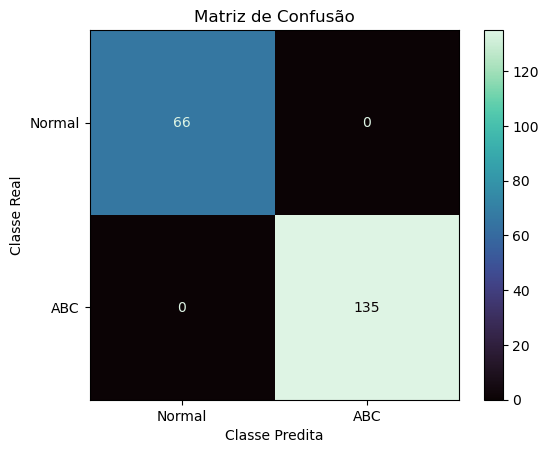

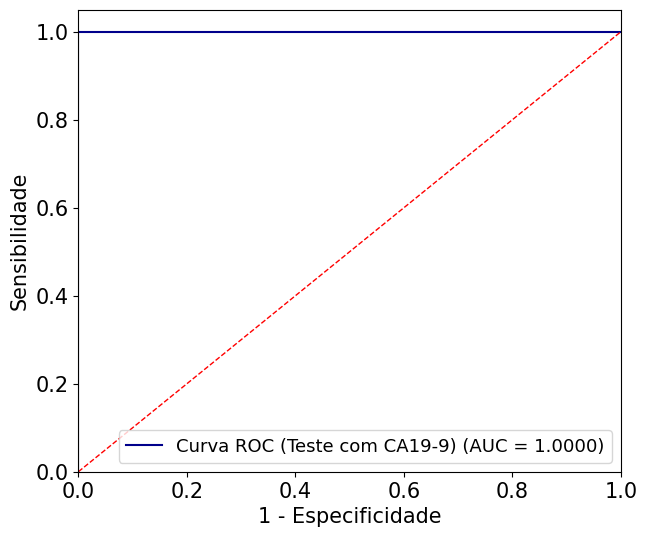

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 19.24 segundos
Best parameters found: {'hidden_layer_sizes': 9, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 500}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


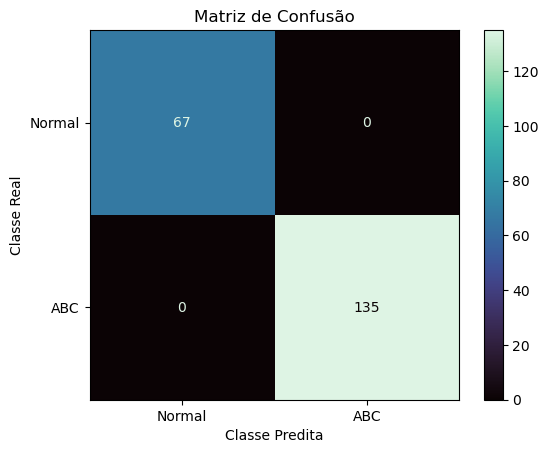

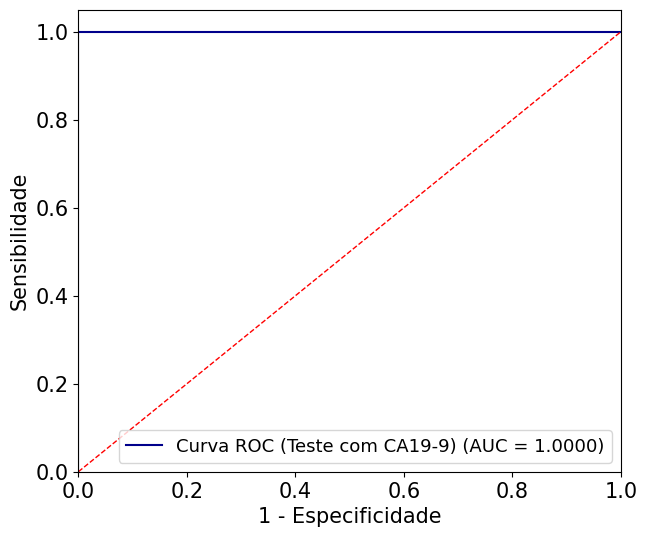

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("MLP.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [MLPClassifier]
param_grid_mlp = {
    'hidden_layer_sizes': [(9), (10), (8, 4), (10, 5)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [16, 32, 64],
    'max_iter': [500]
}
param_grids = [param_grid_mlp]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### DT

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.27 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


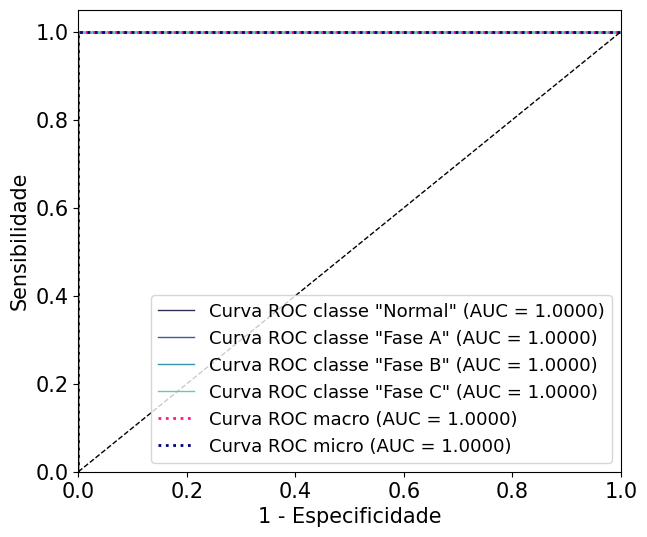

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.23 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'random', 'max_depth': 10, 'random_state': 42}
Best AUC ROC: 0.997959933951902
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9774
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9925
Especificidade (specificity) micro: 0.9925
AUC: 0.9968
Matriz de Confusão
[[62  3  0  0]
 [ 2 66  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.9538, Specificity = 0.9851, F-score = 0.9692
Class 1: Sensitivity = 0.9706, Specificity = 0.9849, F-score = 0.9777
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
M

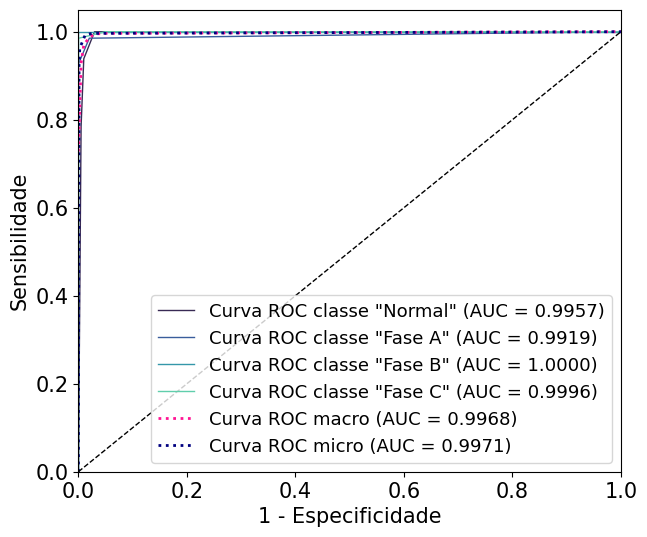

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.23 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'random', 'max_depth': 4, 'random_state': 42}
Best AUC ROC: 0.9964793871807796
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9921
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Ma

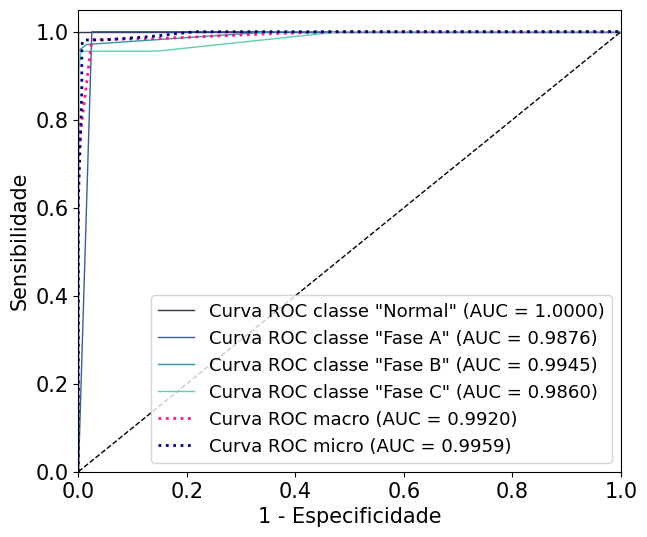

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.22 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-scor

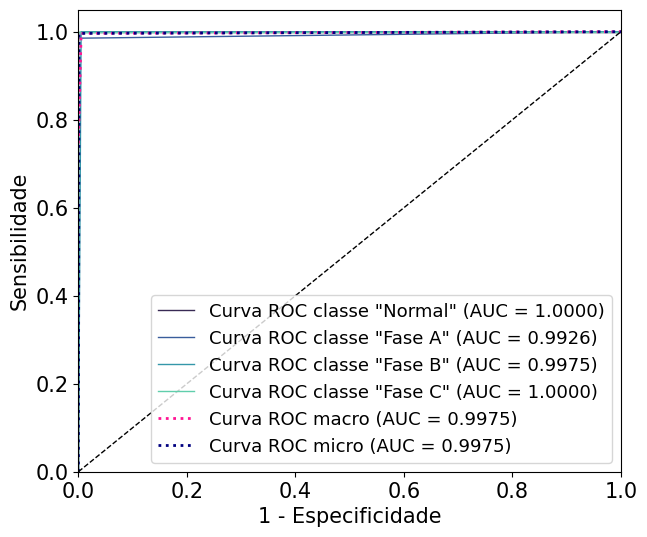

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.24 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000,

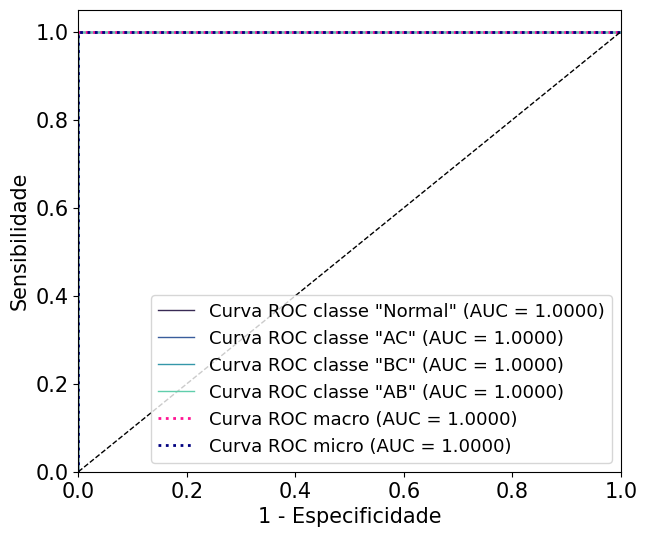

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.26 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 4, 'random_state': 42}
Best AUC ROC: 0.9981396142686465
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-s

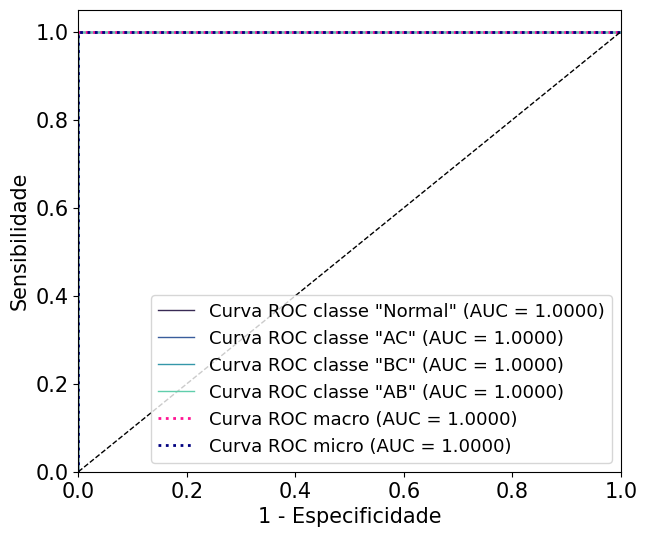

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.25 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000

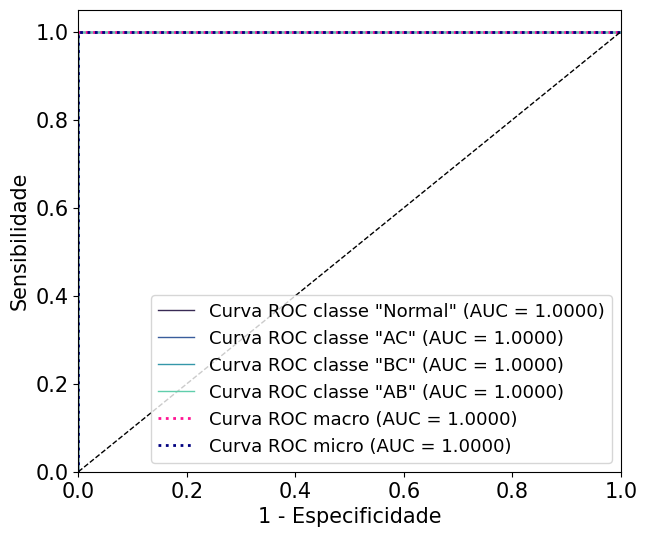

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.22 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.

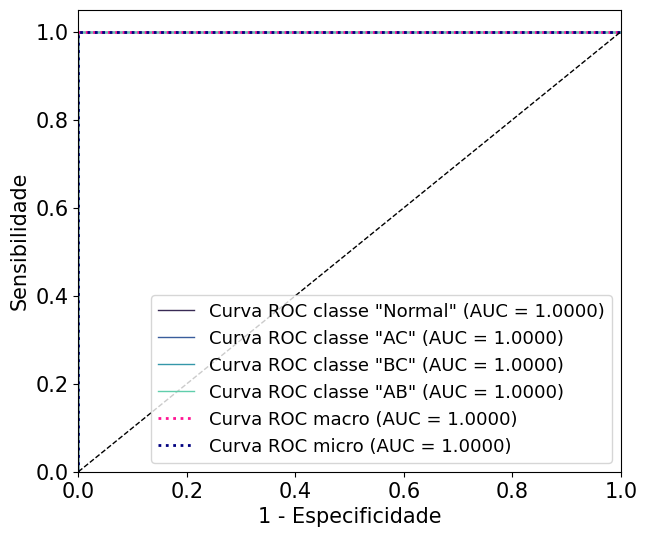

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.23 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 1, 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


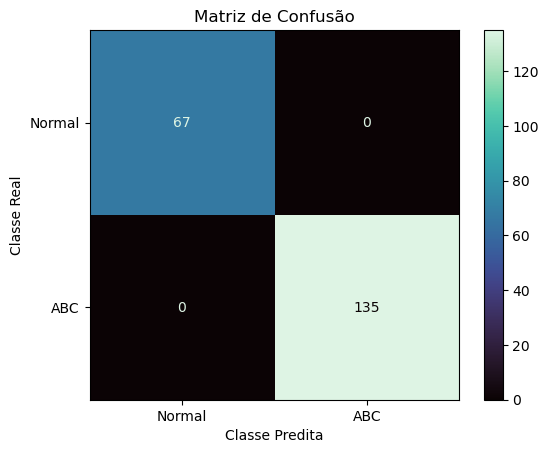

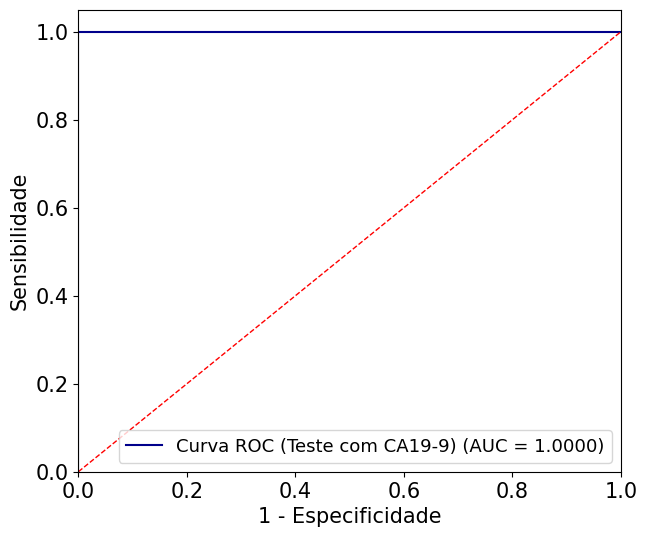

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.20 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 2, 'random_state': 42}
Best AUC ROC: 0.9952924987199181
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


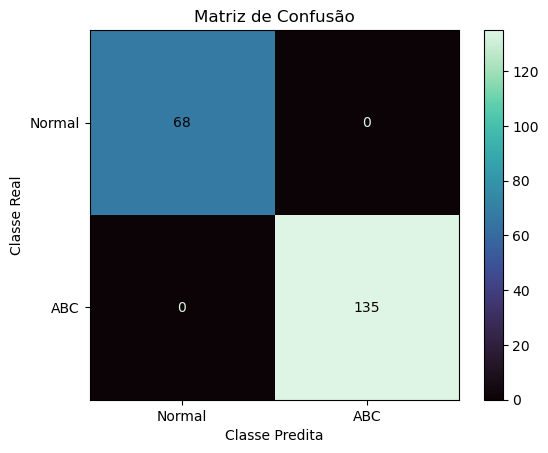

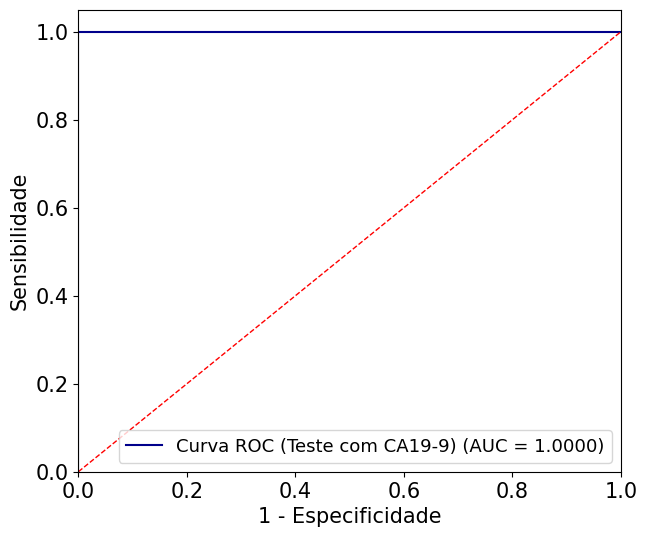

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.19 segundos
Best parameters found: {'criterion': 'entropy', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 0.9984126984126984
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


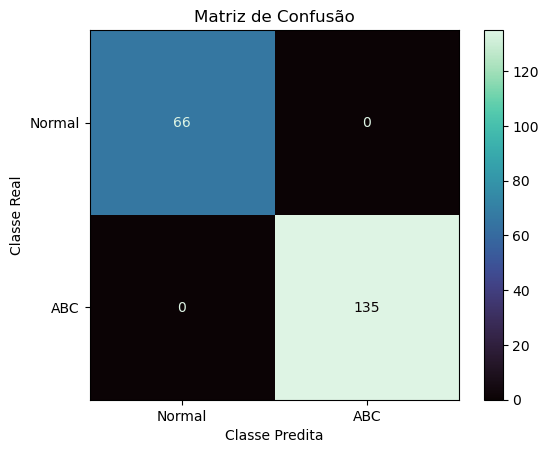

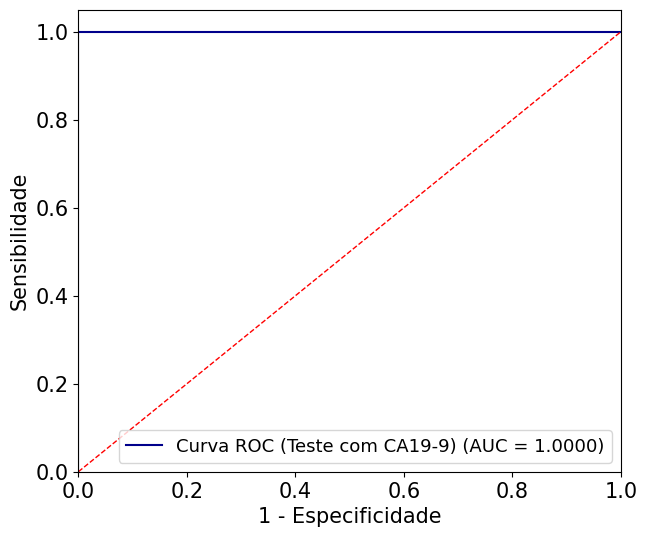

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 0.18 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


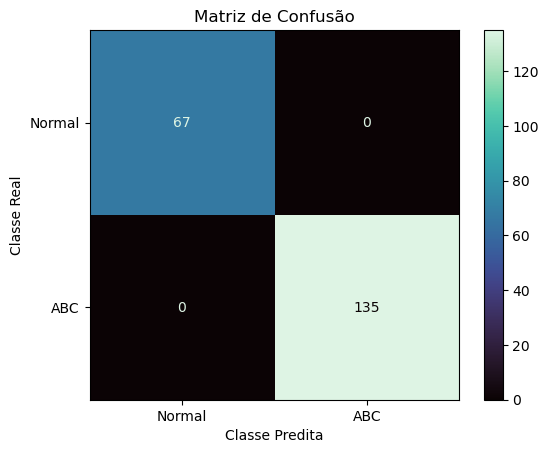

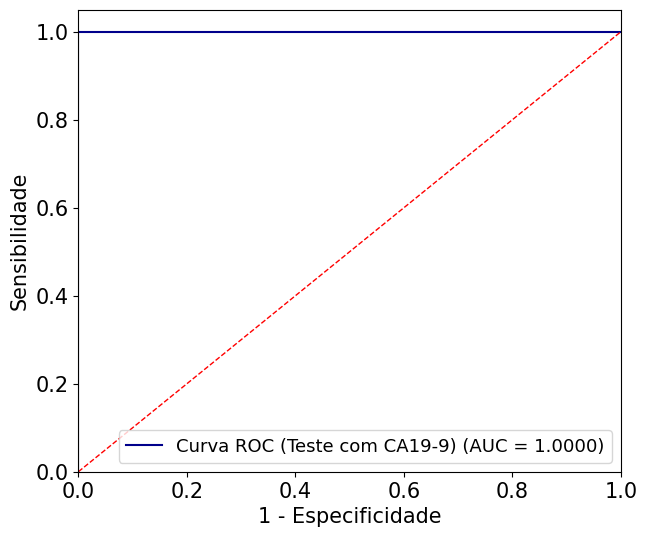

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("DT.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [DecisionTreeClassifier]
param_grid_dt = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 1, 2, 3, 4, 5, 10, 20, 30, 40],
    'random_state': [42]
}
param_grids = [param_grid_dt]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### ET

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.46 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1

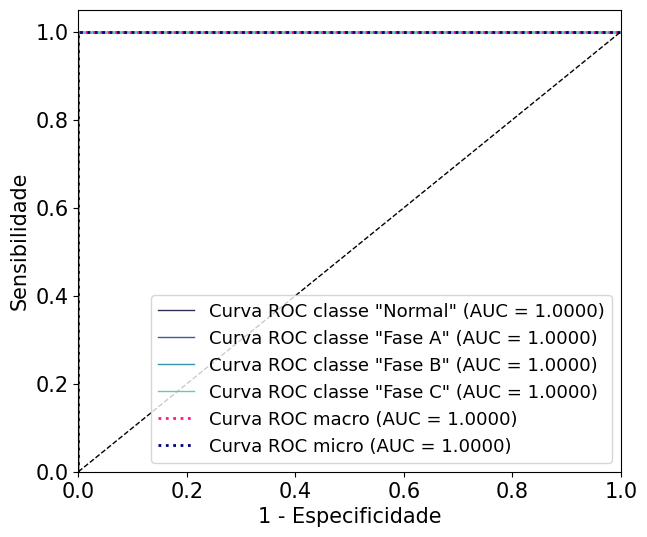

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.43 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 5, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9940841788067984
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.00374532%
Sensitivity (Recall) Macro:0.9693
Sensitivity (Recall) Micro: 0.9700
Especificidade (specificity) macro: 0.9900
Especificidade (specificity) micro: 0.9900
AUC: 0.9958
Matriz de Confusão
[[58  7  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.8923, Specificity = 0.9950, F-score = 0.9409
Class 1: Sensitivity = 1.0000, Specificity = 0.9648, F-score = 0.9821
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000,

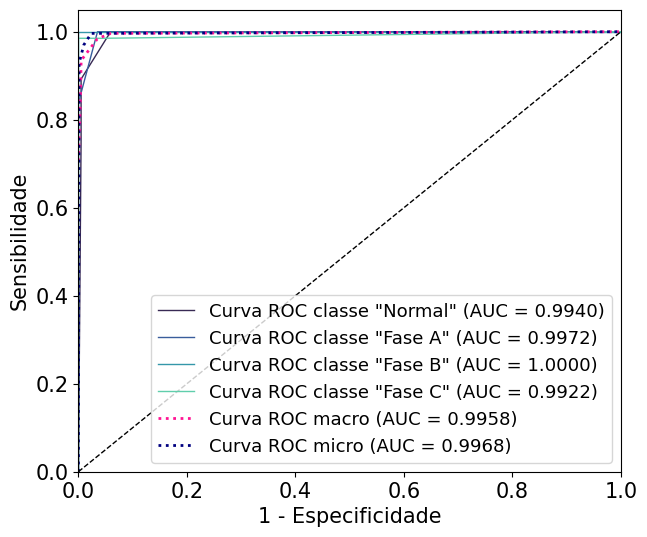

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.43 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'random', 'max_depth': 5, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9966545348902329
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9937
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950

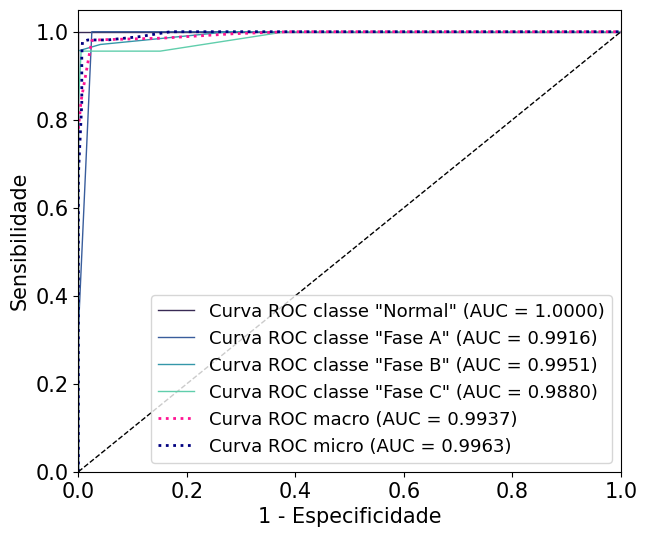

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.42 segundos
Best parameters found: {'criterion': 'entropy', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-sco

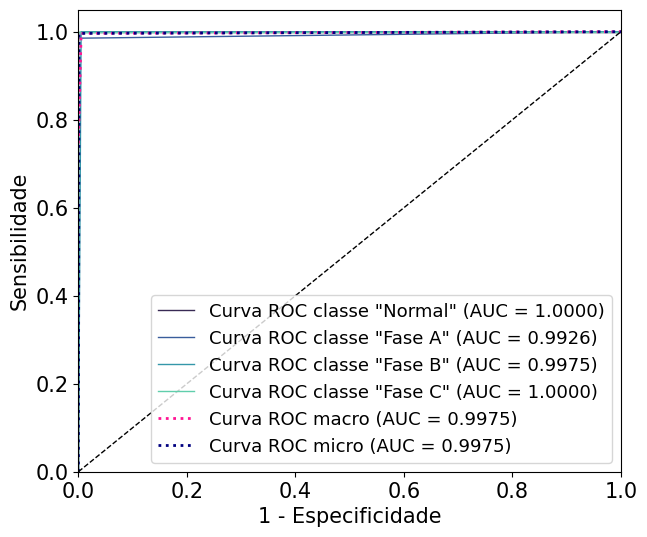

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.41 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.78632479%
Sensitivity (Recall) Macro:0.9981
Sensitivity (Recall) Micro: 0.9979
Especificidade (specificity) macro: 0.9992
Especificidade (specificity) micro: 0.9993
AUC: 0.9988
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 133   1]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 0.9925, Specificity = 1.0000, F-score = 0.9963
Class 3: S

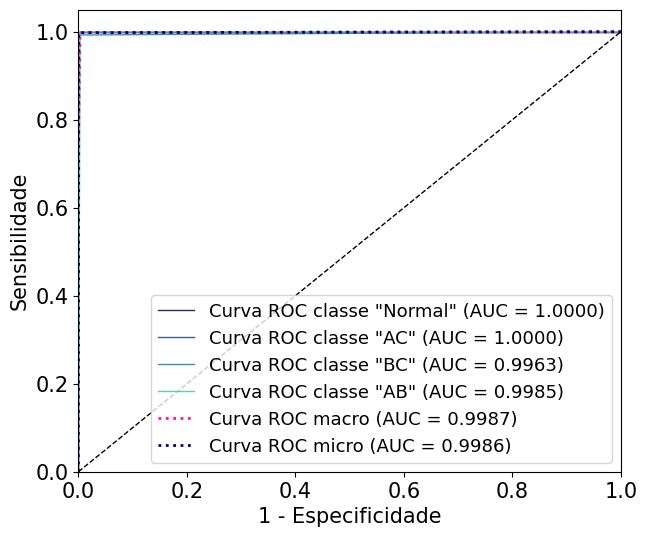

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.43 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 4, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9981344939409456
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Spec

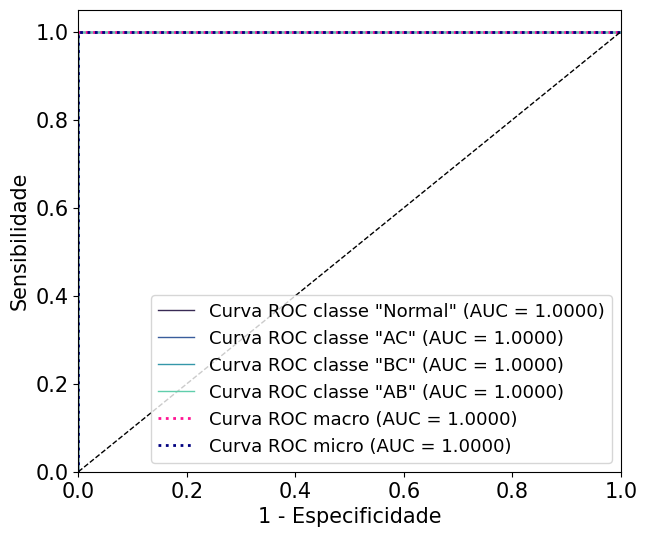

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.41 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0011 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0

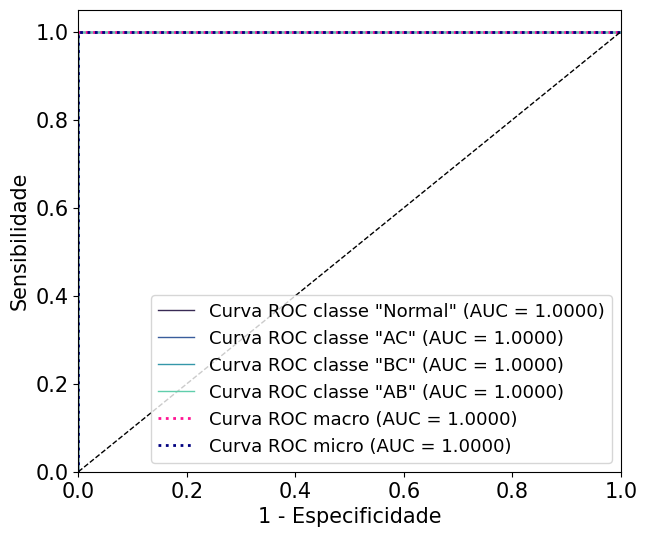

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.43 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity =

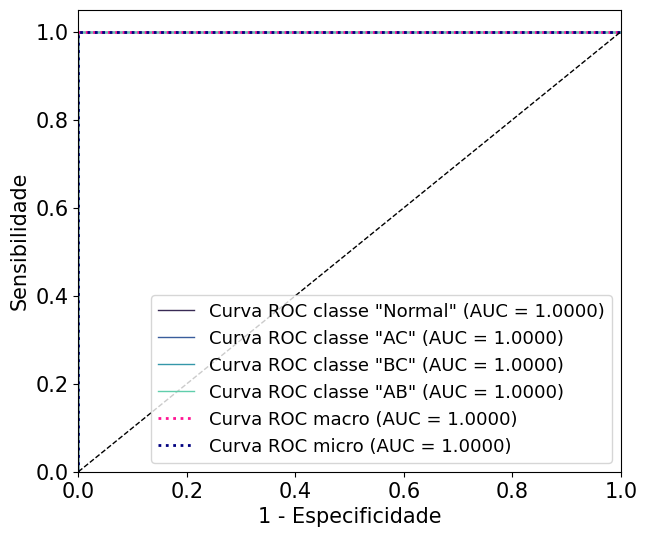

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.37 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 1, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


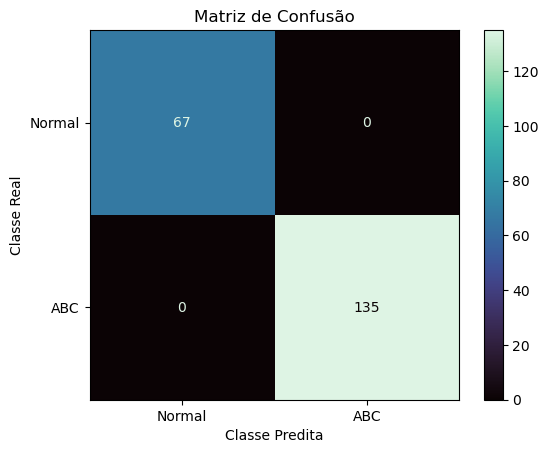

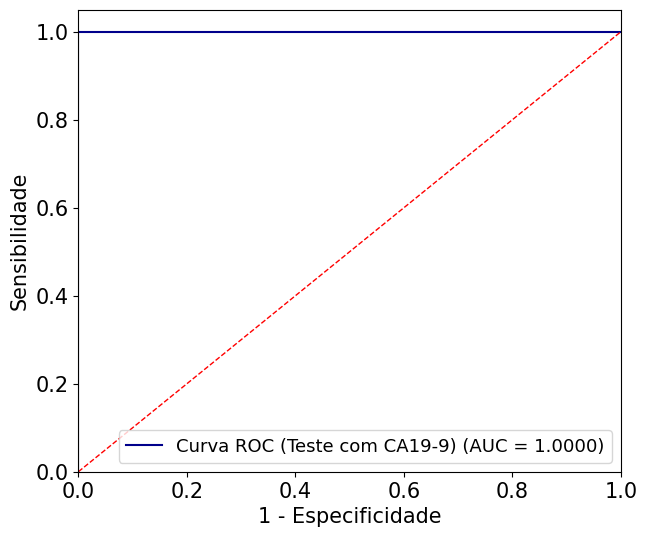

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.35 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'random', 'max_depth': 5, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9962909626216078
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


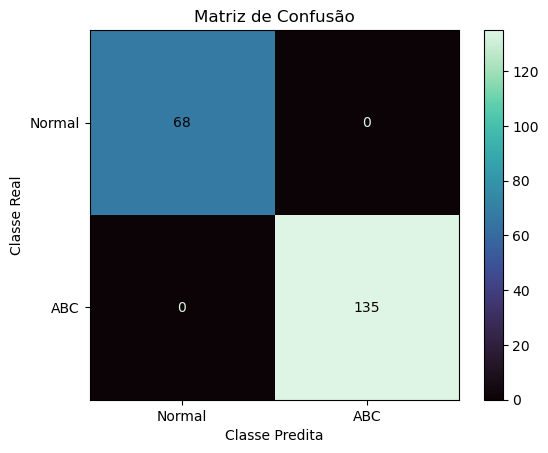

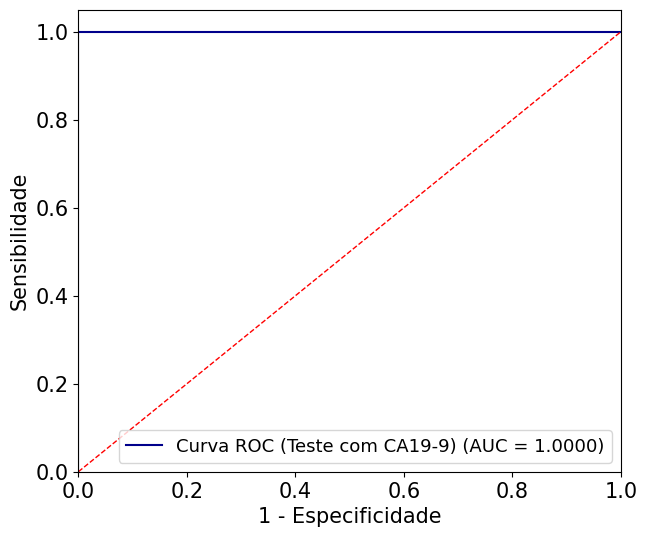

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.36 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


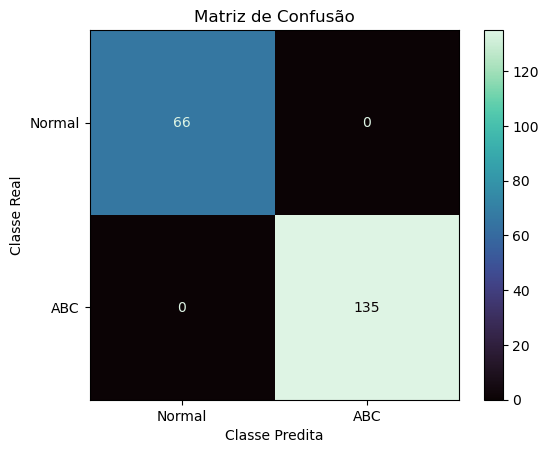

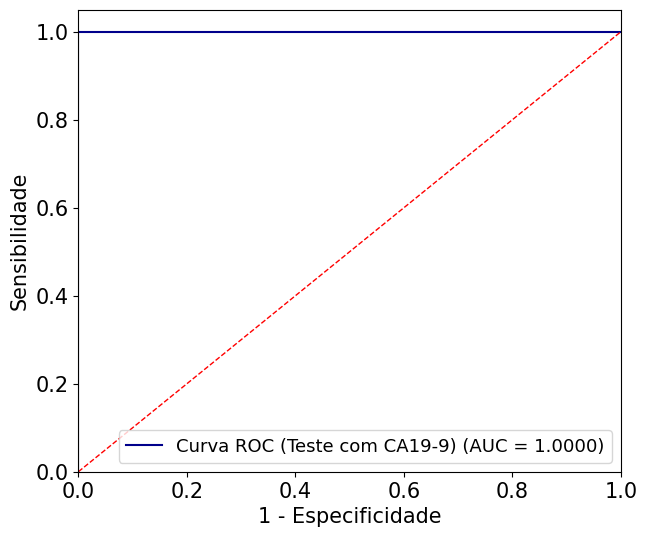

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 0.36 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


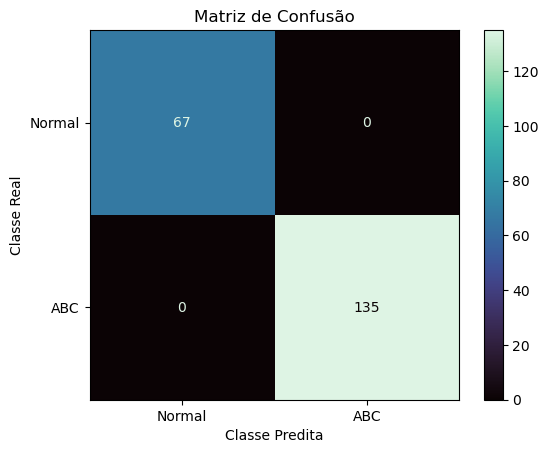

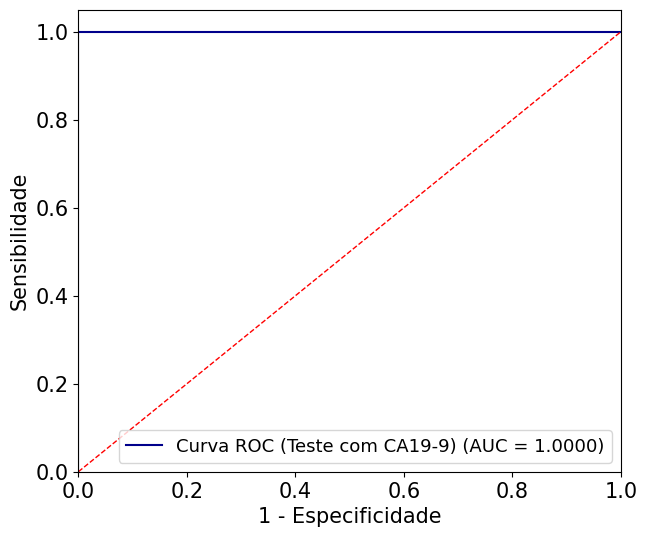

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("ET.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [ExtraTreeClassifier]
param_grid_et = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 1, 2, 3, 4, 5, 10, 20, 30, 40],
    'max_features': ['sqrt', 'log2'],
    'random_state': [42]
}
param_grids = [param_grid_et]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### RL

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 1.70 segundos
Best parameters found: {'C': 1, 'solver': 'lbfgs'}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0120 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


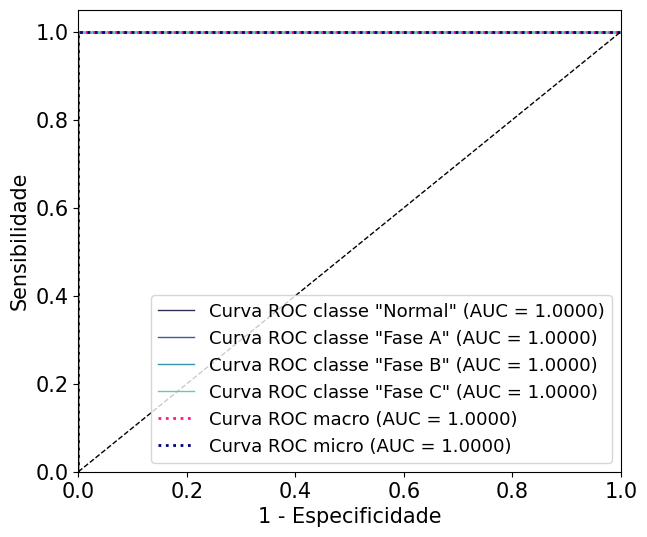

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.28 segundos
Best parameters found: {'C': 1000, 'solver': 'liblinear'}
Best AUC ROC: 0.9845646353624697
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 87.64044944%
Sensitivity (Recall) Macro:0.8756
Sensitivity (Recall) Micro: 0.8764
Especificidade (specificity) macro: 0.9588
Especificidade (specificity) micro: 0.9588
AUC: 0.9810
Matriz de Confusão
[[47 18  0  0]
 [14 54  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.7231, Specificity = 0.9257, F-score = 0.8120
Class 1: Sensitivity = 0.7941, Specificity = 0.9095, F-score = 0.8479
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9131


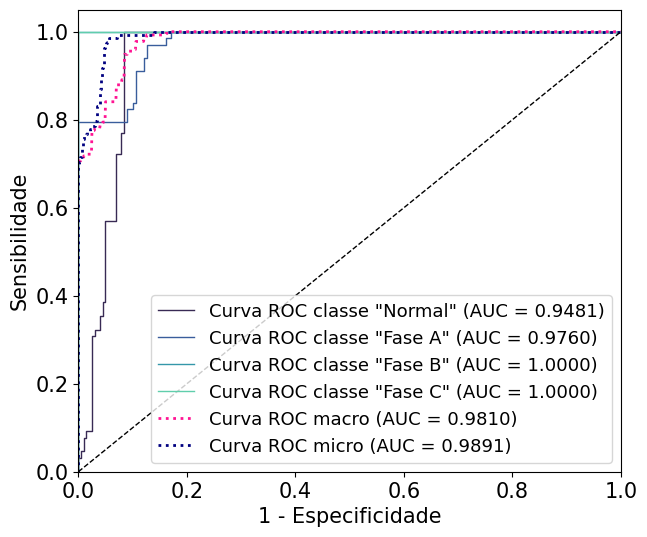

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.27 segundos
Best parameters found: {'C': 10, 'solver': 'liblinear'}
Best AUC ROC: 0.9888317302307348
Tempo de Treinamento: 0.0030 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9838
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


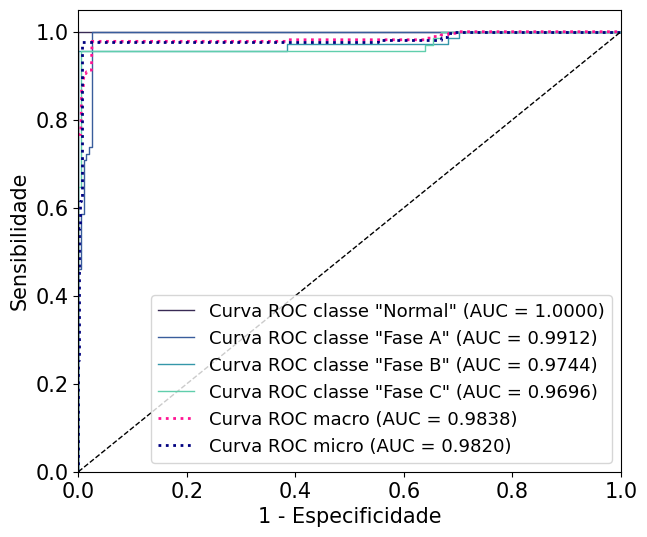

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.27 segundos
Best parameters found: {'C': 0.01, 'solver': 'lbfgs'}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0070 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 91.76029963%
Sensitivity (Recall) Macro:0.9156
Sensitivity (Recall) Micro: 0.9176
Especificidade (specificity) macro: 0.9724
Especificidade (specificity) micro: 0.9725
AUC: 0.9953
Matriz de Confusão
[[44 21  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 0.6769, Specificity = 1.0000, F-score = 0.8073
Class 1: Sensitivity = 0.9853, Specificity = 0.8945, F-score = 0.9377
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9356


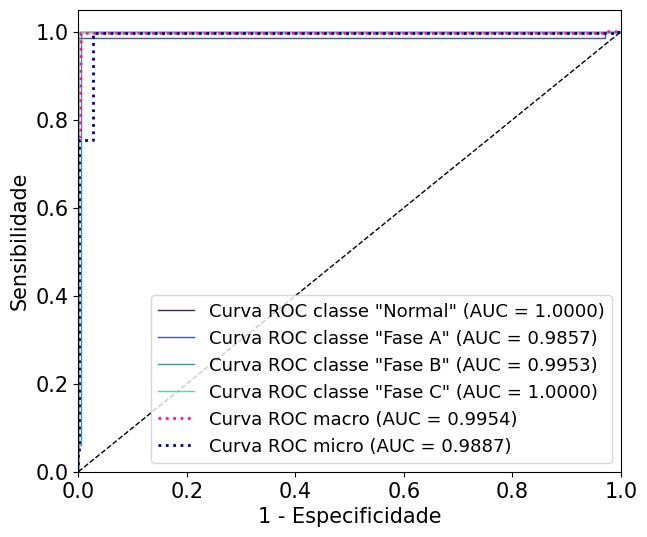

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.31 segundos
Best parameters found: {'C': 1, 'solver': 'lbfgs'}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0110 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 92.52136752%
Sensitivity (Recall) Macro:0.8654
Sensitivity (Recall) Micro: 0.9252
Especificidade (specificity) macro: 0.9738
Especificidade (specificity) micro: 0.9751
AUC: 1.0000
Matriz de Confusão
[[ 30  17   0  18]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 0.4615, Specificity = 1.0000, F-score = 0.6316
Class 1: Sensitivity = 1.0000, Specificity = 0.9491, F-score = 0.9739
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.9459, F-score = 0.9722
Macro F-s

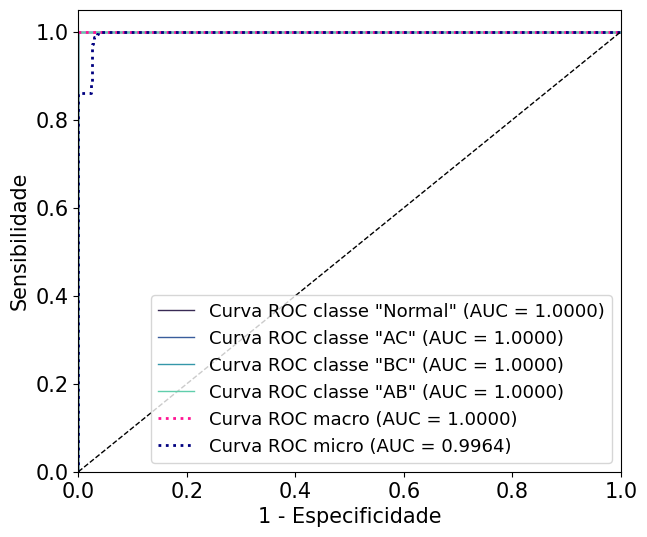

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.30 segundos
Best parameters found: {'C': 1000, 'solver': 'lbfgs'}
Best AUC ROC: 0.9999479433350402
Tempo de Treinamento: 0.0190 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.35897436%
Sensitivity (Recall) Macro:0.9944
Sensitivity (Recall) Micro: 0.9936
Especificidade (specificity) macro: 0.9978
Especificidade (specificity) micro: 0.9979
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 131   3]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 0.9776, Specificity = 1.0000, F-score = 0.9887
Class 3: Sensitivity = 1.0000, Specificity = 0.9910, F-score = 0.9955
Macro F-score: 0.9960


D:\Anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


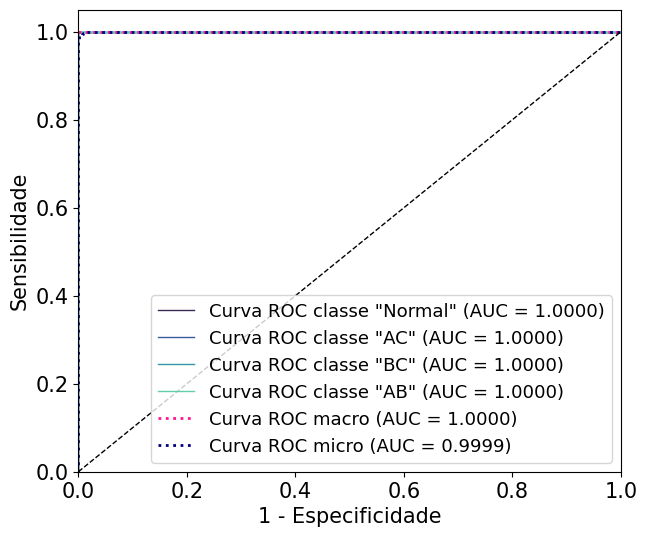

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.30 segundos
Best parameters found: {'C': 0.1, 'solver': 'lbfgs'}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0120 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 86.11111111%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8611
Especificidade (specificity) macro: 0.9513
Especificidade (specificity) micro: 0.9537
AUC: 1.0000
Matriz de Confusão
[[  0  38   0  27]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.8859, F-score = 0.9395
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.9192, F-score = 0.9579
Macro F-score: 0.7243


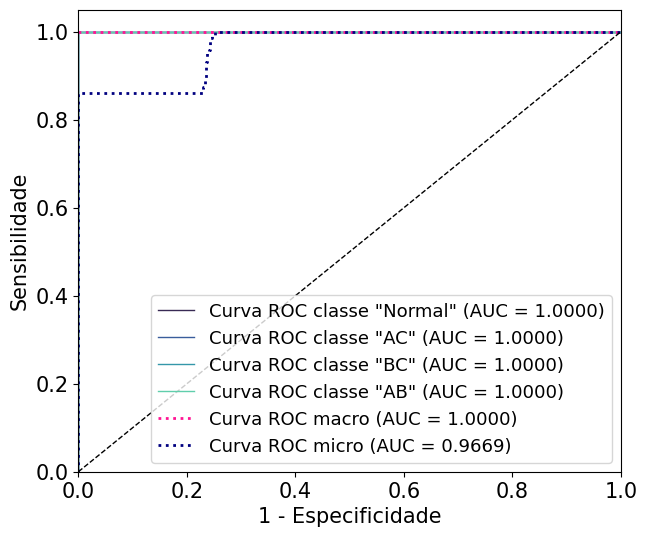

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 0.29 segundos
Best parameters found: {'C': 0.01, 'solver': 'lbfgs'}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0090 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 86.17021277%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8617
Especificidade (specificity) macro: 0.9515
Especificidade (specificity) micro: 0.9539
AUC: 1.0000
Matriz de Confusão
[[  0  13   0  52]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9611, F-score = 0.9802
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.8448, F-score = 0.9159
Macro F-score: 0.7240


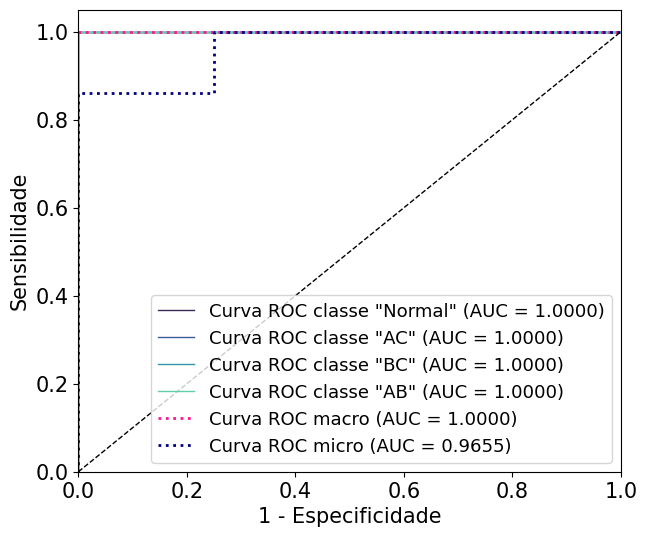

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 0.16 segundos
Best parameters found: {'C': 1000, 'solver': 'lbfgs'}
Best AUC ROC: 0.9899641577060931
Tempo de Treinamento: 0.0030 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


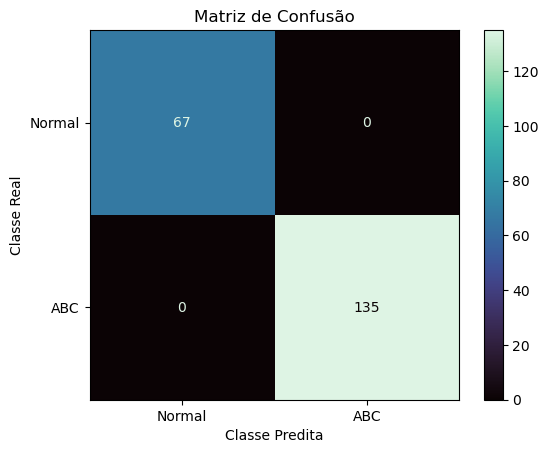

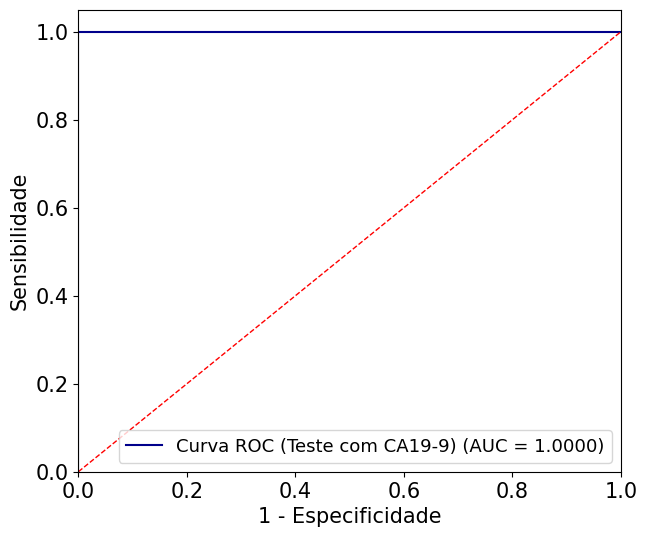

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 0.17 segundos
Best parameters found: {'C': 0.001, 'solver': 'liblinear'}
Best AUC ROC: 0.9918618791602662
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.6650
Precisão = 0.6650
Sensibilidade = 1.0000
Especificidade = 0.0000
F-score = 0.7988
Coeficiente de Correlação de Matthews = 0.0000
AUC = 1.0000
############################################################


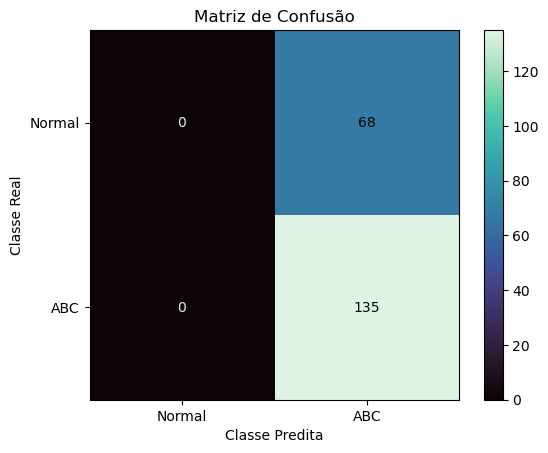

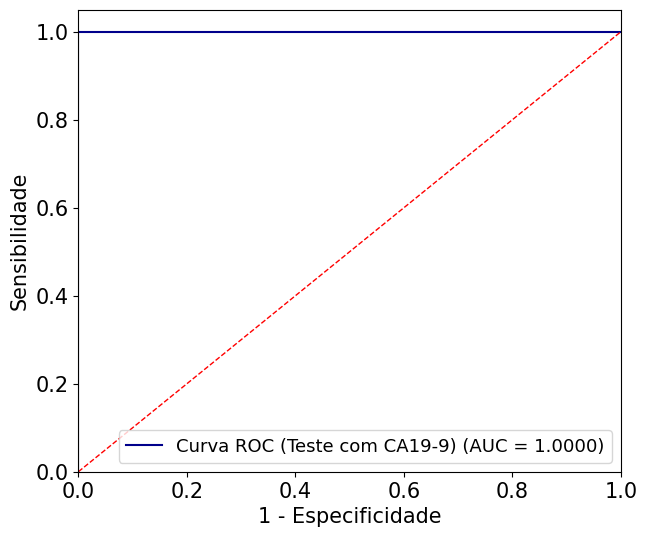

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 0.17 segundos
Best parameters found: {'C': 1000, 'solver': 'liblinear'}
Best AUC ROC: 0.9691609820017728
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.9104
Precisão = 0.9535
Sensibilidade = 0.9111
Especificidade = 0.9091
F-score = 0.9318
Coeficiente de Correlação de Matthews = 0.8033
AUC = 0.9673
############################################################


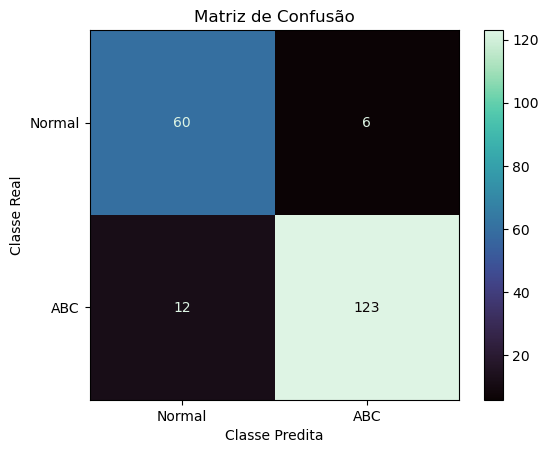

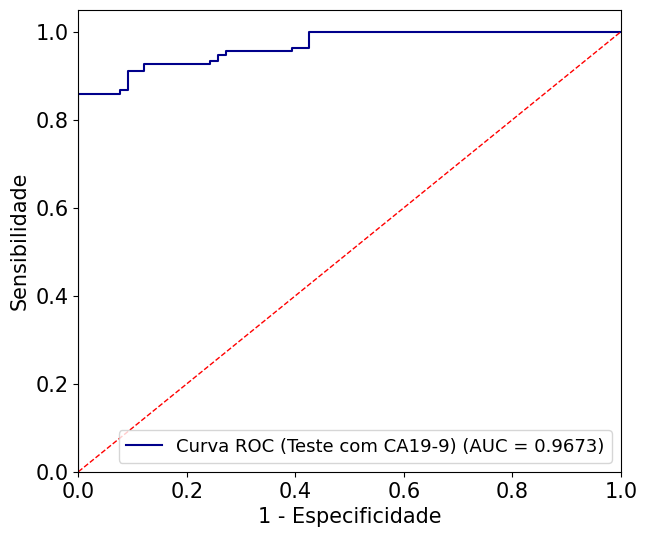

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 0.19 segundos
Best parameters found: {'C': 0.001, 'solver': 'liblinear'}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0011 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.6683
Precisão = 0.6683
Sensibilidade = 1.0000
Especificidade = 0.0000
F-score = 0.8012
Coeficiente de Correlação de Matthews = 0.0000
AUC = 1.0000
############################################################


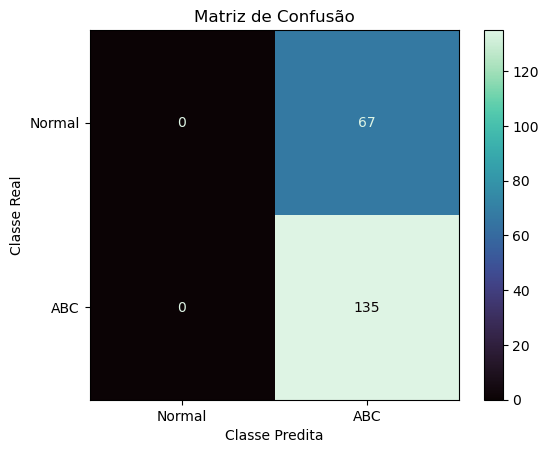

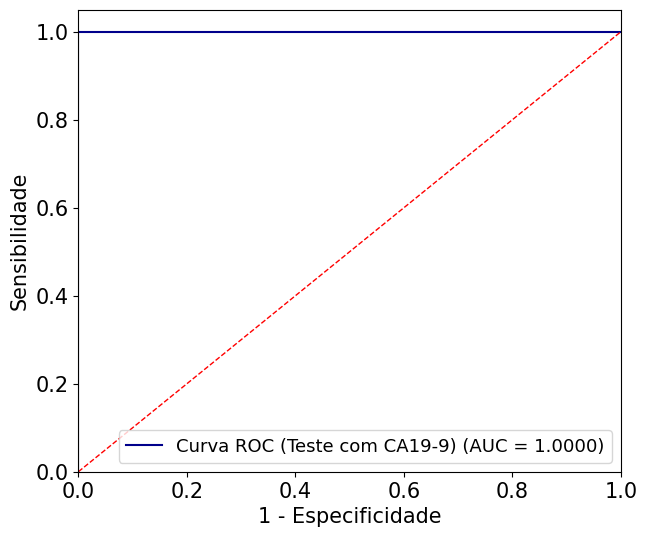

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("RL.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [LogisticRegression]
param_grid_rl = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    # 'penalty': ['l1', 'l2', 'elasticnet', None],
    'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
}
param_grids = [param_grid_rl]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### AdaBoost

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 5.33 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0265 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000

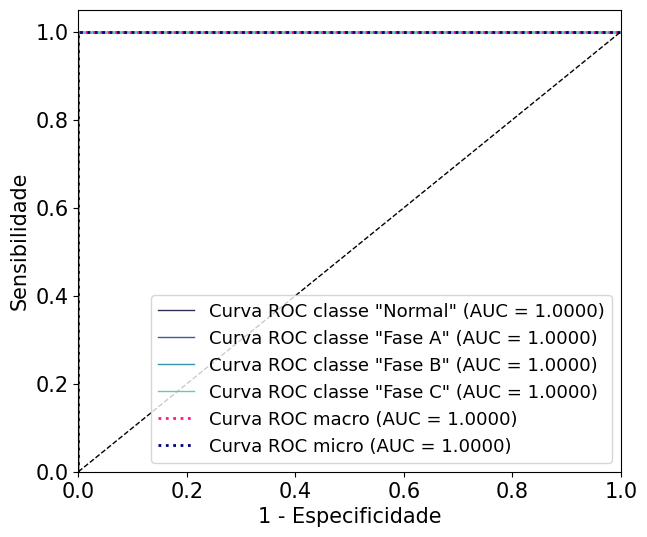

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 5.98 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.8, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 0.9943299442132038
Tempo de Treinamento: 0.0250 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 94.00749064%
Sensitivity (Recall) Macro:0.9410
Sensitivity (Recall) Micro: 0.9401
Especificidade (specificity) macro: 0.9802
Especificidade (specificity) micro: 0.9800
AUC: 0.9924
Matriz de Confusão
[[64  0  0  1]
 [14 54  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.9846, Specificity = 0.9257, F-score = 0.9543
Class 1: Sensitivity = 0.7941, Specificity = 1.0000, F-score = 0.8852
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 0.9950, F-s

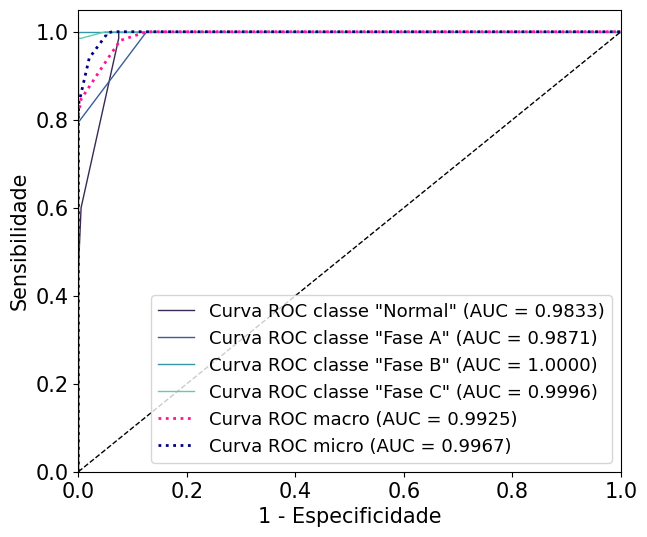

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 5.33 segundos
Best parameters found: {'n_estimators': 200, 'learning_rate': 1.0, 'algorithm': 'SAMME', 'random_state': 42}
Best AUC ROC: 0.9948089239001618
Tempo de Treinamento: 0.2087 segundos
Tempo de Previsão: 0.0090 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro:0.9745
Sensitivity (Recall) Micro: 0.9738
Especificidade (specificity) macro: 0.9913
Especificidade (specificity) micro: 0.9913
AUC: 0.9912
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 65  2]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9420, Specificity = 1.0000, F-score = 0.9701
Class 3: Sensitivity = 0.9559, Specificity = 0.9899, F-sco

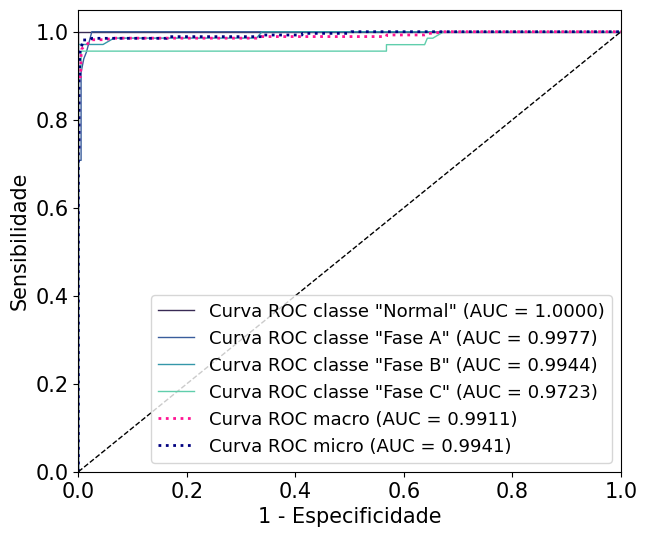

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 5.75 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0280 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0

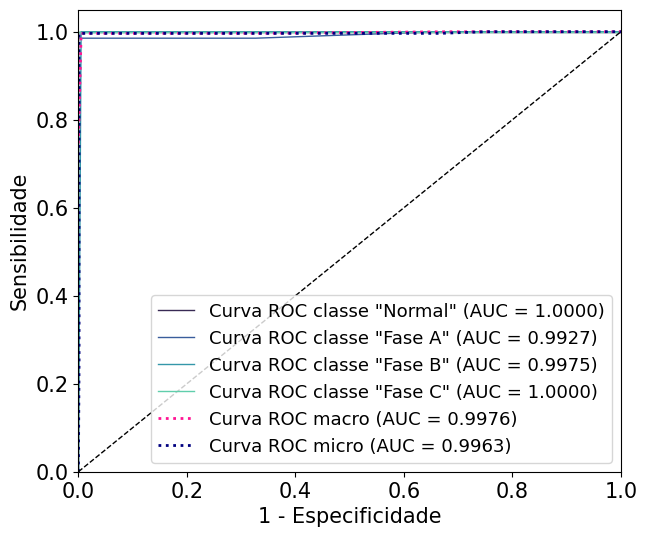

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 6.33 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0269 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sens

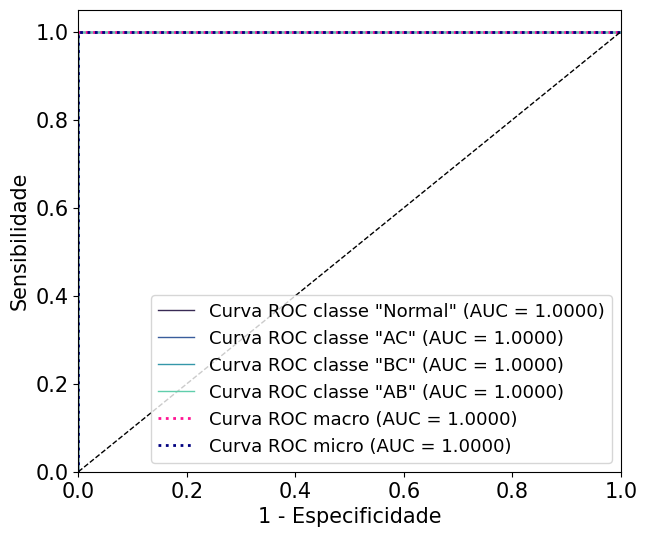

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 8.51 segundos
Best parameters found: {'n_estimators': 200, 'learning_rate': 0.01, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 0.9985825226147806
Tempo de Treinamento: 0.3006 segundos
Tempo de Previsão: 0.0140 segundos
Acurácia: 99.57264957%
Sensitivity (Recall) Macro:0.9923
Sensitivity (Recall) Micro: 0.9957
Especificidade (specificity) macro: 0.9985
Especificidade (specificity) micro: 0.9986
AUC: 0.9999
Matriz de Confusão
[[ 63   2   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 0.9692, Specificity = 1.0000, F-score = 0.9844
Class 1: Sensitivity = 1.0000, Specificity = 0.9940, F-score = 0.9970
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specifi

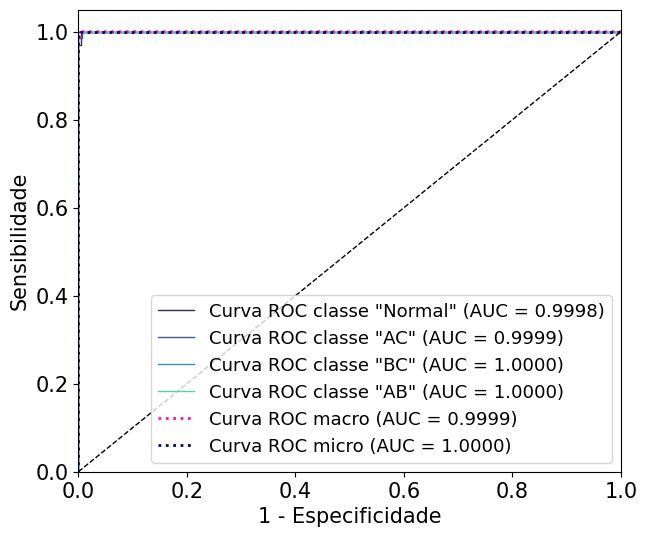

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 8.30 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0279 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000,

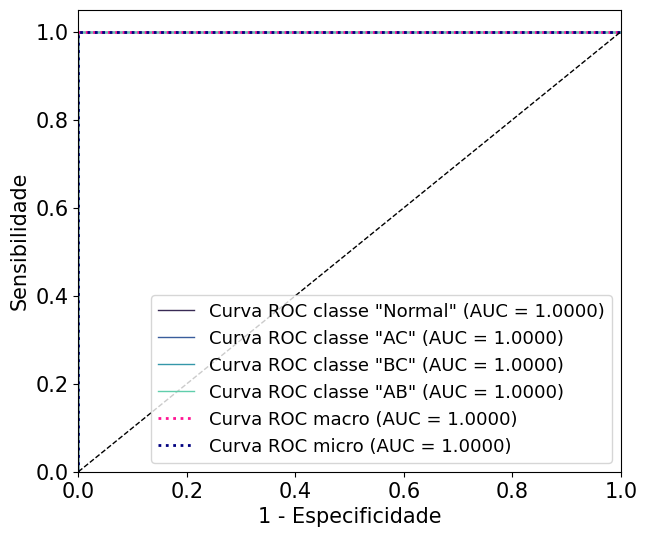

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 8.07 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0250 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0

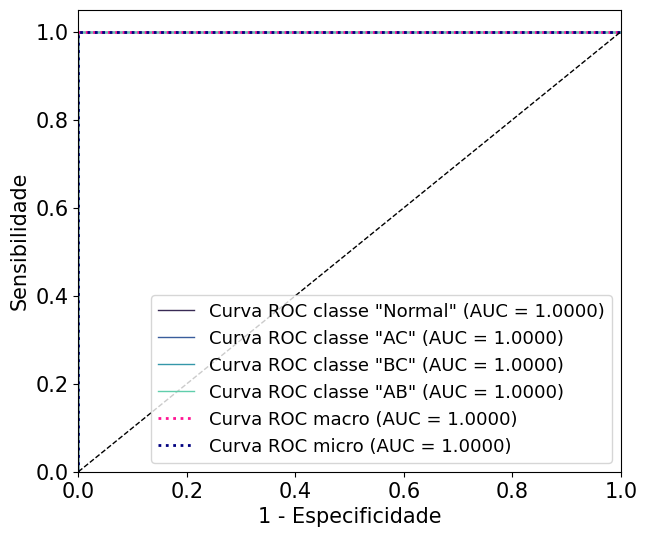

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 5.79 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME', 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0210 segundos
Tempo de Previsão: 0.0019 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


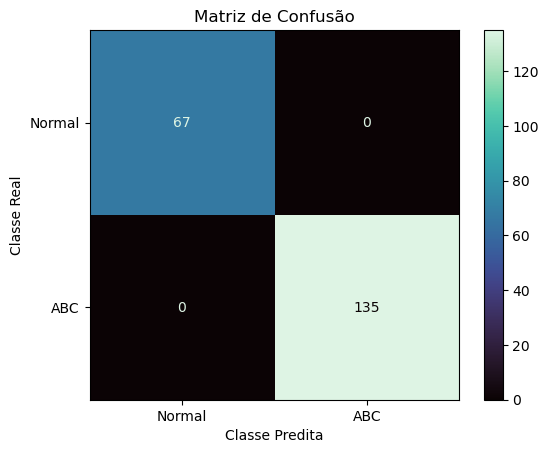

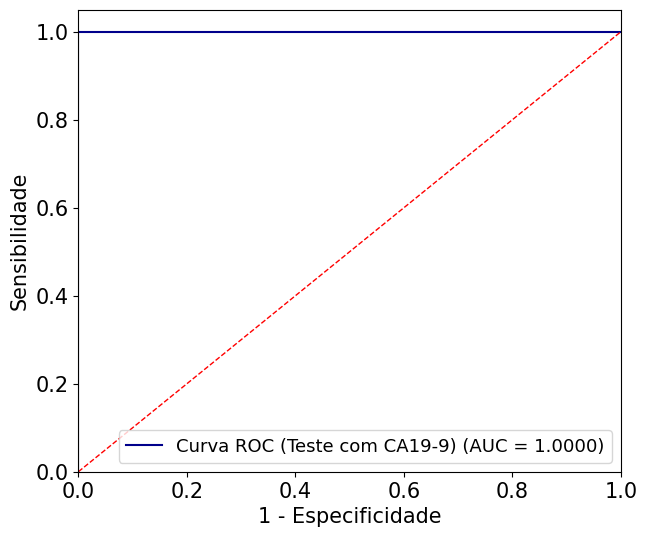

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 6.93 segundos
Best parameters found: {'n_estimators': 100, 'learning_rate': 1.5, 'algorithm': 'SAMME', 'random_state': 42}
Best AUC ROC: 0.9959853430619561
Tempo de Treinamento: 0.1240 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia = 0.9951
Precisão = 1.0000
Sensibilidade = 0.9926
Especificidade = 1.0000
F-score = 0.9963
Coeficiente de Correlação de Matthews = 0.9890
AUC = 1.0000
############################################################


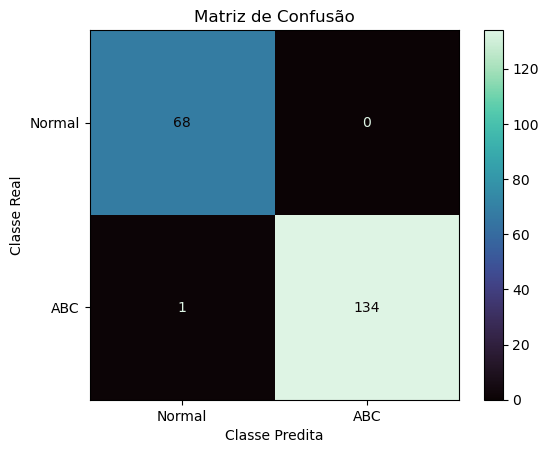

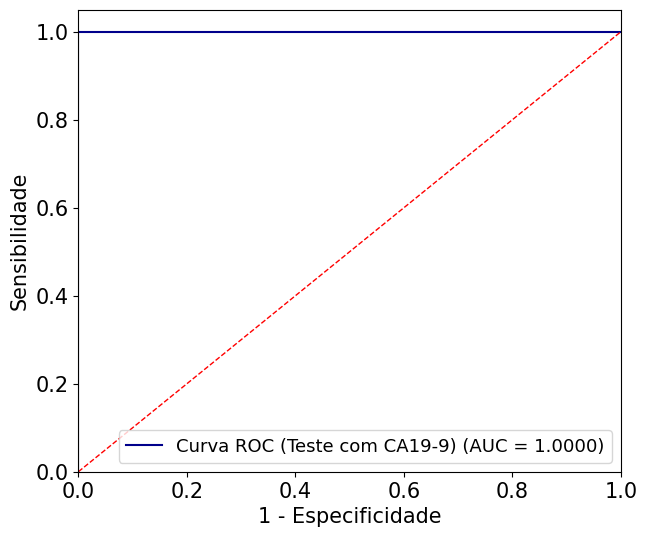

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 6.74 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.2, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0180 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


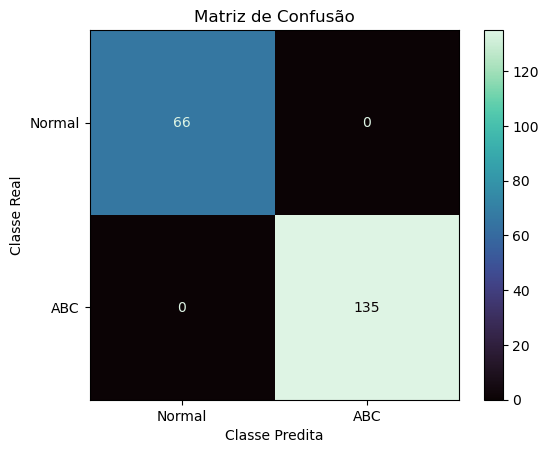

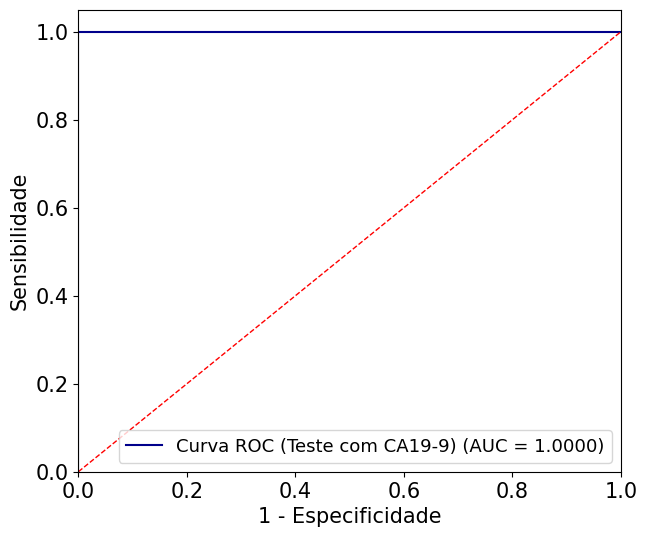

                    
                    
                    
________________________________________
Modelo: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 0.40 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


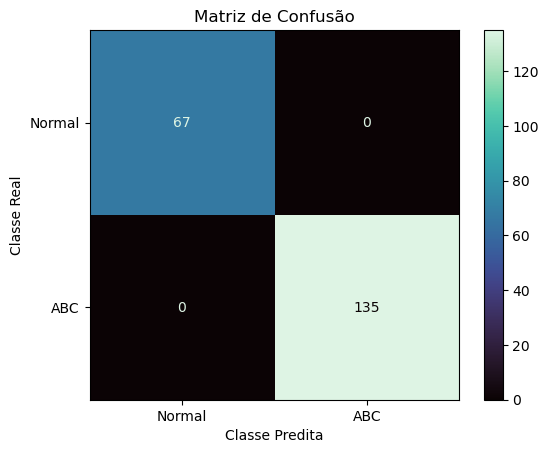

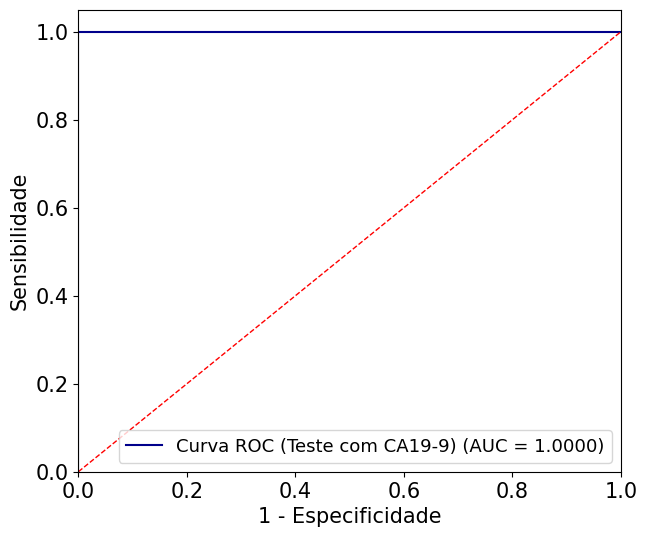

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("AB.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [AdaBoostClassifier]
param_grid_ab =  {
    'n_estimators': [20,30,50, 100, 150, 200],
    'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.2, 0.5, 0.8, 1.0, 1.5, 2.0, 3.0, 5.0],
    'algorithm': ['SAMME', 'SAMME.R'],
    'random_state': [42]
}
param_grids = [param_grid_ab]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### ART Fuzzy

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 371.83 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9240000000000004}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0404 segundos
Tempo de Previsão: 0.0070 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


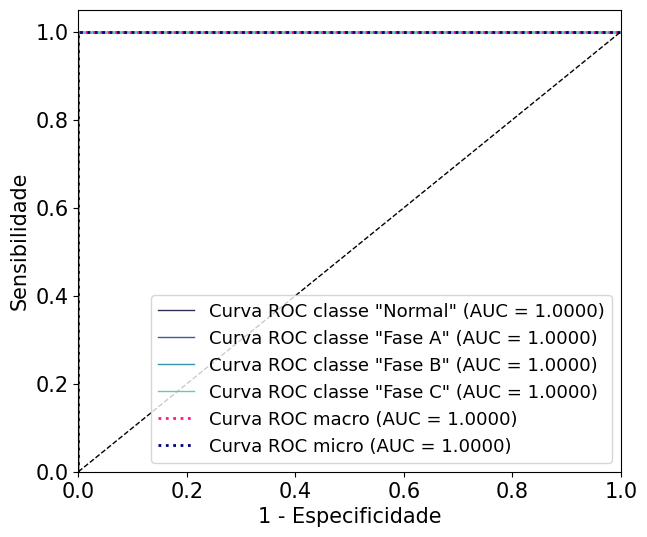

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 361.39 segundos
Best parameters found: {'beta': 0.46999999999999986, 'rho': 0.9940000000000004}
Best AUC ROC: 0.9985417569950282
Tempo de Treinamento: 0.1021 segundos
Tempo de Previsão: 0.0187 segundos
Acurácia: 96.62921348%
Sensitivity (Recall) Macro:0.9656
Sensitivity (Recall) Micro: 0.9663
Especificidade (specificity) macro: 0.9887
Especificidade (specificity) micro: 0.9888
AUC: 0.9981
Matriz de Confusão
[[58  7  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 2  0  0 65]]
Class 0: Sensitivity = 0.8923, Specificity = 0.9901, F-score = 0.9387
Class 1: Sensitivity = 1.0000, Specificity = 0.9648, F-score = 0.9821
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9701, Specificity = 1.0000, F-score = 0.9848
Macro F-score: 0.9764


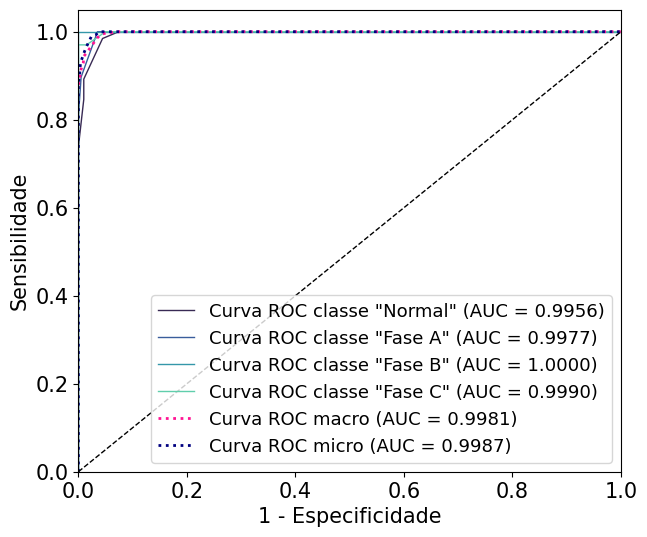

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 405.07 segundos
Best parameters found: {'beta': 0.4199999999999998, 'rho': 0.9820000000000004}
Best AUC ROC: 0.9979016857078854
Tempo de Treinamento: 0.1000 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9980
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


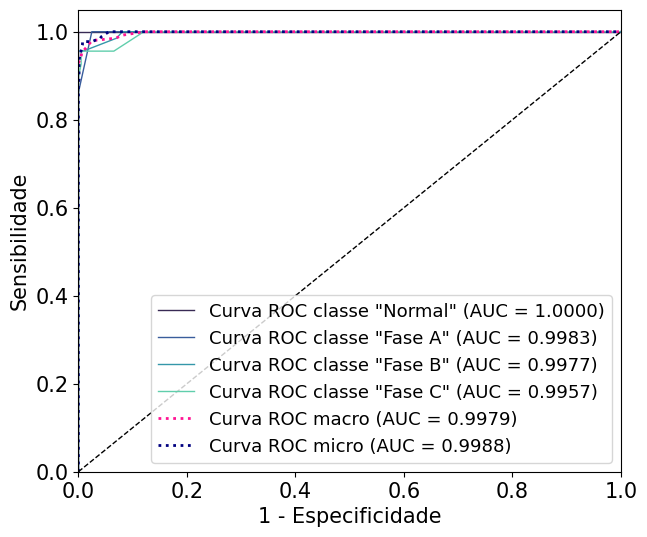

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 338.96 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9340000000000004}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


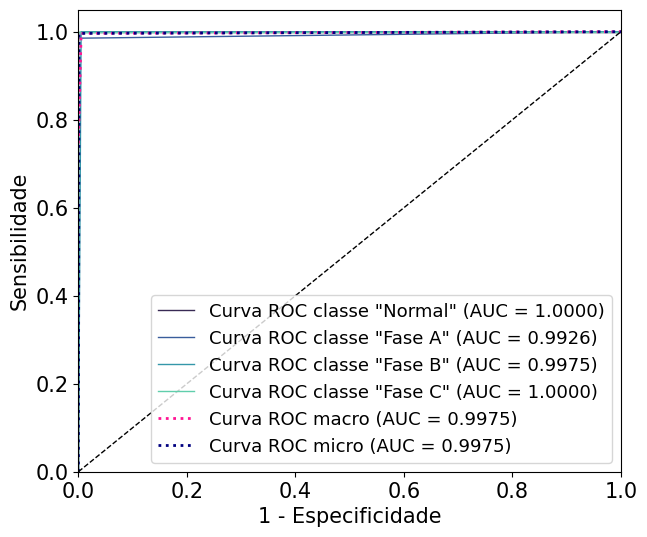

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 579.33 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9230000000000004}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0500 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.78632479%
Sensitivity (Recall) Macro:0.9981
Sensitivity (Recall) Micro: 0.9979
Especificidade (specificity) macro: 0.9994
Especificidade (specificity) micro: 0.9993
AUC: 0.9994
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  1   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9975, F-score = 0.9988
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9926, Specificity = 1.0000, F-score = 0.9963
Macro F-sco

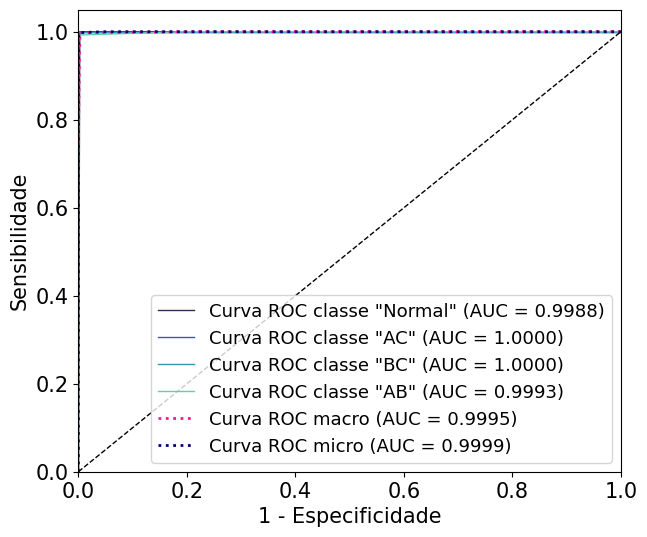

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 494.35 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9920000000000004}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1999 segundos
Tempo de Previsão: 0.0401 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


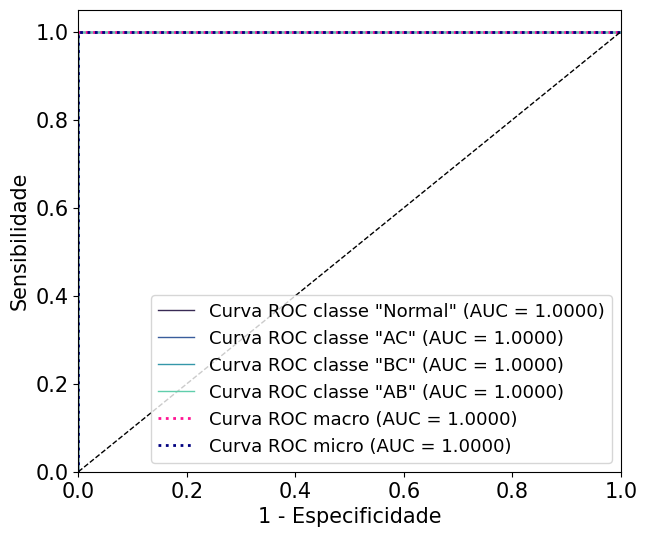

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 502.67 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.8700000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0501 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


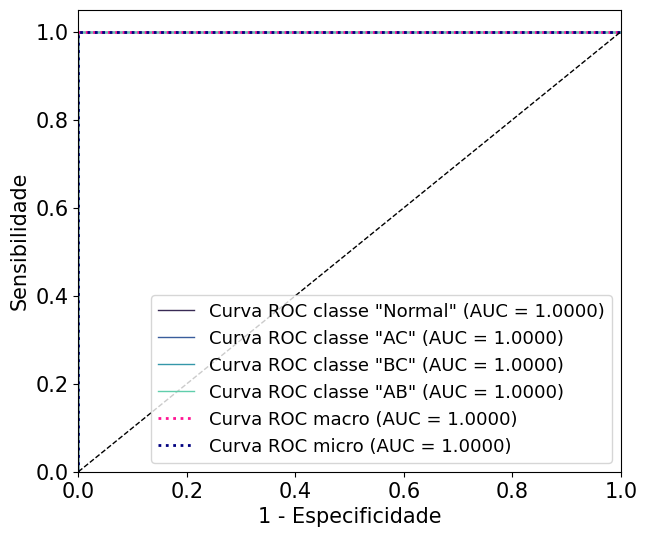

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 510.37 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.8080000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0400 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


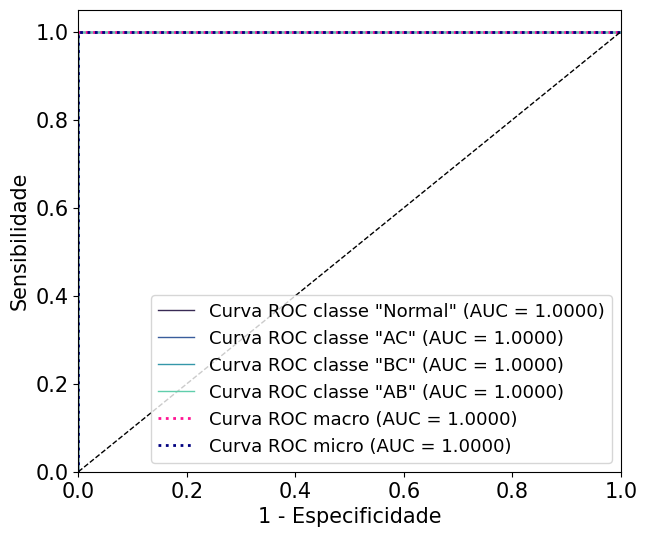

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 179.52 segundos
Best parameters found: {'beta': 0.24999999999999992, 'rho': 0.9910000000000004}
Best AUC ROC: 0.9956989247311828
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


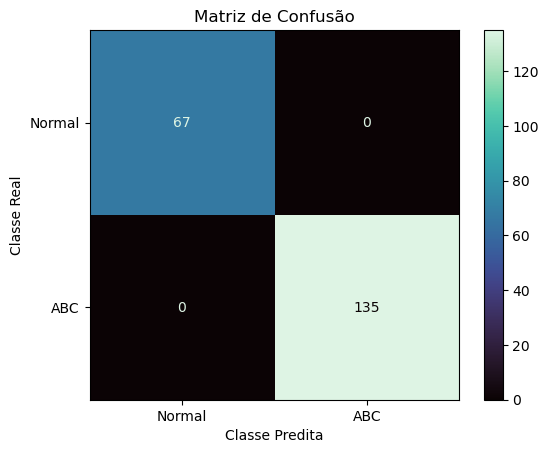

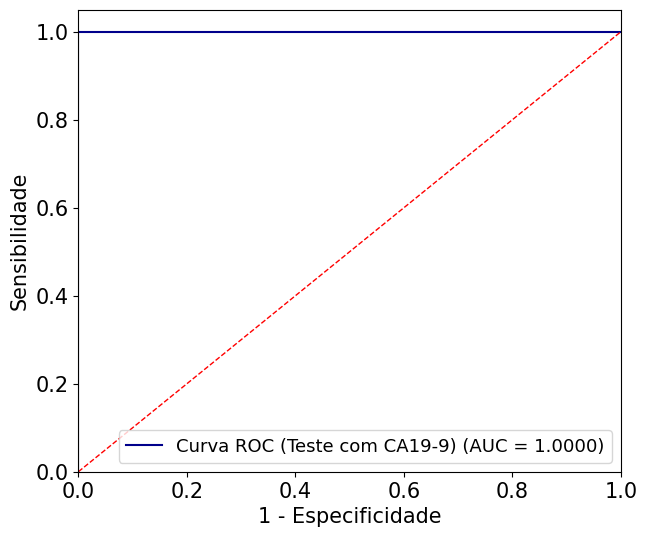

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 179.01 segundos
Best parameters found: {'beta': 0.24999999999999992, 'rho': 0.9960000000000004}
Best AUC ROC: 0.9963429659498209
Tempo de Treinamento: 0.0400 segundos
Tempo de Previsão: 0.0099 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


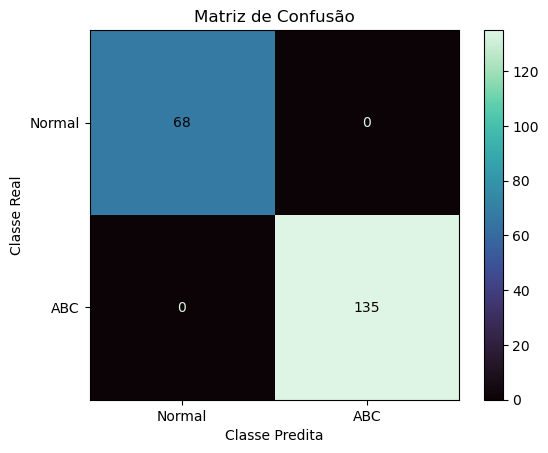

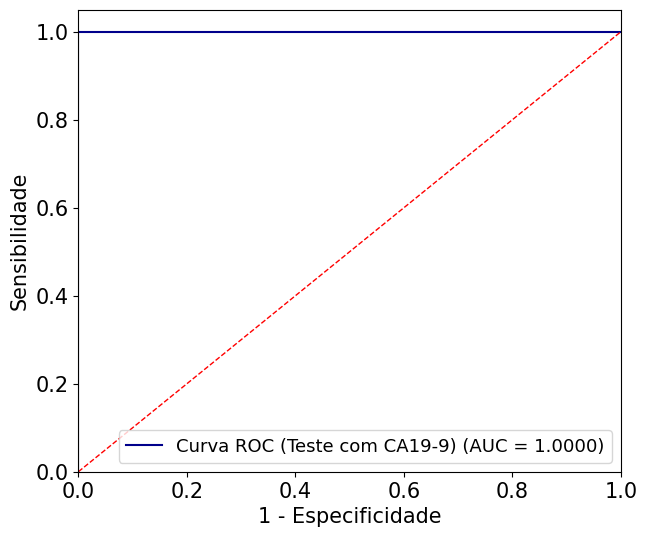

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 179.40 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9960000000000004}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


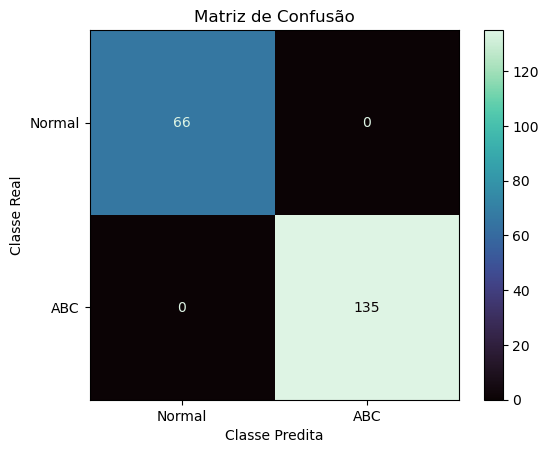

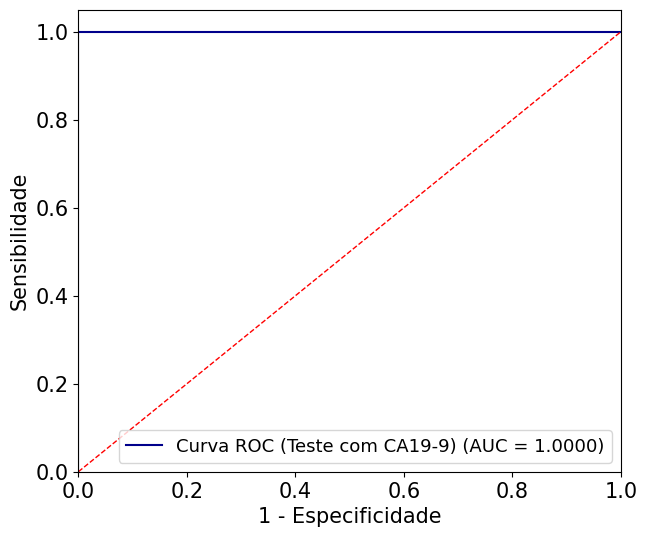

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Fuzzy_AE_Classifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 179.31 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9840000000000004}
Best AUC ROC: 0.988120839733743
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.9950
Precisão = 0.9926
Sensibilidade = 1.0000
Especificidade = 0.9851
F-score = 0.9963
Coeficiente de Correlação de Matthews = 0.9889
AUC = 0.9931
############################################################


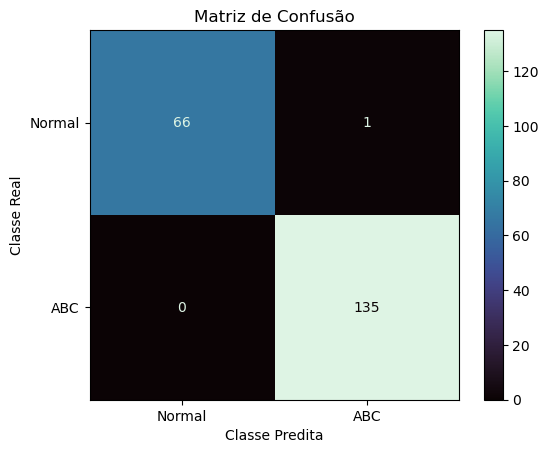

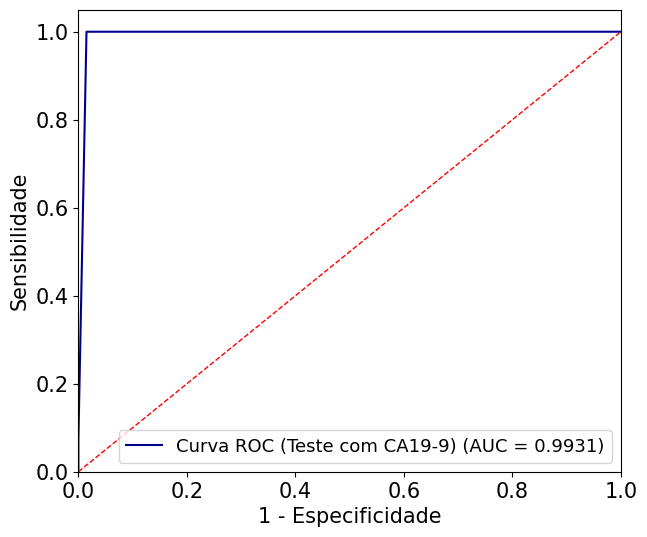

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("AB.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [ART_Fuzzy_AE_Classifier]
param_grid_art_fuzzy = {
    'beta': np.arange(0.1, 0.5, 0.01),
    'rho': np.arange(0.5, 0.999, 0.001)
}
param_grids = [param_grid_art_fuzzy]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

### ART Euclidiana

Curto-Monofásico
Total de iterações: 12
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 2674.69 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 1.7900 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


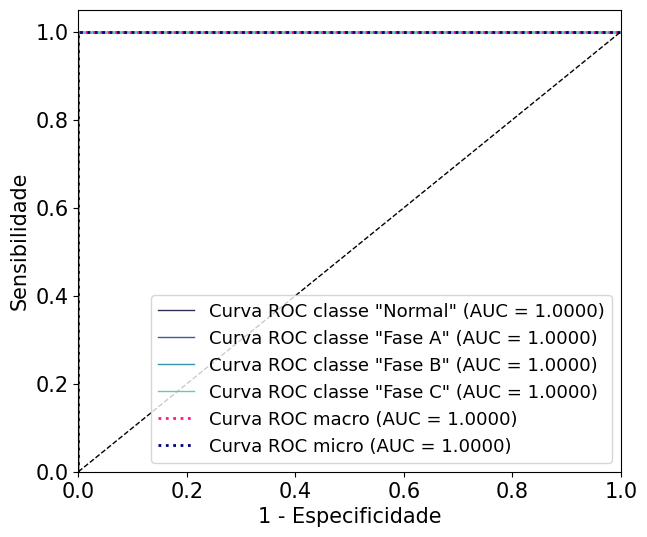

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 2374.52 segundos
Best parameters found: {'beta': 0.19999999999999996, 'rho': 0.01396}
Best AUC ROC: 0.9987462784714995
Tempo de Treinamento: 0.0600 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 96.25468165%
Sensitivity (Recall) Macro:0.9619
Sensitivity (Recall) Micro: 0.9625
Especificidade (specificity) macro: 0.9875
Especificidade (specificity) micro: 0.9875
AUC: 0.9980
Matriz de Confusão
[[58  7  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 3  0  0 64]]
Class 0: Sensitivity = 0.8923, Specificity = 0.9851, F-score = 0.9364
Class 1: Sensitivity = 1.0000, Specificity = 0.9648, F-score = 0.9821
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9552, Specificity = 1.0000, F-score = 0.9771
Macro F-score: 0.9739


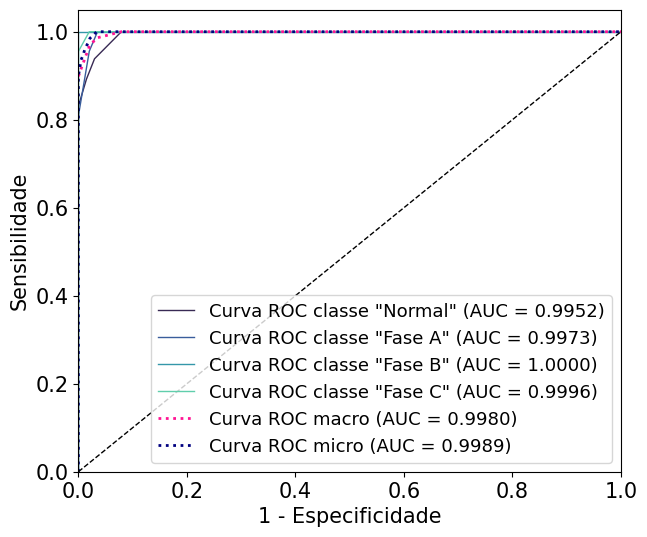

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 2659.50 segundos
Best parameters found: {'beta': 0.2699999999999999, 'rho': 0.03411}
Best AUC ROC: 0.9983416988687276
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9981
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


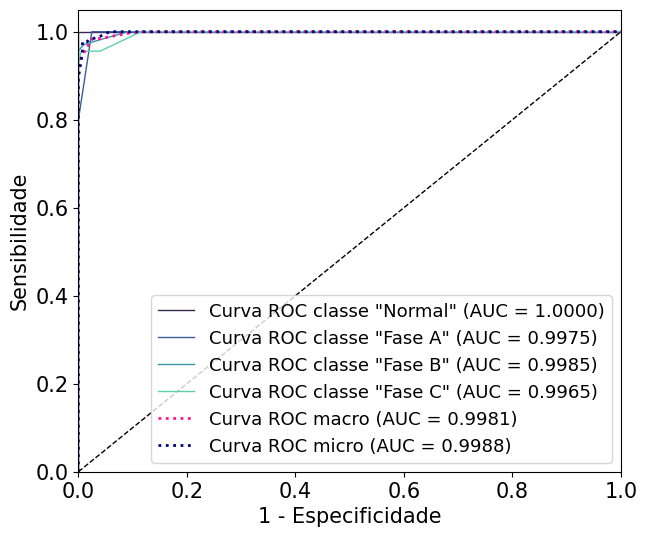

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 1447.80 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 1.7201 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


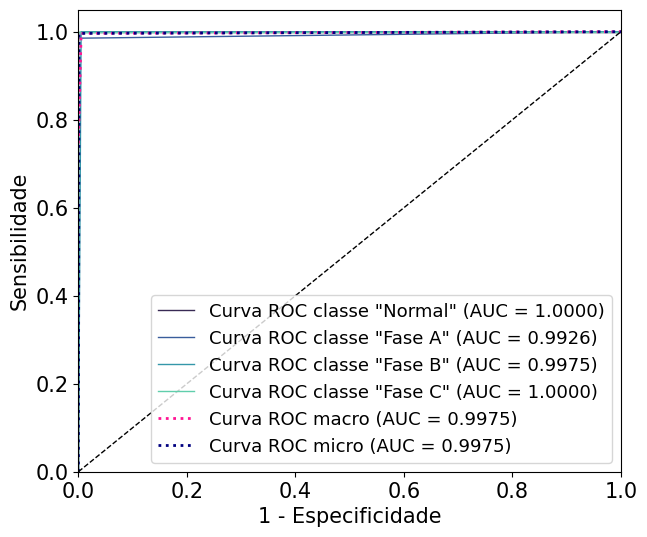

                    
                    
                    
Curto-Bifásico
Total de iterações: 12
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 4155.68 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 6.4691 segundos
Tempo de Previsão: 0.0297 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0

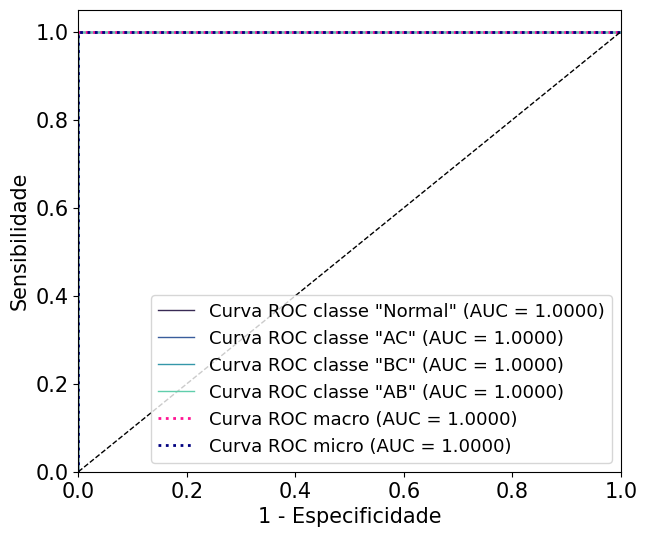

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 4095.40 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 6.3564 segundos
Tempo de Previsão: 0.0400 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


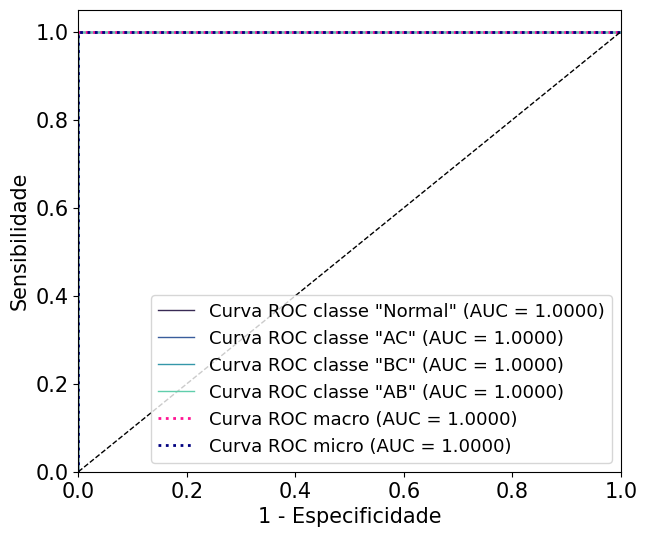

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 3284.33 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 4.2104 segundos
Tempo de Previsão: 0.0299 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


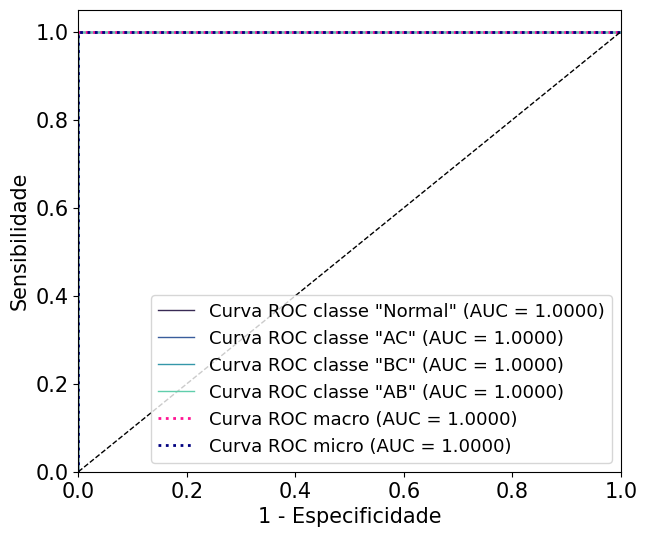

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados Sem GD:
Tempo de execução Busca em grade: 2165.85 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 2.3299 segundos
Tempo de Previsão: 0.0300 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


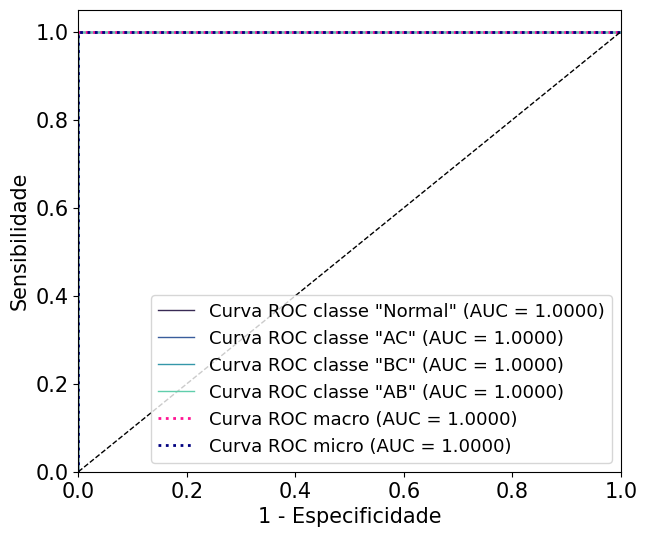

                    
                    
                    
Curto-Trifásico
Total de iterações: 12
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados 2PV:
Tempo de execução Busca em grade: 1020.19 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 1.3113 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


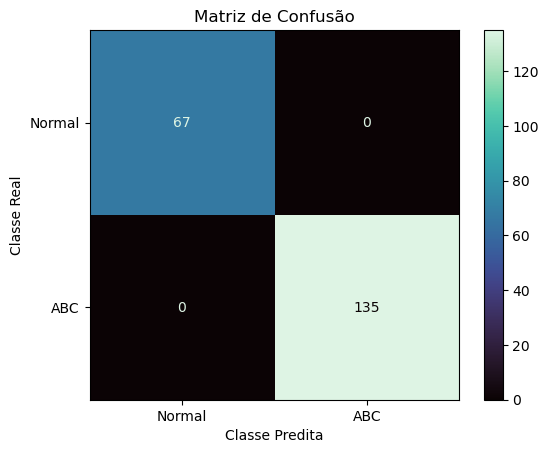

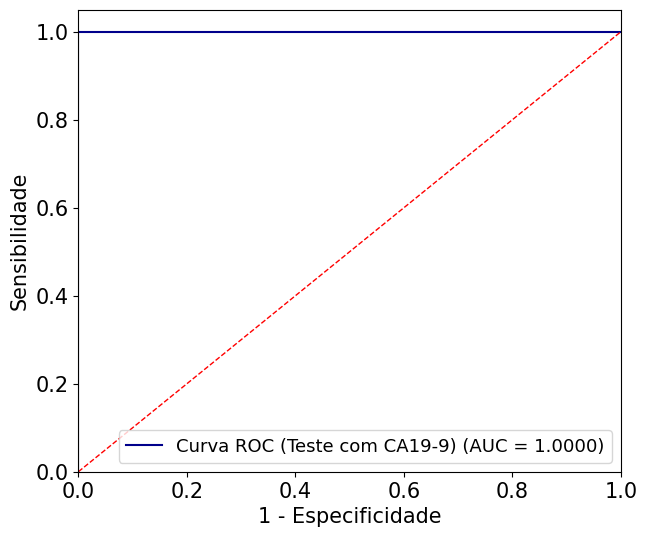

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados 3PV:
Tempo de execução Busca em grade: 1098.18 segundos
Best parameters found: {'beta': 0.46999999999999986, 'rho': 0.00481}
Best AUC ROC: 0.9989359318996416
Tempo de Treinamento: 0.0301 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


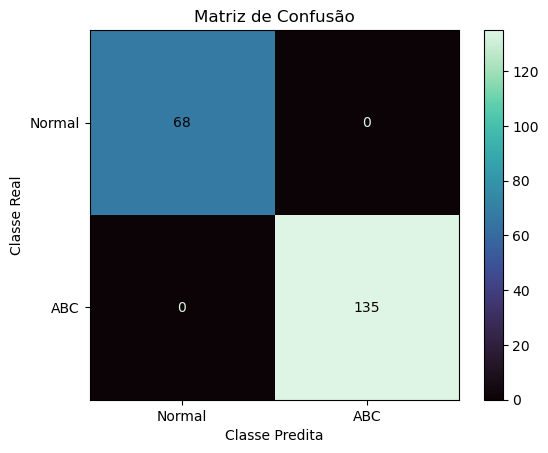

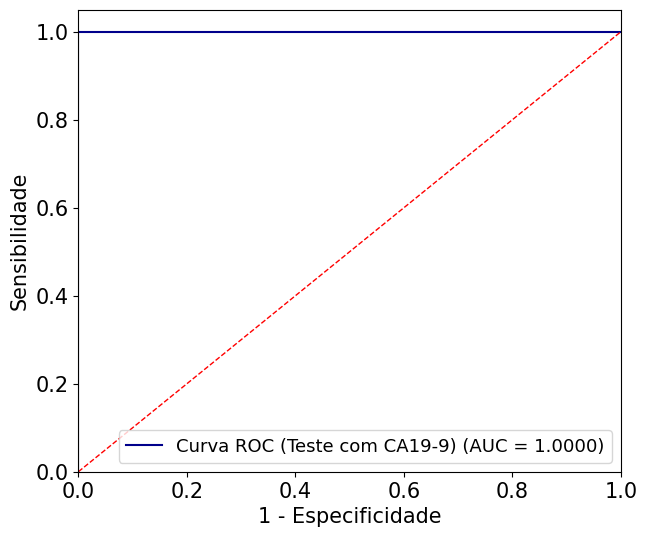

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados PV:
Tempo de execução Busca em grade: 1052.00 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.8825 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


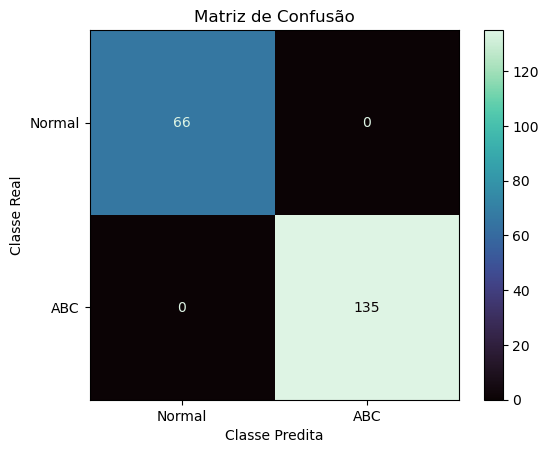

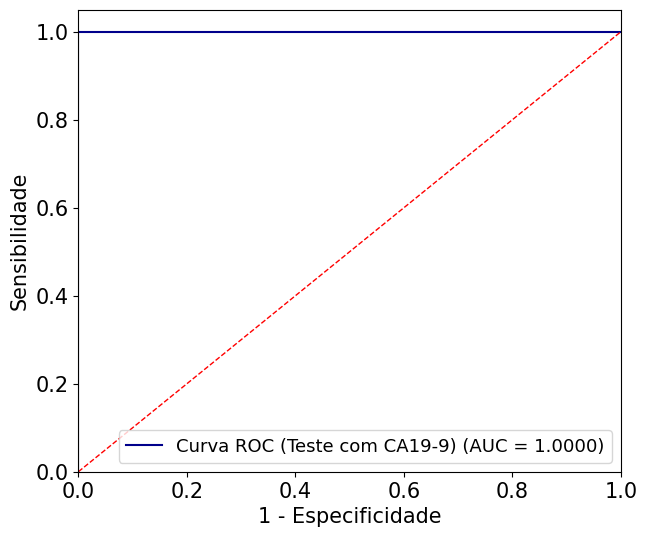

                    
                    
                    
________________________________________
Modelo: <class '__main__.ART_Minkowski_AE_Classifier'> - Conjunto de dados SEM GD:
Tempo de execução Busca em grade: 1001.09 segundos
Best parameters found: {'beta': 0.1, 'rho': 1e-05}
Best AUC ROC: 0.9870967741935484
Tempo de Treinamento: 0.4605 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


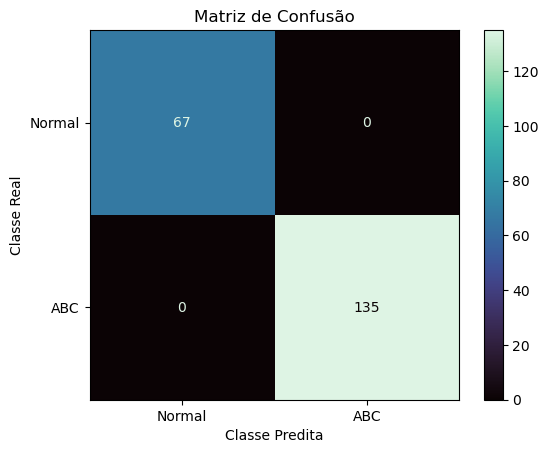

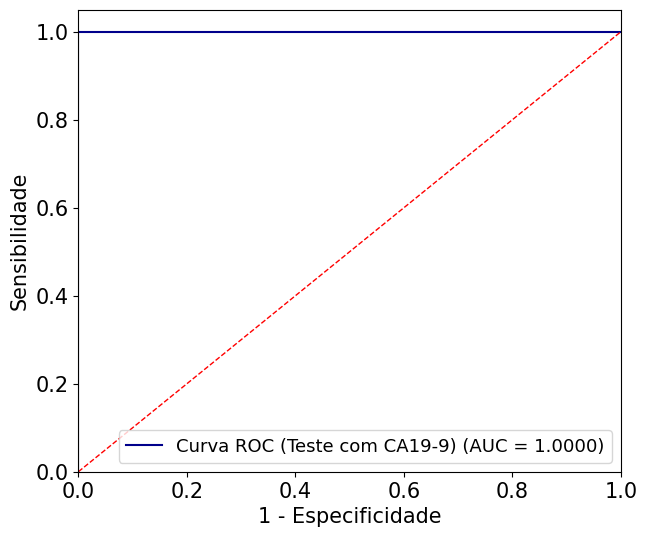

In [ ]:
# Abra um arquivo para redirecionar a saída
# output_file = open("AB.txt", "w")

# Redefina stdout
# sys.stdout = output_file

modelos = [ART_Minkowski_AE_Classifier]
param_grid_art_eu = {
    'beta': np.arange(0.1, 0.5, 0.01),
    'rho': np.arange(0.00001, 0.1, 0.00005)
}
param_grids = [param_grid_art_eu]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_cenarios_fases(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names)

# Feche o arquivo
# output_file.close()

# Teste Modelos RF, KNN, SVM, GB, MLP, DT, NB - **AUTOENCODER**

### RF

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset 2PV:



Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

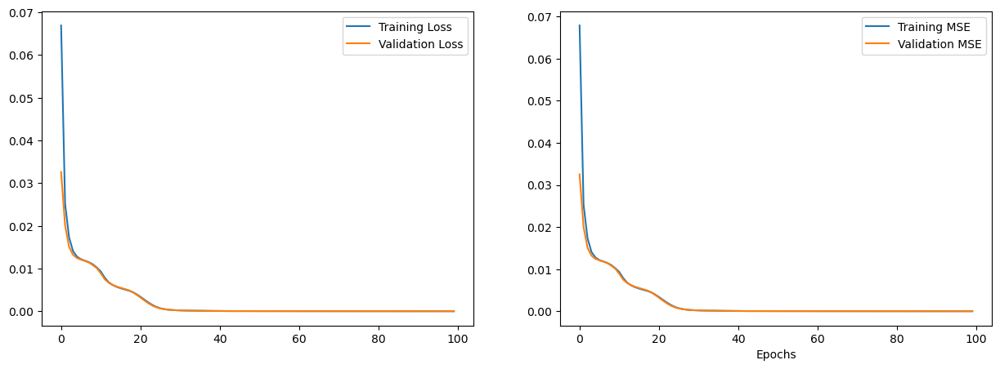

Tempo de execução Busca em grade: 44.36 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


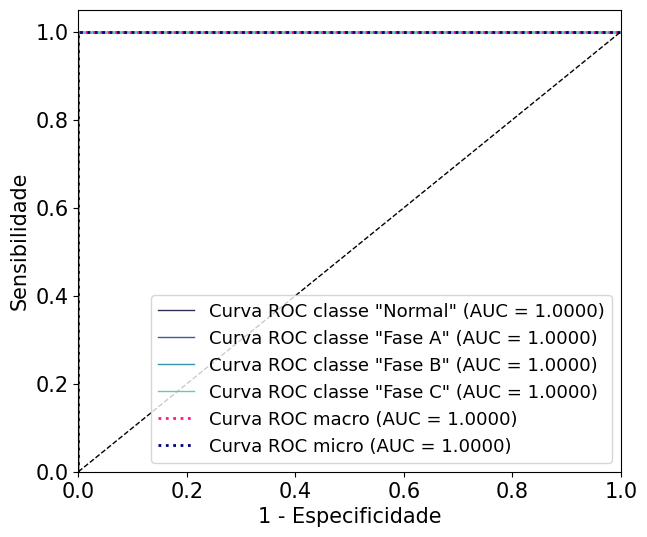

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

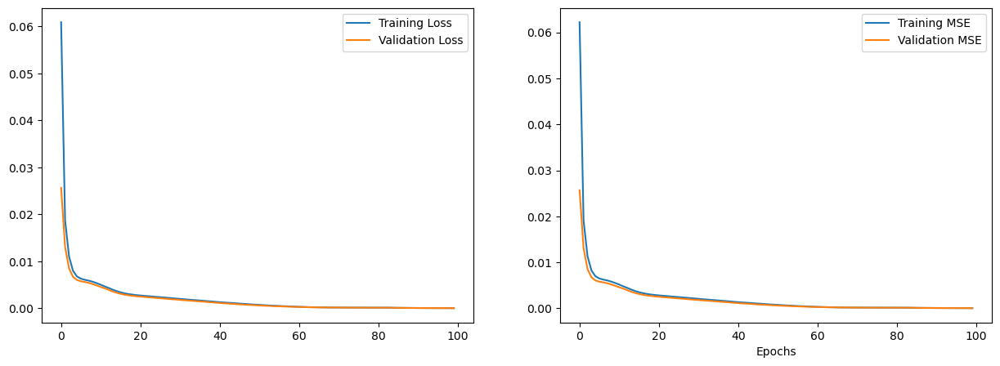

Tempo de execução Busca em grade: 51.18 segundos
Best parameters found: {'n_estimators': 30, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.999544203087062
Tempo de Treinamento: 0.0411 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 98.87640449%
Sensitivity (Recall) Macro:0.9889
Sensitivity (Recall) Micro: 0.9888
Especificidade (specificity) macro: 0.9963
Especificidade (specificity) micro: 0.9963
AUC: 0.9996
Matriz de Confusão
[[65  0  0  0]
 [ 2 66  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9851, F-score = 0.9925
Class 1: Sensitivity = 0.9706, Specificity = 1.0000, F-score = 0.9851
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9925


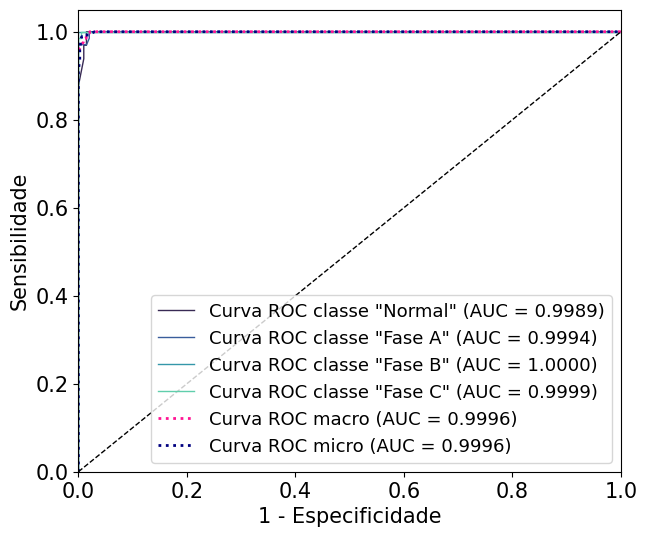

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

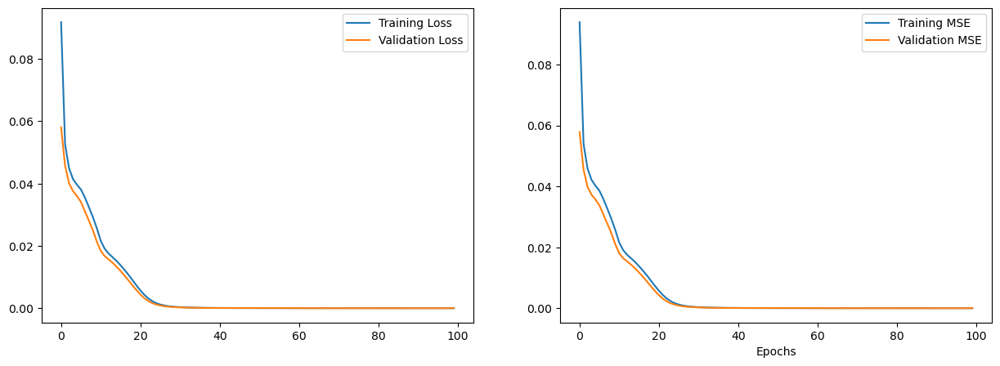

Tempo de execução Busca em grade: 53.61 segundos
Best parameters found: {'n_estimators': 150, 'max_depth': 5, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9966306843637993
Tempo de Treinamento: 0.1690 segundos
Tempo de Previsão: 0.0120 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro:0.9745
Sensitivity (Recall) Micro: 0.9738
Especificidade (specificity) macro: 0.9913
Especificidade (specificity) micro: 0.9913
AUC: 0.9980
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 65  2]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9420, Specificity = 1.0000, F-score = 0.9701
Class 3: Sensitivity = 0.9559, Specificity = 0.9899, F-score = 0.9726
Macro F-score: 0.9826


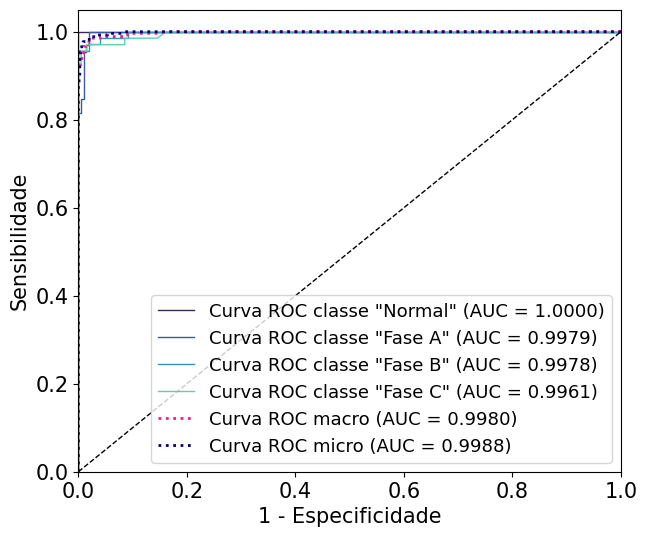

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

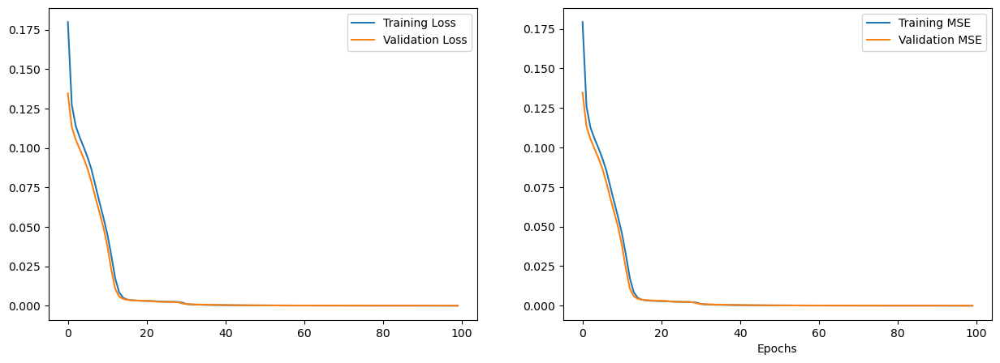

Tempo de execução Busca em grade: 50.50 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0040 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


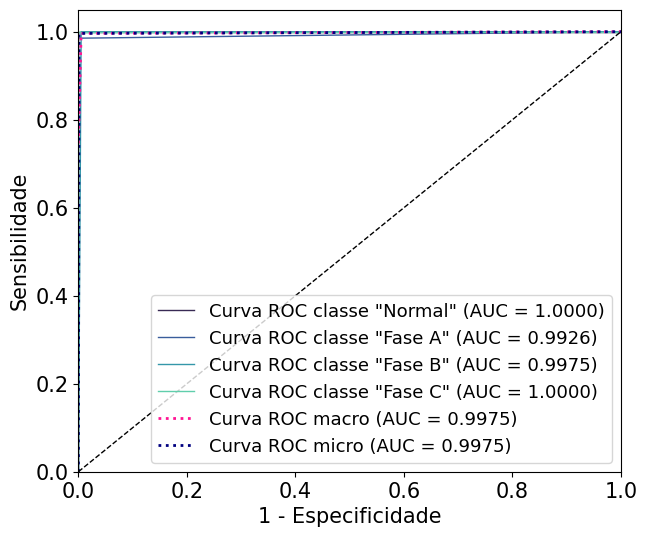

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

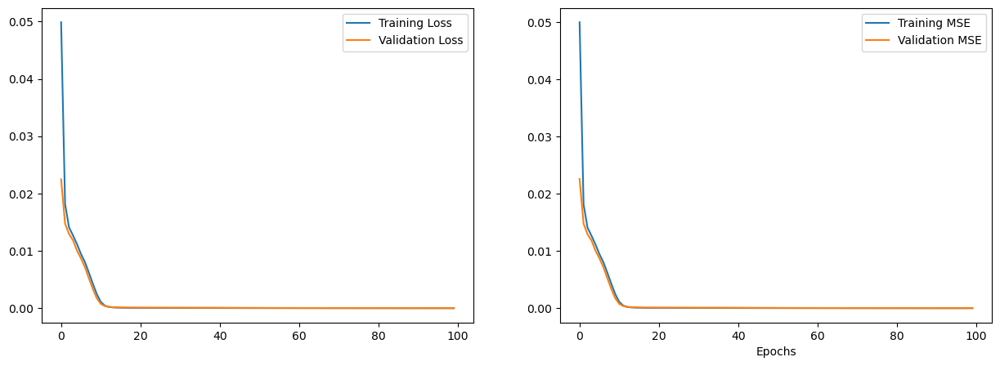

Tempo de execução Busca em grade: 55.80 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0128 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


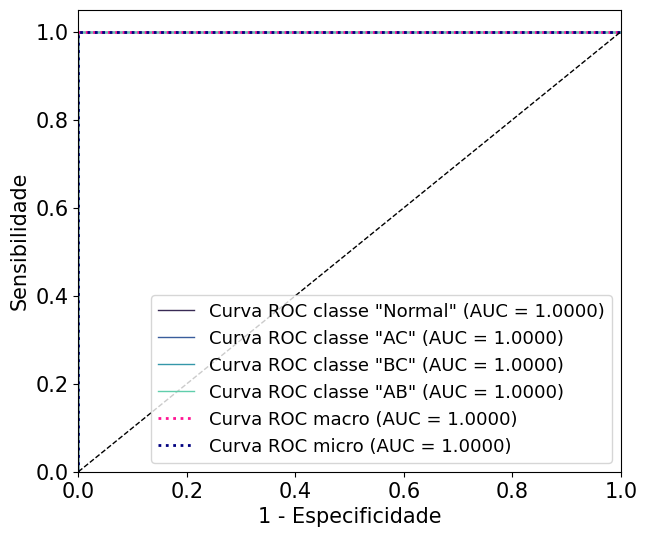

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

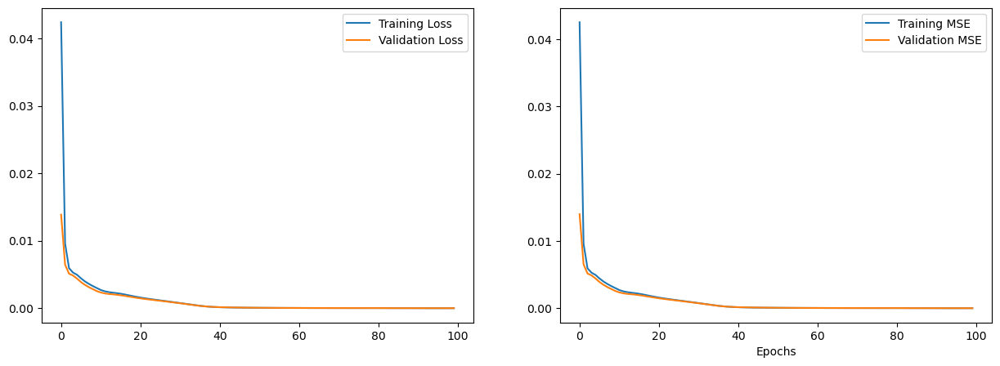

Tempo de execução Busca em grade: 59.44 segundos
Best parameters found: {'n_estimators': 40, 'max_depth': 6, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0600 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


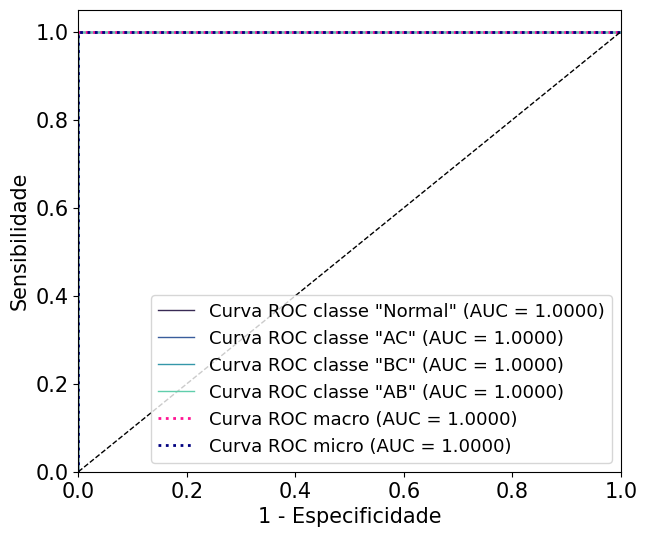

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

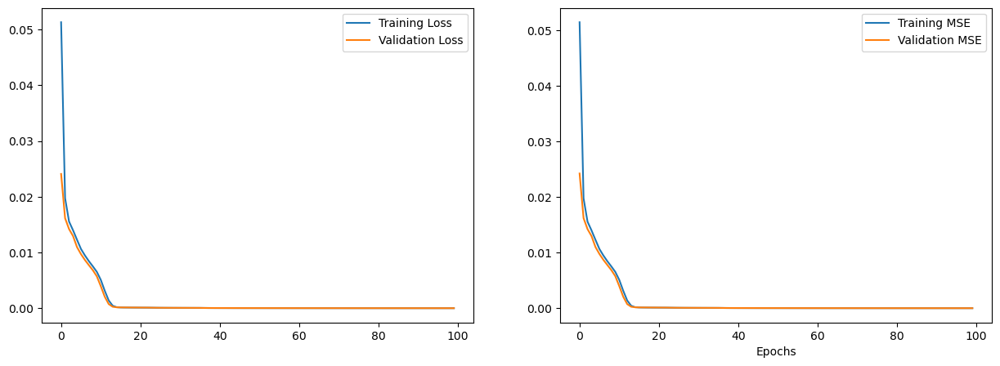

Tempo de execução Busca em grade: 53.97 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0120 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


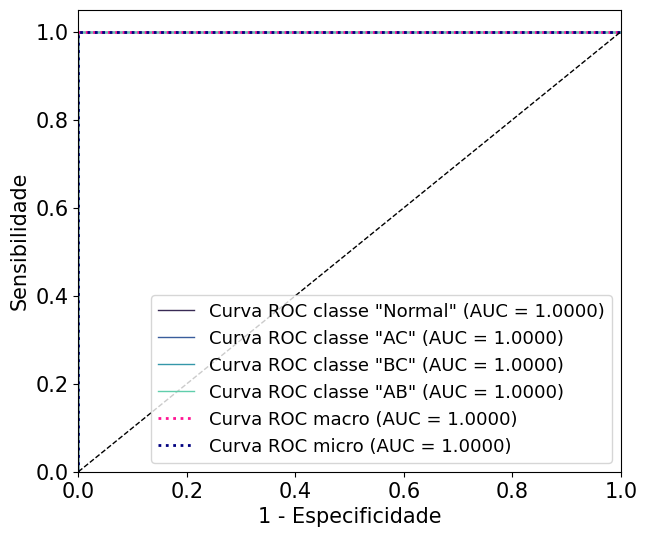

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

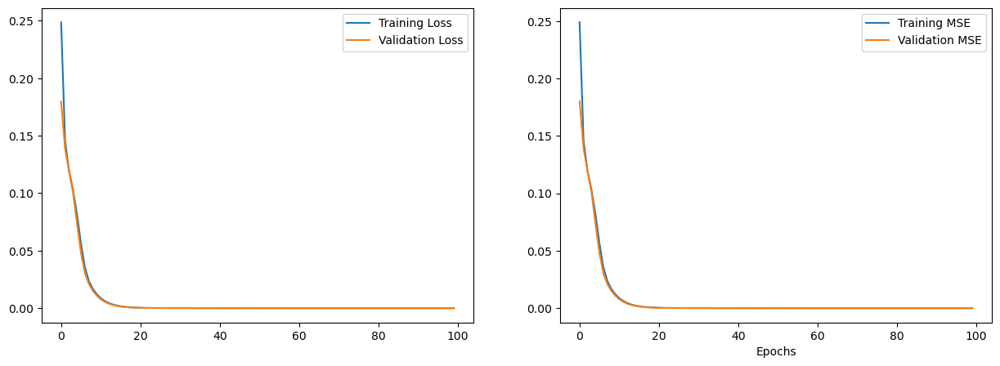

Tempo de execução Busca em grade: 51.96 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0070 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


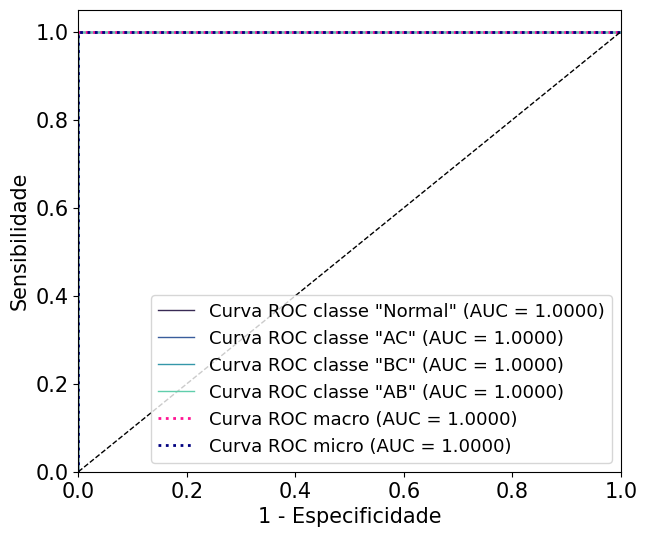

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

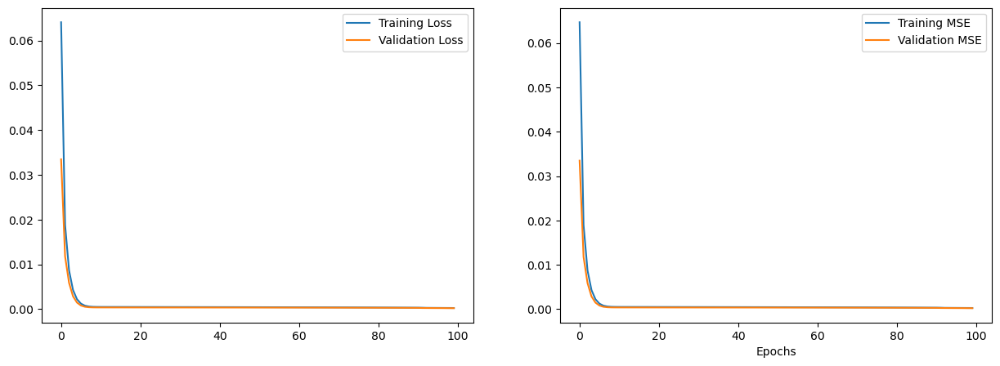

Tempo de execução Busca em grade: 44.53 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': 3, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0052 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


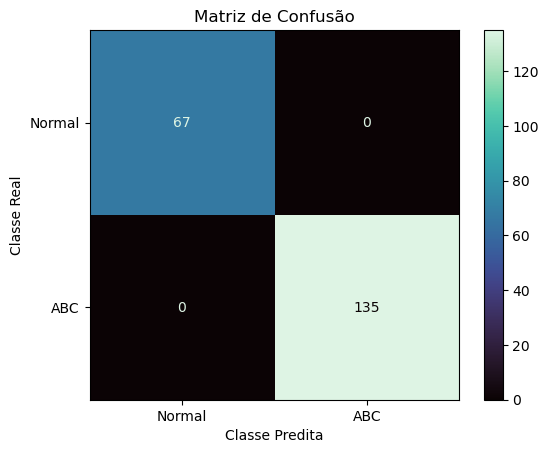

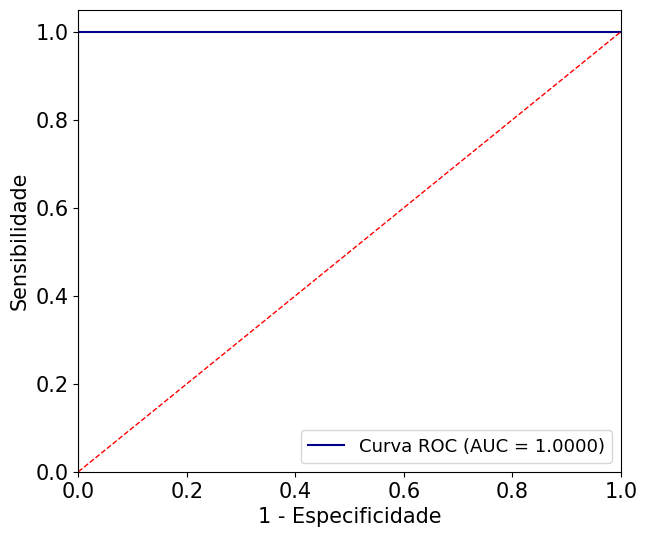

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

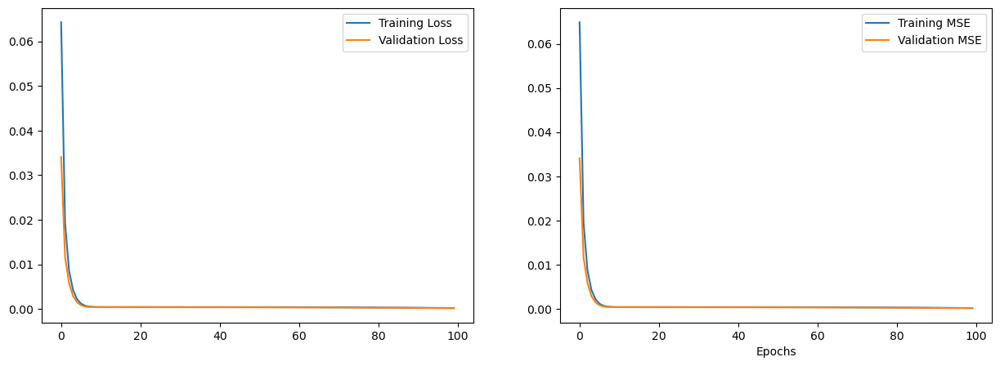

Tempo de execução Busca em grade: 46.13 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': 3, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.995289298515105
Tempo de Treinamento: 0.0070 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.9852
Precisão = 1.0000
Sensibilidade = 0.9778
Especificidade = 1.0000
F-score = 0.9888
Coeficiente de Correlação de Matthews = 0.9677
AUC = 1.0000
############################################################


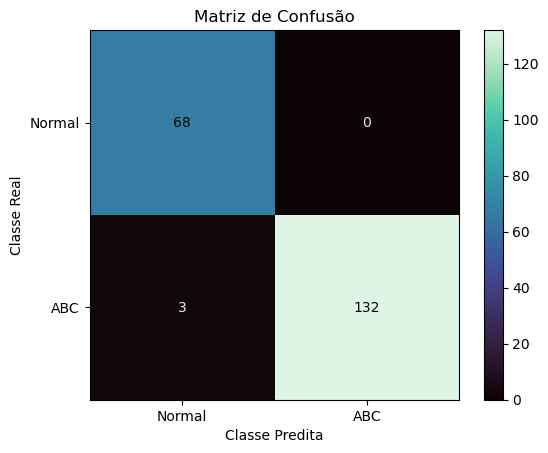

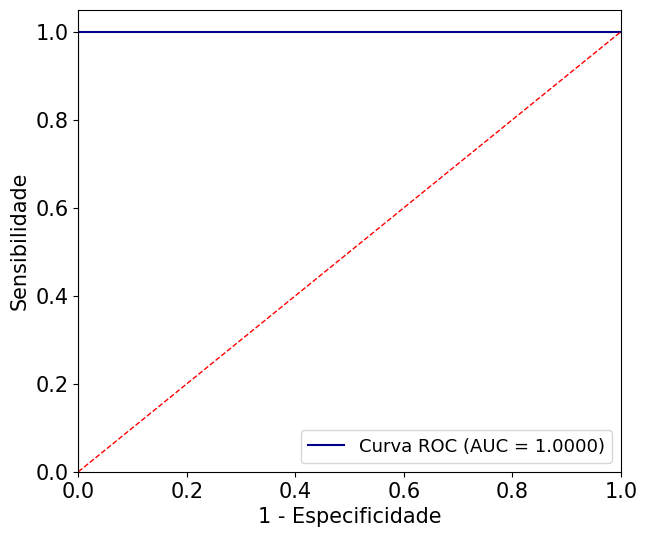

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

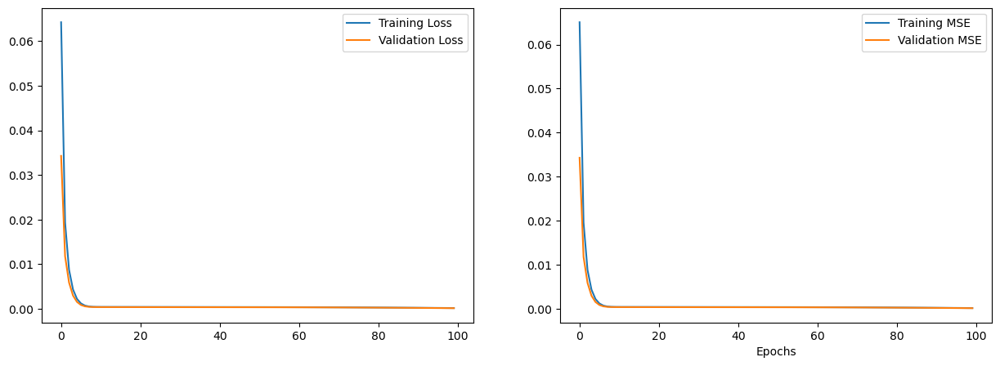

Tempo de execução Busca em grade: 43.25 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


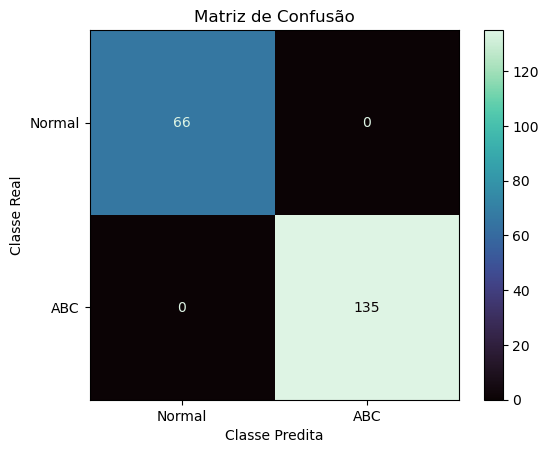

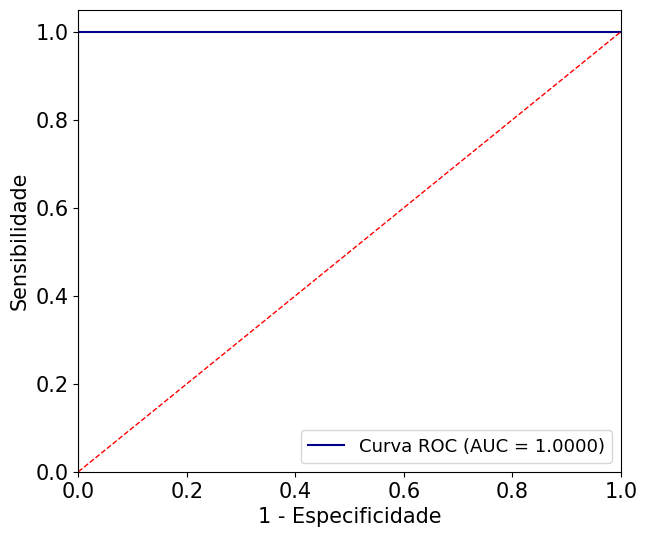

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._forest.RandomForestClassifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

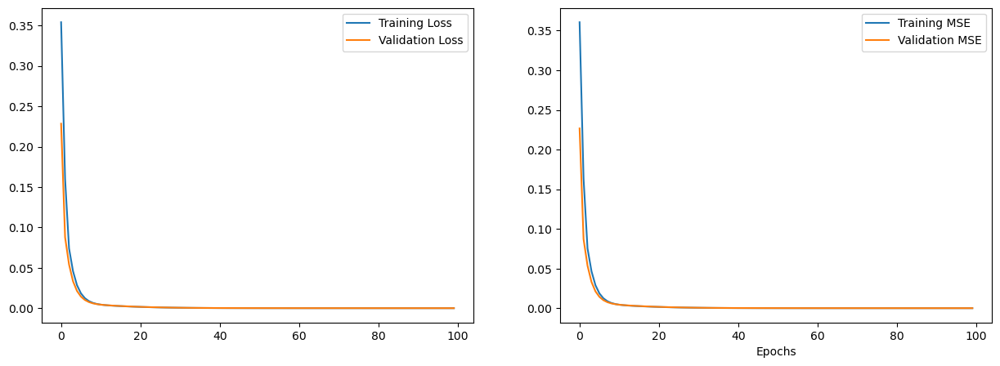

Tempo de execução Busca em grade: 41.07 segundos
Best parameters found: {'n_estimators': 5, 'max_depth': None, 'criterion': 'gini', 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


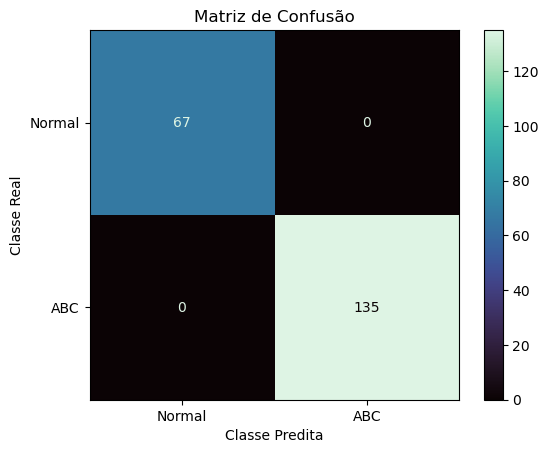

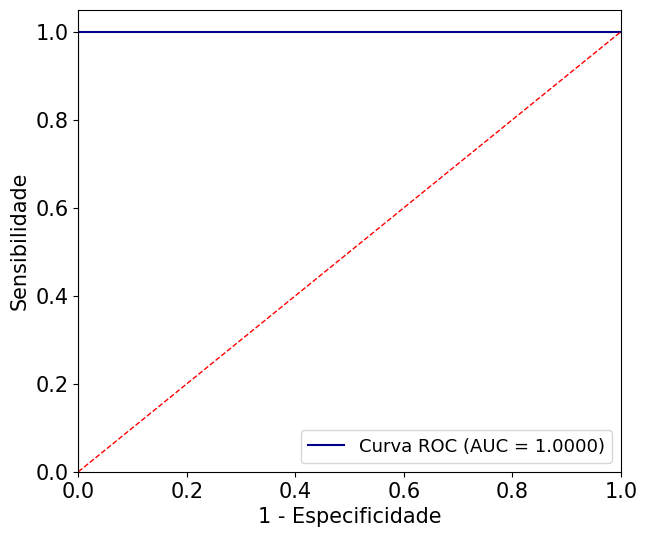

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9995907865877313
ROC AUC média (micro) de todas as iterações: 0.9996578870668843
Acurácia média de todas as iterações: 0.9953352644170156
Recall médio (macro) de todas as iterações: 0.9947912381117997
Recall médio (micro) de todas as iterações: 0.9947149396587598
Especificidade média (macro) de todas as iterações: 0.9988613705905767
Especificidade média (micro) de todas as iterações: 0.9988555971702039
 
############################################################
Tempo de execução Total: 688.7378 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [RandomForestClassifier]
param_grid_rf = {
    'n_estimators': [5, 10, 15, 20, 25, 30, 35, 40, 50, 100, 150, 200],
    'max_depth': [None, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 30, 40],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_features': ['sqrt', 'log2', None],
    'random_state': [42]
}

param_grids = [param_grid_rf]
file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### KNN


Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

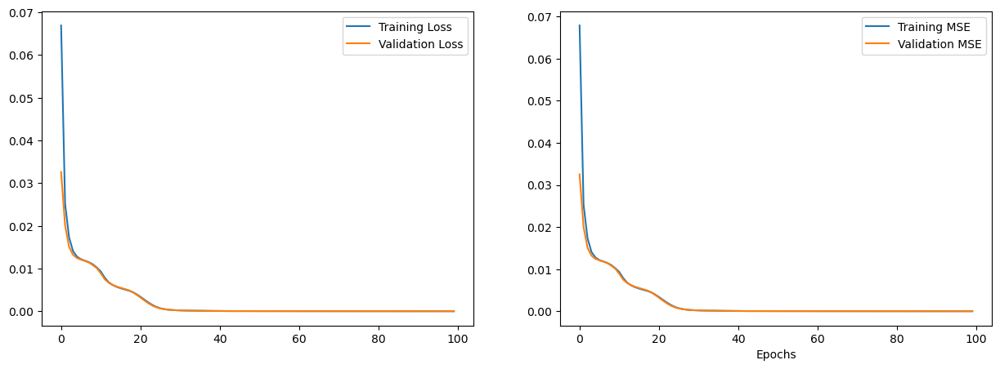

Tempo de execução Busca em grade: 3.79 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


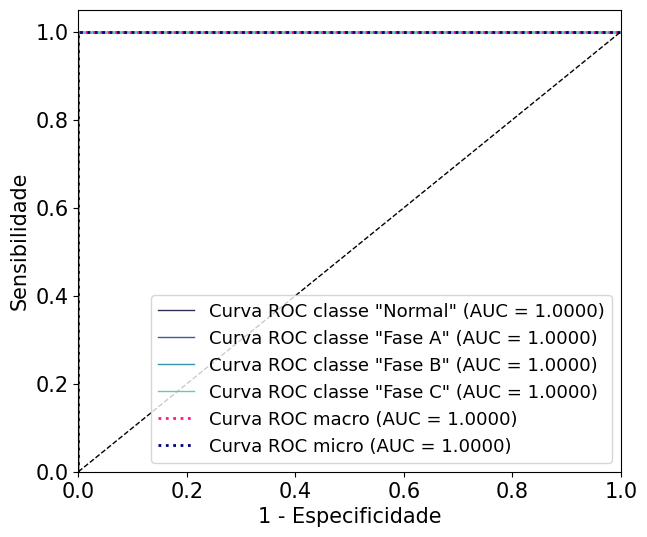

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

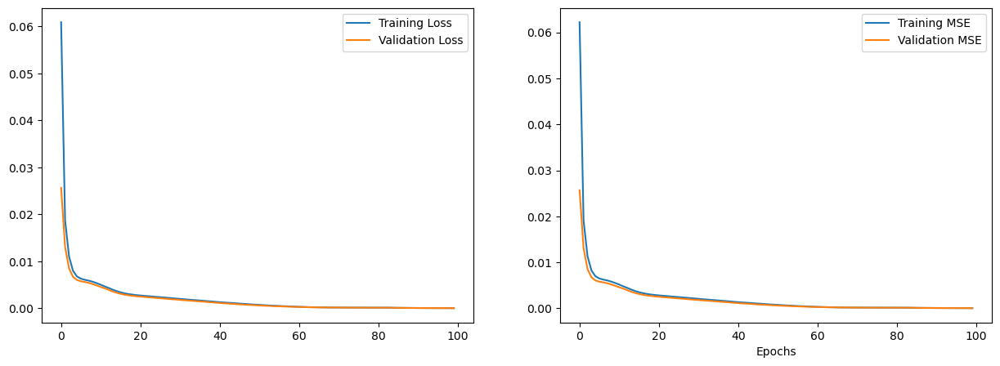

Tempo de execução Busca em grade: 2.13 segundos
Best parameters found: {'n_neighbors': 7, 'weights': 'distance', 'algorithm': 'auto', 'p': 2}
Best AUC ROC: 0.9996836339461208
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 98.50187266%
Sensitivity (Recall) Macro:0.9852
Sensitivity (Recall) Micro: 0.9850
Especificidade (specificity) macro: 0.9950
Especificidade (specificity) micro: 0.9950
AUC: 0.9999
Matriz de Confusão
[[65  0  0  0]
 [ 3 65  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9802, F-score = 0.9900
Class 1: Sensitivity = 0.9559, Specificity = 1.0000, F-score = 0.9774
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9900


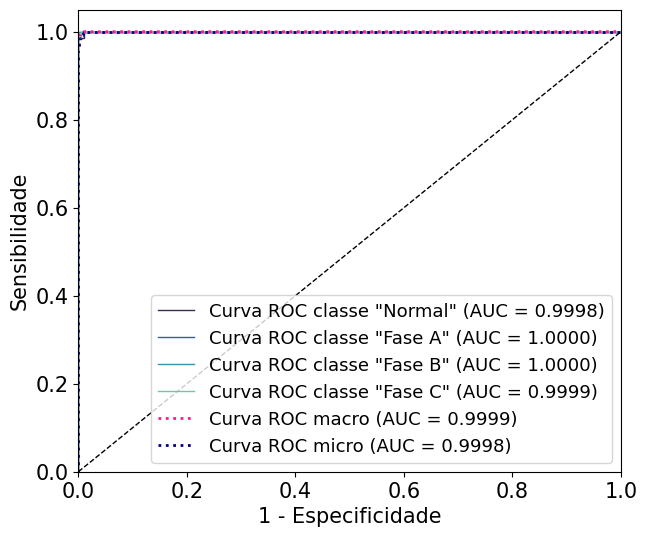

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

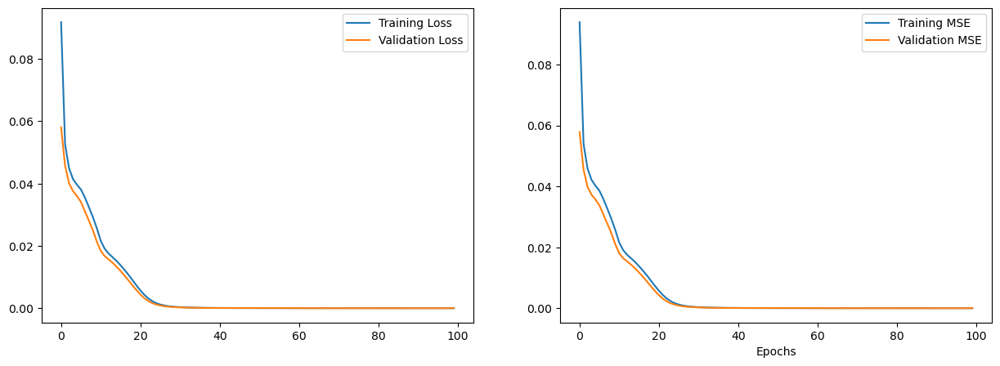

Tempo de execução Busca em grade: 1.85 segundos
Best parameters found: {'n_neighbors': 11, 'weights': 'uniform', 'algorithm': 'auto', 'p': 8}
Best AUC ROC: 0.9961366102430554
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0140 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9948
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


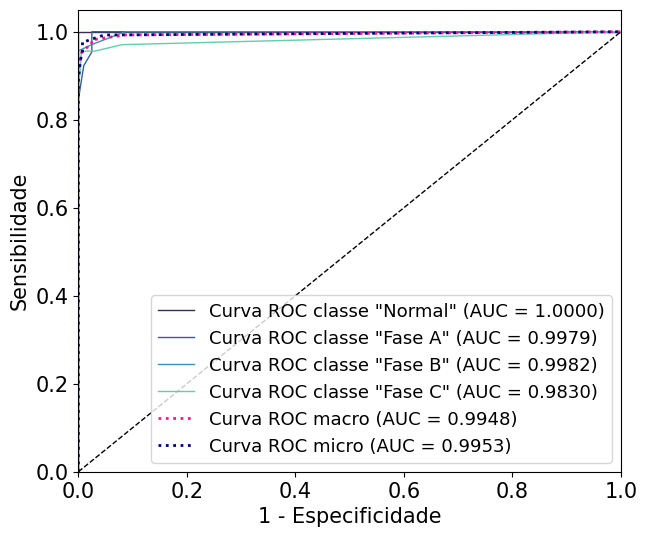

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

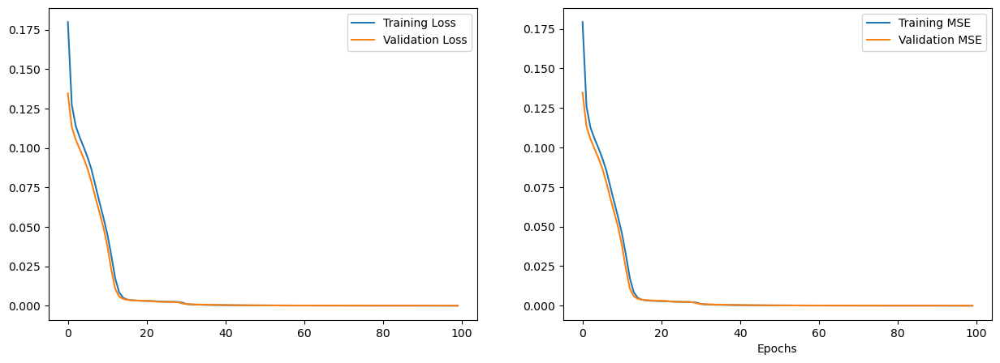

Tempo de execução Busca em grade: 1.86 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0130 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


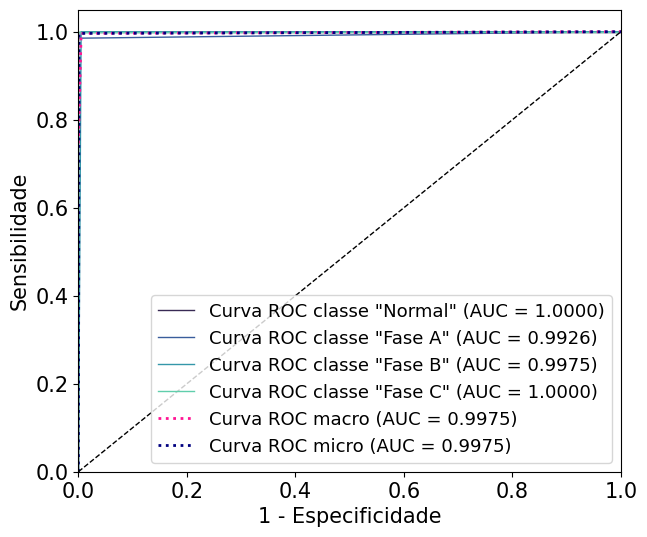

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

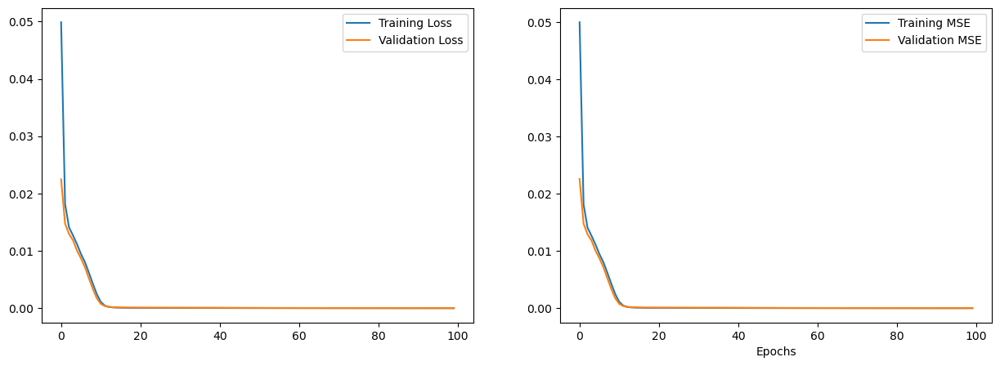

Tempo de execução Busca em grade: 2.68 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0090 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


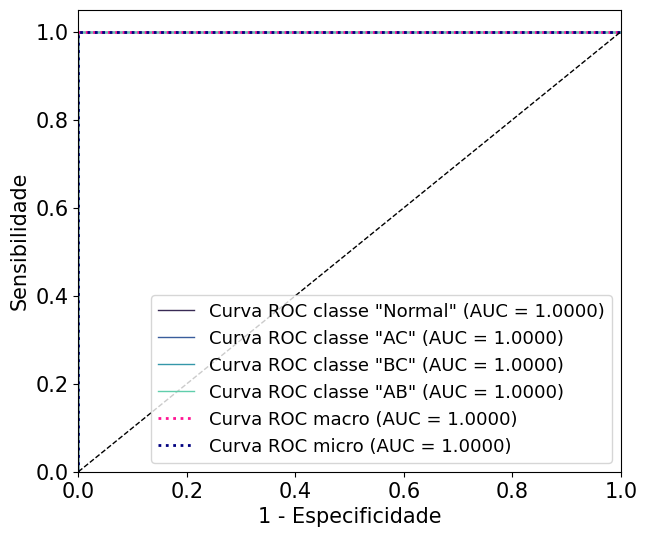

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

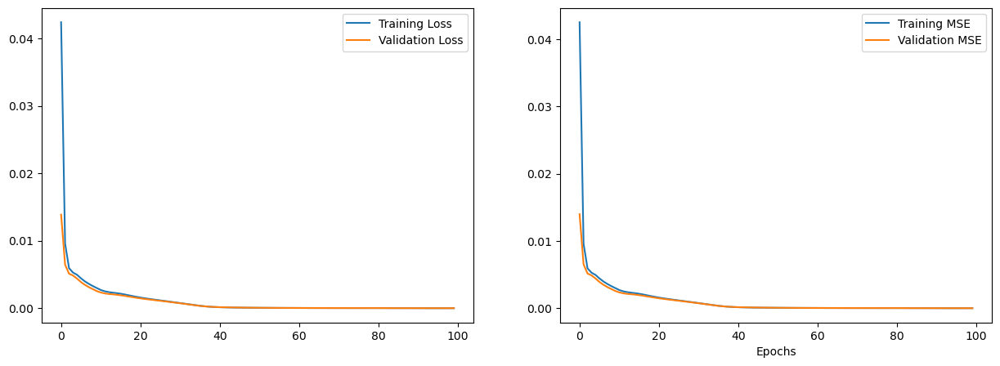

Tempo de execução Busca em grade: 2.62 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0270 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


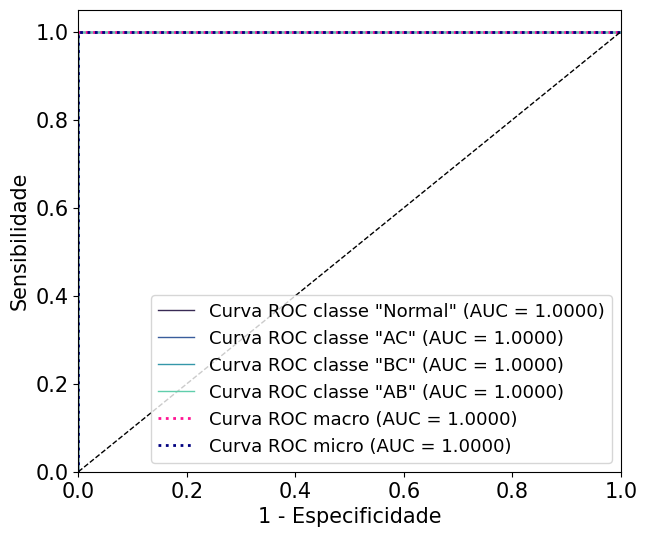

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

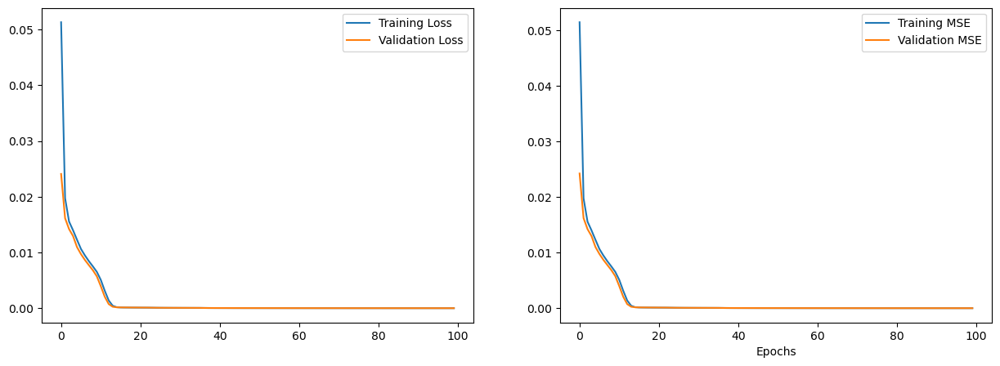

Tempo de execução Busca em grade: 2.71 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0021 segundos
Tempo de Previsão: 0.0099 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


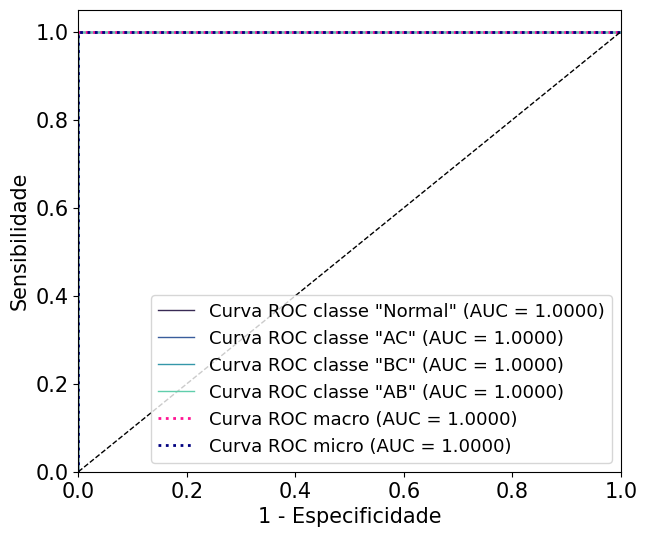

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

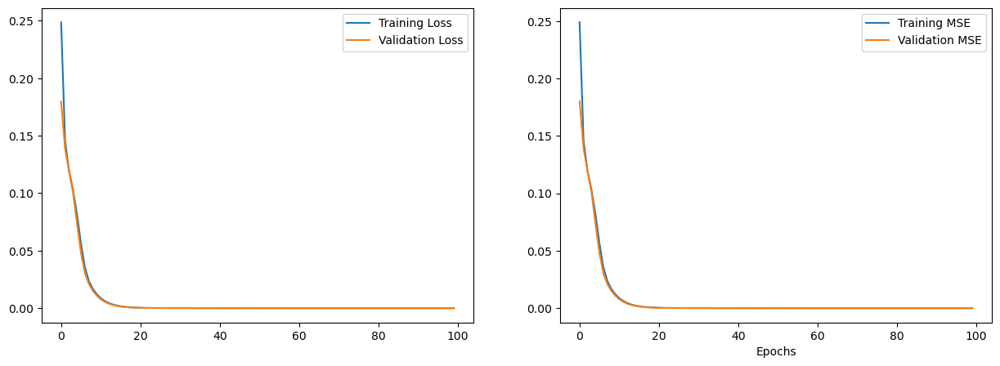

Tempo de execução Busca em grade: 2.75 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0008 segundos
Tempo de Previsão: 0.0091 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


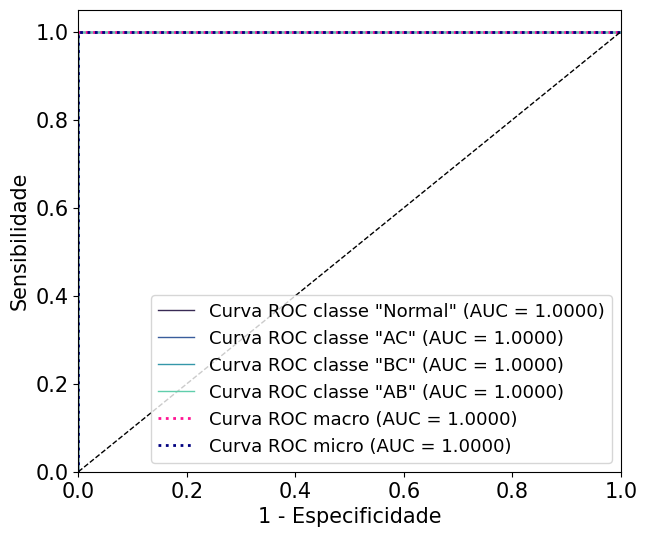

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

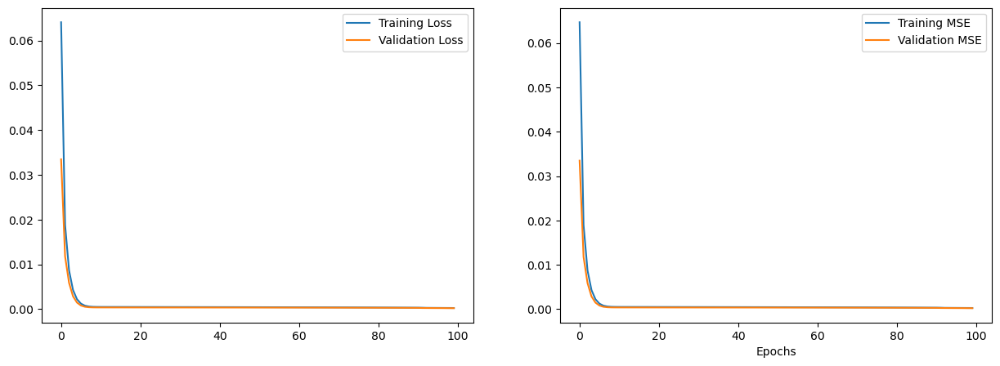

Tempo de execução Busca em grade: 1.42 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0060 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


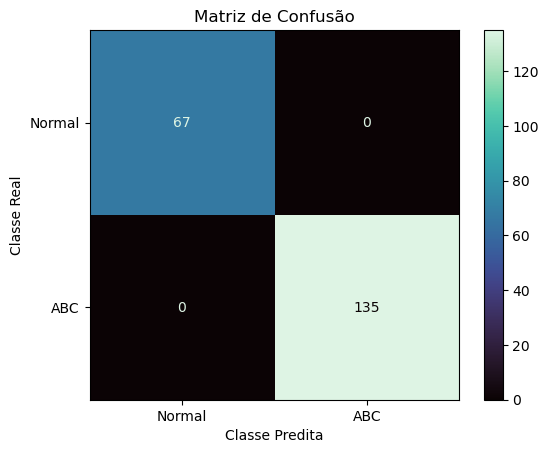

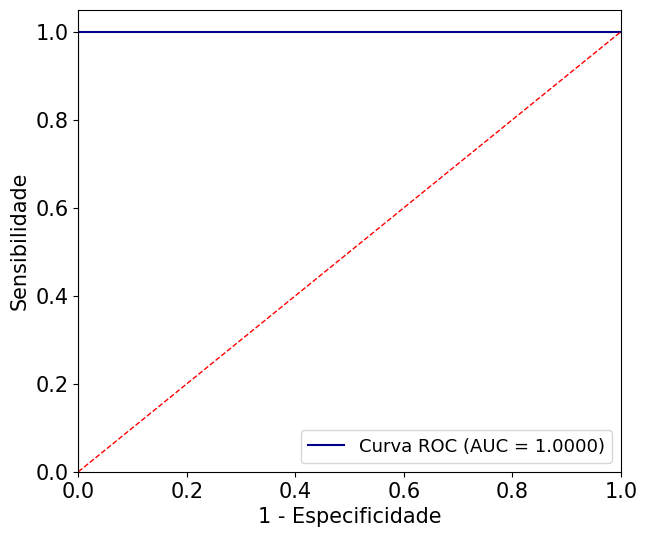

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

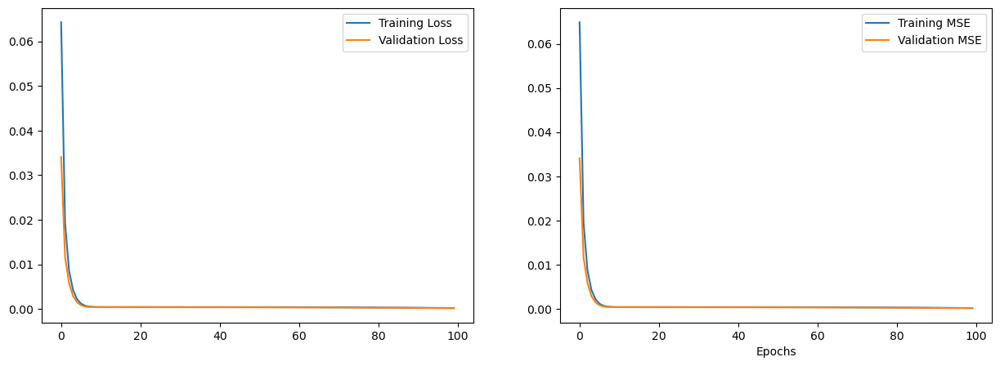

Tempo de execução Busca em grade: 1.41 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 8}
Best AUC ROC: 0.9934955837173579
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0060 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


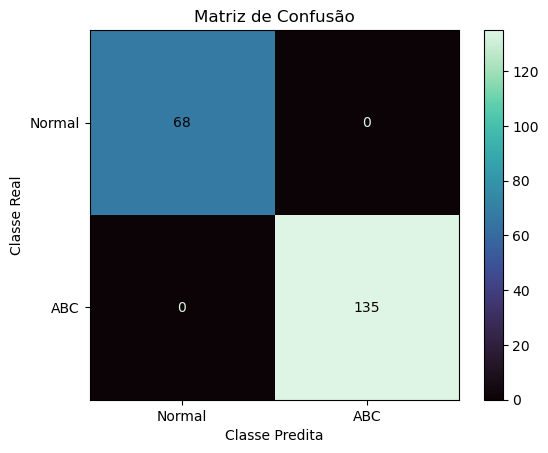

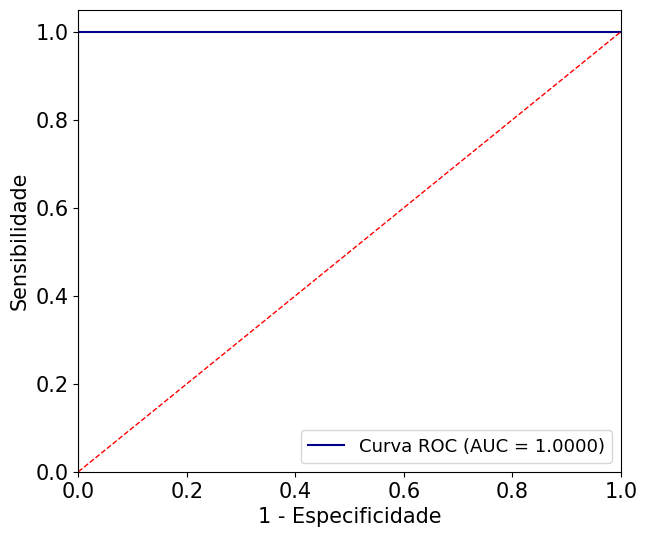

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

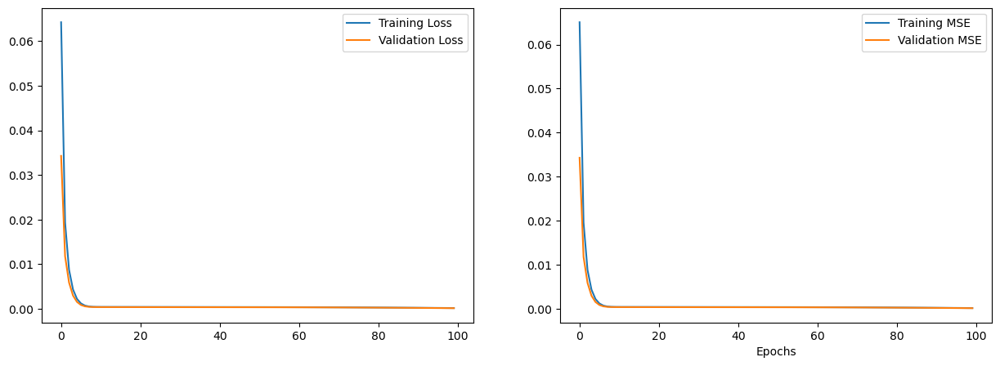

Tempo de execução Busca em grade: 1.43 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0070 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


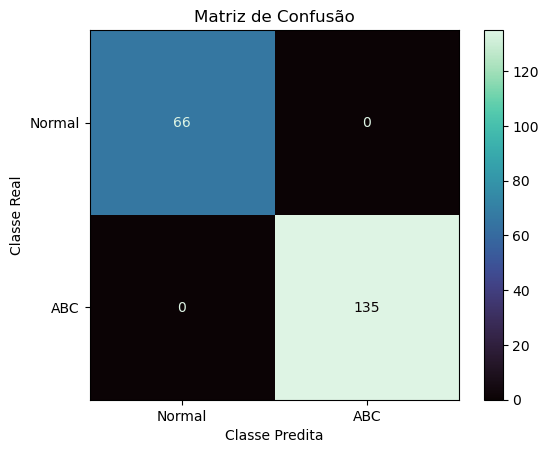

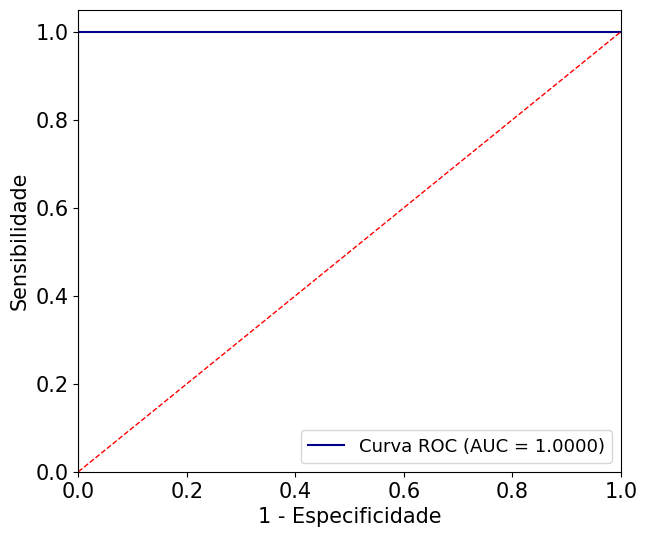

 
 
 
________________________________________
Model: <class 'sklearn.neighbors._classification.KNeighborsClassifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

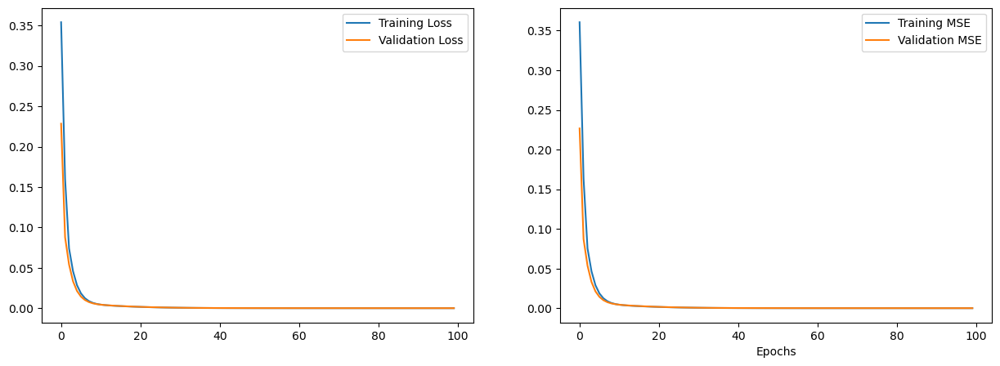

Tempo de execução Busca em grade: 1.40 segundos
Best parameters found: {'n_neighbors': 3, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0150 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


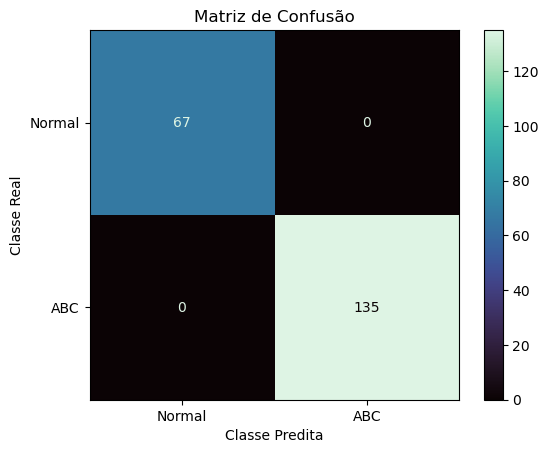

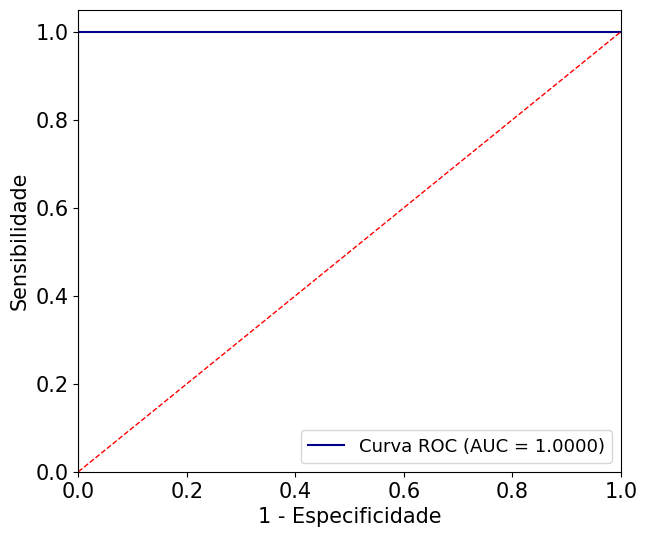

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9993567987687073
ROC AUC média (micro) de todas as iterações: 0.9993825991543032
Acurácia média de todas as iterações: 0.9965667915106117
Recall médio (macro) de todas as iterações: 0.9966386497817816
Recall médio (micro) de todas as iterações: 0.9965667915106117
Especificidade média (macro) de todas as iterações: 0.9988629253942983
Especificidade média (micro) de todas as iterações: 0.9988555971702039
 
############################################################
Tempo de execução Total: 117.9081 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [KNeighborsClassifier]
param_grid_knn = {
    'n_neighbors': [3, 5, 7, 9, 11, 13, 15],
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'p': [1, 2, 4, 8, 16, 32, 64]
}

param_grids = [param_grid_knn]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### SVC

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

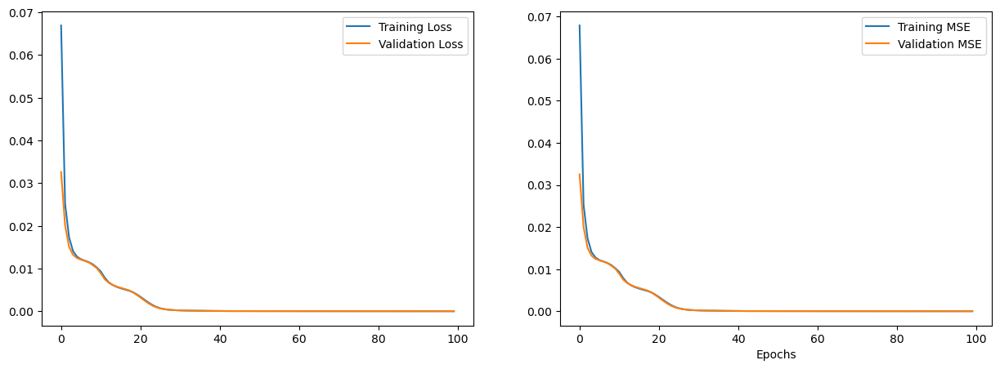

Tempo de execução Busca em grade: 1.09 segundos
Best parameters found: {'C': 0.1, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0169 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9975


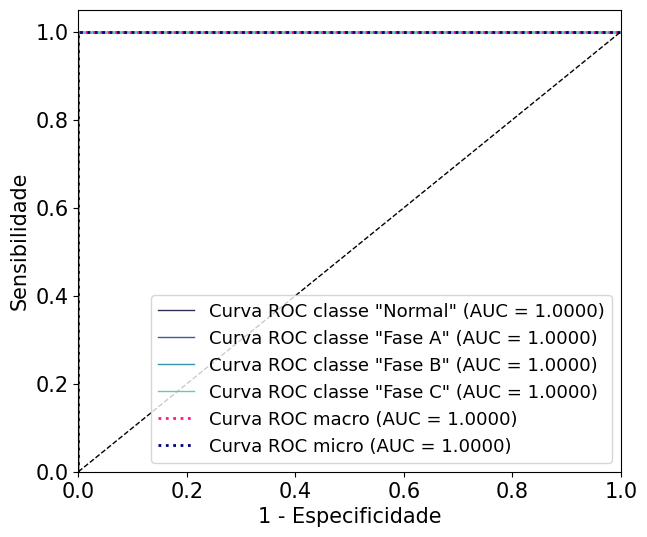

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

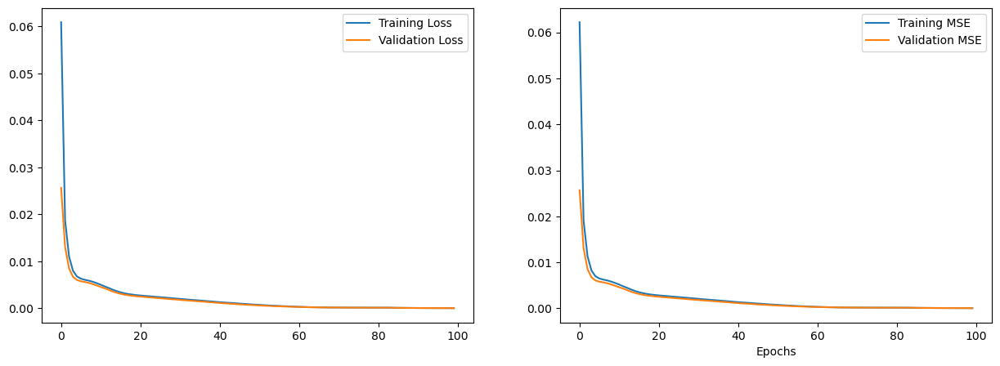

Tempo de execução Busca em grade: 1.15 segundos
Best parameters found: {'C': 0.7, 'kernel': 'rbf', 'gamma': 'auto', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9877256402474275
Tempo de Treinamento: 0.0714 segundos
Tempo de Previsão: 0.0140 segundos
Acurácia: 80.14981273%
Sensitivity (Recall) Macro:0.8022
Sensitivity (Recall) Micro: 0.8015
Especificidade (specificity) macro: 0.9343
Especificidade (specificity) micro: 0.9338
AUC: 0.9734
Matriz de Confusão
[[58  7  0  0]
 [14 54  0  0]
 [20  0 47  0]
 [12  0  0 55]]
Class 0: Sensitivity = 0.8923, Specificity = 0.7723, F-score = 0.8280
Class 1: Sensitivity = 0.7941, Specificity = 0.9648, F-score = 0.8712
Class 2: Sensitivity = 0.7015, Specificity = 1.0000, F-score = 0.8246
Class 3: Sensitivity = 0.8209, Specificity = 1.0000, F-score = 0.9016
Macro F-score: 0.8563


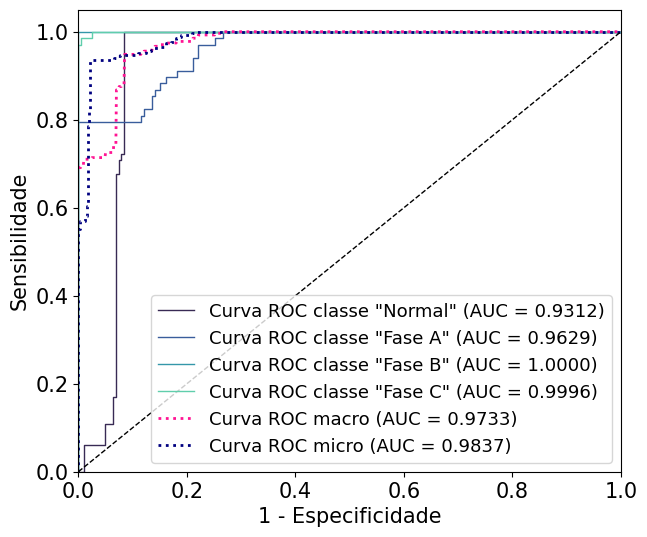

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

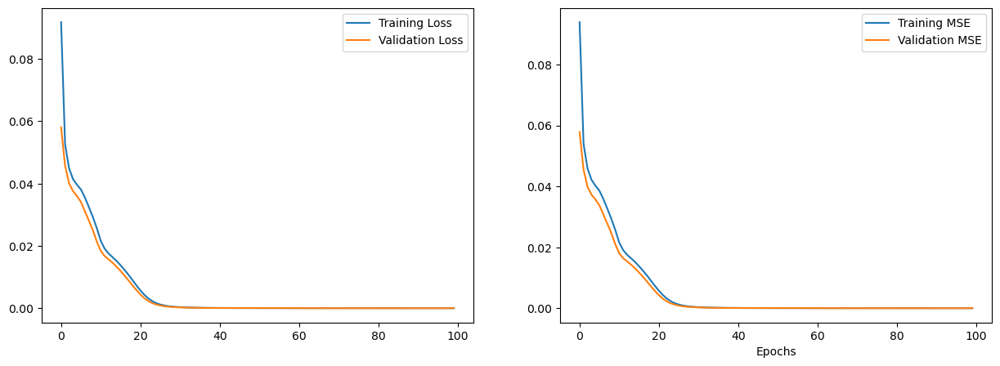

Tempo de execução Busca em grade: 0.91 segundos
Best parameters found: {'C': 0.2, 'kernel': 'sigmoid', 'gamma': 'auto', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.990360628080197
Tempo de Treinamento: 0.0450 segundos
Tempo de Previsão: 0.0030 segundos
Acurácia: 75.65543071%
Sensitivity (Recall) Macro:0.7572
Sensitivity (Recall) Micro: 0.7566
Especificidade (specificity) macro: 0.9195
Especificidade (specificity) micro: 0.9189
AUC: 0.9852
Matriz de Confusão
[[65  0  0  0]
 [29 36  0  0]
 [20  0 48  1]
 [15  0  0 53]]
Class 0: Sensitivity = 1.0000, Specificity = 0.6832, F-score = 0.8118
Class 1: Sensitivity = 0.5538, Specificity = 1.0000, F-score = 0.7129
Class 2: Sensitivity = 0.6957, Specificity = 1.0000, F-score = 0.8205
Class 3: Sensitivity = 0.7794, Specificity = 0.9950, F-score = 0.8741
Macro F-score: 0.8048


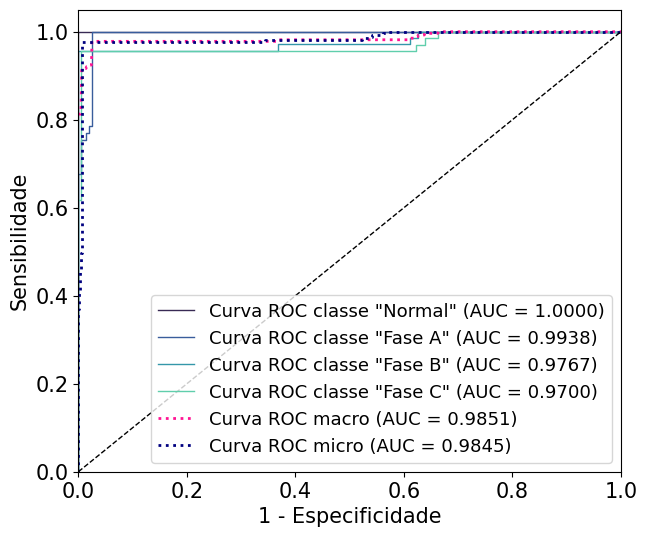

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

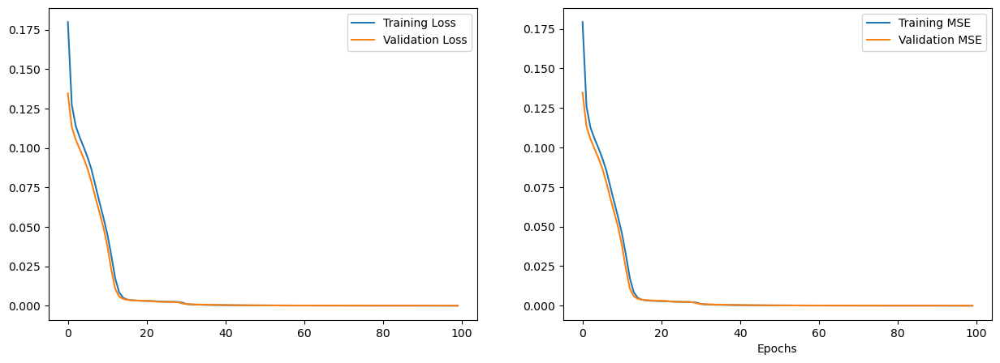

Tempo de execução Busca em grade: 0.56 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0170 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9954
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


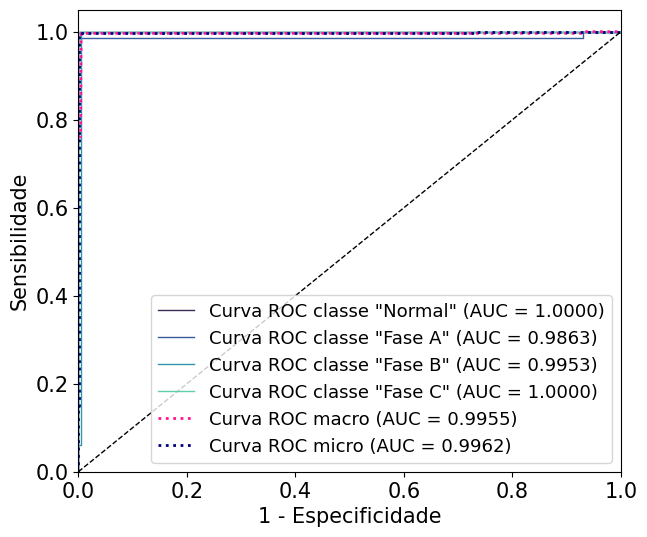

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

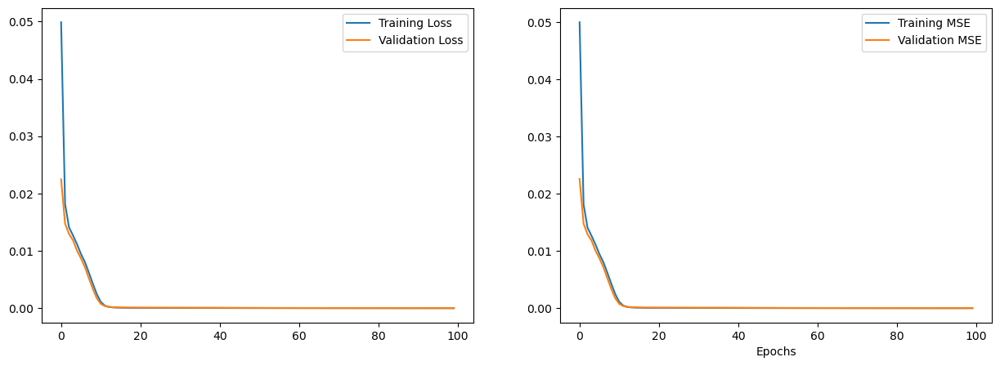

Tempo de execução Busca em grade: 2.69 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1153 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 86.11111111%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8611
Especificidade (specificity) macro: 0.9513
Especificidade (specificity) micro: 0.9537
AUC: 1.0000
Matriz de Confusão
[[  0  30   0  35]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9102, F-score = 0.9530
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.8949, F-score = 0.9445
Macro F-score: 0.7244


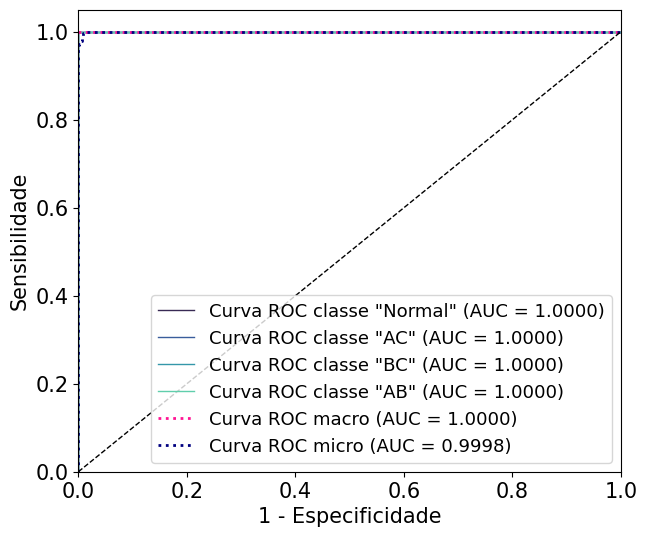

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

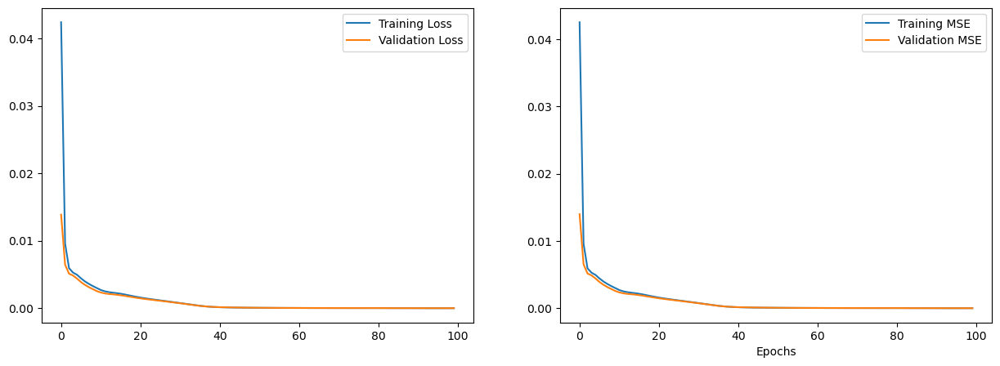

Tempo de execução Busca em grade: 2.50 segundos
Best parameters found: {'C': 0.8, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9999741138988452
Tempo de Treinamento: 0.0230 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 98.29059829%
Sensitivity (Recall) Macro:0.9851
Sensitivity (Recall) Micro: 0.9829
Especificidade (specificity) macro: 0.9943
Especificidade (specificity) micro: 0.9943
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  2   0 126   6]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 0.9403, Specificity = 1.0000, F-score = 0.9692
Class 3: Sensitivity = 1.0000, Specificity = 0.9820, F-score = 0.9909
Macro F-score: 0.9894


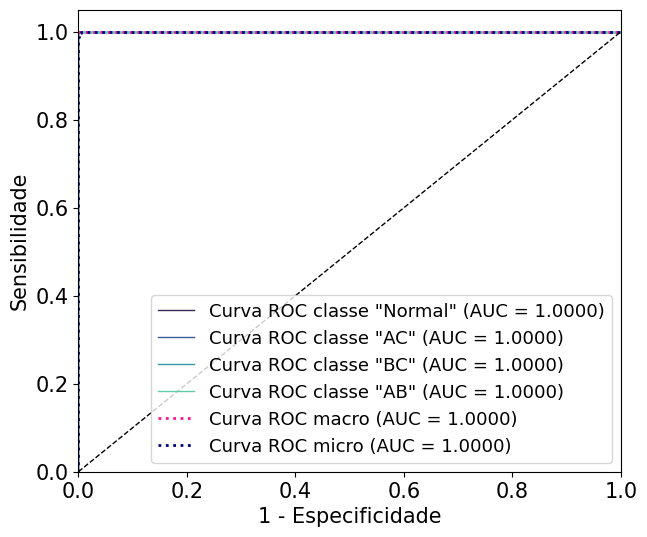

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

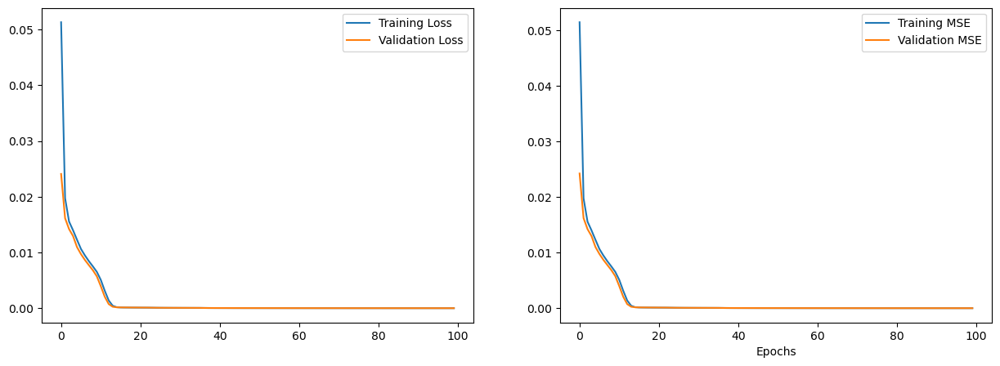

Tempo de execução Busca em grade: 2.35 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1081 segundos
Tempo de Previsão: 0.0050 segundos
Acurácia: 86.11111111%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8611
Especificidade (specificity) macro: 0.9513
Especificidade (specificity) micro: 0.9537
AUC: 1.0000
Matriz de Confusão
[[  0  10   0  55]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9700, F-score = 0.9848
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.8353, F-score = 0.9103
Macro F-score: 0.7238


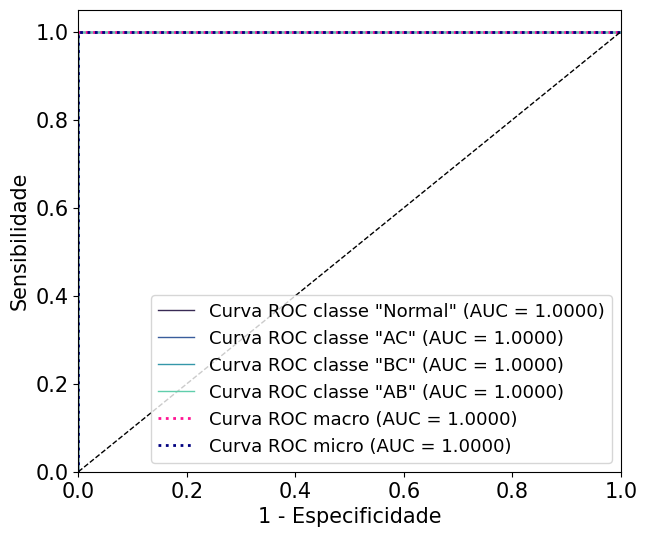

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

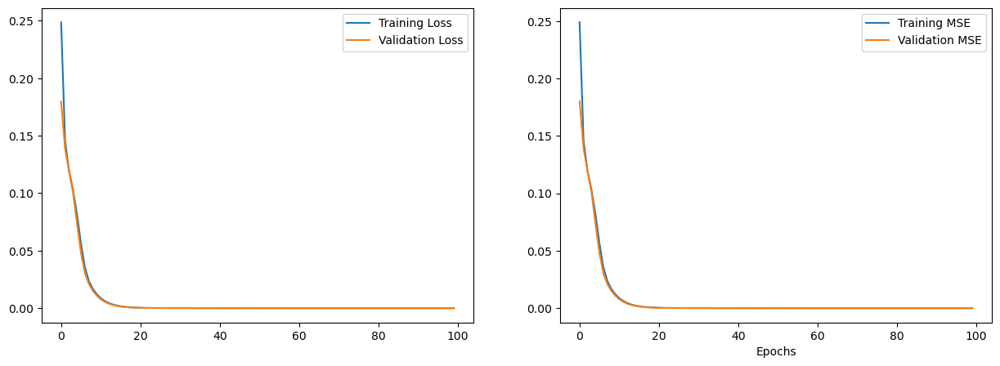

Tempo de execução Busca em grade: 1.30 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0539 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia: 84.68085106%
Sensitivity (Recall) Macro:0.8666
Sensitivity (Recall) Micro: 0.8468
Especificidade (specificity) macro: 0.9556
Especificidade (specificity) micro: 0.9489
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [ 23 113   0   0]
 [ 25   0 109   0]
 [ 24   0   0 111]]
Class 0: Sensitivity = 1.0000, Specificity = 0.8222, F-score = 0.9024
Class 1: Sensitivity = 0.8309, Specificity = 1.0000, F-score = 0.9076
Class 2: Sensitivity = 0.8134, Specificity = 1.0000, F-score = 0.8971
Class 3: Sensitivity = 0.8222, Specificity = 1.0000, F-score = 0.9024
Macro F-score: 0.9024


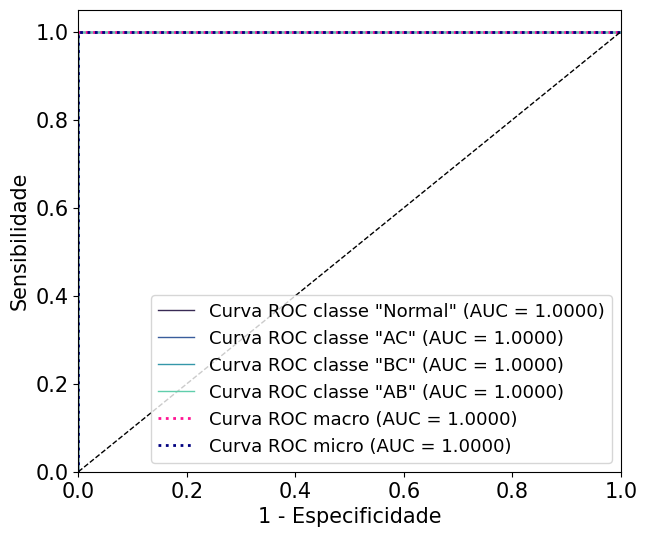

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

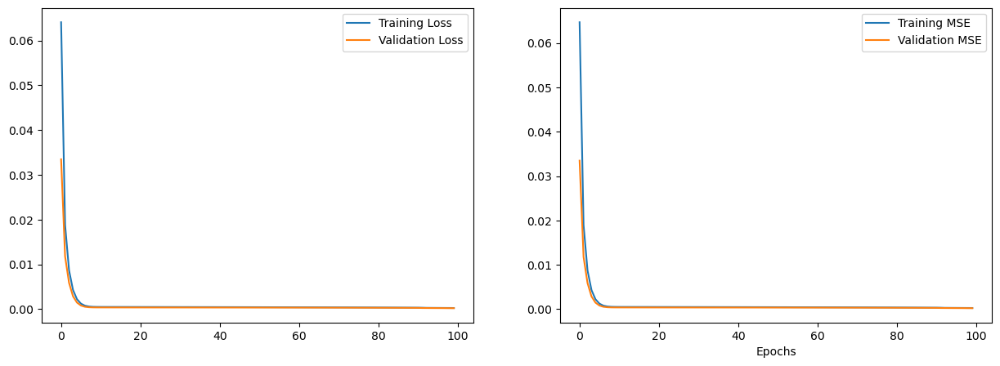

Tempo de execução Busca em grade: 0.45 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.8021665386584742
Tempo de Treinamento: 0.0170 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 0.6683
Precisão = 0.6683
Sensibilidade = 1.0000
Especificidade = 0.0000
F-score = 0.8012
Coeficiente de Correlação de Matthews = 0.0000
AUC = 0.8286
############################################################


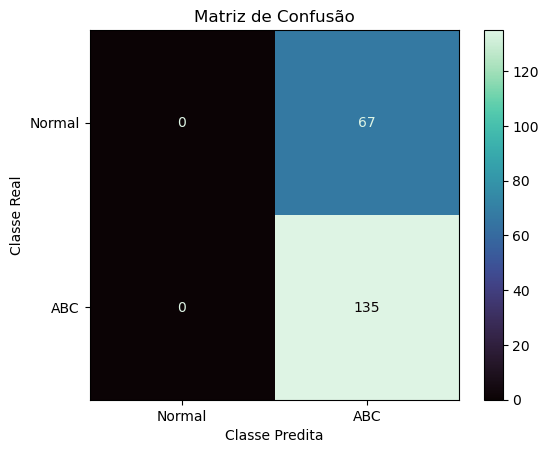

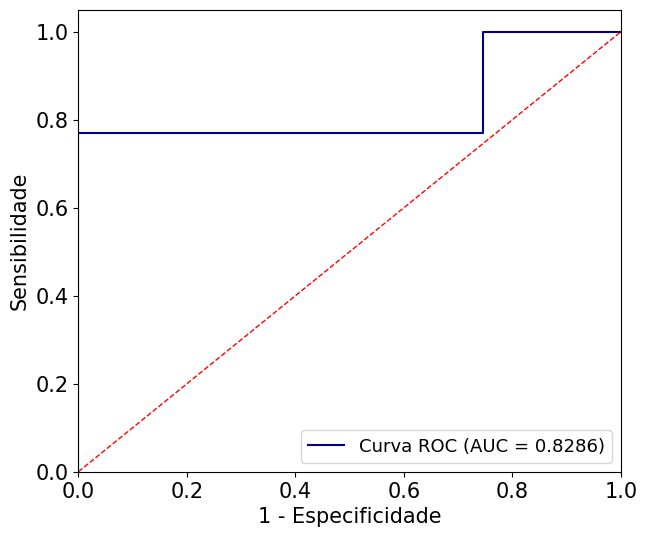

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

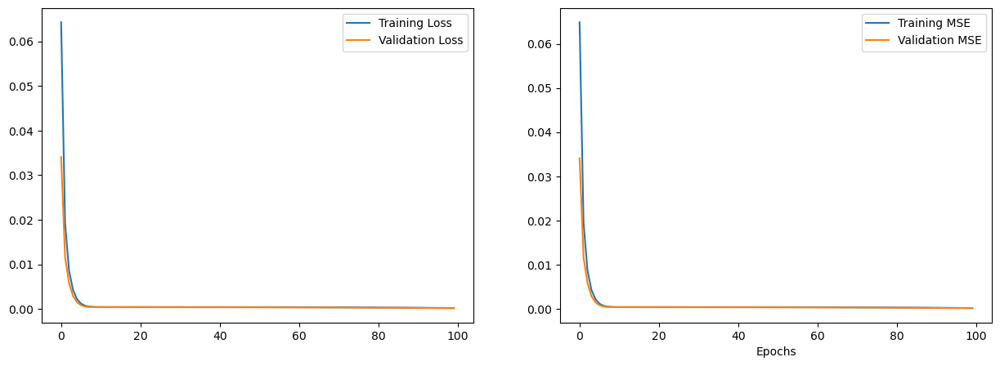

Tempo de execução Busca em grade: 0.47 segundos
Best parameters found: {'C': 1.0, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.8364023297491039
Tempo de Treinamento: 0.0260 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia = 0.8424
Precisão = 1.0000
Sensibilidade = 0.7630
Especificidade = 1.0000
F-score = 0.8655
Coeficiente de Correlação de Matthews = 0.7203
AUC = 0.9280
############################################################


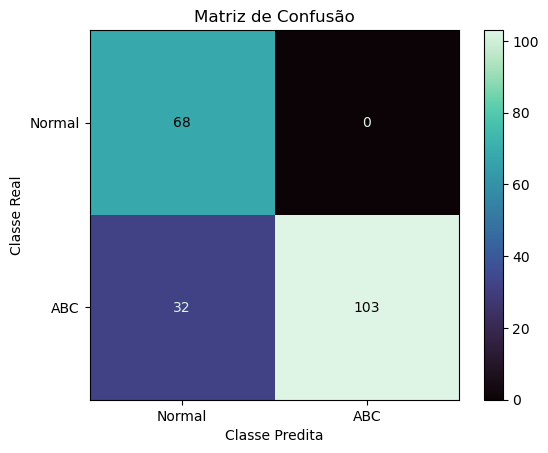

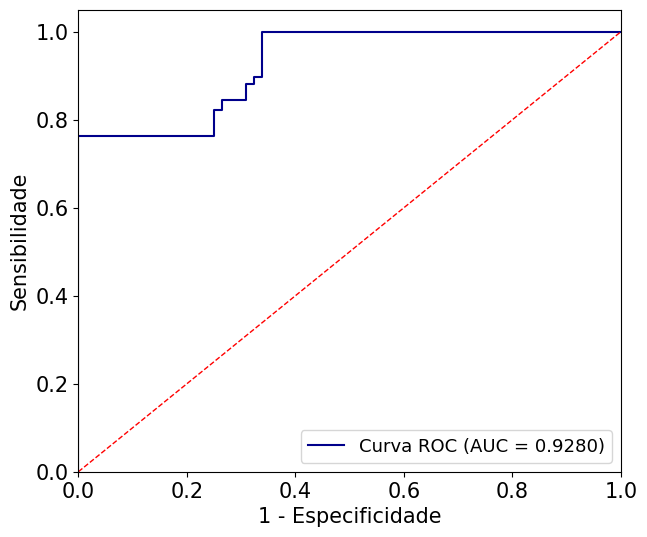

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

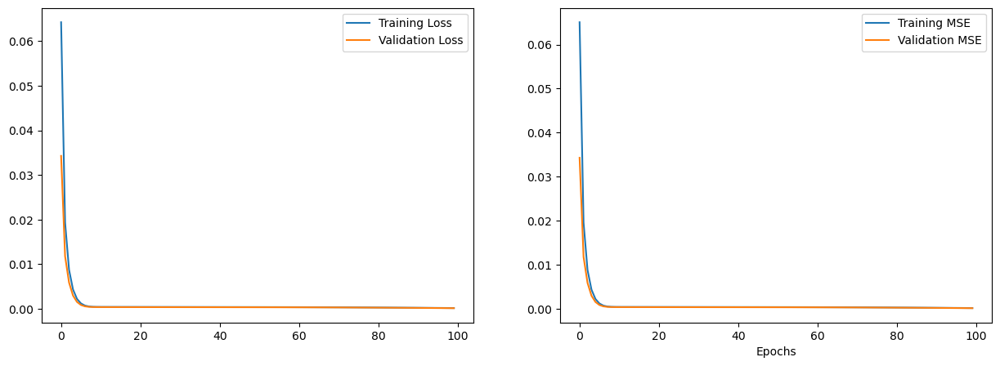

Tempo de execução Busca em grade: 0.45 segundos
Best parameters found: {'C': 1.0, 'kernel': 'rbf', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9334566616564535
Tempo de Treinamento: 0.0270 segundos
Tempo de Previsão: 0.0030 segundos
Acurácia = 0.8458
Precisão = 1.0000
Sensibilidade = 0.7704
Especificidade = 1.0000
F-score = 0.8703
Coeficiente de Correlação de Matthews = 0.7240
AUC = 0.9882
############################################################


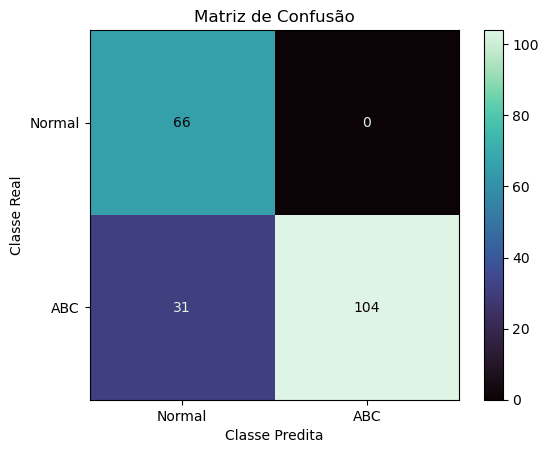

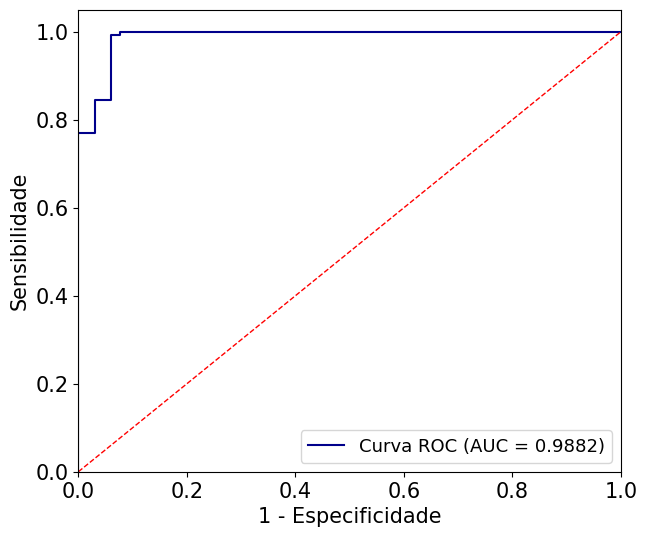

 
 
 
________________________________________
Model: <class 'sklearn.svm._classes.SVC'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

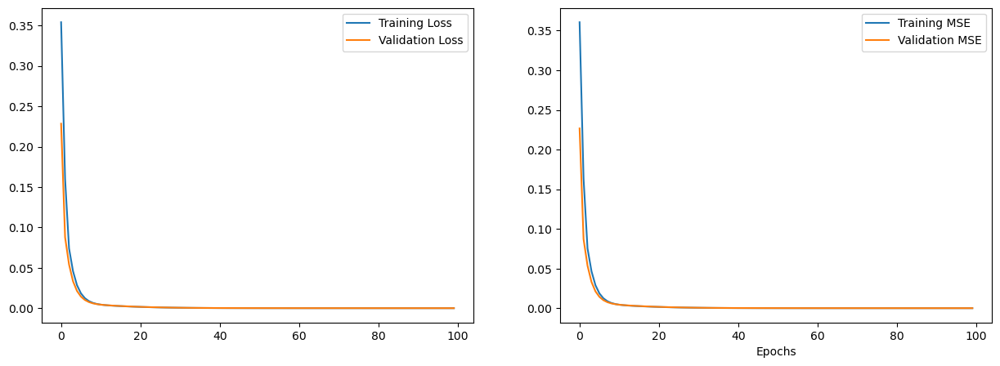

Tempo de execução Busca em grade: 0.39 segundos
Best parameters found: {'C': 0.1, 'kernel': 'linear', 'gamma': 'scale', 'random_state': 42, 'probability': True}
Best AUC ROC: 0.9583444273766855
Tempo de Treinamento: 0.0080 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 0.8020
Precisão = 1.0000
Sensibilidade = 0.7037
Especificidade = 1.0000
F-score = 0.8261
Coeficiente de Correlação de Matthews = 0.6638
AUC = 0.9447
############################################################


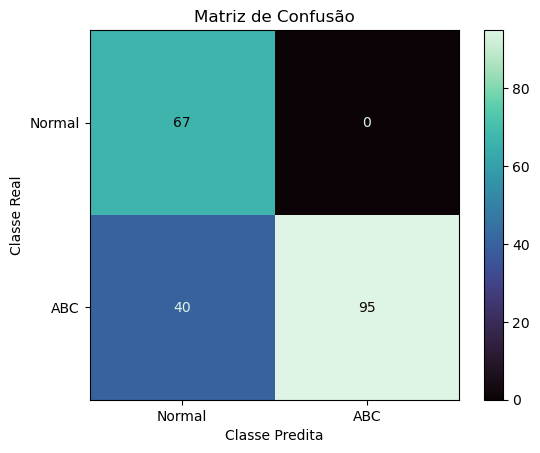

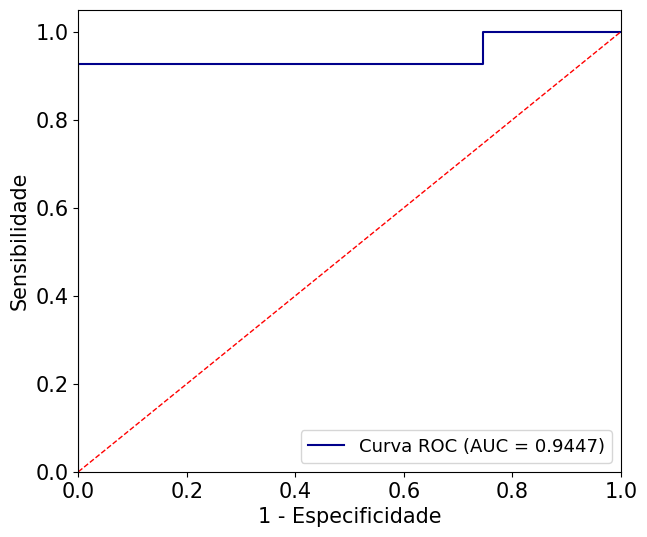

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9702947684626898
ROC AUC média (micro) de todas as iterações: 0.9711434313048213
Acurácia média de todas as iterações: 0.8550776016267162
Recall médio (macro) de todas as iterações: 0.8450640896383531
Recall médio (micro) de todas as iterações: 0.8616279625463624
Especificidade média (macro) de todas as iterações: 0.891978401303963
Especificidade média (micro) de todas as iterações: 0.8917360698199808
 
############################################################
Tempo de execução Total: 106.0262 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [SVC]
param_grid_svc = {
    'C': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
    'kernel': ['linear', 'sigmoid', 'rbf'],
    'gamma':['scale', 'auto'],
    'random_state': [42],
    'probability': [True]
}
param_grids = [param_grid_svc]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### GB

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

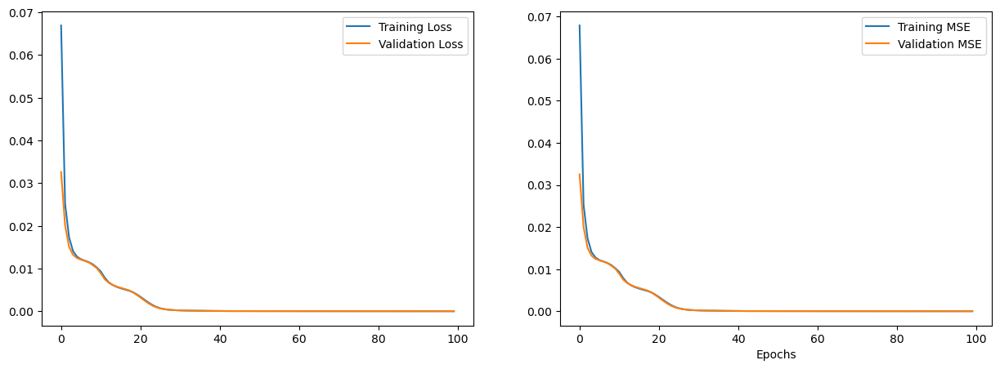

Tempo de execução Busca em grade: 8.98 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1262 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


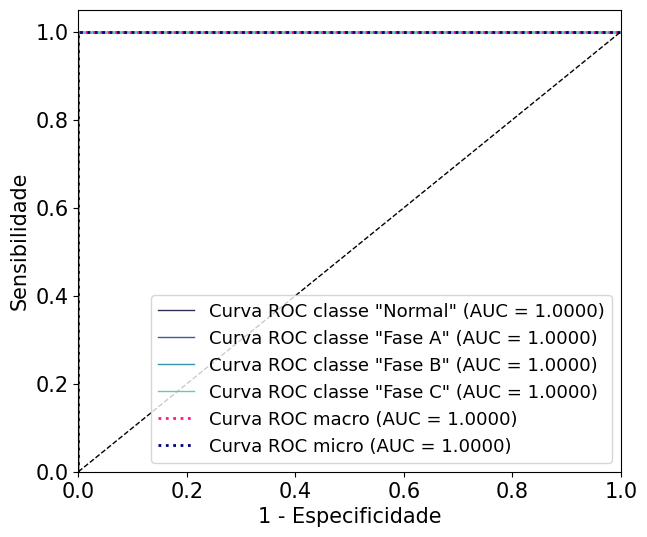

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

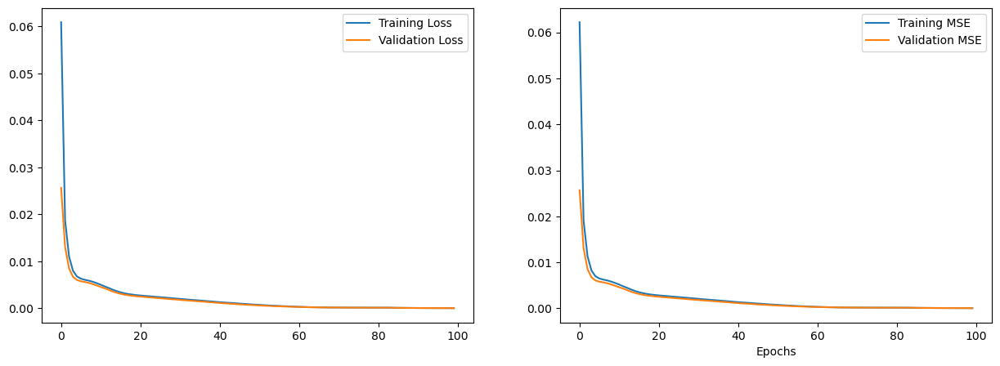

Tempo de execução Busca em grade: 14.01 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 150, 'criterion': 'squared_error', 'max_depth': 5, 'random_state': 42}
Best AUC ROC: 0.9987961035957914
Tempo de Treinamento: 1.0568 segundos
Tempo de Previsão: 0.0040 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9775
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9925
Especificidade (specificity) micro: 0.9925
AUC: 0.9992
Matriz de Confusão
[[63  1  0  1]
 [ 3 65  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.9692, Specificity = 0.9802, F-score = 0.9747
Class 1: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 0.9950, F-score = 0.9900
Macro F-score: 0.9849


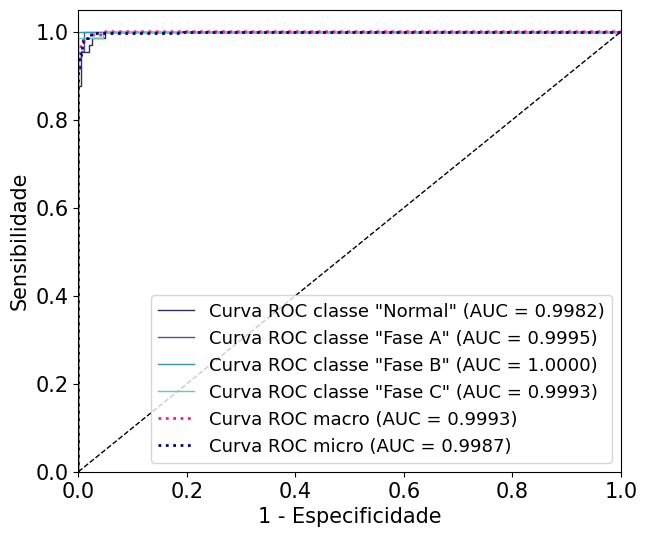

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

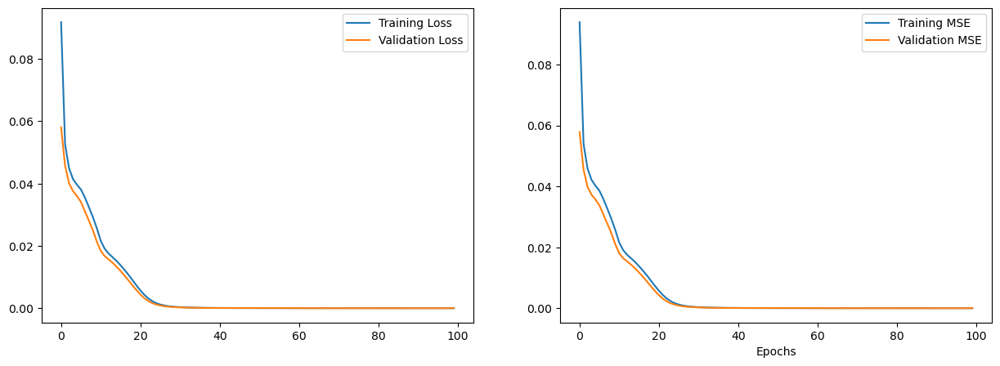

Tempo de execução Busca em grade: 12.80 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 100, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.9957438676075269
Tempo de Treinamento: 0.4463 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro:0.9745
Sensitivity (Recall) Micro: 0.9738
Especificidade (specificity) macro: 0.9913
Especificidade (specificity) micro: 0.9913
AUC: 0.9978
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 65  2]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9420, Specificity = 1.0000, F-score = 0.9701
Class 3: Sensitivity = 0.9559, Specificity = 0.9899, F-score = 0.9726
Macro F-score: 0.9826


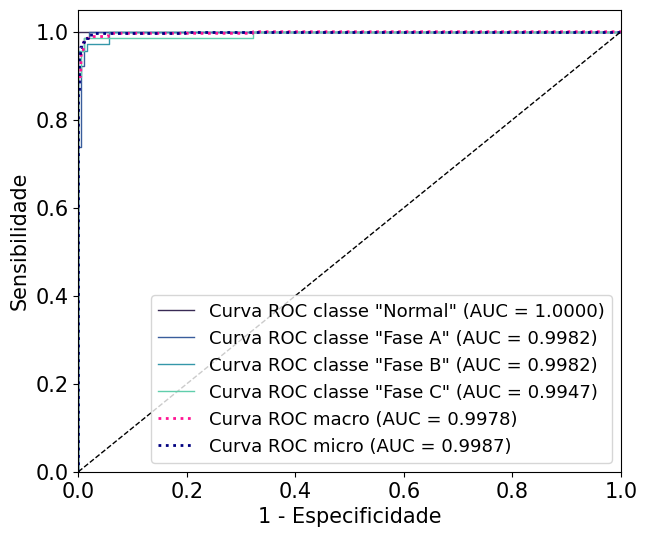

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

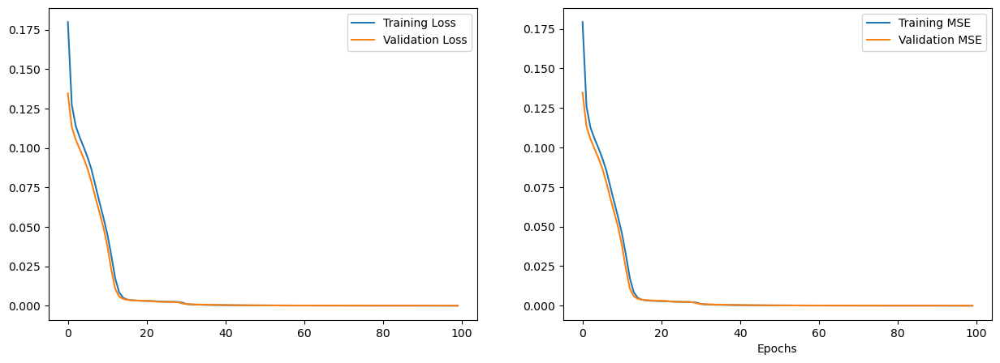

Tempo de execução Busca em grade: 9.37 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0900 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9963
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


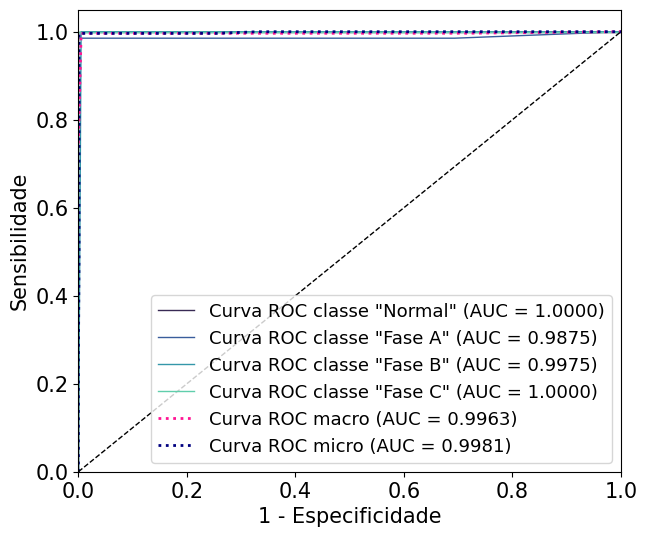

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

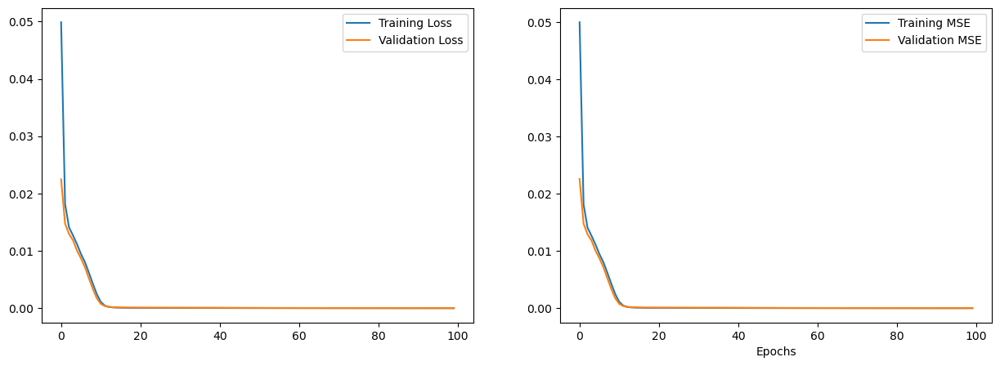

Tempo de execução Busca em grade: 15.89 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1513 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


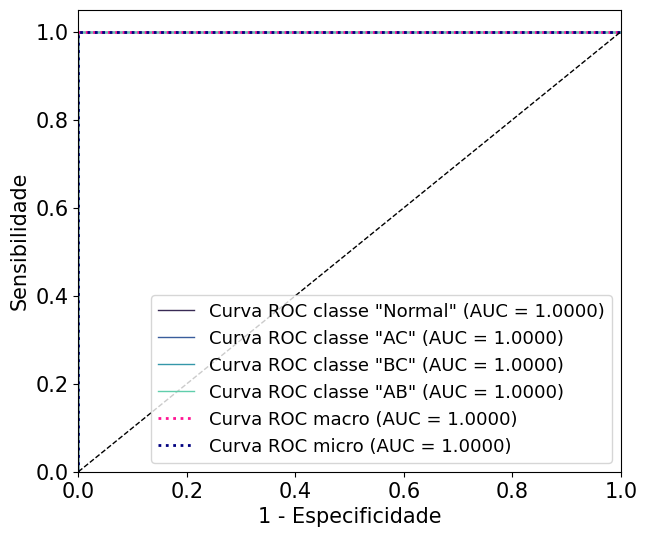

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

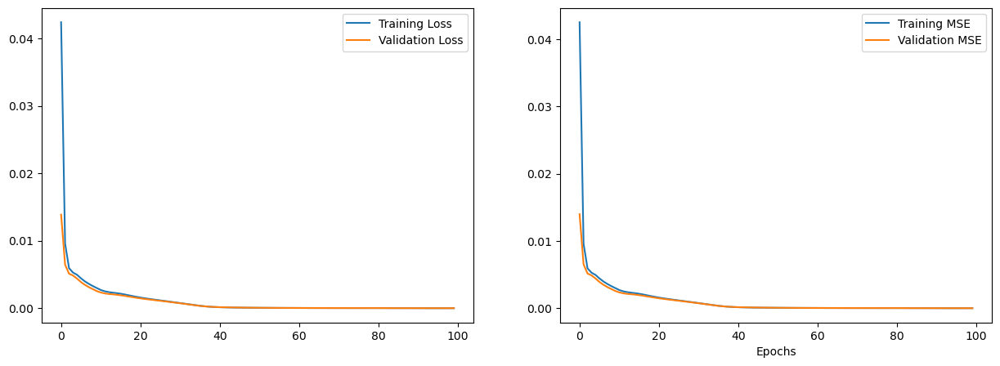

Tempo de execução Busca em grade: 17.85 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 50, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.9999465210217899
Tempo de Treinamento: 0.3800 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


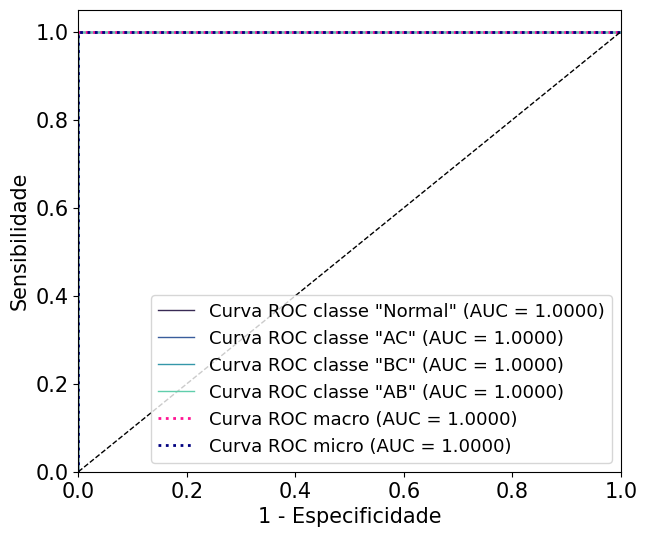

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

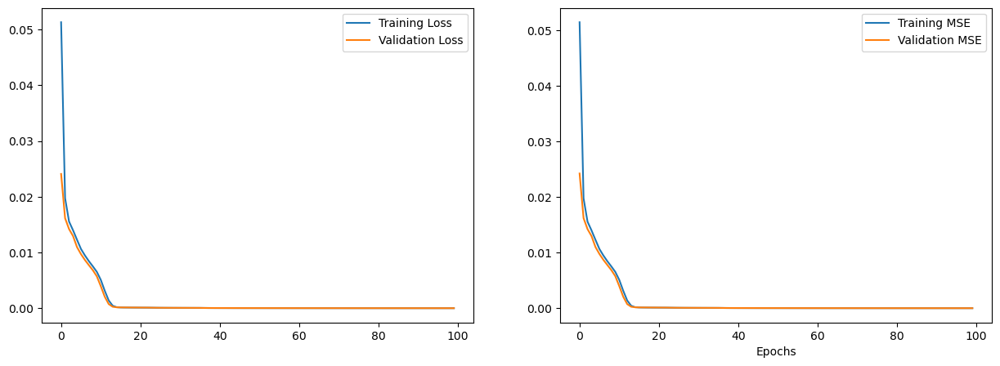

Tempo de execução Busca em grade: 13.26 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1068 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


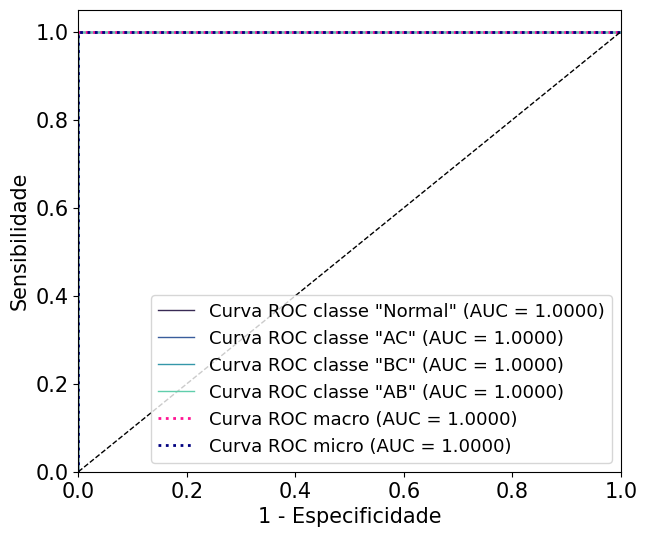

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

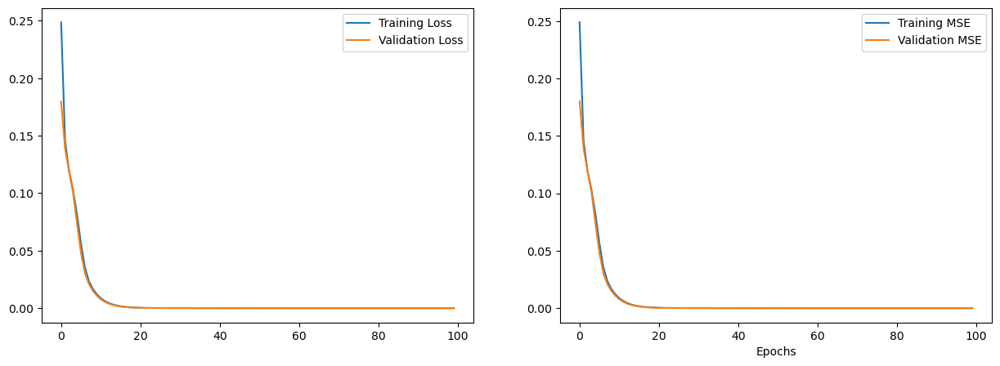

Tempo de execução Busca em grade: 12.43 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.1023 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


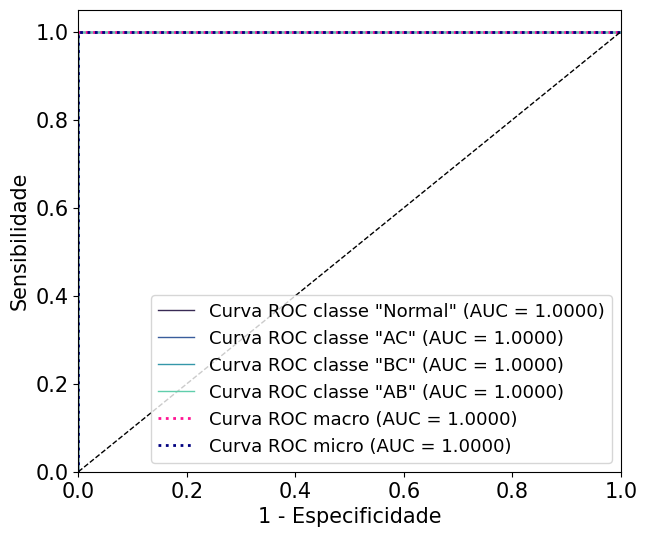

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

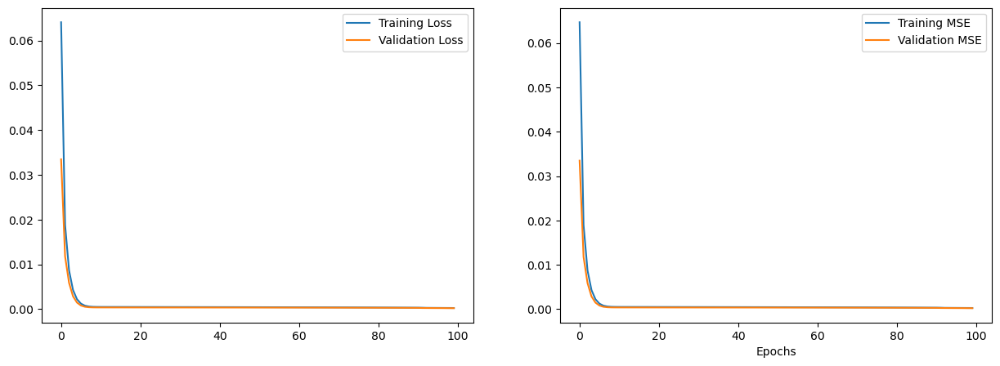

Tempo de execução Busca em grade: 2.15 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 200, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.1720 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


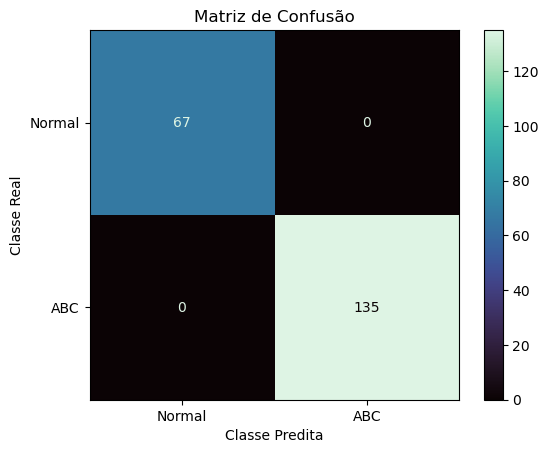

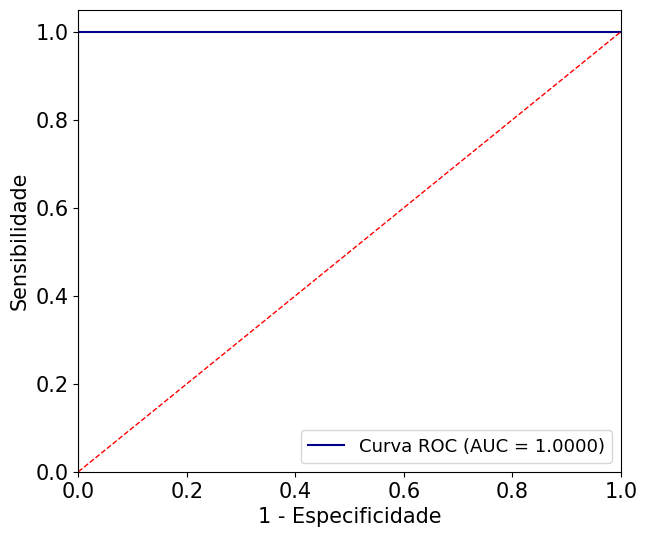

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

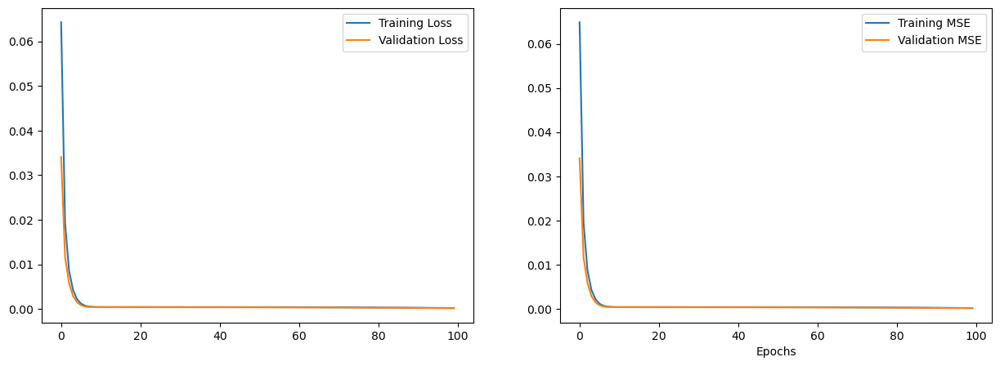

Tempo de execução Busca em grade: 2.35 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.9934963837685613
Tempo de Treinamento: 0.0150 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 0.9901
Precisão = 1.0000
Sensibilidade = 0.9852
Especificidade = 1.0000
F-score = 0.9925
Coeficiente de Correlação de Matthews = 0.9783
AUC = 1.0000
############################################################


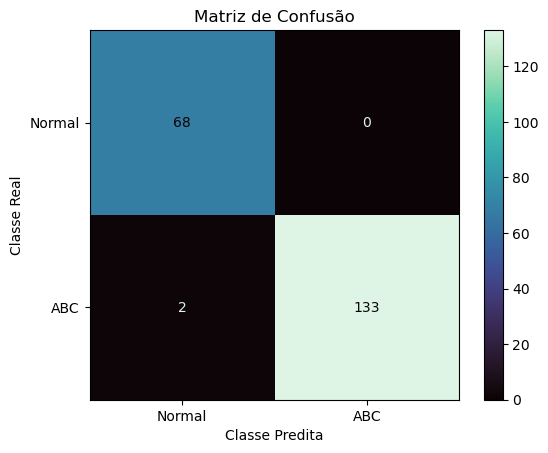

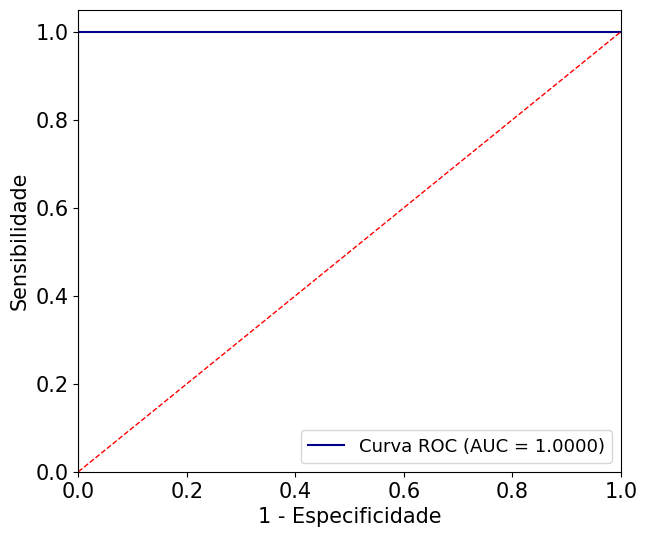

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

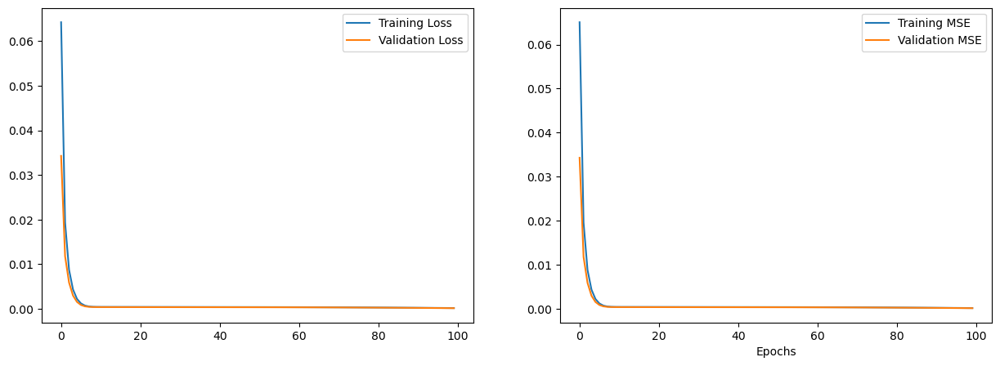

Tempo de execução Busca em grade: 1.82 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0131 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


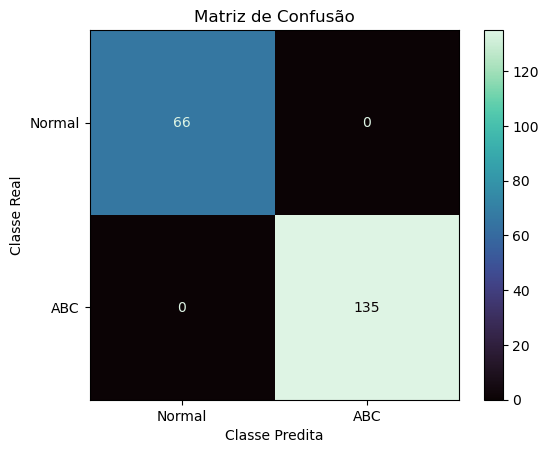

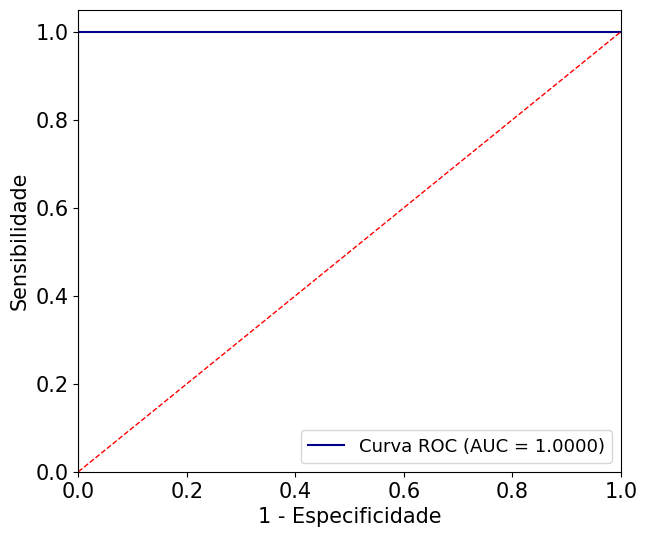

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._gb.GradientBoostingClassifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

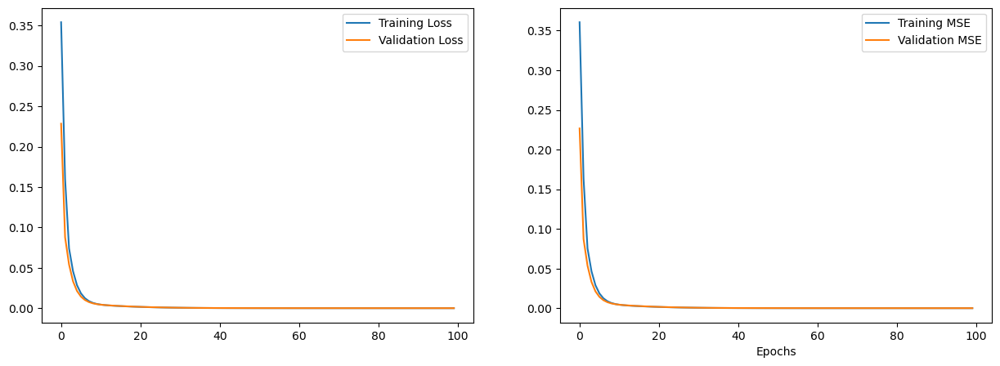

Tempo de execução Busca em grade: 1.69 segundos
Best parameters found: {'loss': 'log_loss', 'n_estimators': 20, 'criterion': 'friedman_mse', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0100 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


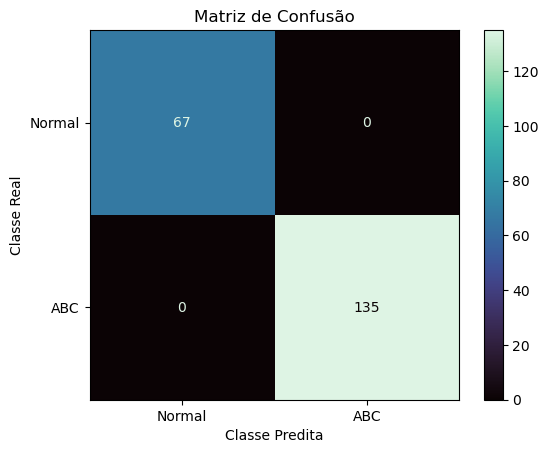

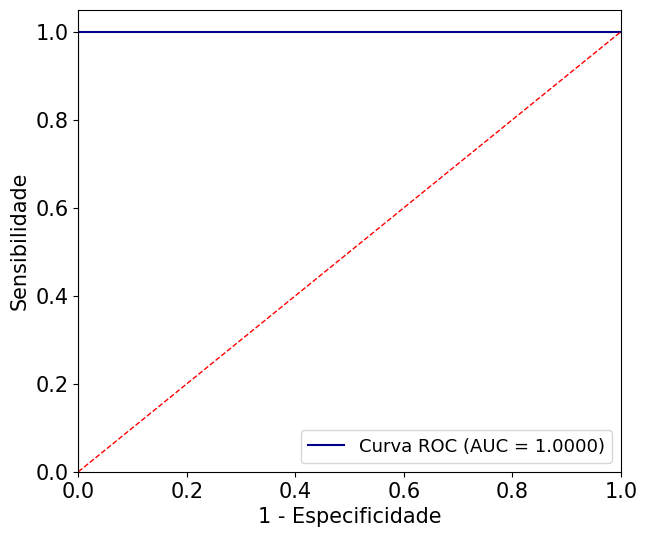

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9994402854574614
ROC AUC média (micro) de todas as iterações: 0.9996243771440506
Acurácia média de todas as iterações: 0.9948094438601993
Recall médio (macro) de todas as iterações: 0.9944611238723717
Recall médio (micro) de todas as iterações: 0.9943958940213622
Especificidade média (macro) de todas as iterações: 0.9985493784931257
Especificidade média (micro) de todas as iterações: 0.9985434873075323
 
############################################################
Tempo de execução Total: 205.8903 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [GradientBoostingClassifier]
param_grid_gb = {
    'loss': ['log_loss'],# 'exponential'],
    'n_estimators': [20, 30, 50, 100, 150, 200],
    'criterion': ['friedman_mse', 'squared_error'],
    'max_depth': [None, 3, 5, 7, 10, 15, 20,30],
    'random_state': [42]
}
param_grids = [param_grid_gb]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### MLP

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset 2PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)      

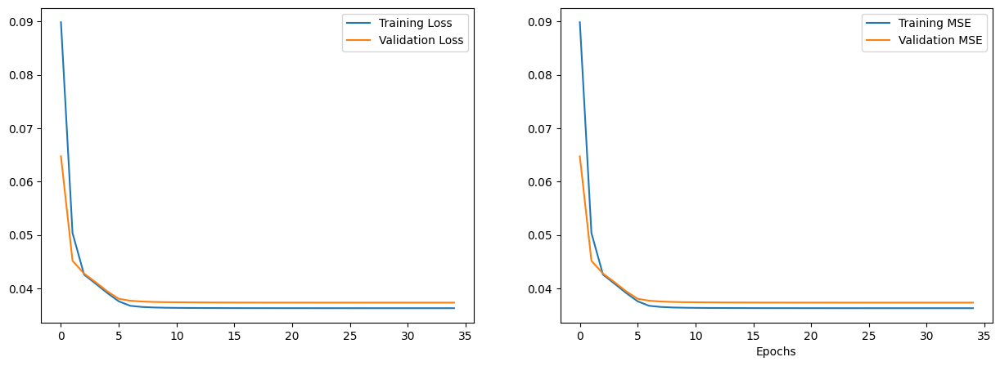

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 470.66 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'relu', 'solver': 'sgd', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(


Tempo de Treinamento: 2.8591 segundos
Tempo de Previsão: 0.0004 segundos
Acurácia: 98.87640449%
Sensitivity (Recall) Macro:0.9888
Sensitivity (Recall) Micro: 0.9888
Especificidade (specificity) macro: 0.9963
Especificidade (specificity) micro: 0.9963
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 3  0  0 64]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9851, F-score = 0.9925
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9552, Specificity = 1.0000, F-score = 0.9771
Macro F-score: 0.9924


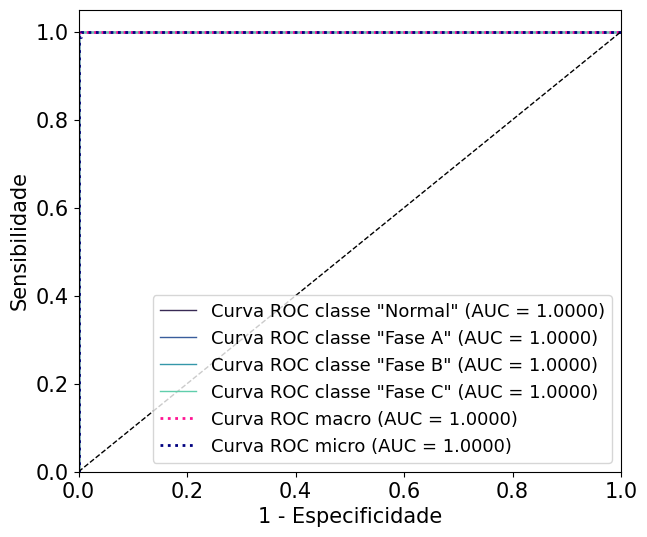

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset 3PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)                

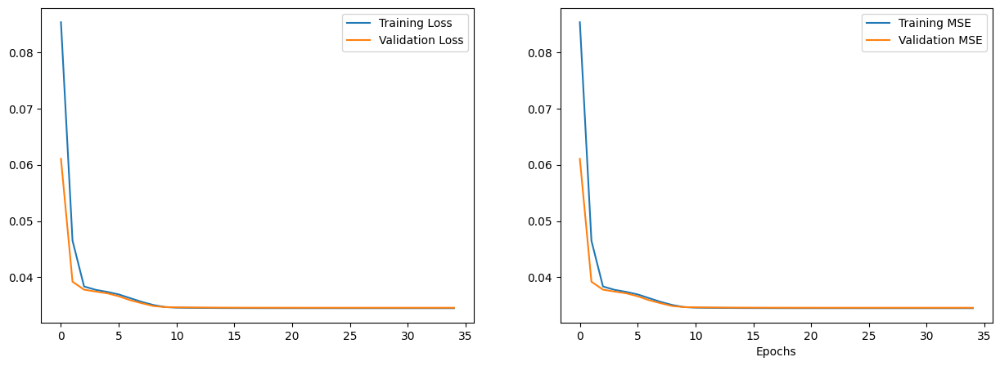

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS R

Tempo de execução Busca em grade: 475.90 segundos
Best parameters found: {'hidden_layer_sizes': 32, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 0.9970292808417159


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.6096 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 95.13108614%
Sensitivity (Recall) Macro:0.9508
Sensitivity (Recall) Micro: 0.9513
Especificidade (specificity) macro: 0.9838
Especificidade (specificity) micro: 0.9838
AUC: 0.9953
Matriz de Confusão
[[57  7  0  1]
 [ 5 63  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 0.8769, Specificity = 0.9752, F-score = 0.9235
Class 1: Sensitivity = 0.9265, Specificity = 0.9648, F-score = 0.9453
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Macro F-score: 0.9666


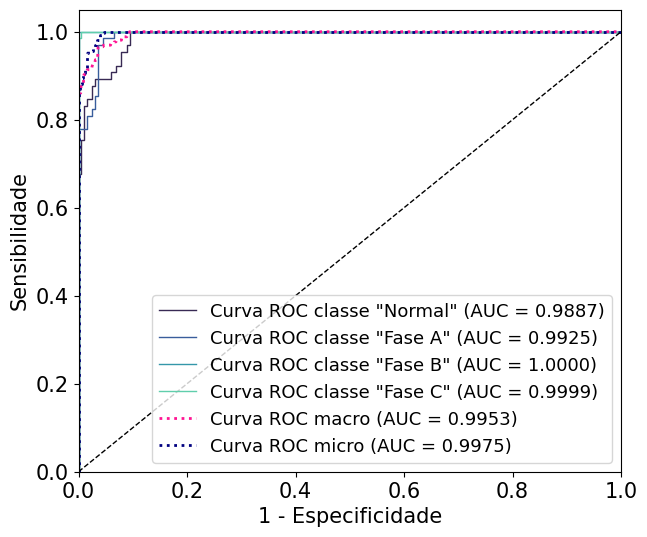

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)                 

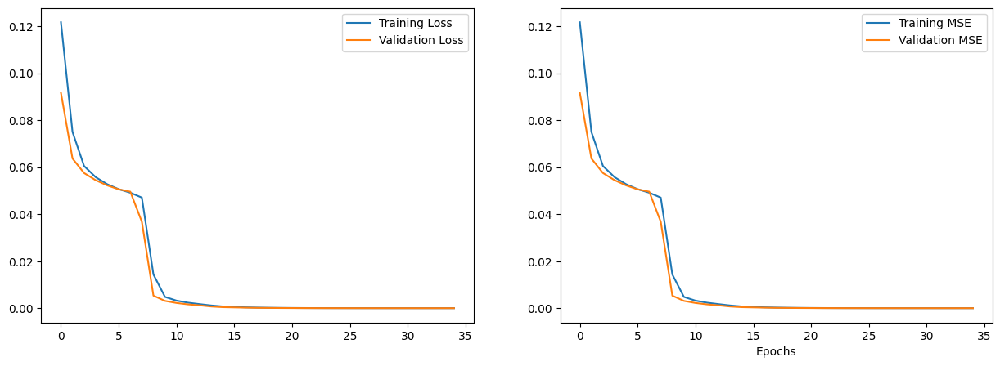

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS R

Tempo de execução Busca em grade: 468.49 segundos
Best parameters found: {'hidden_layer_sizes': 32, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 0.9977591915882617


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.5089 segundos
Tempo de Previsão: 0.0014 segundos
Acurácia: 97.37827715%
Sensitivity (Recall) Macro:0.9744
Sensitivity (Recall) Micro: 0.9738
Especificidade (specificity) macro: 0.9913
Especificidade (specificity) micro: 0.9913
AUC: 0.9984
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  1 64]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 0.9949, F-score = 0.9754
Class 3: Sensitivity = 0.9412, Specificity = 0.9950, F-score = 0.9673
Macro F-score: 0.9825


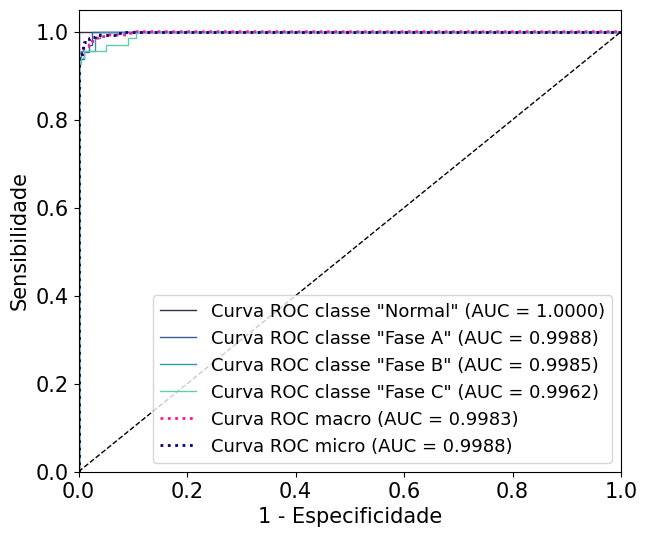

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset Sem GD:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)             

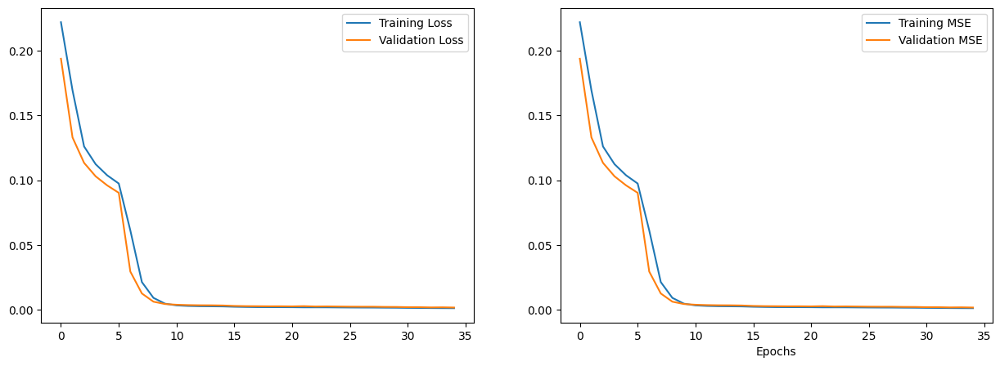

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 371.14 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0121 segundos
Tempo de Previsão: 0.0002 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9966
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


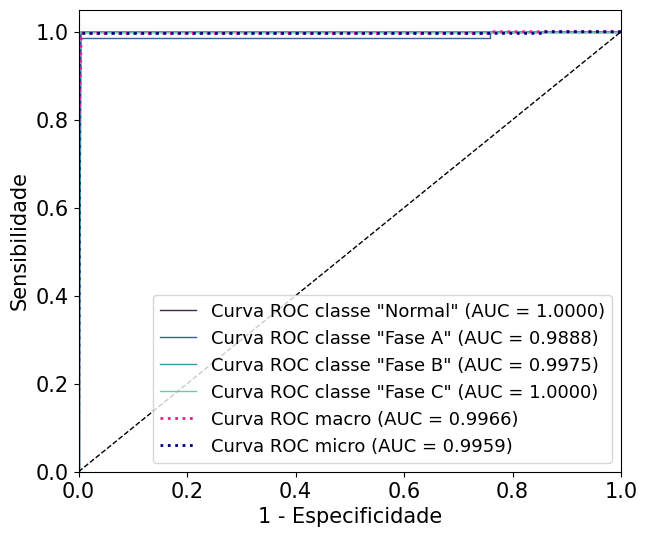

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset 2PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)  

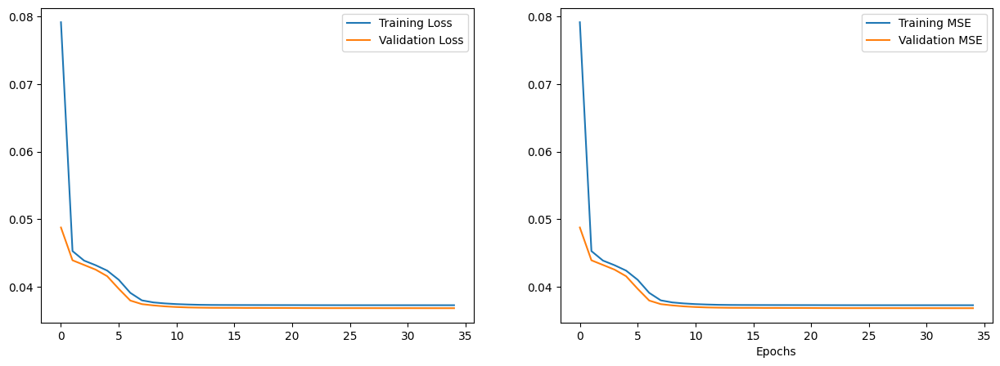

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 688.32 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0267 segundos
Tempo de Previsão: 0.0003 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


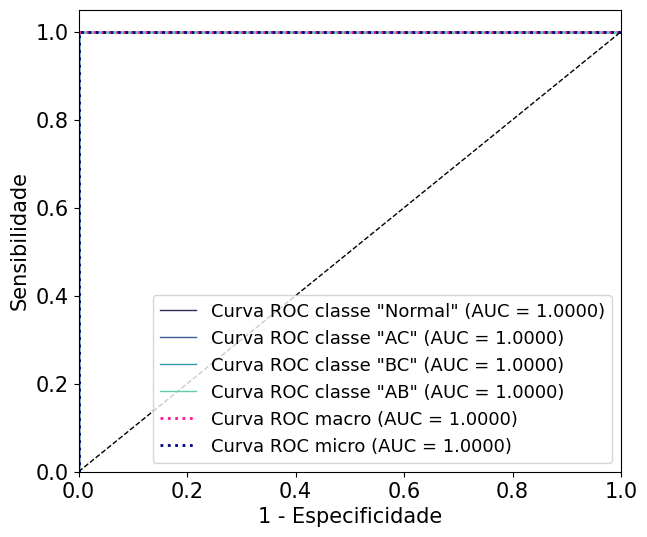

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset 3PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)                

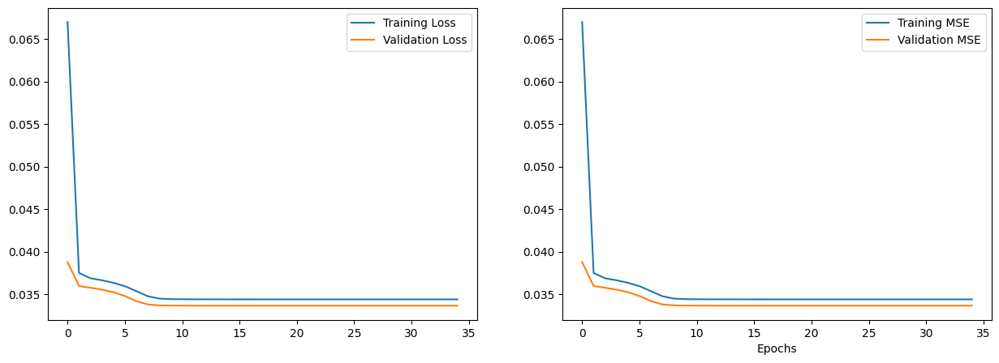

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 751.84 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0878 segundos
Tempo de Previsão: 0.0006 segundos
Acurácia: 99.78632479%
Sensitivity (Recall) Macro:0.9981
Sensitivity (Recall) Micro: 0.9979
Especificidade (specificity) macro: 0.9994
Especificidade (specificity) micro: 0.9993
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  1 134   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9975, F-score = 0.9988
Class 1: Sensitivity = 0.9926, Specificity = 1.0000, F-score = 0.9963
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9988


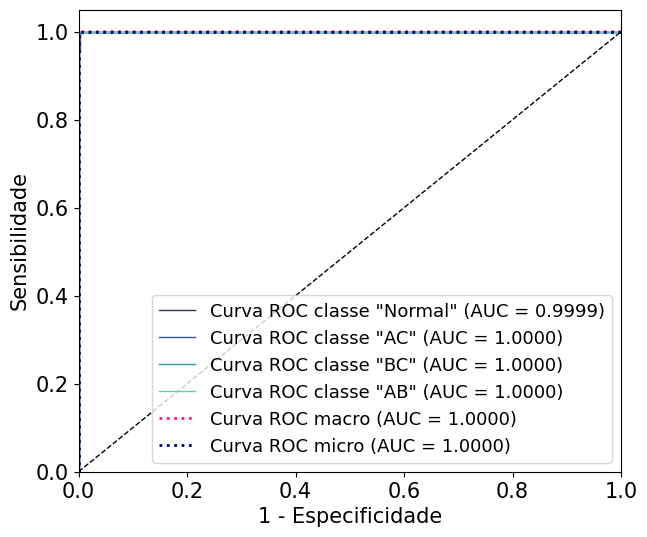

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)                 

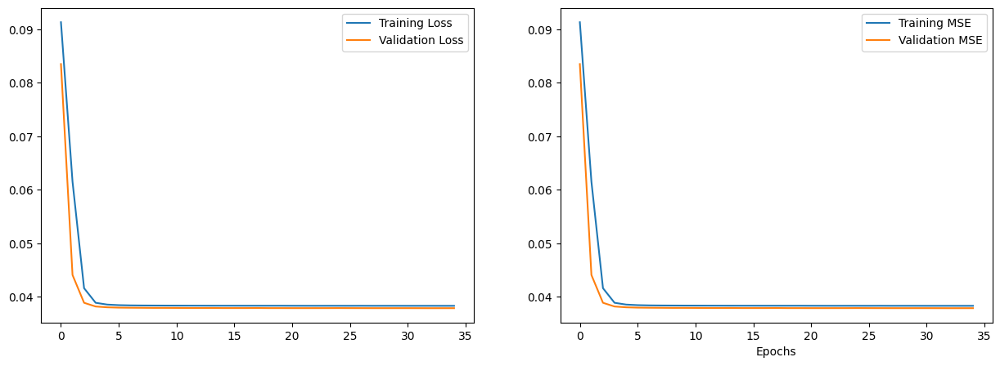

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 578.51 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0177 segundos
Tempo de Previsão: 0.0003 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


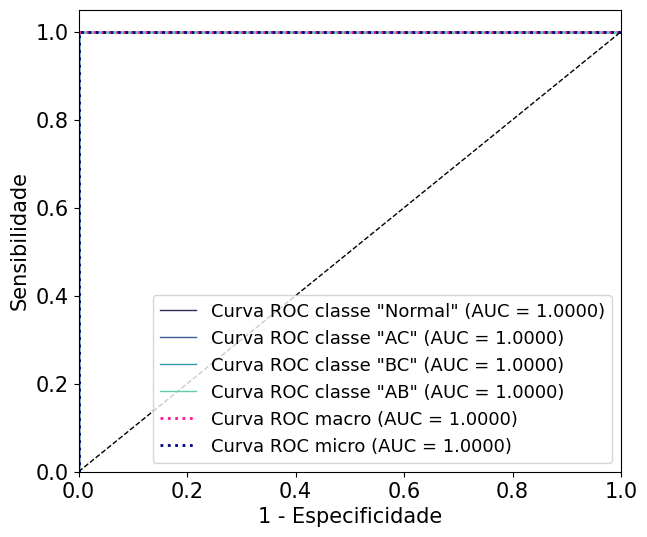

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset Sem GD:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)             

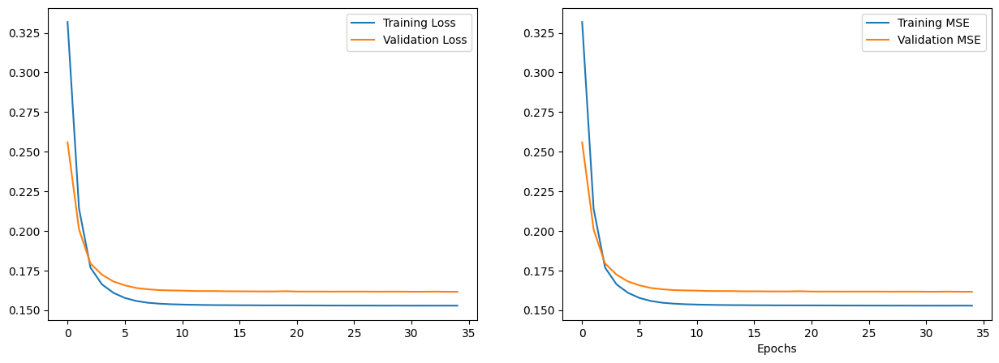

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 576.58 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0164 segundos
Tempo de Previsão: 0.0003 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


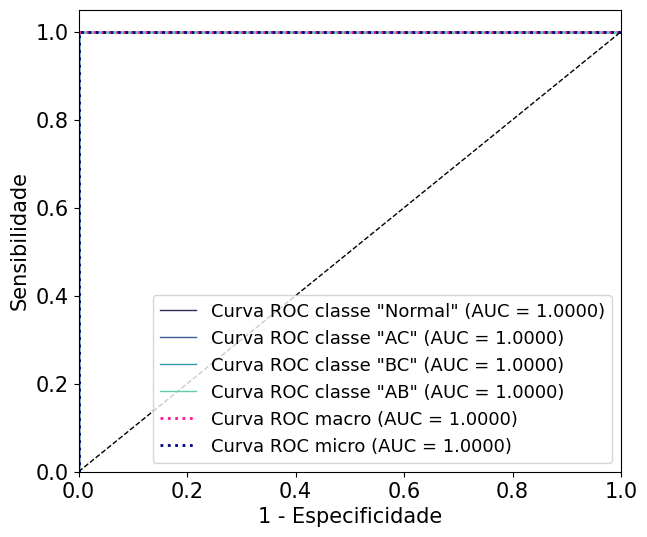

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset 2PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense) 

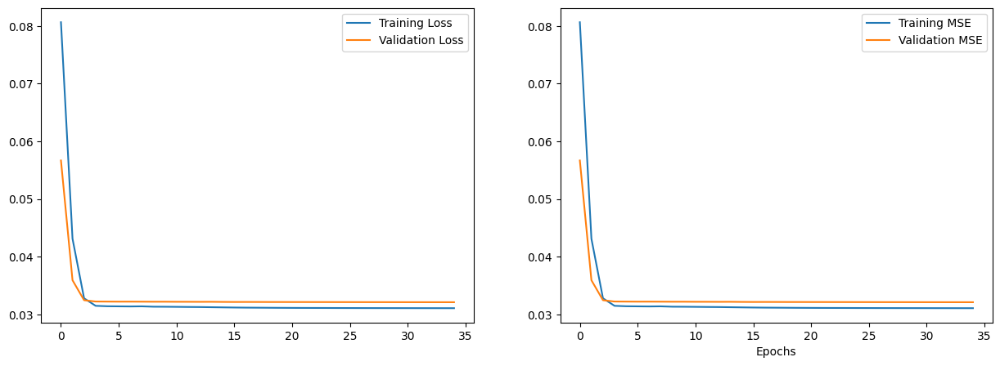

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 239.77 segundos
Best parameters found: {'hidden_layer_sizes': (8, 4), 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 0.9936507936507937
Tempo de Treinamento: 0.0385 segundos
Tempo de Previsão: 0.0002 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


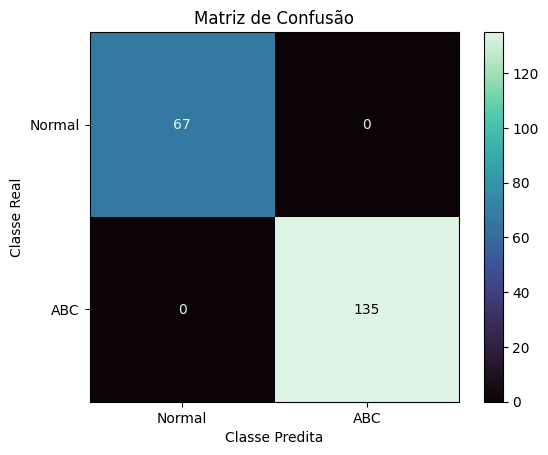

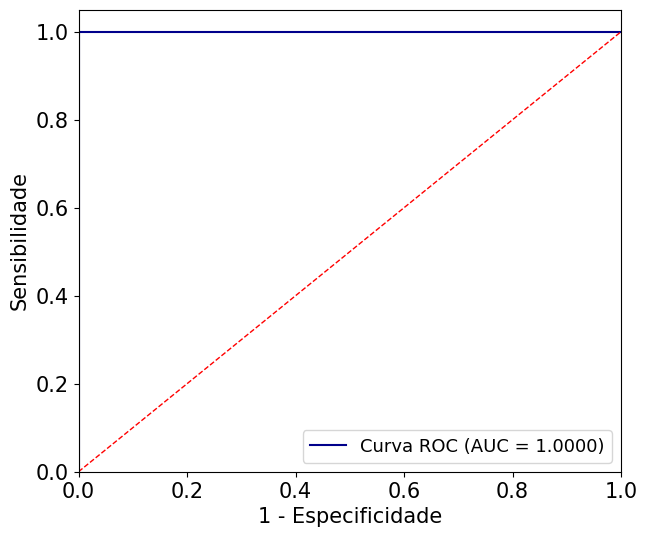

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset 3PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)                

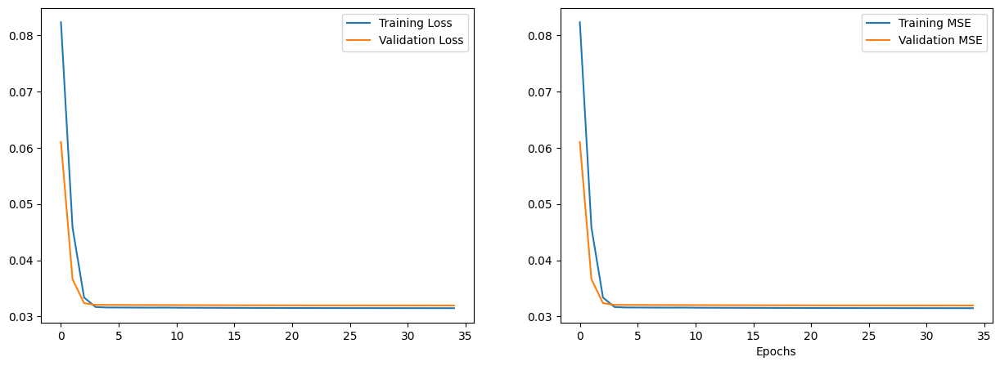

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 242.31 segundos
Best parameters found: {'hidden_layer_sizes': (16, 8), 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 0.9953277009728623
Tempo de Treinamento: 0.2997 segundos
Tempo de Previsão: 0.0005 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


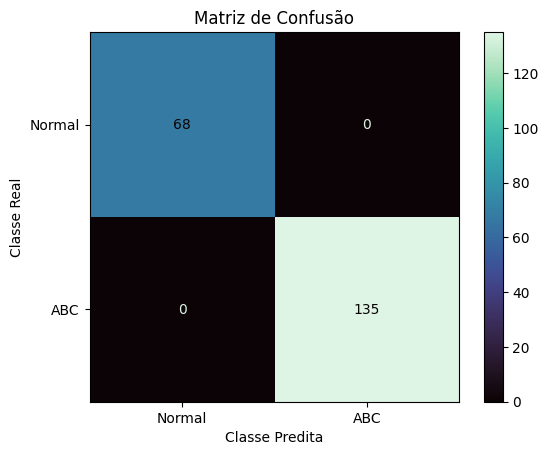

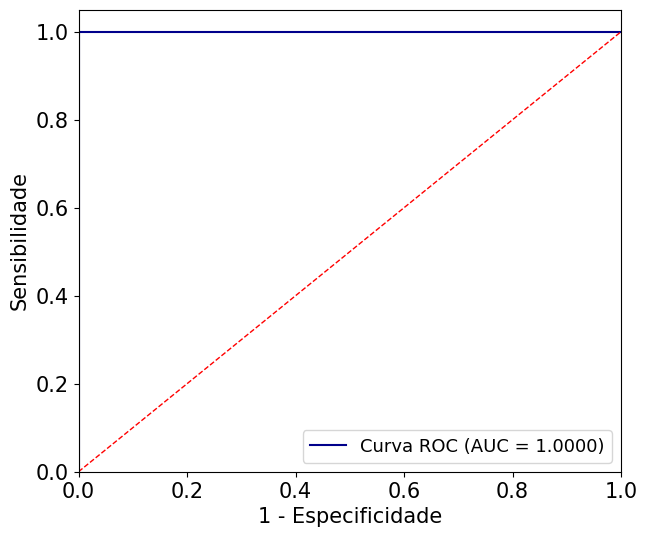

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset PV:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)                 

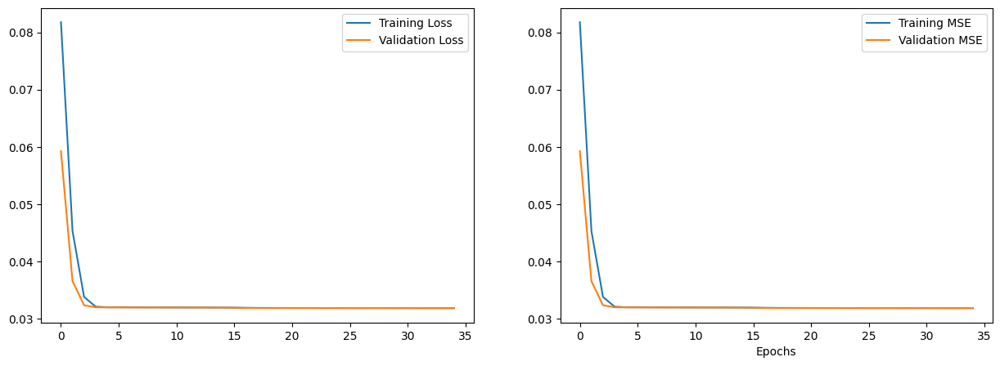

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS R

Tempo de execução Busca em grade: 253.53 segundos
Best parameters found: {'hidden_layer_sizes': 16, 'activation': 'tanh', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Tempo de Treinamento: 0.3433 segundos
Tempo de Previsão: 0.0011 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


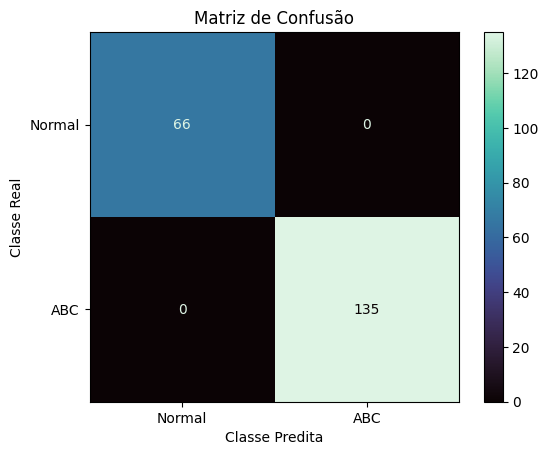

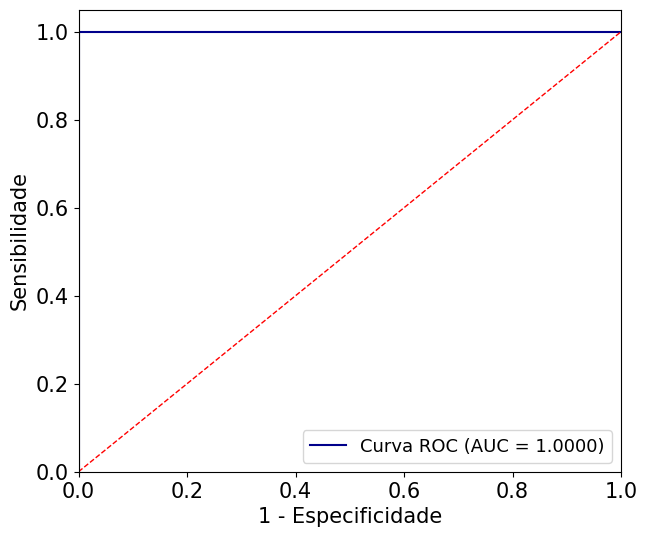

 
 
 
________________________________________
Model: <class 'sklearn.neural_network._multilayer_perceptron.MLPClassifier'> - Dataset SEM GD:
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 3)]               0         
                                                                 
 dense (Dense)               (None, 4)                 16        
                                                                 
 dense_1 (Dense)             (None, 6)                 30        
                                                                 
 dense_2 (Dense)             (None, 8)                 56        
                                                                 
 dense_3 (Dense)             (None, 6)                 54        
                                                                 
 dense_4 (Dense)             (None, 4)             

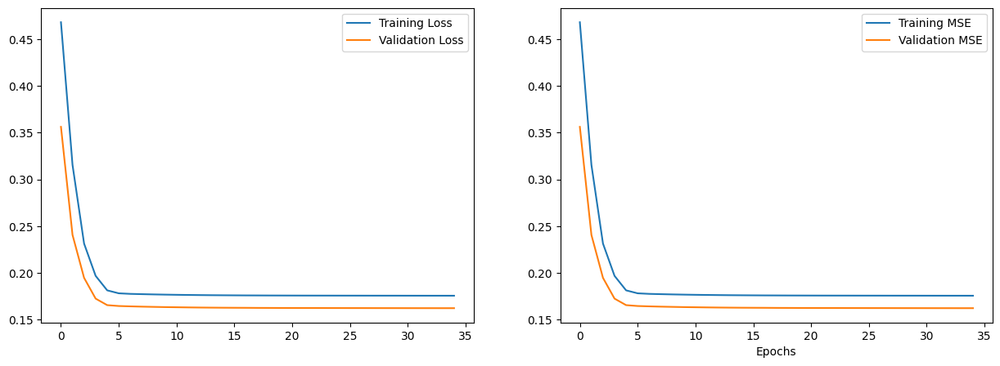

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Tempo de execução Busca em grade: 324.34 segundos
Best parameters found: {'hidden_layer_sizes': 8, 'activation': 'relu', 'solver': 'lbfgs', 'random_state': 42, 'batch_size': 16, 'max_iter': 250}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0165 segundos
Tempo de Previsão: 0.0002 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


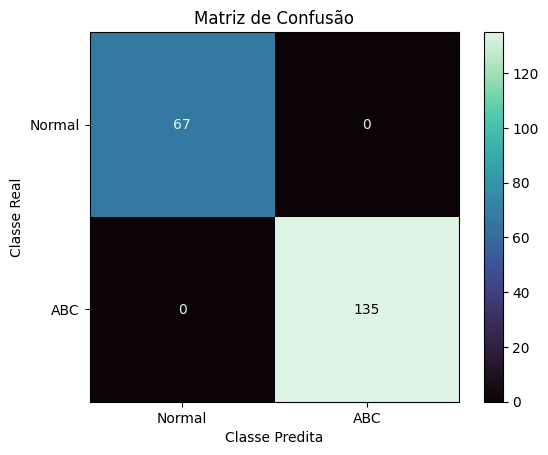

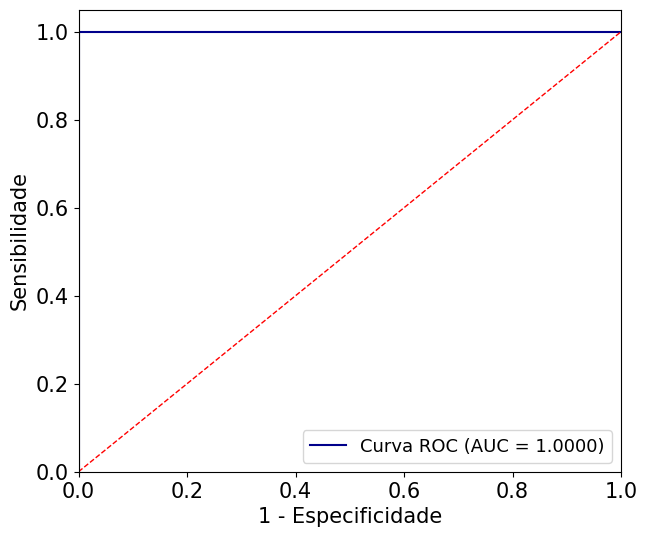

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9991830361671941
ROC AUC média (micro) de todas as iterações: 0.9993411877498053
Acurácia média de todas as iterações: 0.9923313006178175
Recall médio (macro) de todas as iterações: 0.9923792180357022
Recall médio (micro) de todas as iterações: 0.9923313006178175
Especificidade média (macro) de todas as iterações: 0.997456472181305
Especificidade média (micro) de todas as iterações: 0.9974437668726058
 
############################################################
Tempo de execução Total: 5647.1894 segundos


In [35]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [4, 6],
    'decoder_layers': [6, 4],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 35,
    'batch_size': 8,
    'verbose' : 0
}

modelos = [MLPClassifier]
param_grid_mlp = {
    'hidden_layer_sizes': [(8), (16), (32), (8, 4), (16, 8)],
    'activation': ['relu', 'tanh'],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'random_state': [42],
    'batch_size': [16, 32, 64],
    'max_iter': [250]
}
param_grids = [param_grid_mlp]

file_paths = '/content/Banco de dados-V3 (2).xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = '/content/Sistema normal (1).xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### DT

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

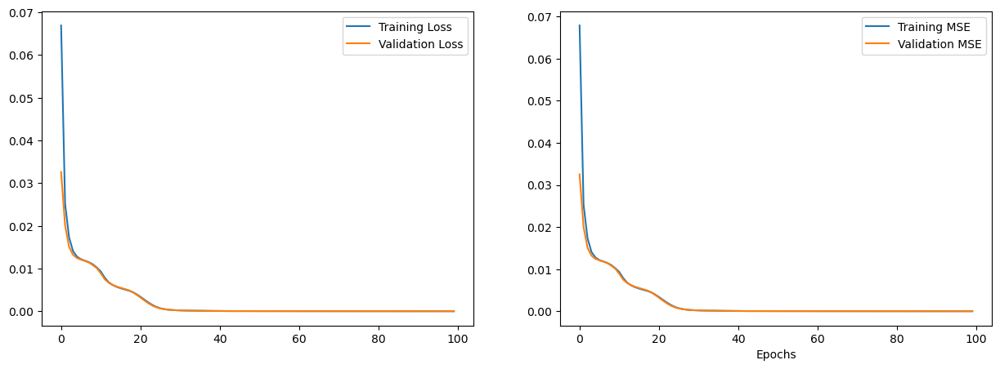

Tempo de execução Busca em grade: 2.04 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


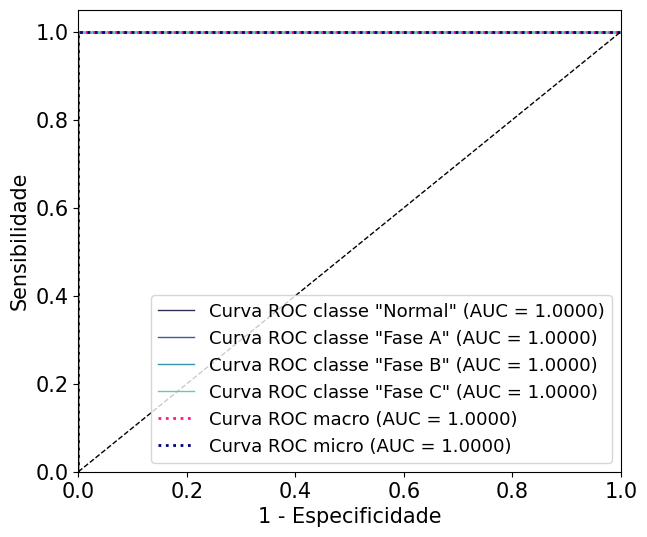

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

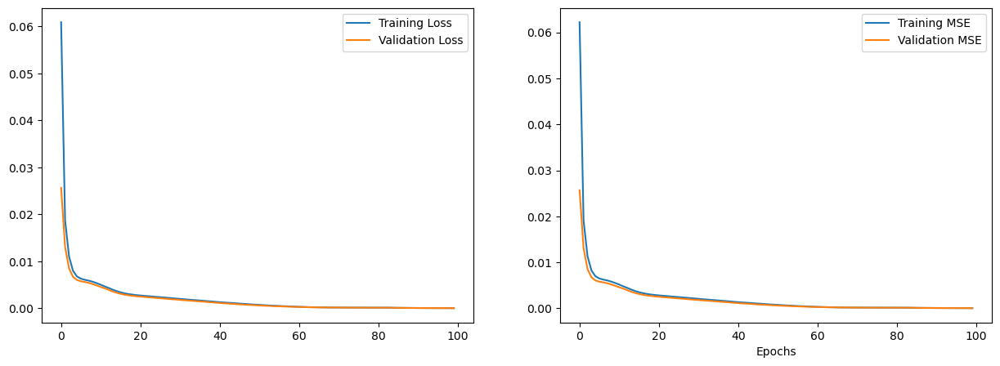

Tempo de execução Busca em grade: 0.26 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 5, 'random_state': 42}
Best AUC ROC: 0.9966657814487225
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.00374532%
Sensitivity (Recall) Macro:0.9693
Sensitivity (Recall) Micro: 0.9700
Especificidade (specificity) macro: 0.9900
Especificidade (specificity) micro: 0.9900
AUC: 0.9978
Matriz de Confusão
[[58  7  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.8923, Specificity = 0.9950, F-score = 0.9409
Class 1: Sensitivity = 1.0000, Specificity = 0.9648, F-score = 0.9821
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9789


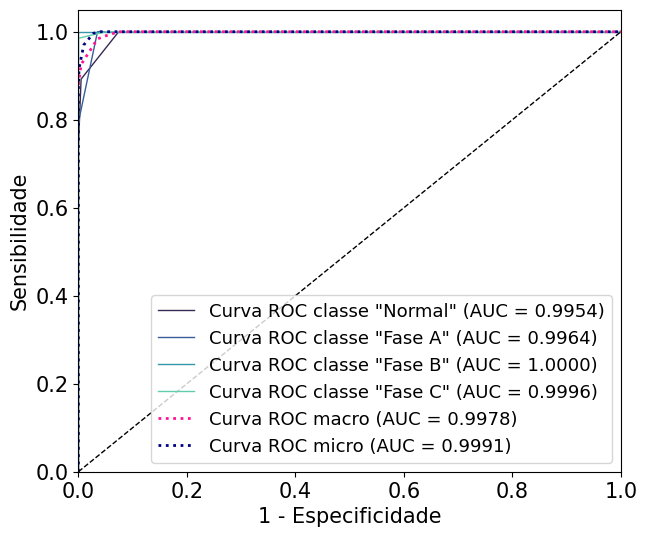

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

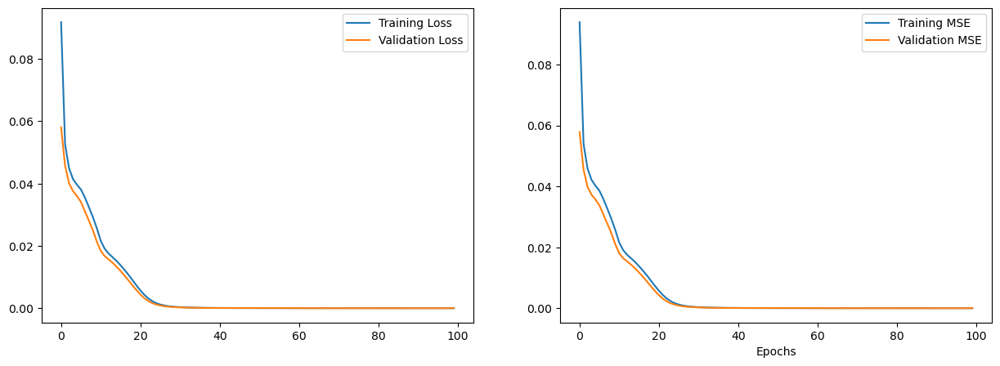

Tempo de execução Busca em grade: 0.26 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'random', 'max_depth': 5, 'random_state': 42}
Best AUC ROC: 0.9967082318268368
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9969
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


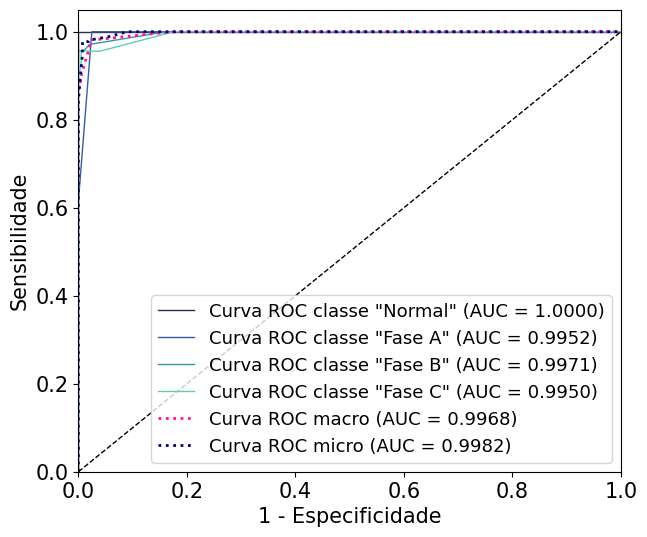

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

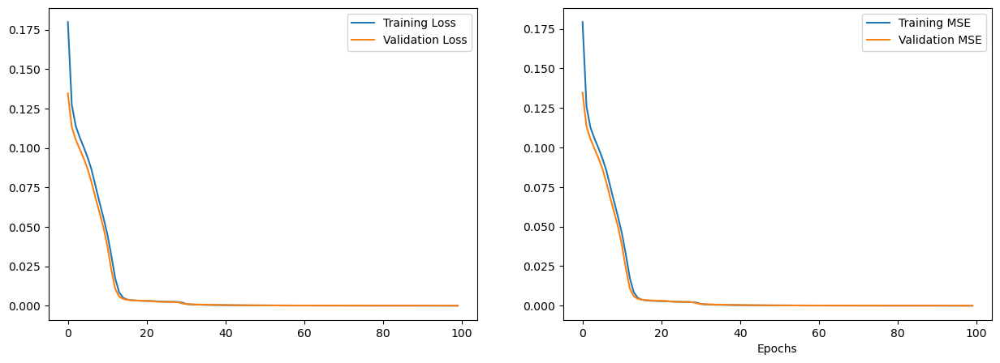

Tempo de execução Busca em grade: 0.27 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


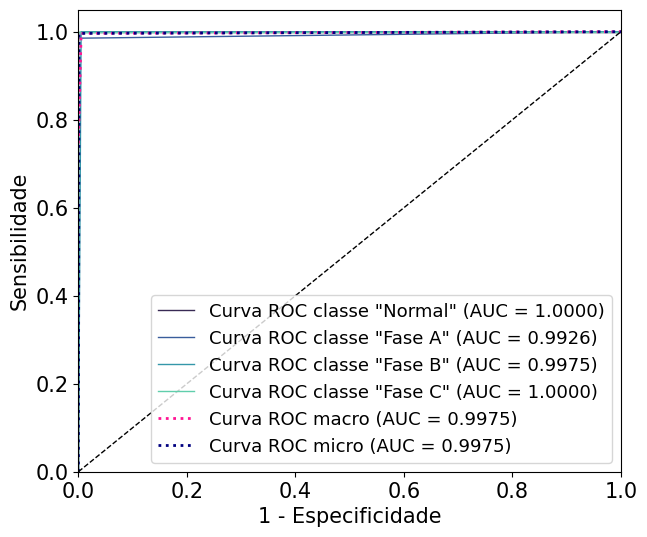

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

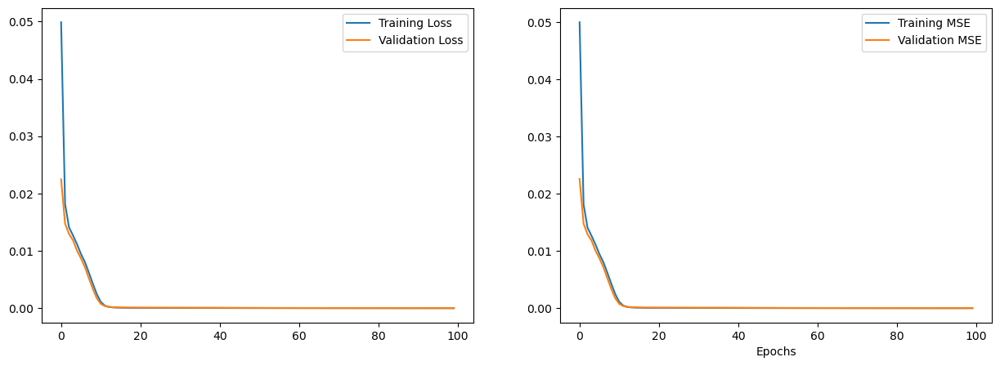

Tempo de execução Busca em grade: 0.27 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


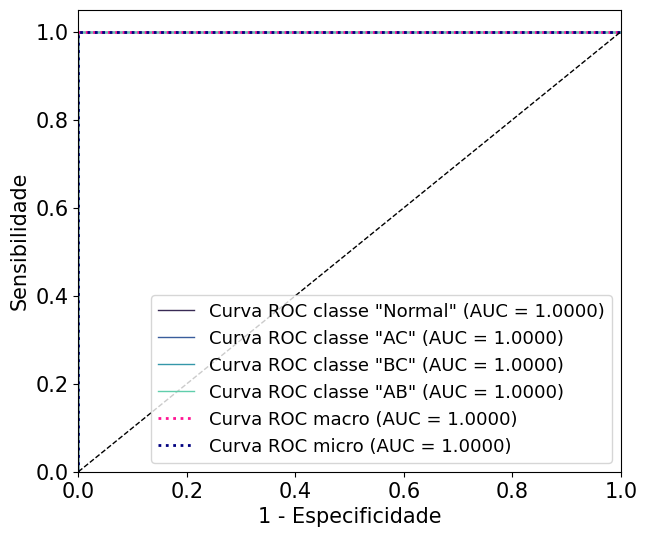

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

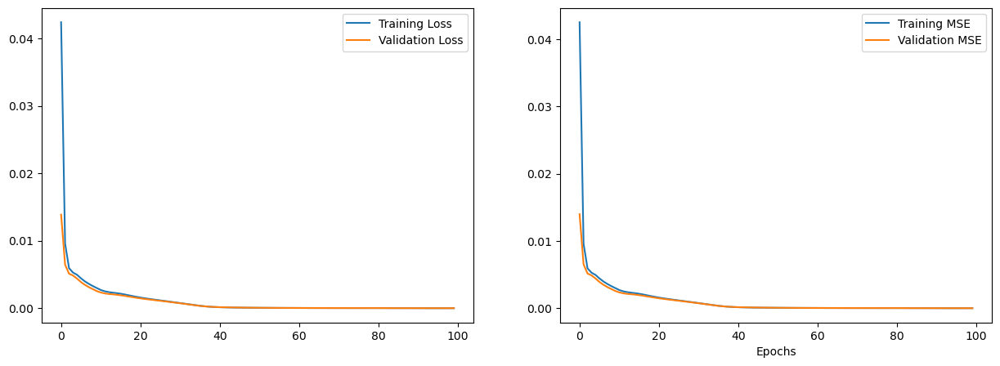

Tempo de execução Busca em grade: 0.25 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 4, 'random_state': 42}
Best AUC ROC: 0.9981396142686465
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


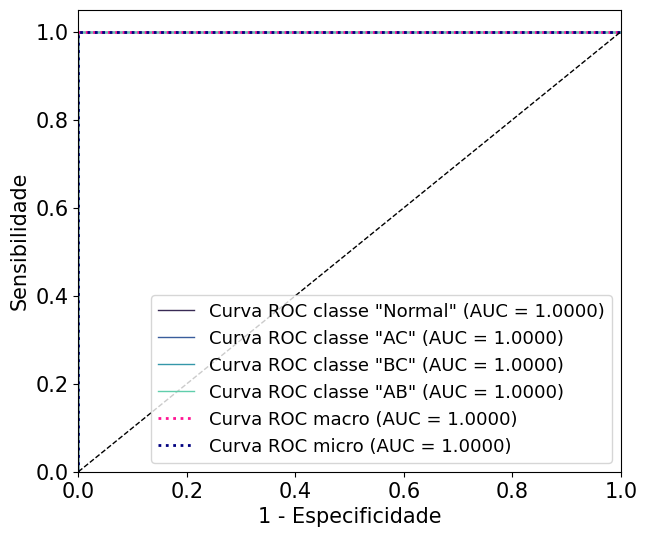

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

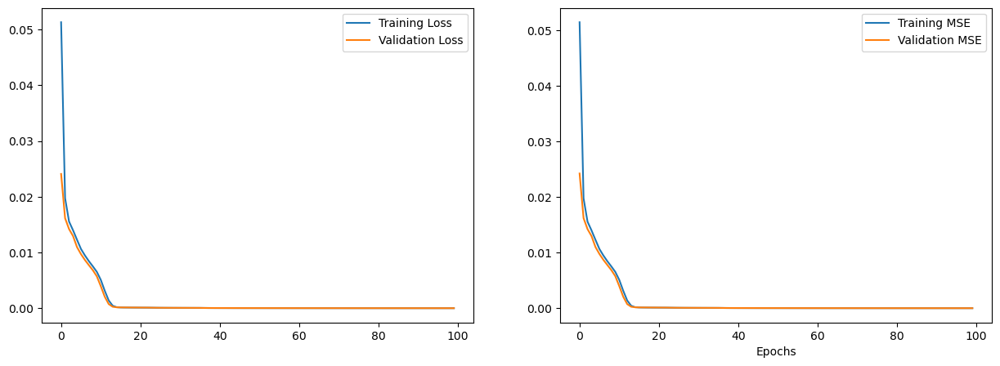

Tempo de execução Busca em grade: 0.26 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


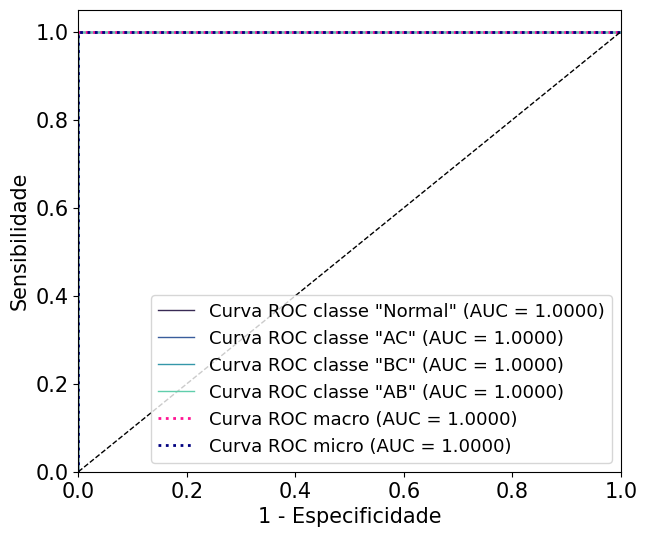

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

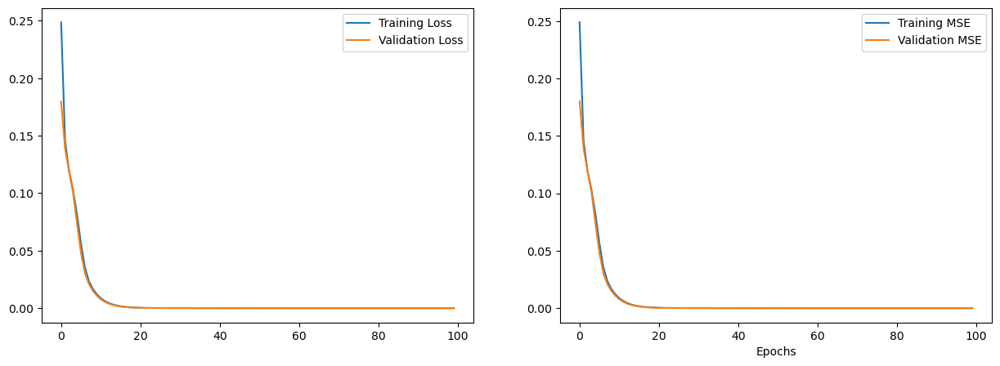

Tempo de execução Busca em grade: 0.25 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


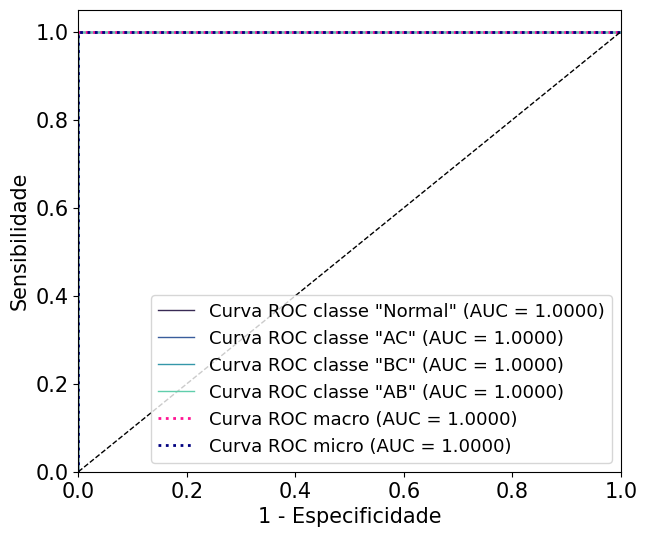

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

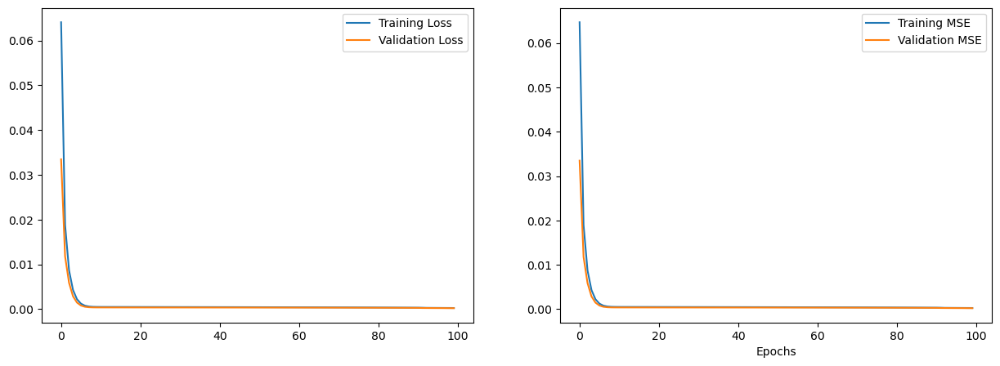

Tempo de execução Busca em grade: 0.24 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 0.9919610855094726
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


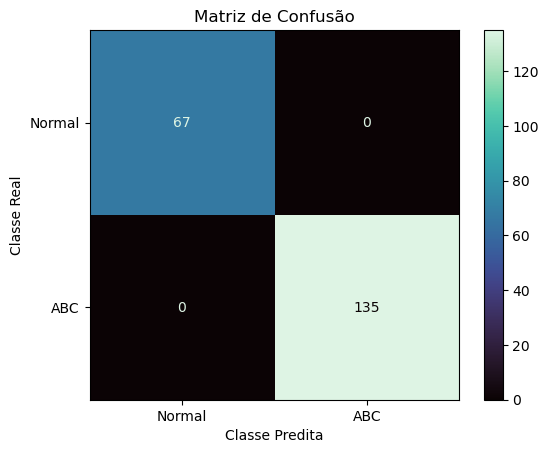

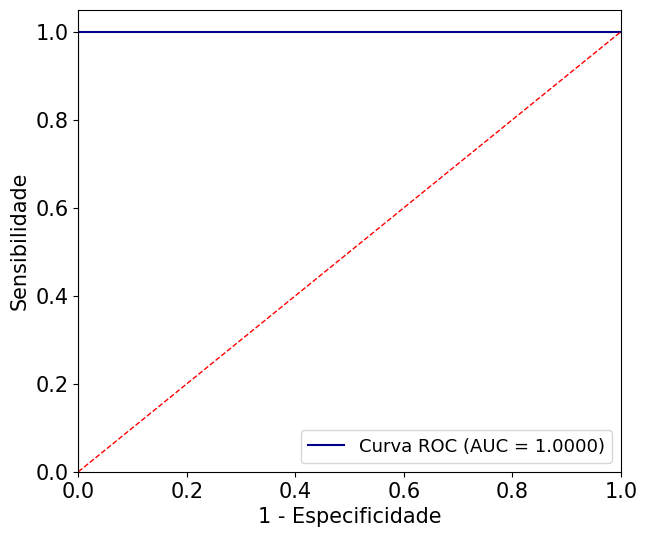

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

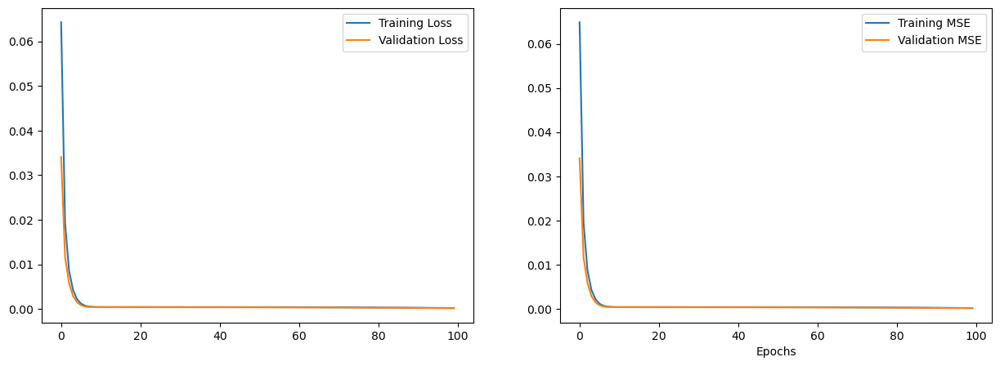

Tempo de execução Busca em grade: 0.23 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 3, 'random_state': 42}
Best AUC ROC: 0.9919858870967742
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 0.9852
Precisão = 1.0000
Sensibilidade = 0.9778
Especificidade = 1.0000
F-score = 0.9888
Coeficiente de Correlação de Matthews = 0.9677
AUC = 0.9889
############################################################


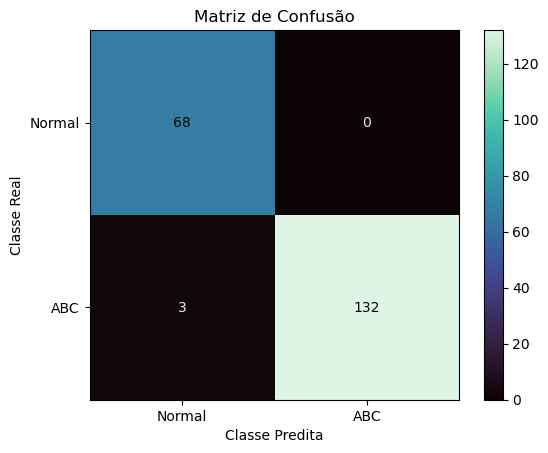

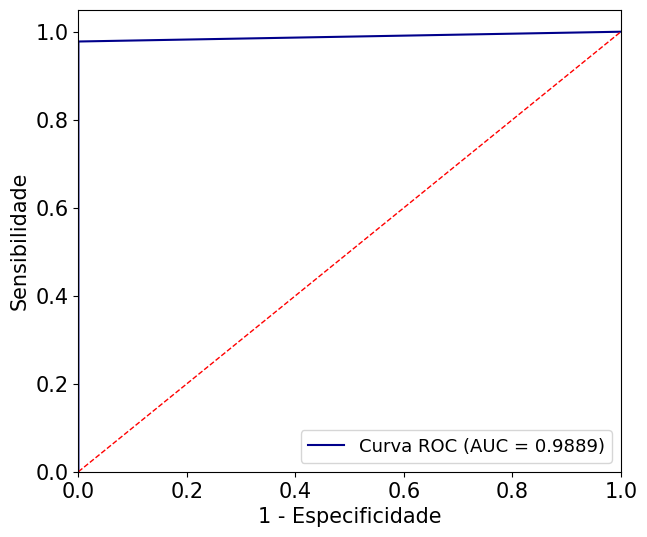

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

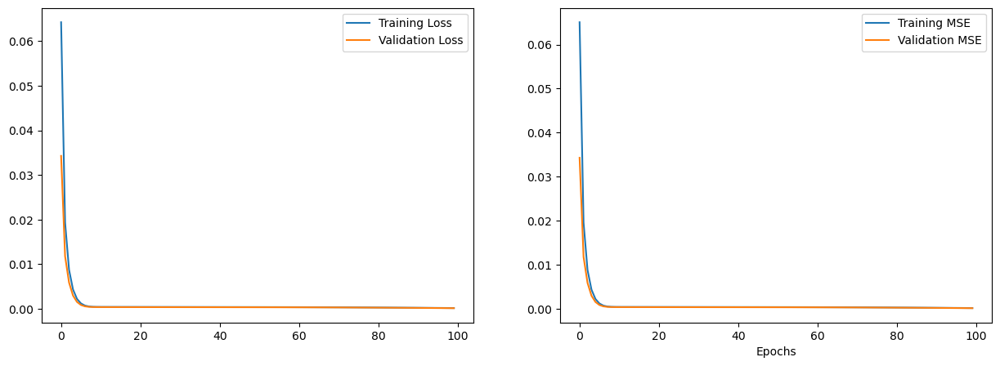

Tempo de execução Busca em grade: 0.25 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0000 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


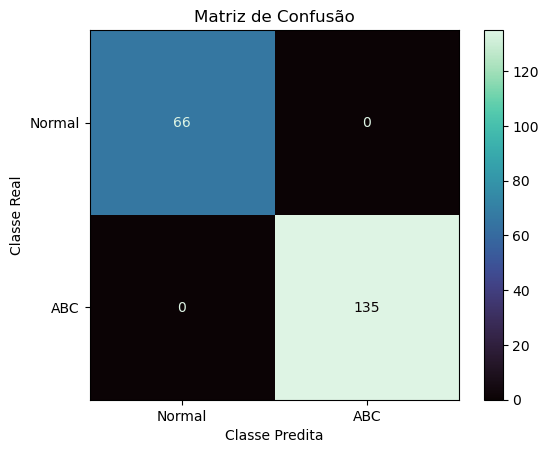

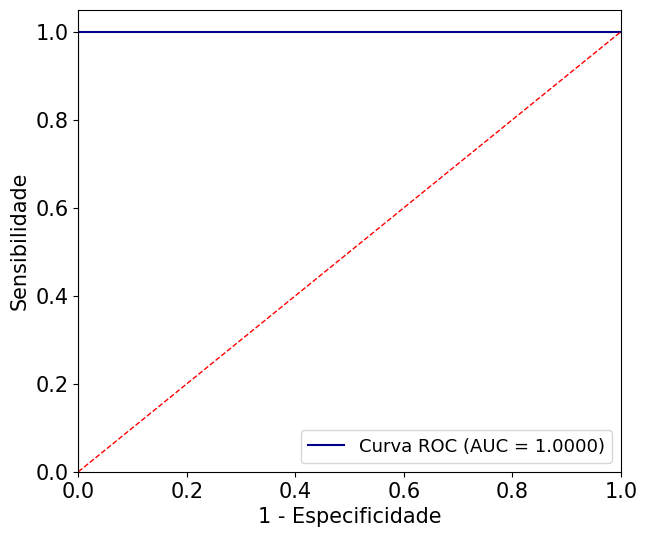

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.DecisionTreeClassifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

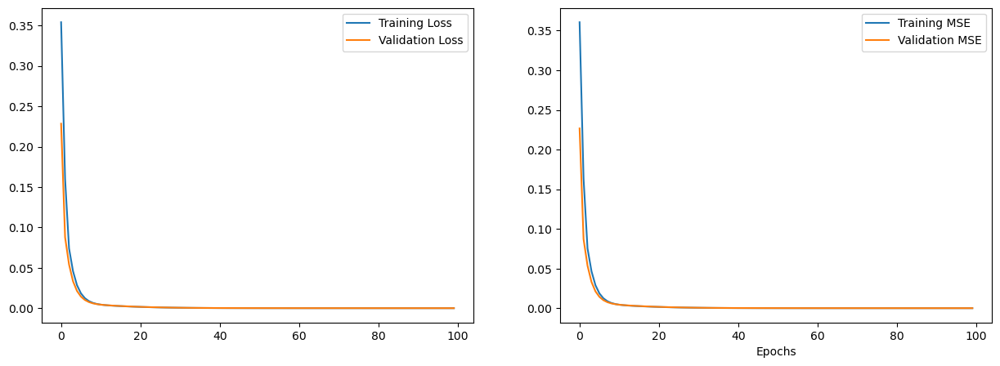

Tempo de execução Busca em grade: 0.24 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


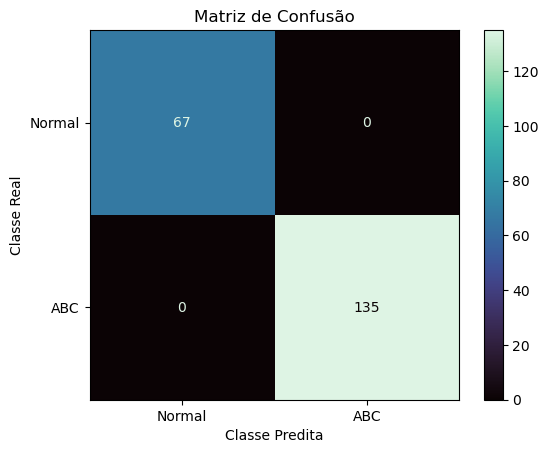

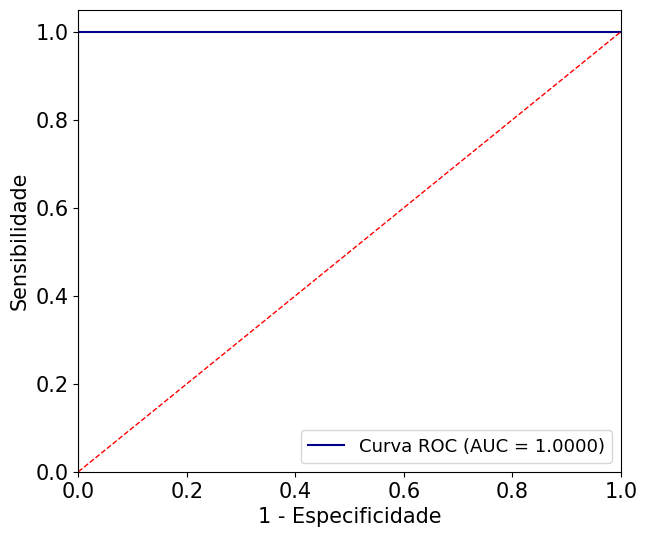

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9984258780541394
ROC AUC média (micro) de todas as iterações: 0.998639614028033
Acurácia média de todas as iterações: 0.9940868249663289
Recall médio (macro) de todas as iterações: 0.9934623258333989
Recall médio (micro) de todas as iterações: 0.9934665002080733
Especificidade média (macro) de todas as iterações: 0.9984395005141217
Especificidade média (micro) de todas as iterações: 0.9984394506866417
 
############################################################
Tempo de execução Total: 96.6851 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [DecisionTreeClassifier]
param_grid_dt = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 1, 2, 3, 4, 5, 10, 20, 30, 40],
    'random_state': [42]
}
param_grids = [param_grid_dt]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### ET

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

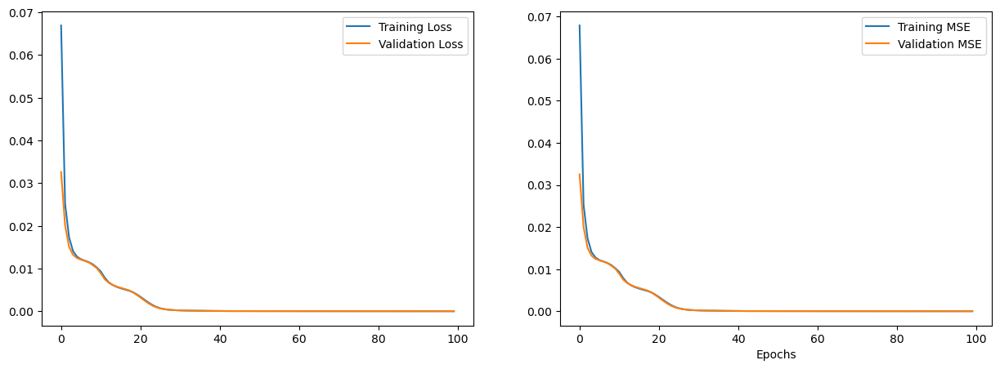

Tempo de execução Busca em grade: 1.85 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


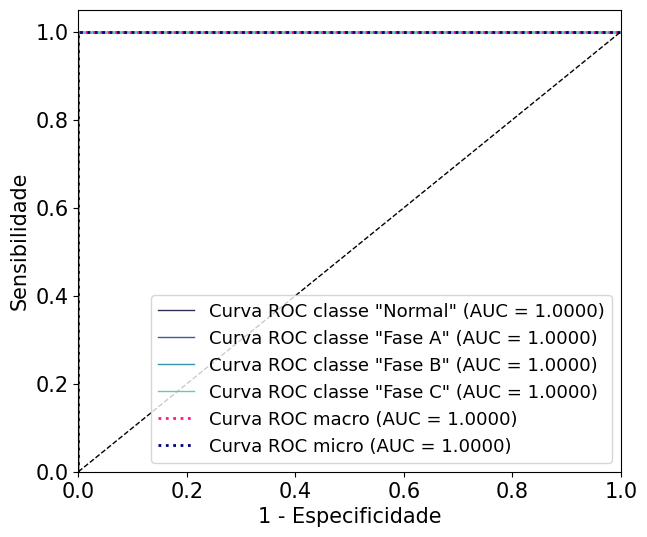

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

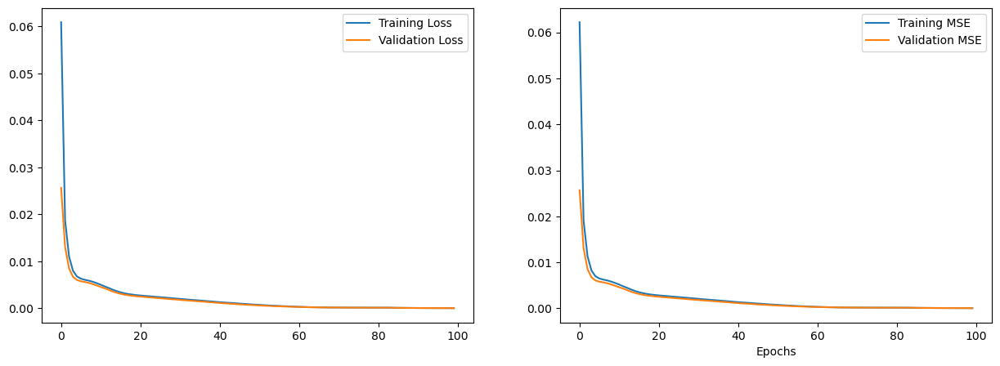

Tempo de execução Busca em grade: 0.41 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 5, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9941764040640535
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.00374532%
Sensitivity (Recall) Macro:0.9693
Sensitivity (Recall) Micro: 0.9700
Especificidade (specificity) macro: 0.9900
Especificidade (specificity) micro: 0.9900
AUC: 0.9981
Matriz de Confusão
[[58  7  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 0.8923, Specificity = 0.9950, F-score = 0.9409
Class 1: Sensitivity = 1.0000, Specificity = 0.9648, F-score = 0.9821
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9789


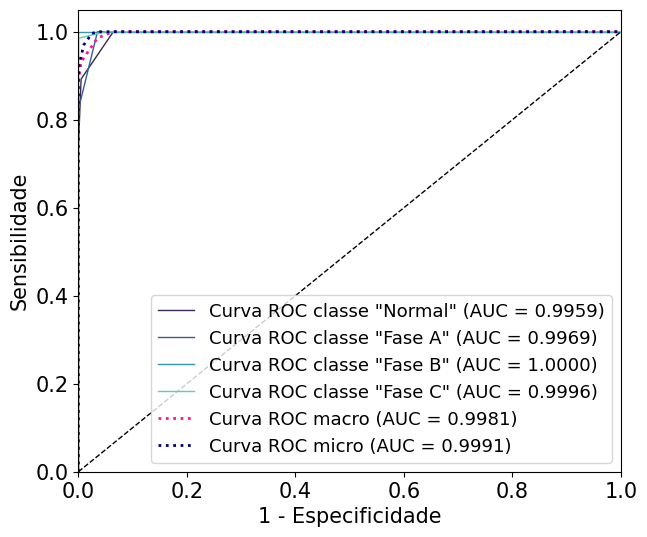

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

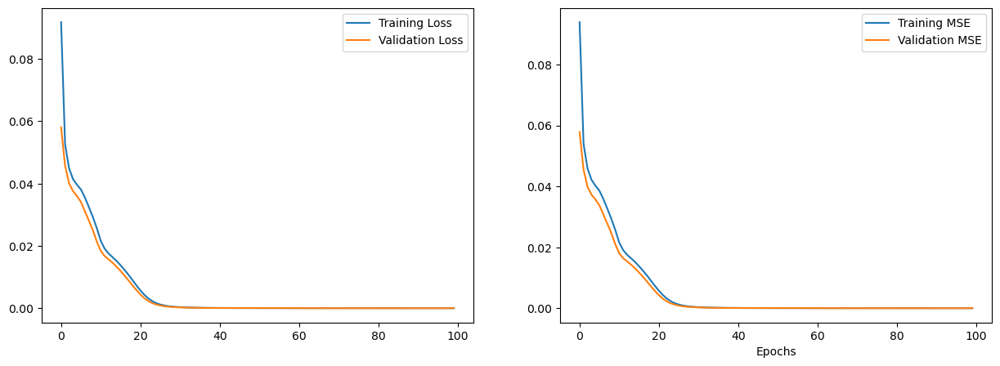

Tempo de execução Busca em grade: 0.42 segundos
Best parameters found: {'criterion': 'entropy', 'splitter': 'best', 'max_depth': 4, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9904133589549732
Tempo de Treinamento: 0.0013 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9910
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


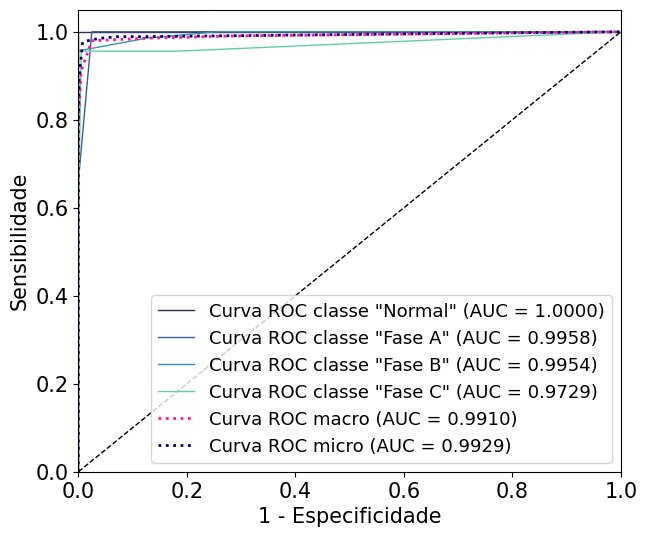

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

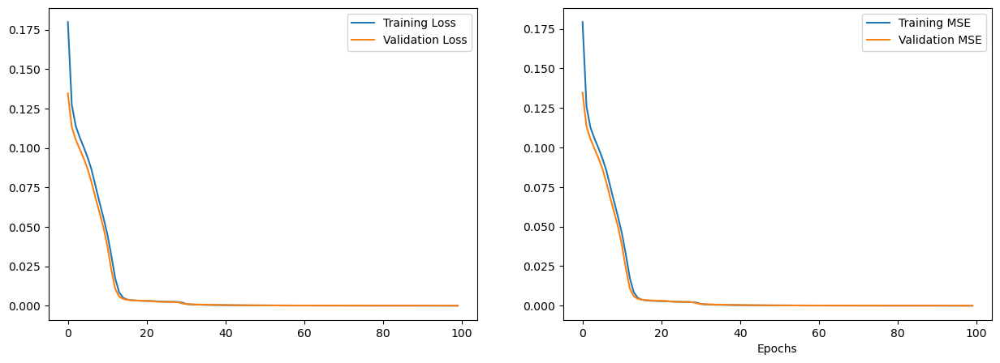

Tempo de execução Busca em grade: 0.45 segundos
Best parameters found: {'criterion': 'entropy', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


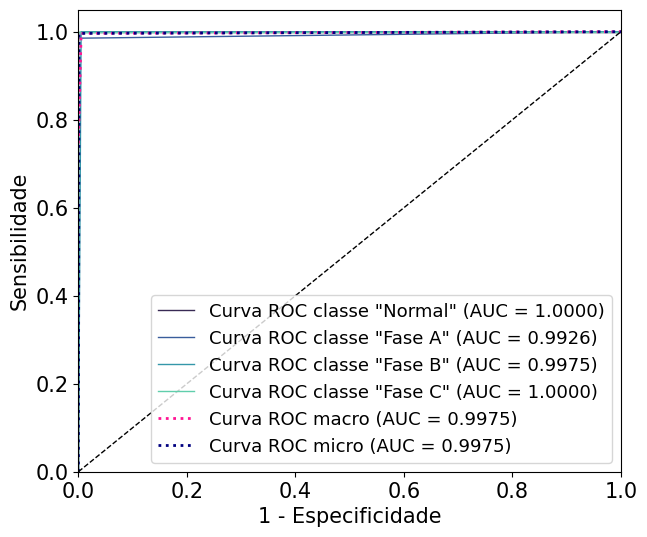

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

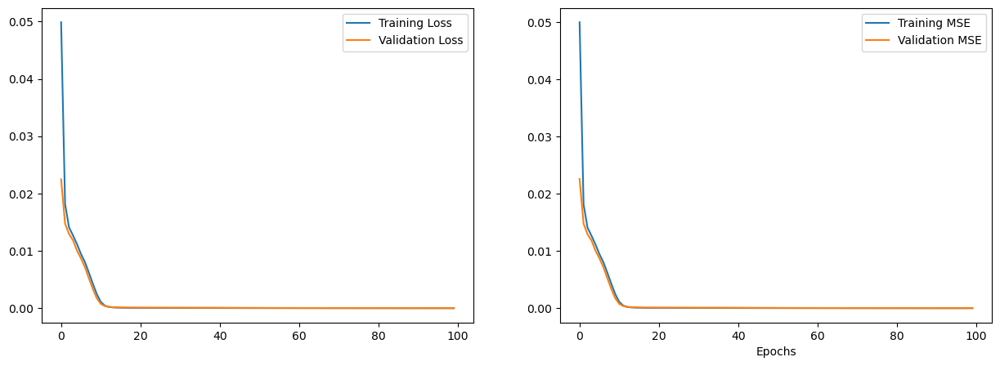

Tempo de execução Busca em grade: 0.44 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


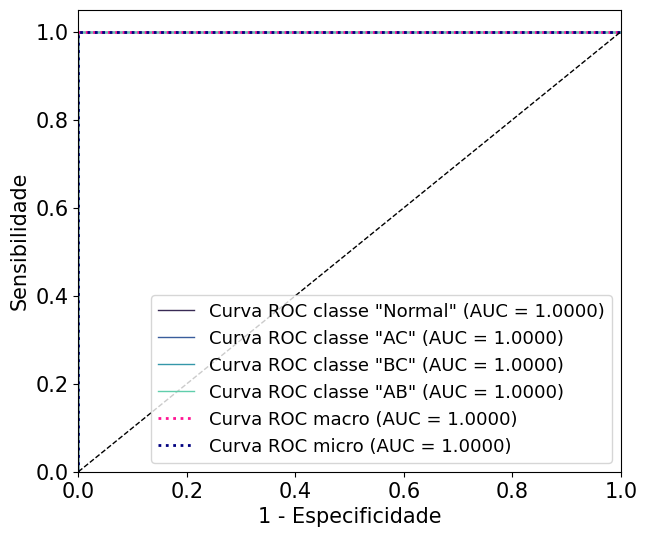

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

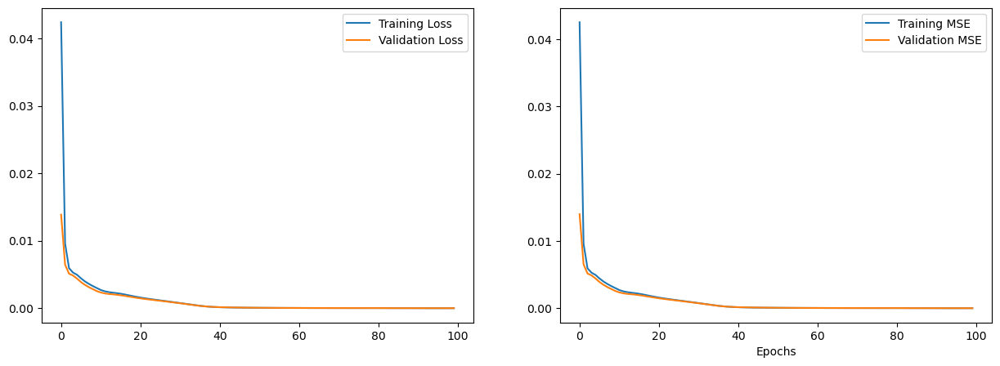

Tempo de execução Busca em grade: 0.44 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 4, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9981344939409456
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


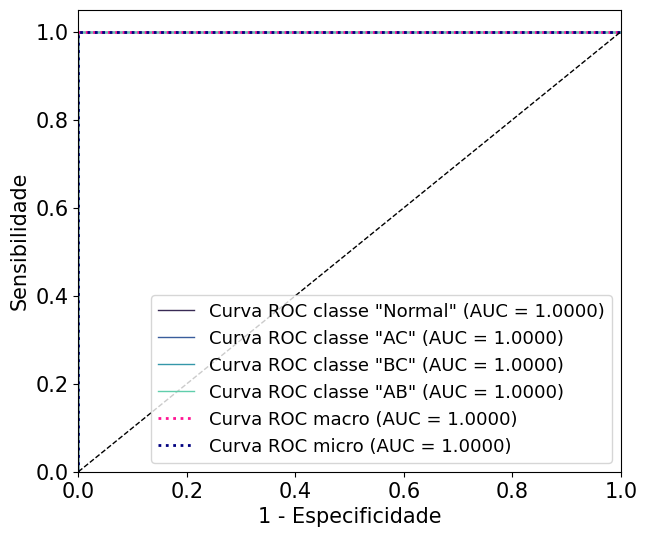

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

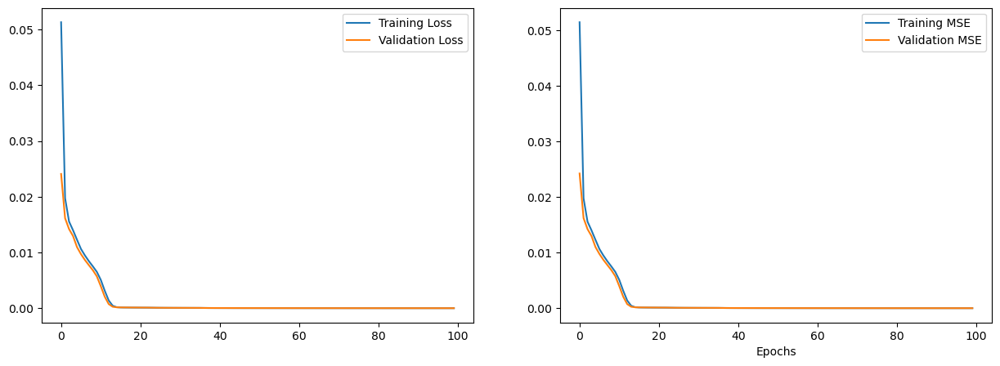

Tempo de execução Busca em grade: 0.44 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


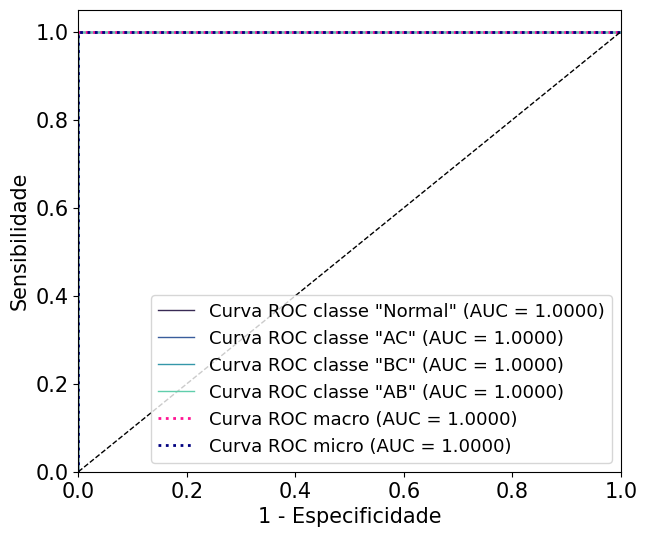

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

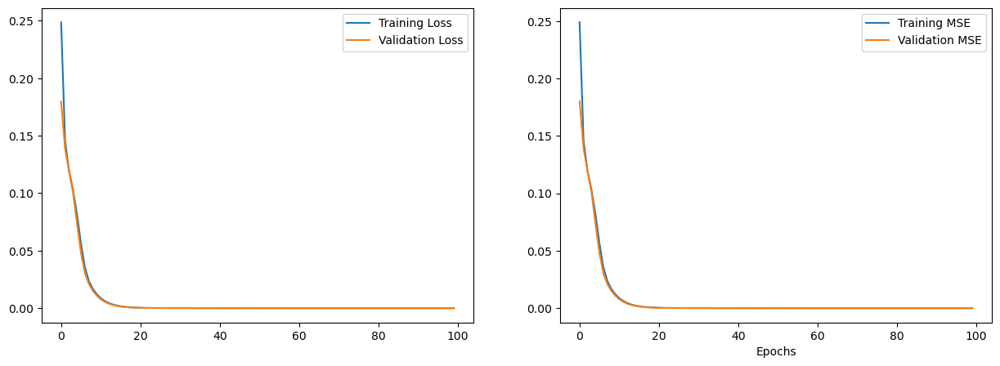

Tempo de execução Busca em grade: 0.45 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


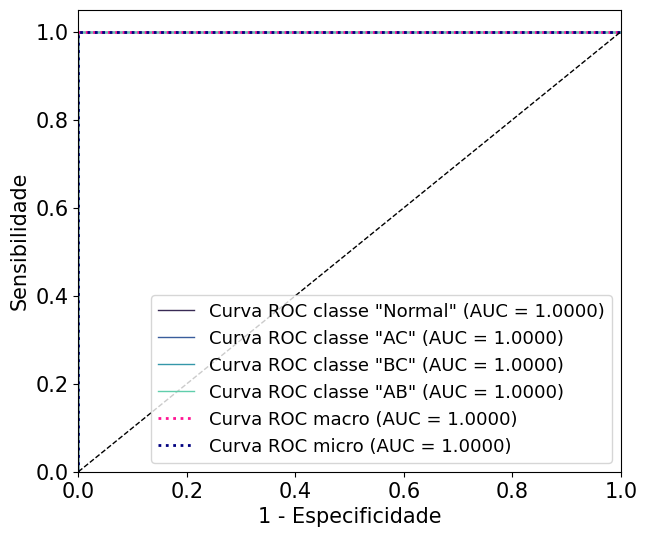

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

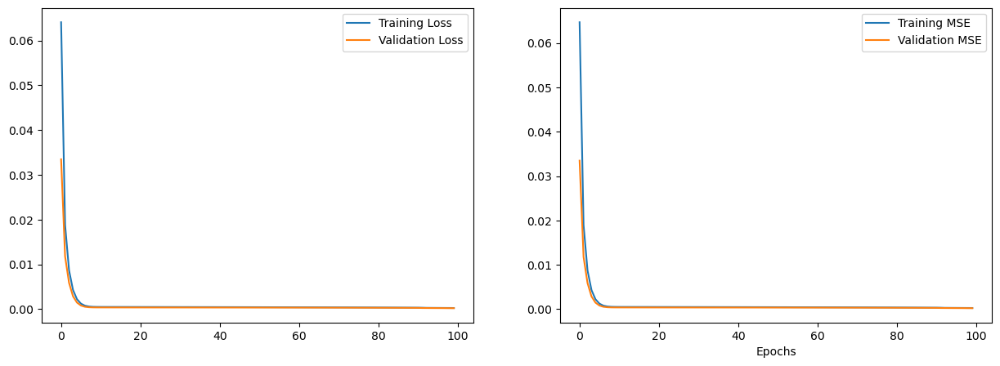

Tempo de execução Busca em grade: 0.37 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 3, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9935483870967742
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


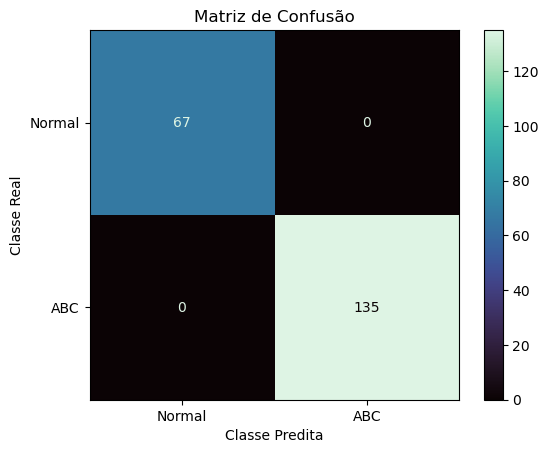

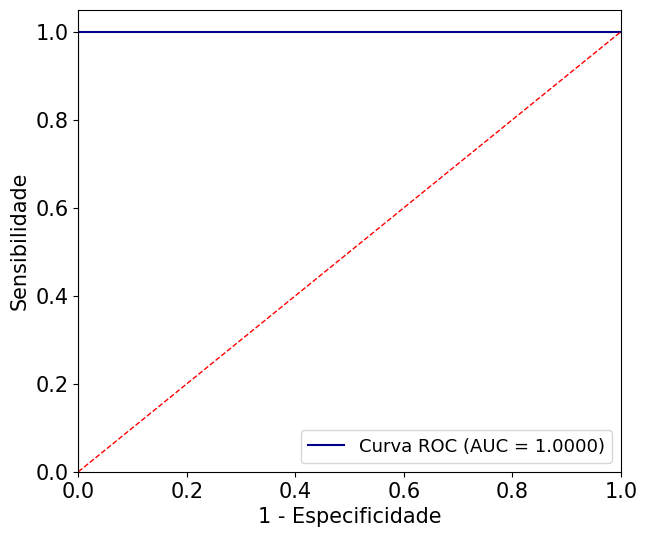

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

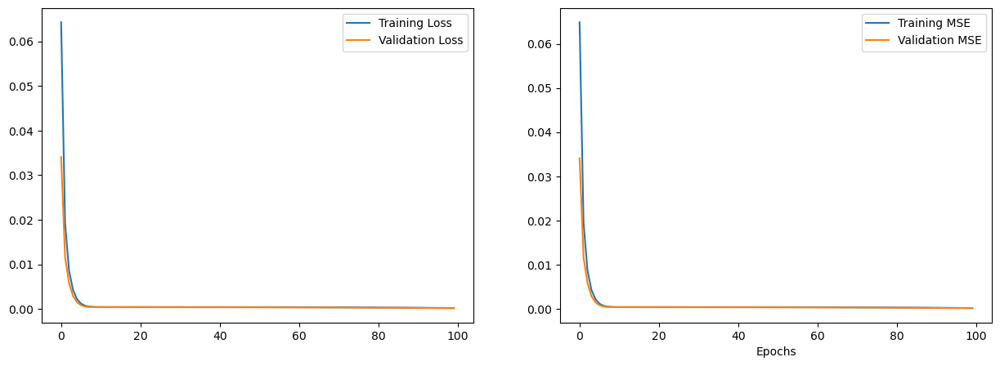

Tempo de execução Busca em grade: 0.36 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': 3, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 0.9950924859190989
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


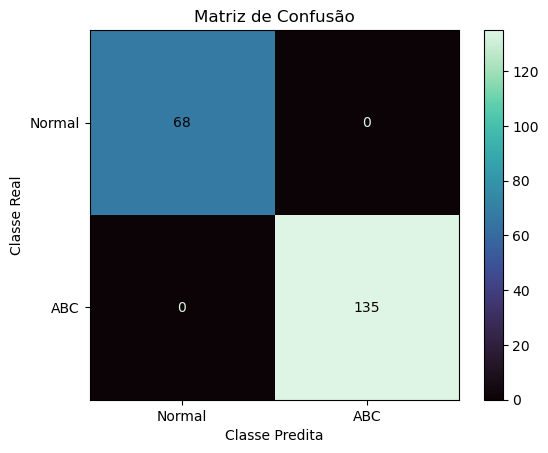

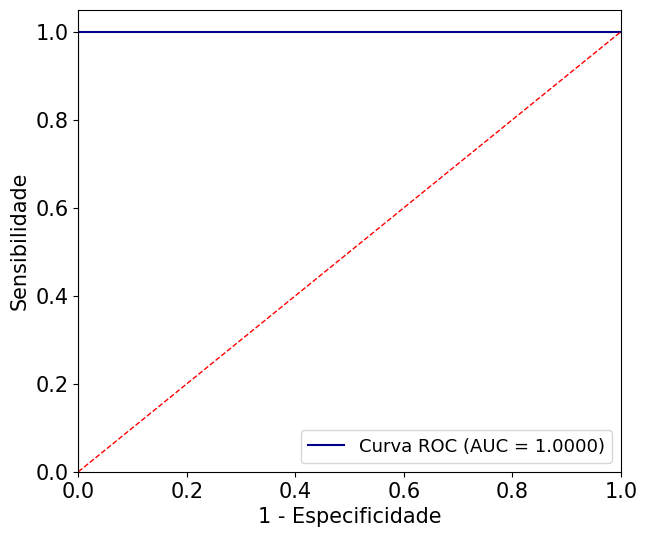

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

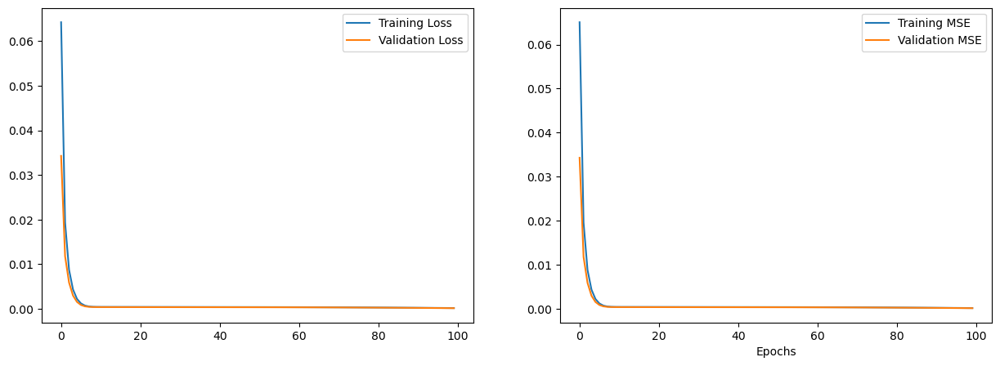

Tempo de execução Busca em grade: 0.38 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


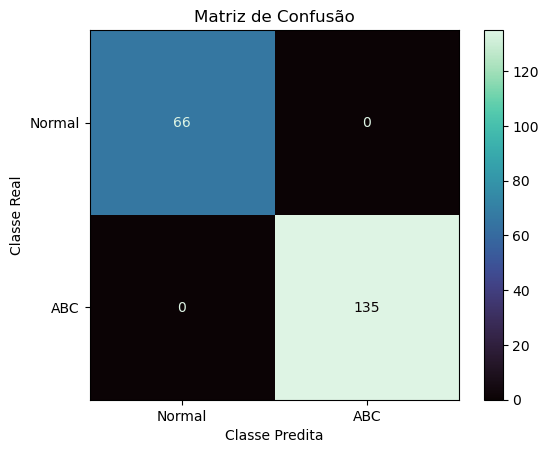

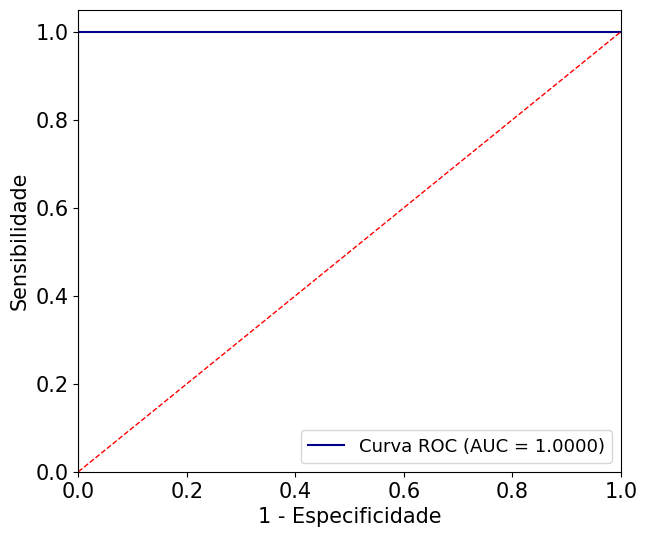

 
 
 
________________________________________
Model: <class 'sklearn.tree._classes.ExtraTreeClassifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

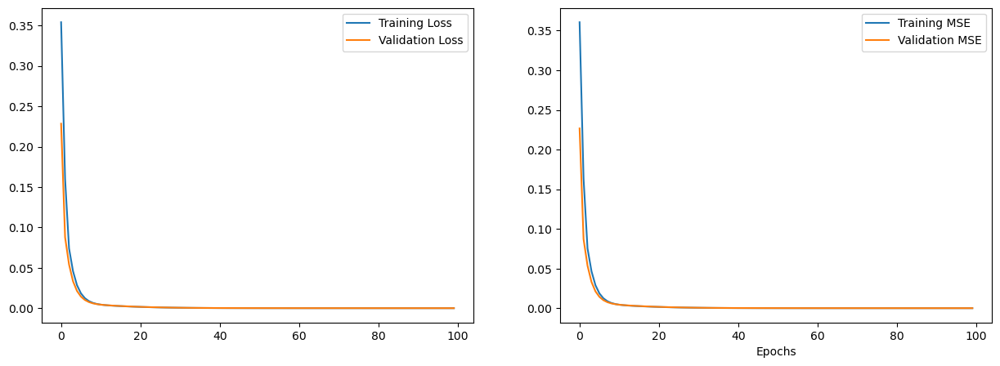

Tempo de execução Busca em grade: 0.36 segundos
Best parameters found: {'criterion': 'gini', 'splitter': 'best', 'max_depth': None, 'max_features': 'sqrt', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0010 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


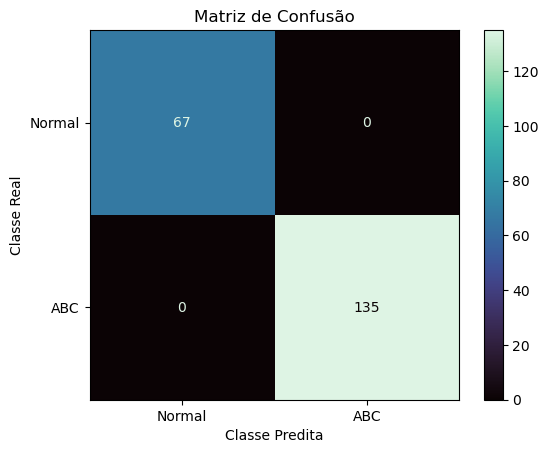

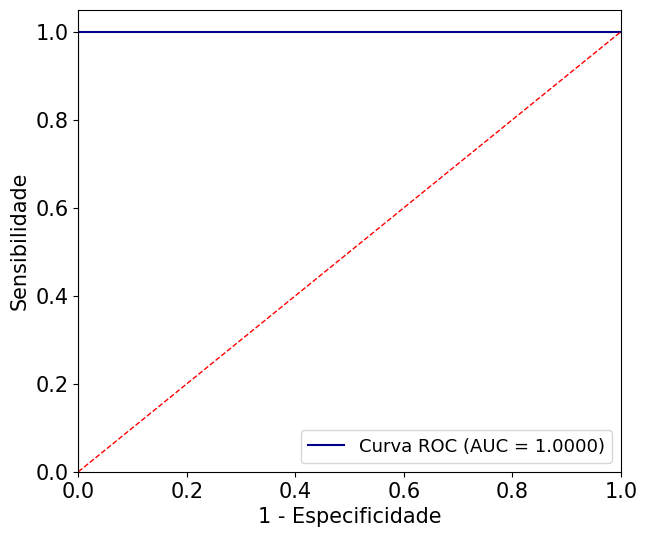

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9988881764051758
ROC AUC média (micro) de todas as iterações: 0.9991281575309264
Acurácia média de todas as iterações: 0.995318352059925
Recall médio (macro) de todas as iterações: 0.9953141776852507
Recall médio (micro) de todas as iterações: 0.995318352059925
Especificidade média (macro) de todas as iterações: 0.9984395005141217
Especificidade média (micro) de todas as iterações: 0.9984394506866417
 
############################################################
Tempo de execução Total: 98.4742 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [ExtraTreeClassifier]
param_grid_et = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 1, 2, 3, 4, 5, 10, 20, 30, 40],
    'max_features': ['sqrt', 'log2'],
    'random_state': [42]
}
param_grids = [param_grid_et]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### RL

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

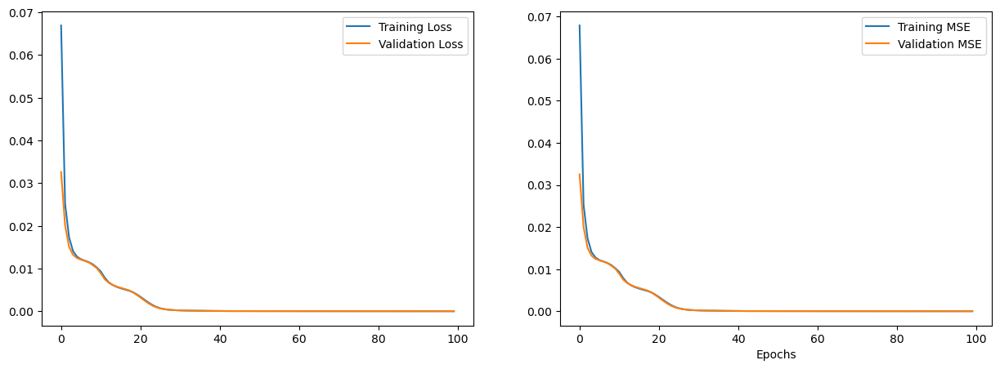

Tempo de execução Busca em grade: 1.01 segundos
Best parameters found: {'C': 1.0}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0100 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


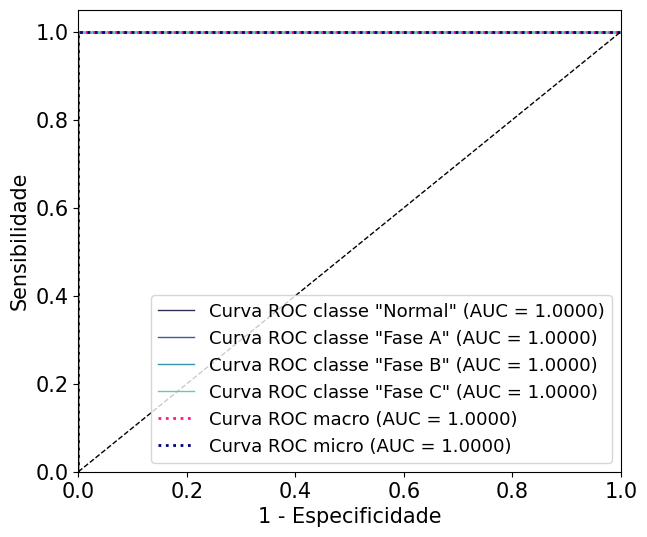

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

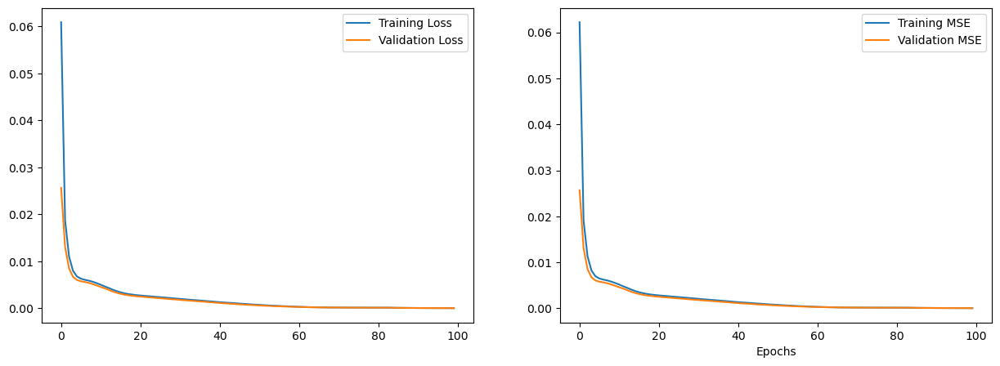

Tempo de execução Busca em grade: 0.48 segundos
Best parameters found: {'C': 1000.0}
Best AUC ROC: 0.9829265485894323
Tempo de Treinamento: 0.0141 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 93.25842697%
Sensitivity (Recall) Macro:0.9335
Sensitivity (Recall) Micro: 0.9326
Especificidade (specificity) macro: 0.9777
Especificidade (specificity) micro: 0.9775
AUC: 0.9797
Matriz de Confusão
[[64  1  0  0]
 [14 54  0  0]
 [ 0  0 67  0]
 [ 3  0  0 64]]
Class 0: Sensitivity = 0.9846, Specificity = 0.9158, F-score = 0.9490
Class 1: Sensitivity = 0.7941, Specificity = 0.9950, F-score = 0.8833
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9552, Specificity = 1.0000, F-score = 0.9771
Macro F-score: 0.9523


D:\Anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


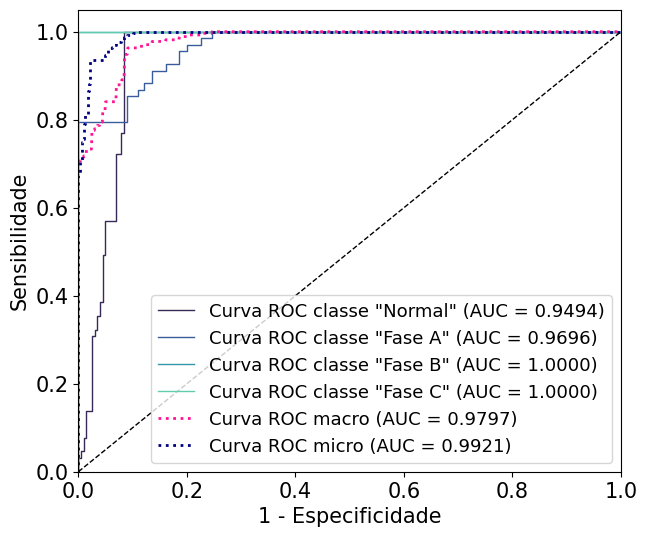

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

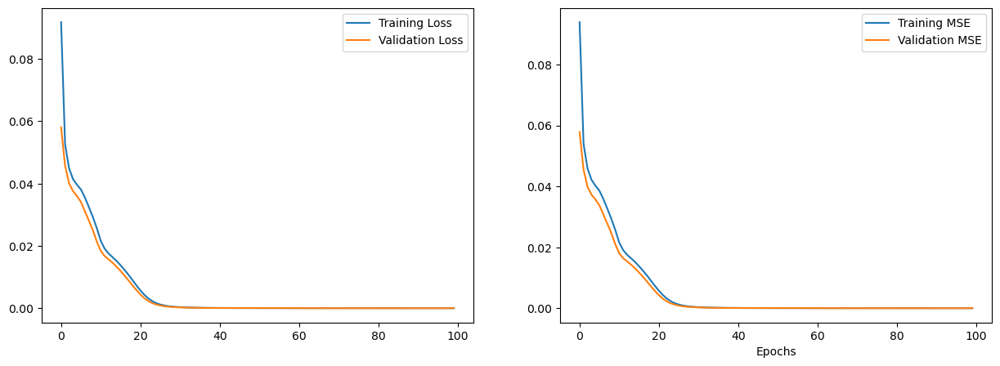

Tempo de execução Busca em grade: 0.42 segundos
Best parameters found: {'C': 0.1}
Best AUC ROC: 0.9887557460129062
Tempo de Treinamento: 0.0050 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 97.75280899%
Sensitivity (Recall) Macro:0.9781
Sensitivity (Recall) Micro: 0.9775
Especificidade (specificity) macro: 0.9926
Especificidade (specificity) micro: 0.9925
AUC: 0.9865
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 1.0000, F-score = 0.9778
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9851


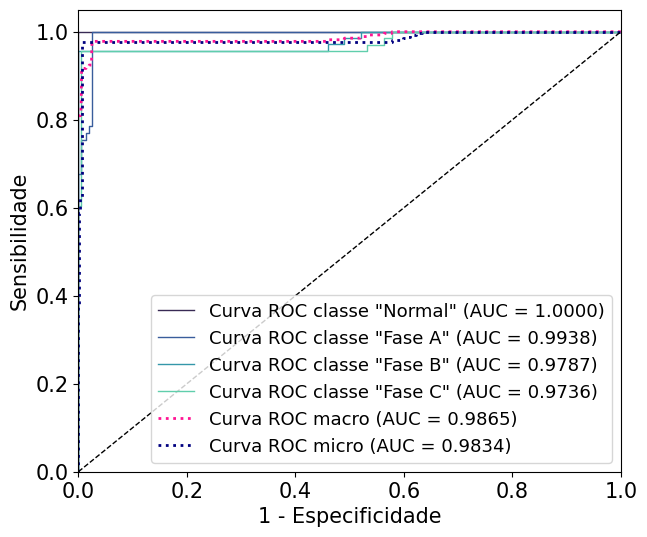

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

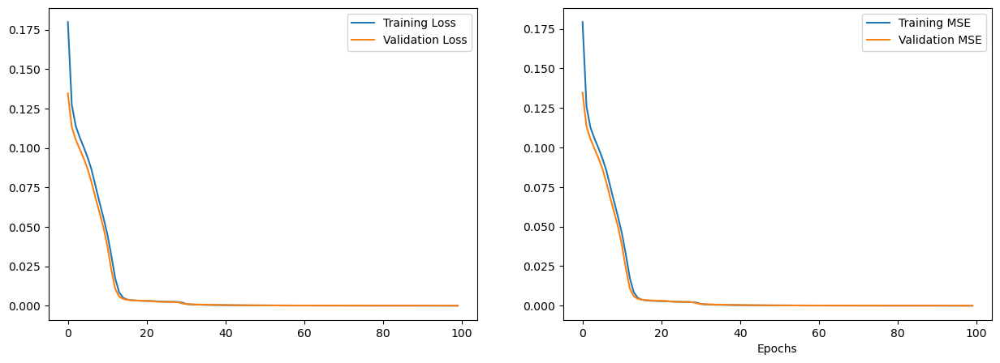

Tempo de execução Busca em grade: 0.34 segundos
Best parameters found: {'C': 0.01}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0030 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 91.38576779%
Sensitivity (Recall) Macro:0.9117
Sensitivity (Recall) Micro: 0.9139
Especificidade (specificity) macro: 0.9711
Especificidade (specificity) micro: 0.9713
AUC: 0.9954
Matriz de Confusão
[[43 22  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 0.6615, Specificity = 1.0000, F-score = 0.7963
Class 1: Sensitivity = 0.9853, Specificity = 0.8894, F-score = 0.9349
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9322


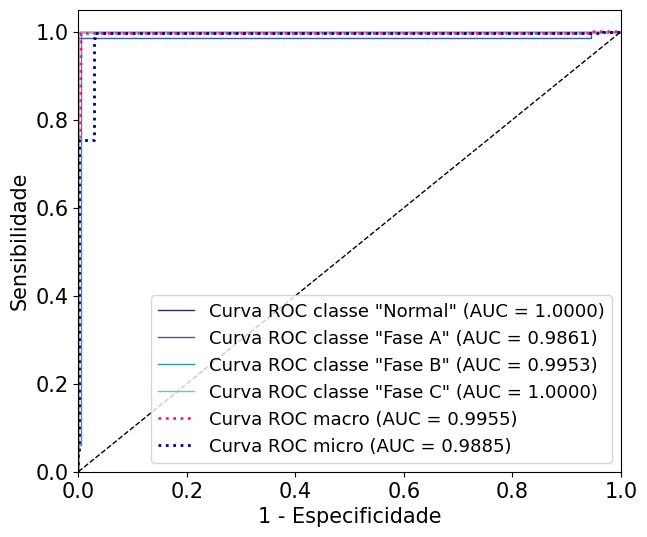

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

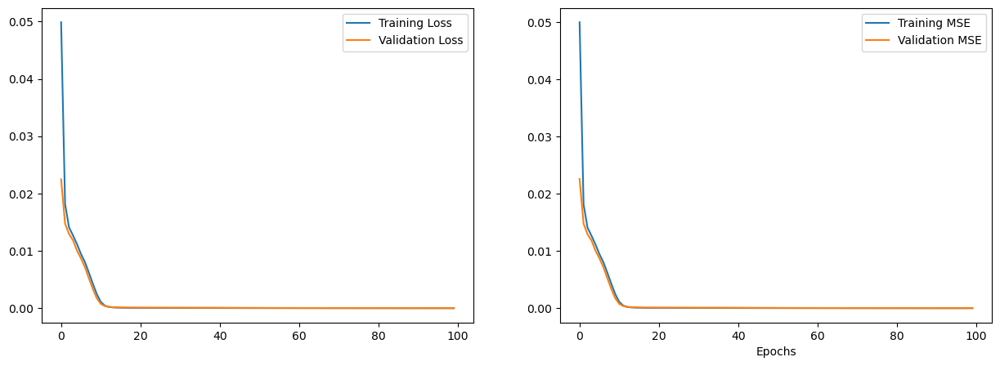

Tempo de execução Busca em grade: 0.11 segundos
Best parameters found: {'C': 1.0}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0060 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 92.52136752%
Sensitivity (Recall) Macro:0.8654
Sensitivity (Recall) Micro: 0.9252
Especificidade (specificity) macro: 0.9738
Especificidade (specificity) micro: 0.9751
AUC: 1.0000
Matriz de Confusão
[[ 30  17   0  18]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 0.4615, Specificity = 1.0000, F-score = 0.6316
Class 1: Sensitivity = 1.0000, Specificity = 0.9491, F-score = 0.9739
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.9459, F-score = 0.9722
Macro F-score: 0.8944


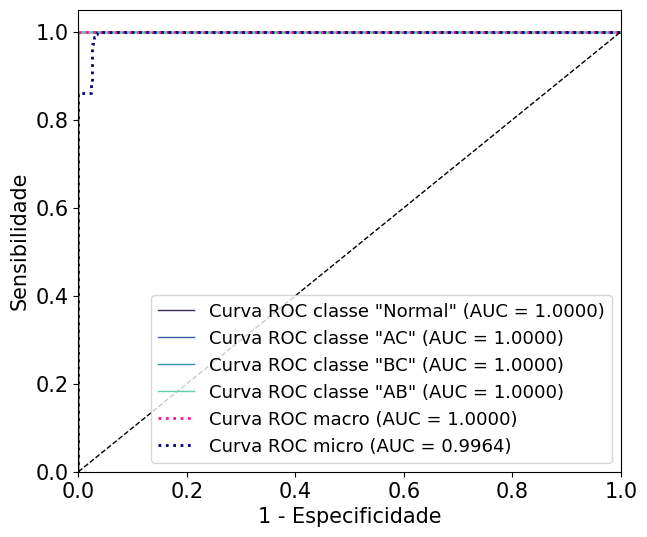

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

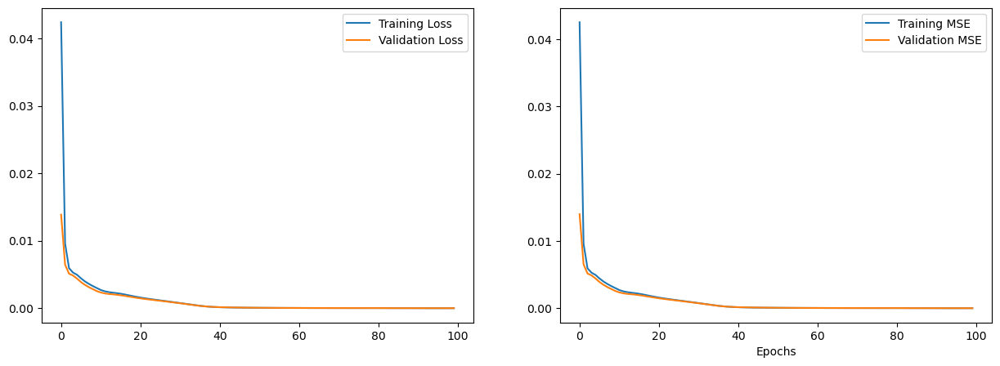

Tempo de execução Busca em grade: 0.14 segundos
Best parameters found: {'C': 1000.0}
Best AUC ROC: 0.9999479433350402
Tempo de Treinamento: 0.0160 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 99.35897436%
Sensitivity (Recall) Macro:0.9944
Sensitivity (Recall) Micro: 0.9936
Especificidade (specificity) macro: 0.9978
Especificidade (specificity) micro: 0.9979
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 131   3]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 0.9776, Specificity = 1.0000, F-score = 0.9887
Class 3: Sensitivity = 1.0000, Specificity = 0.9910, F-score = 0.9955
Macro F-score: 0.9960


D:\Anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


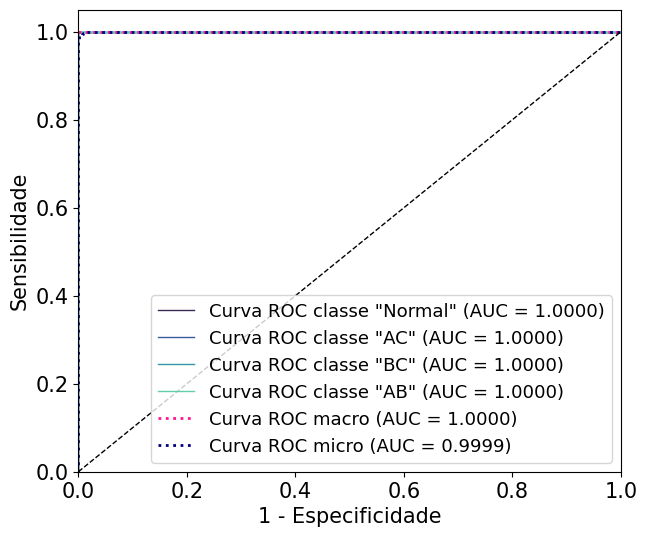

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

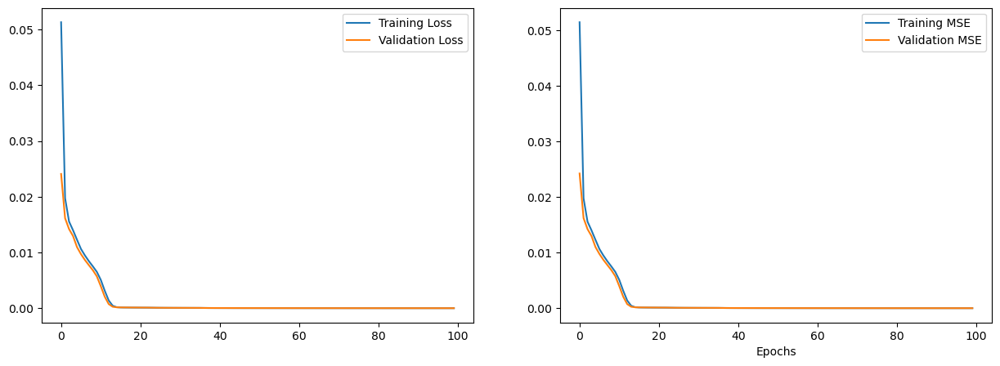

Tempo de execução Busca em grade: 0.14 segundos
Best parameters found: {'C': 0.1}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0030 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 86.11111111%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8611
Especificidade (specificity) macro: 0.9513
Especificidade (specificity) micro: 0.9537
AUC: 1.0000
Matriz de Confusão
[[  0  38   0  27]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.8859, F-score = 0.9395
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.9192, F-score = 0.9579
Macro F-score: 0.7243


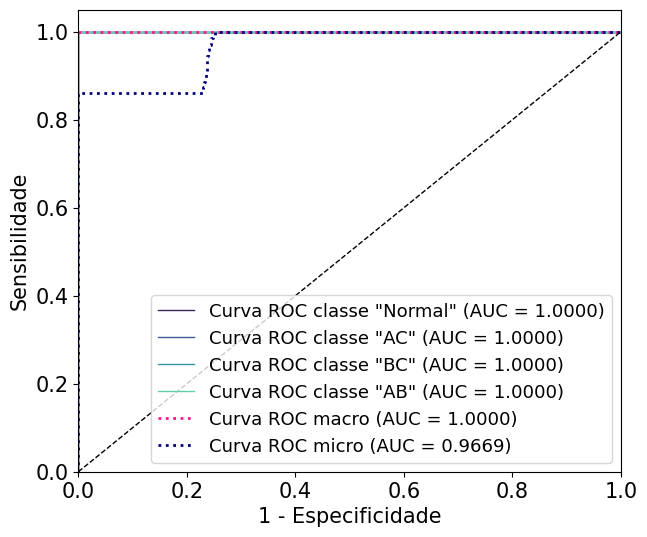

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

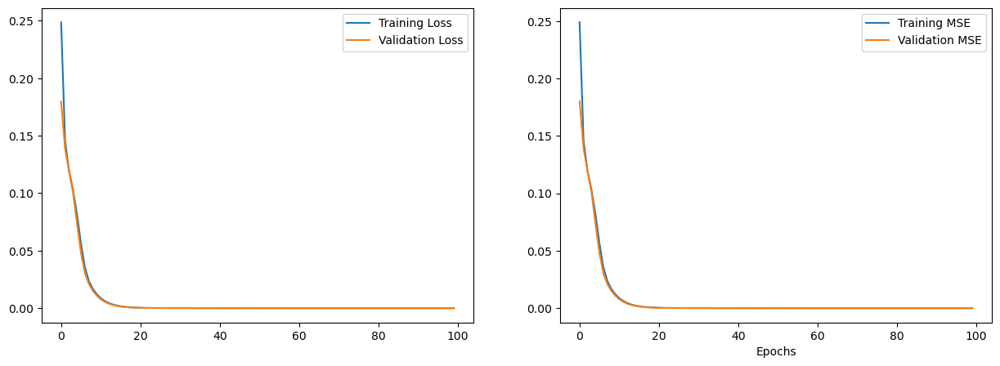

Tempo de execução Busca em grade: 0.12 segundos
Best parameters found: {'C': 0.01}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0040 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia: 86.17021277%
Sensitivity (Recall) Macro:0.7500
Sensitivity (Recall) Micro: 0.8617
Especificidade (specificity) macro: 0.9515
Especificidade (specificity) micro: 0.9539
AUC: 1.0000
Matriz de Confusão
[[  0  13   0  52]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 0.0000, Specificity = 1.0000, F-score = 0.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9611, F-score = 0.9802
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 0.8448, F-score = 0.9159
Macro F-score: 0.7240


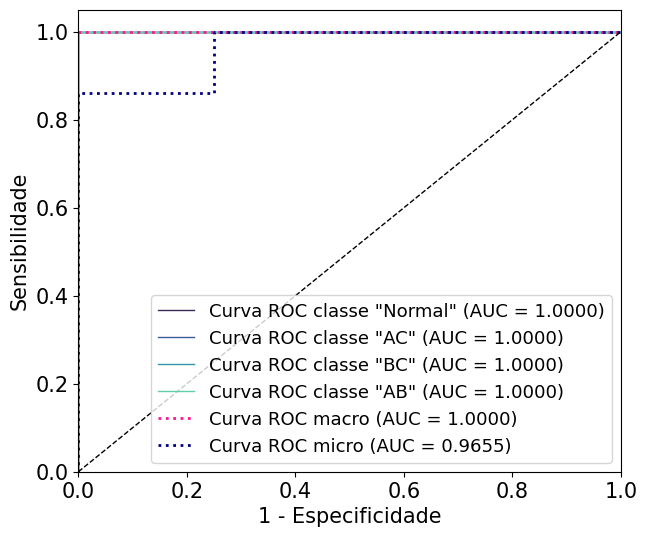

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

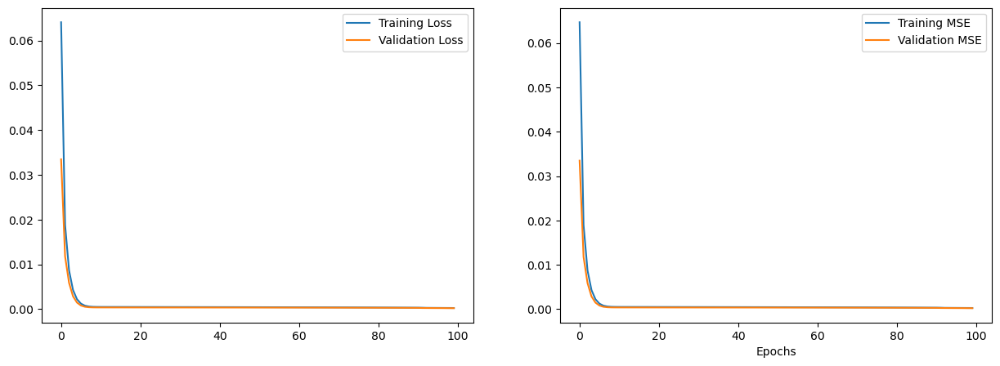

Tempo de execução Busca em grade: 0.05 segundos
Best parameters found: {'C': 0.001}
Best AUC ROC: 0.8021665386584742
Tempo de Treinamento: 0.0020 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.6683
Precisão = 0.6683
Sensibilidade = 1.0000
Especificidade = 0.0000
F-score = 0.8012
Coeficiente de Correlação de Matthews = 0.0000
AUC = 0.8286
############################################################


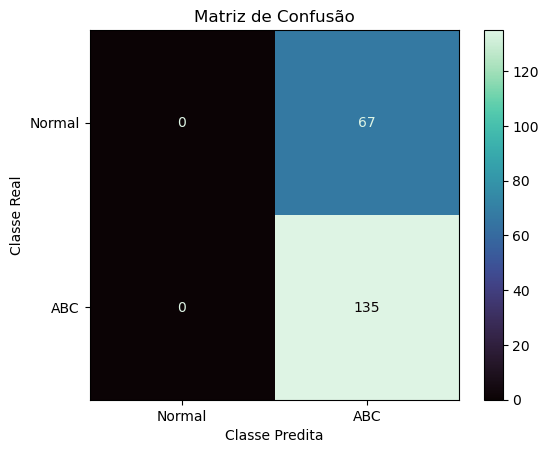

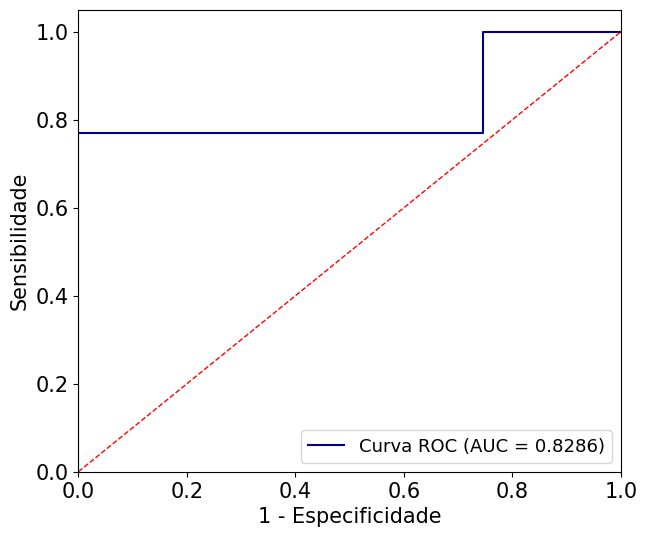

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

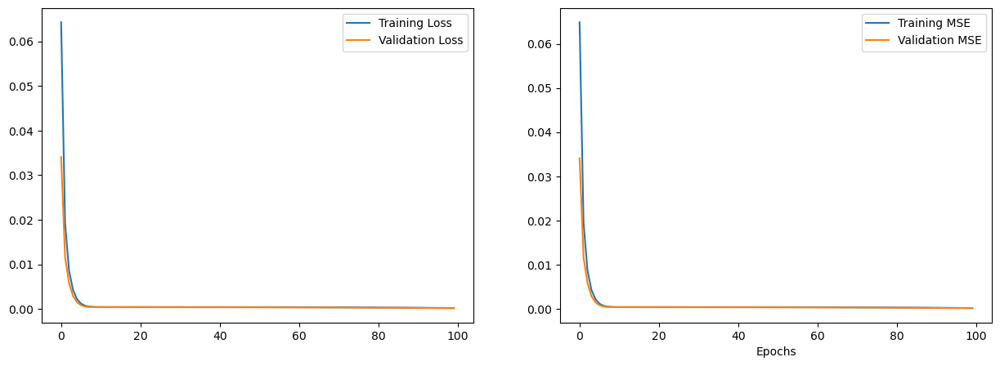

Tempo de execução Busca em grade: 0.05 segundos
Best parameters found: {'C': 1000.0}
Best AUC ROC: 0.8033682155657964
Tempo de Treinamento: 0.0035 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.6207
Precisão = 0.6959
Sensibilidade = 0.7630
Especificidade = 0.3382
F-score = 0.7279
Coeficiente de Correlação de Matthews = 0.1075
AUC = 0.8187
############################################################


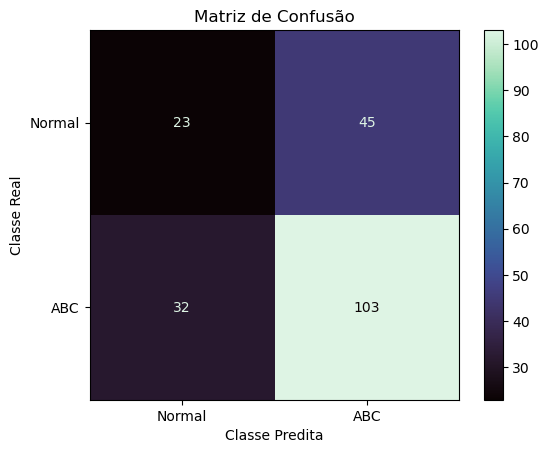

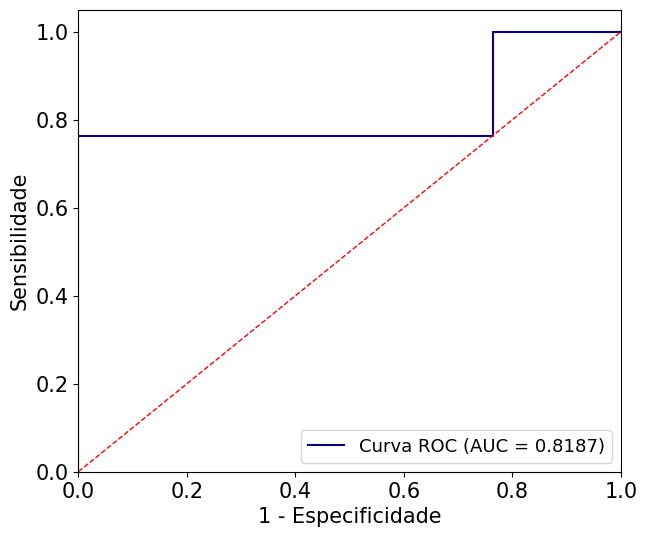

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

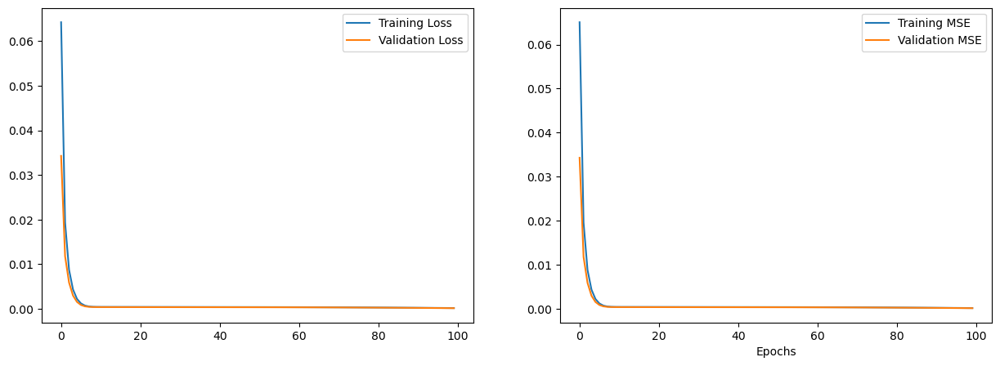

Tempo de execução Busca em grade: 0.04 segundos
Best parameters found: {'C': 1000.0}
Best AUC ROC: 0.8067158878813405
Tempo de Treinamento: 0.0030 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.6219
Precisão = 0.6980
Sensibilidade = 0.7704
Especificidade = 0.3182
F-score = 0.7324
Coeficiente de Correlação de Matthews = 0.0950
AUC = 0.8330
############################################################


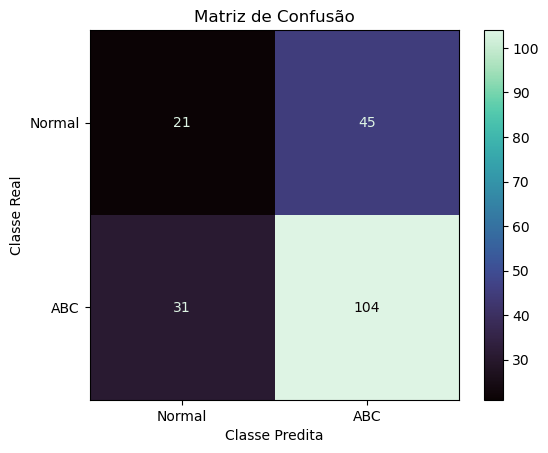

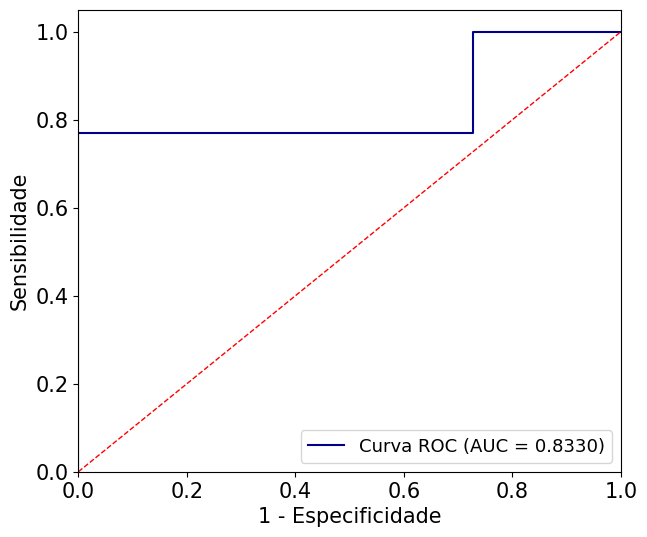

 
 
 
________________________________________
Model: <class 'sklearn.linear_model._logistic.LogisticRegression'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

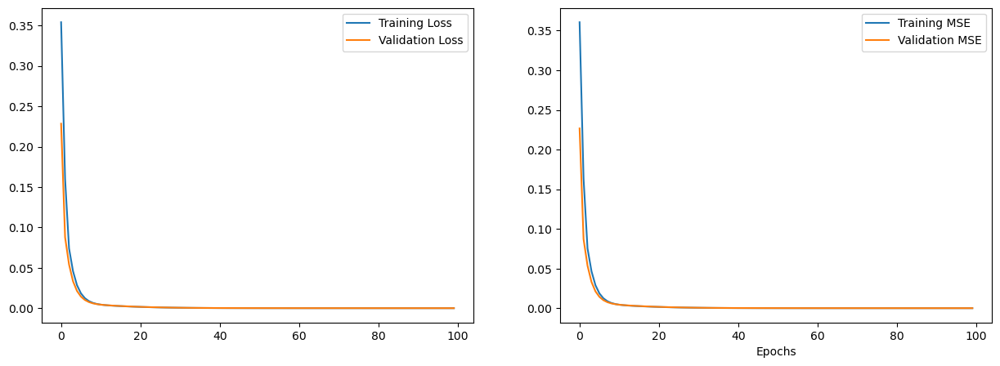

Tempo de execução Busca em grade: 0.05 segundos
Best parameters found: {'C': 0.001}
Best AUC ROC: 0.9583444273766855
Tempo de Treinamento: 0.0021 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.6683
Precisão = 0.6683
Sensibilidade = 1.0000
Especificidade = 0.0000
F-score = 0.8012
Coeficiente de Correlação de Matthews = 0.0000
AUC = 0.9447
############################################################


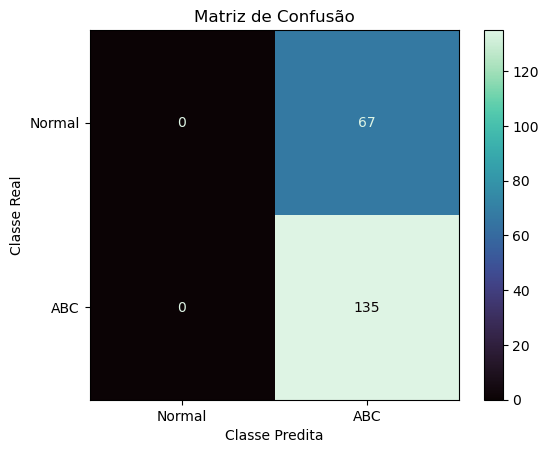

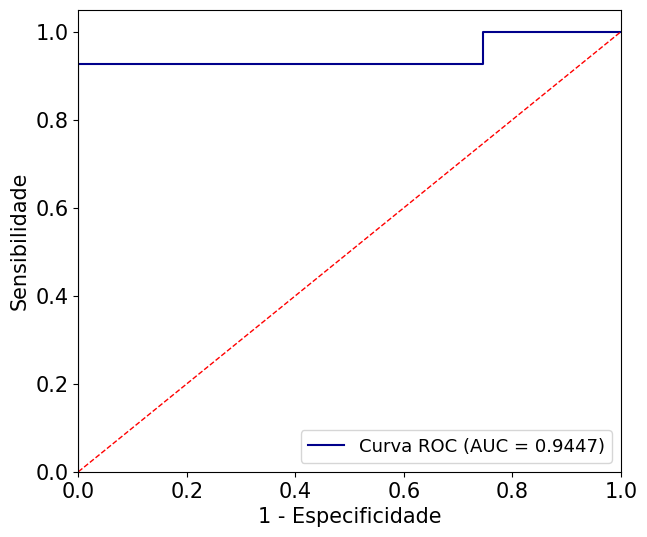

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9488987373801235
ROC AUC média (micro) de todas as iterações: 0.9431522687739871
Acurácia média de todas as iterações: 0.8370667134024766
Recall médio (macro) de todas as iterações: 0.8930349441395554
Recall médio (micro) de todas as iterações: 0.9165766690300517
Especificidade média (macro) de todas as iterações: 0.7060025369938608
Especificidade média (micro) de todas as iterações: 0.7065232786646023
 
############################################################
Tempo de execução Total: 94.8317 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [LogisticRegression]
param_grid_rl = {
    'C': np.array([0.001, 0.01, 0.1, 1, 10, 100, 1000], dtype=np.float32),
    # 'penalty': ['l1', 'l2', 'elasticnet', None],
    # 'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
}
param_grids = [param_grid_rl]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### AdaBoost

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

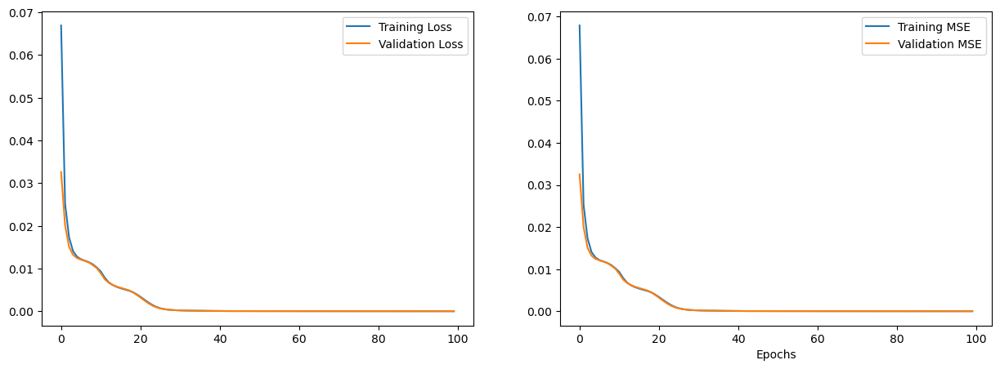

Tempo de execução Busca em grade: 6.30 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0210 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


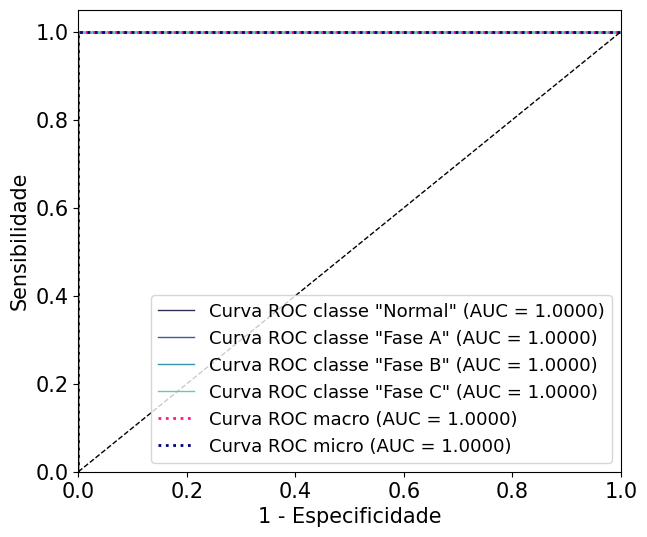

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

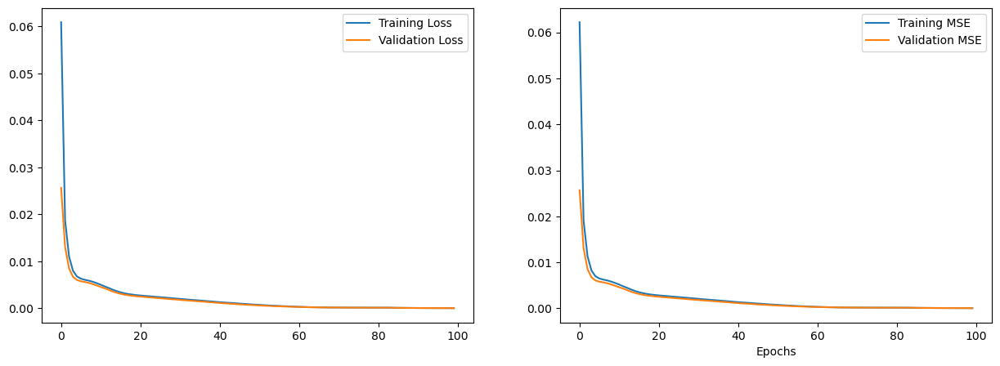

Tempo de execução Busca em grade: 5.92 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.2, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 0.9948217821424443
Tempo de Treinamento: 0.0383 segundos
Tempo de Previsão: 0.0019 segundos
Acurácia: 94.38202247%
Sensitivity (Recall) Macro:0.9448
Sensitivity (Recall) Micro: 0.9438
Especificidade (specificity) macro: 0.9814
Especificidade (specificity) micro: 0.9813
AUC: 0.9927
Matriz de Confusão
[[65  0  0  0]
 [14 54  0  0]
 [ 0  0 67  0]
 [ 1  0  0 66]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9257, F-score = 0.9614
Class 1: Sensitivity = 0.7941, Specificity = 1.0000, F-score = 0.8852
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9851, Specificity = 1.0000, F-score = 0.9925
Macro F-score: 0.9598


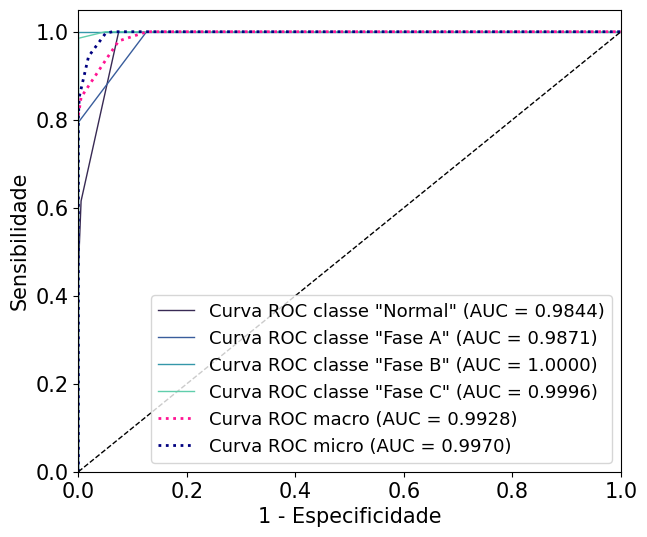

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

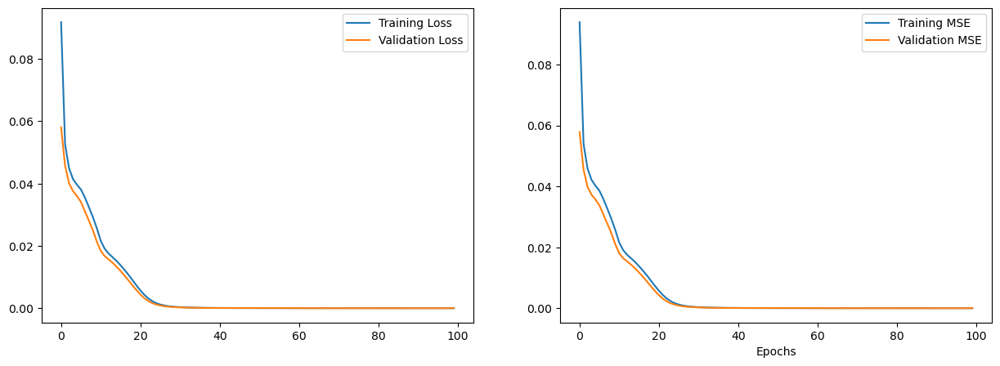

Tempo de execução Busca em grade: 5.92 segundos
Best parameters found: {'n_estimators': 150, 'learning_rate': 1.5, 'algorithm': 'SAMME', 'random_state': 42}
Best AUC ROC: 0.9952949288754482
Tempo de Treinamento: 0.1673 segundos
Tempo de Previsão: 0.0070 segundos
Acurácia: 97.00374532%
Sensitivity (Recall) Macro:0.9702
Sensitivity (Recall) Micro: 0.9700
Especificidade (specificity) macro: 0.9900
Especificidade (specificity) micro: 0.9900
AUC: 0.9819
Matriz de Confusão
[[65  0  0  0]
 [ 0 62  3  0]
 [ 0  1 67  1]
 [ 0  3  0 65]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9538, Specificity = 0.9802, F-score = 0.9668
Class 2: Sensitivity = 0.9710, Specificity = 0.9848, F-score = 0.9779
Class 3: Sensitivity = 0.9559, Specificity = 0.9950, F-score = 0.9750
Macro F-score: 0.9799


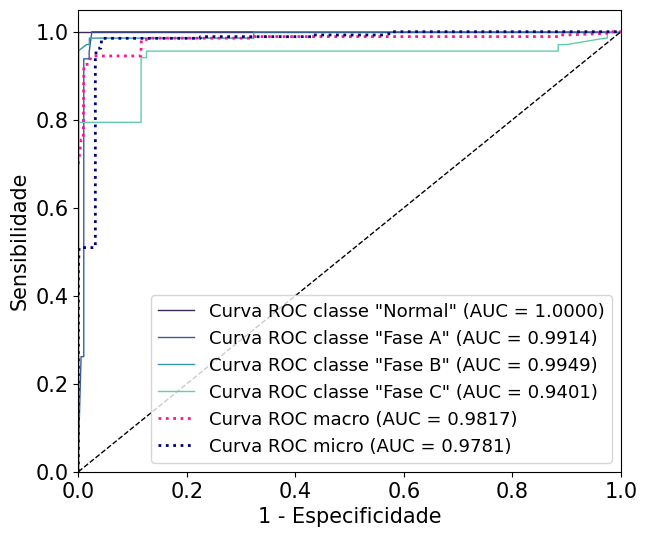

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

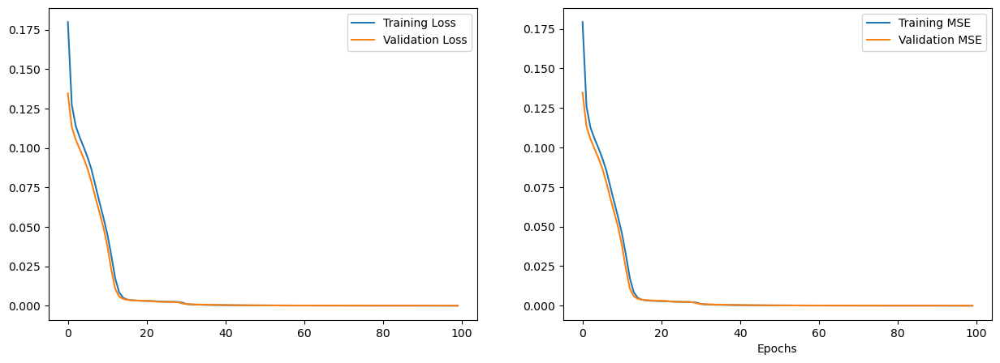

Tempo de execução Busca em grade: 5.93 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0291 segundos
Tempo de Previsão: 0.0030 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


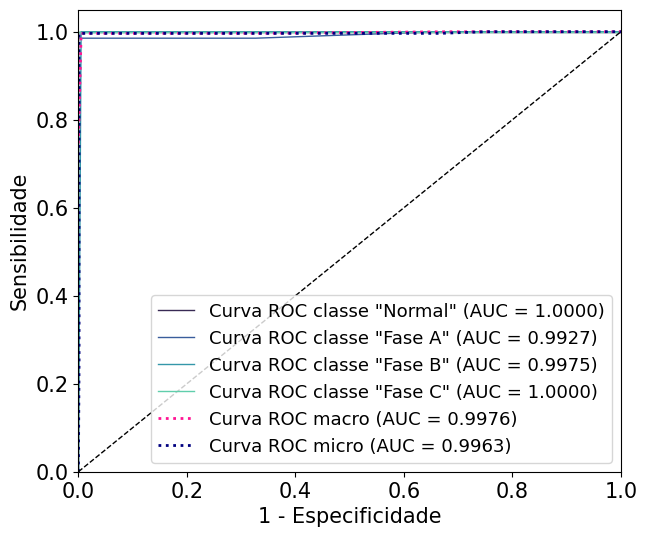

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

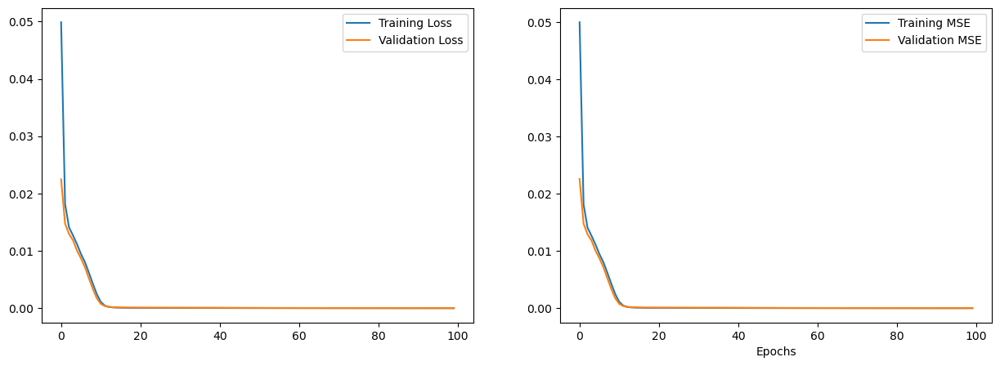

Tempo de execução Busca em grade: 7.23 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0270 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


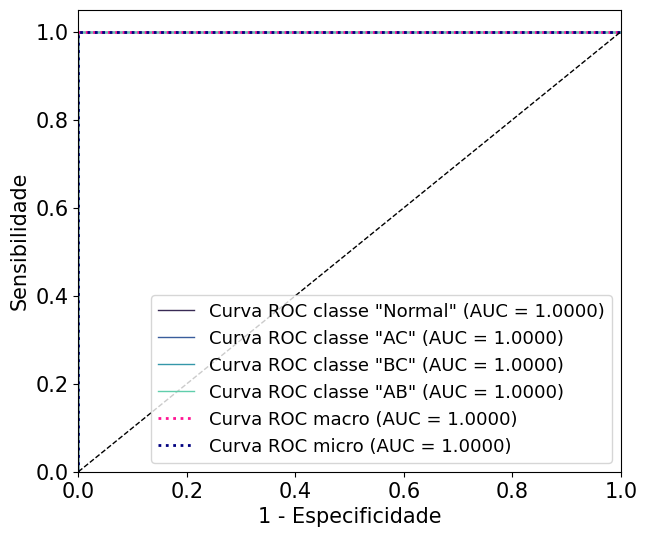

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

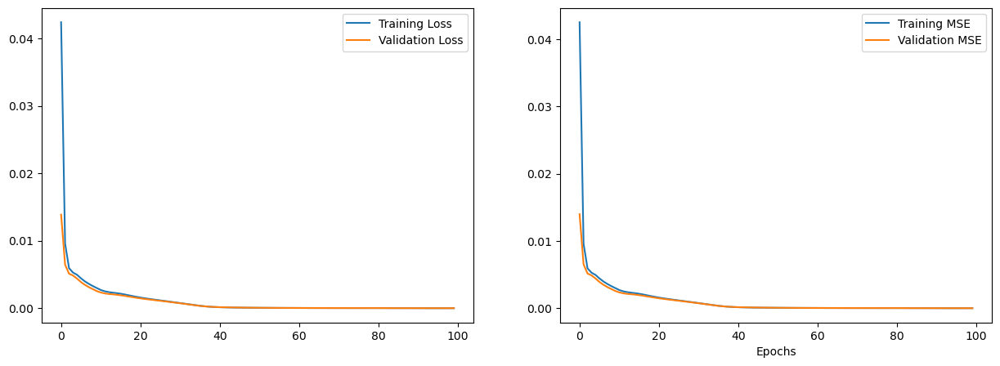

Tempo de execução Busca em grade: 7.35 segundos
Best parameters found: {'n_estimators': 200, 'learning_rate': 0.01, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 0.9985825226147806
Tempo de Treinamento: 0.2940 segundos
Tempo de Previsão: 0.0190 segundos
Acurácia: 99.57264957%
Sensitivity (Recall) Macro:0.9923
Sensitivity (Recall) Micro: 0.9957
Especificidade (specificity) macro: 0.9985
Especificidade (specificity) micro: 0.9986
AUC: 0.9999
Matriz de Confusão
[[ 63   2   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 0.9692, Specificity = 1.0000, F-score = 0.9844
Class 1: Sensitivity = 1.0000, Specificity = 0.9940, F-score = 0.9970
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9953


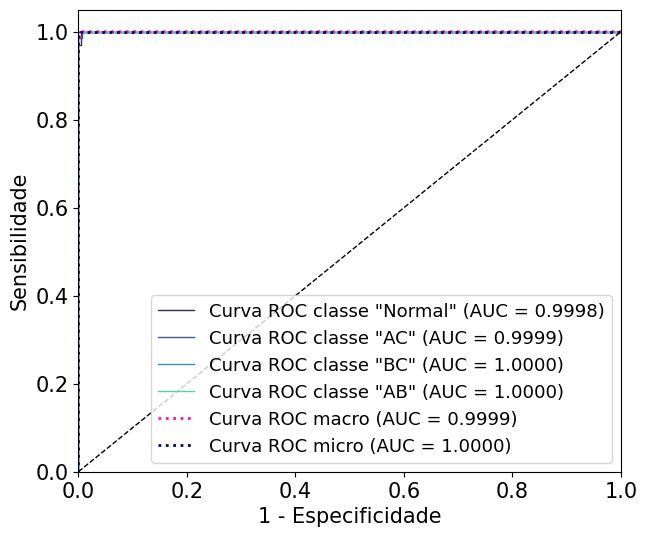

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

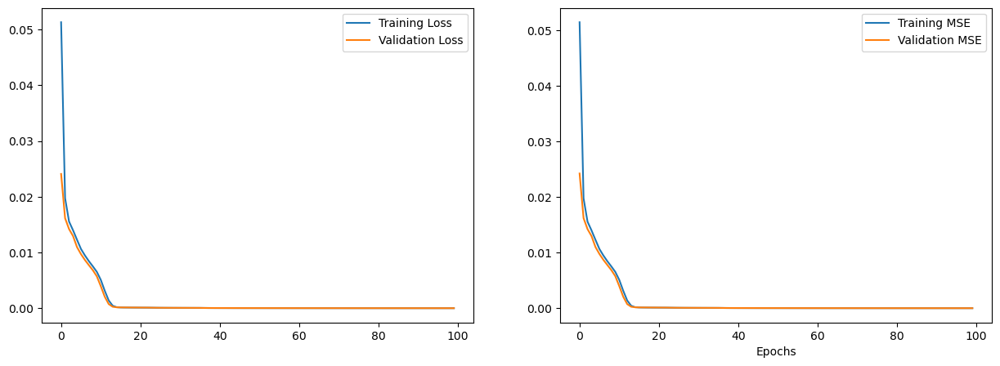

Tempo de execução Busca em grade: 7.21 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0270 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


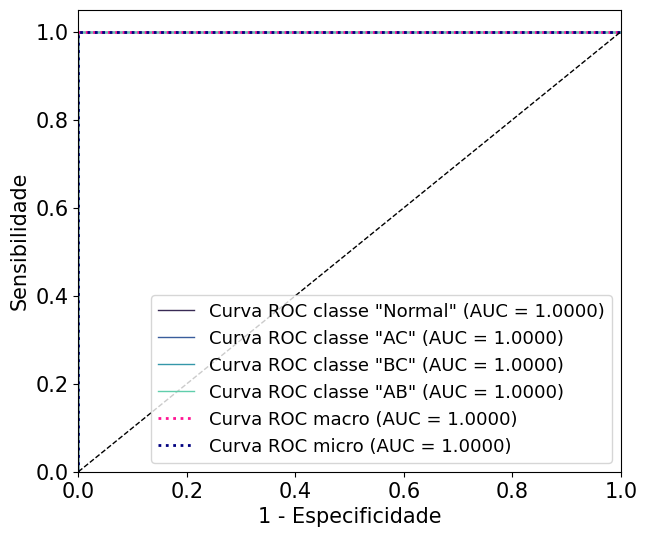

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

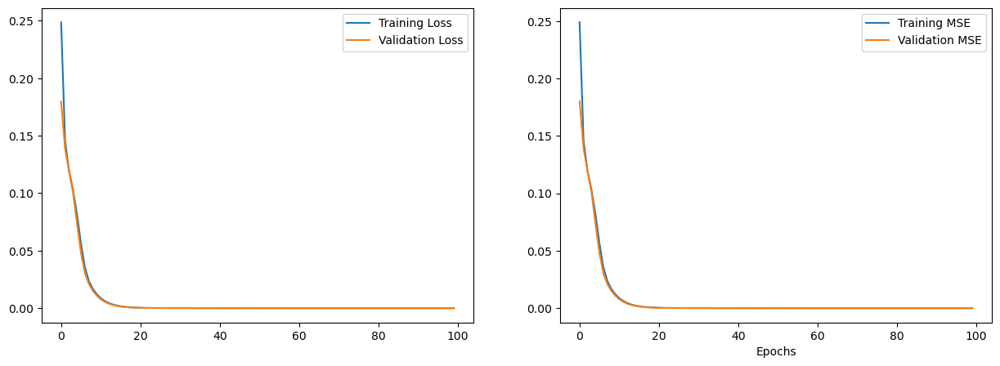

Tempo de execução Busca em grade: 6.45 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.0001, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0387 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


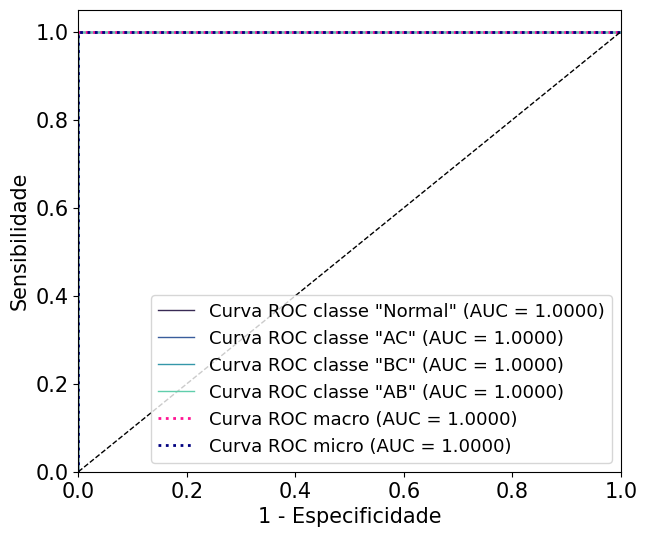

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

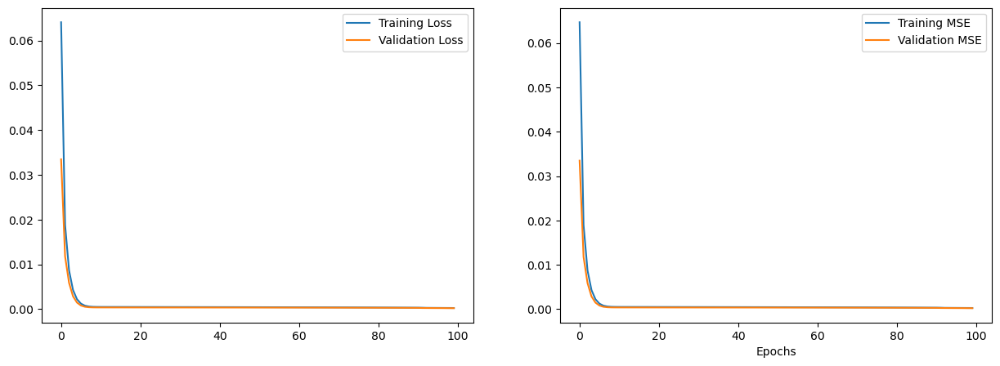

Tempo de execução Busca em grade: 5.30 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.8, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 0.9956989247311828
Tempo de Treinamento: 0.0221 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


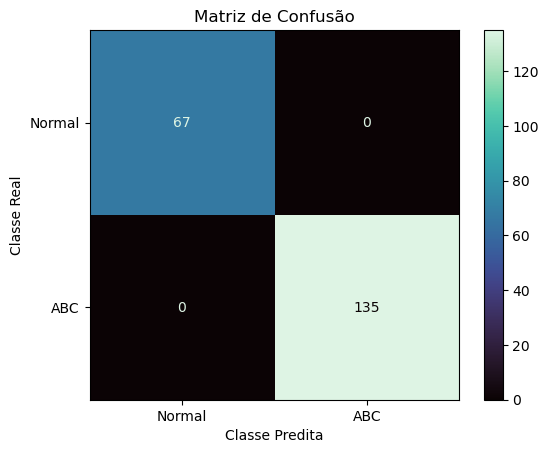

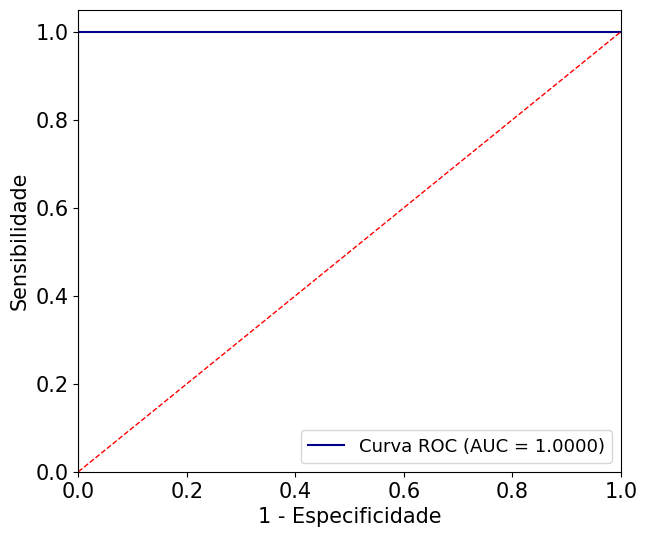

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

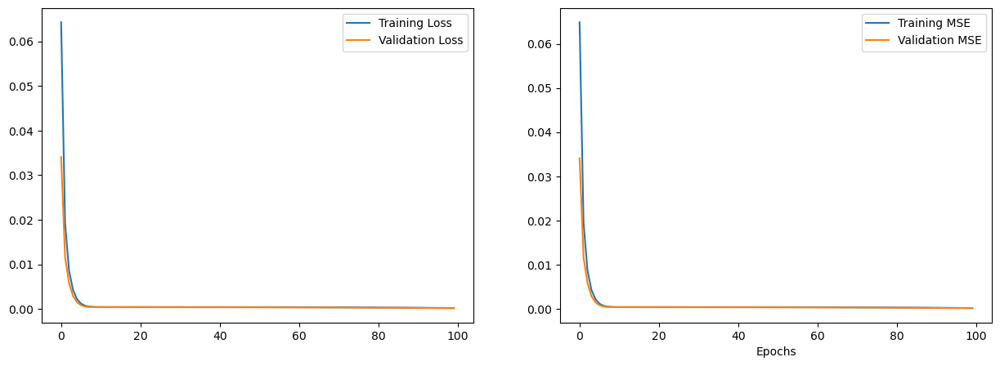

Tempo de execução Busca em grade: 5.38 segundos
Best parameters found: {'n_estimators': 150, 'learning_rate': 1.5, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 0.9966501856118791
Tempo de Treinamento: 0.1886 segundos
Tempo de Previsão: 0.0180 segundos
Acurácia = 0.9951
Precisão = 1.0000
Sensibilidade = 0.9926
Especificidade = 1.0000
F-score = 0.9963
Coeficiente de Correlação de Matthews = 0.9890
AUC = 1.0000
############################################################


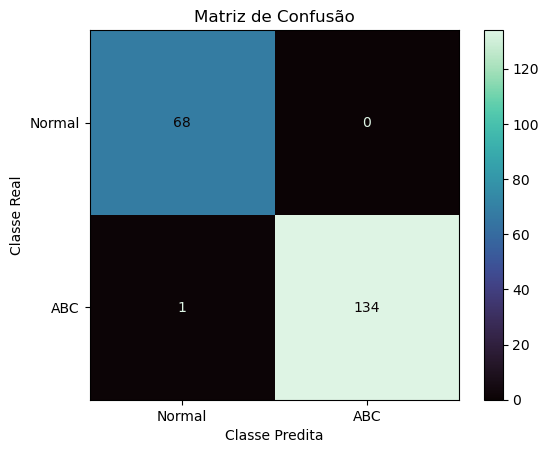

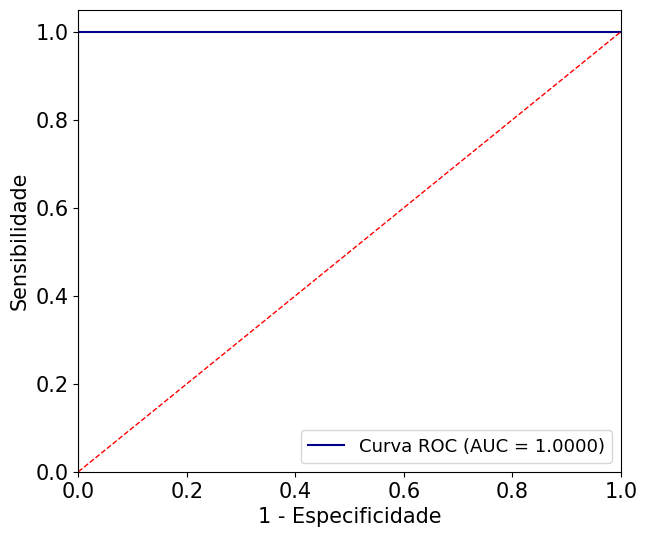

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

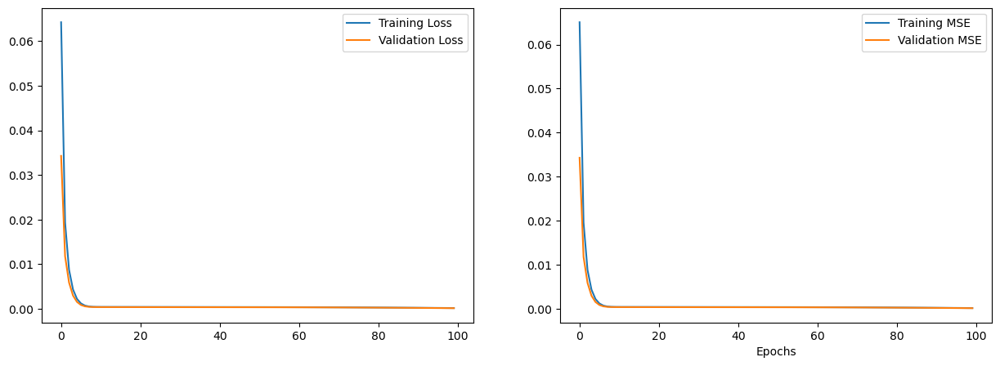

Tempo de execução Busca em grade: 5.31 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.1, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0010 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


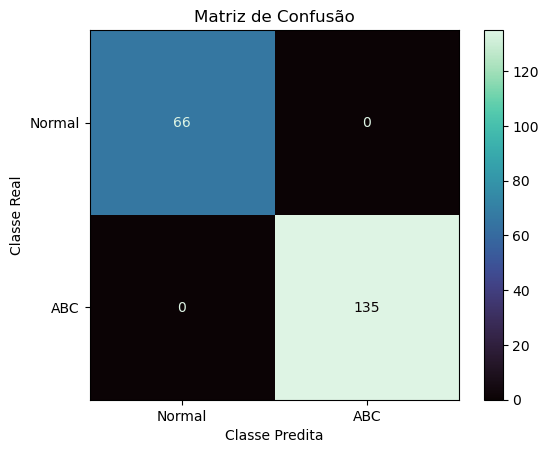

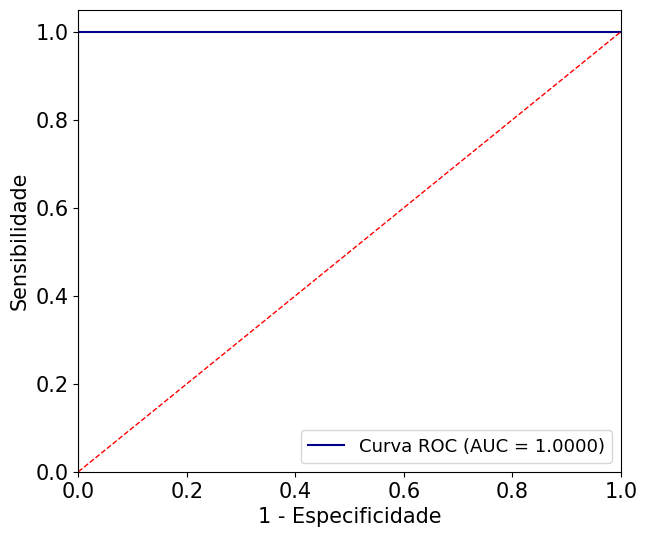

 
 
 
________________________________________
Model: <class 'sklearn.ensemble._weight_boosting.AdaBoostClassifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

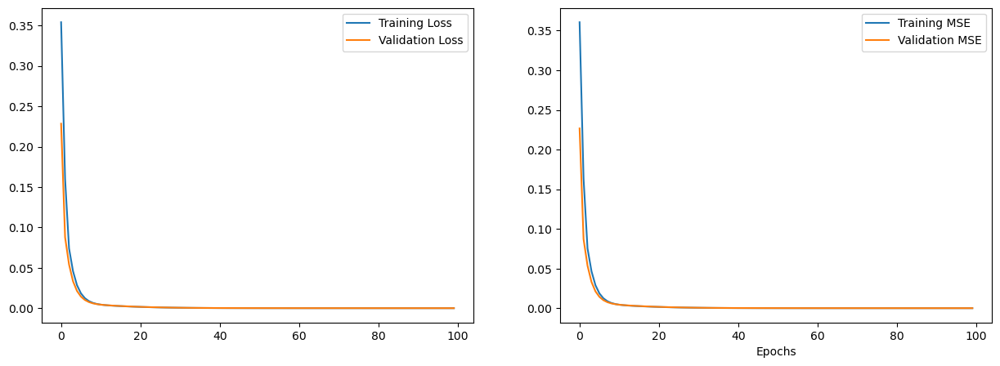

Tempo de execução Busca em grade: 5.25 segundos
Best parameters found: {'n_estimators': 20, 'learning_rate': 0.1, 'algorithm': 'SAMME.R', 'random_state': 42}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0321 segundos
Tempo de Previsão: 0.0020 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


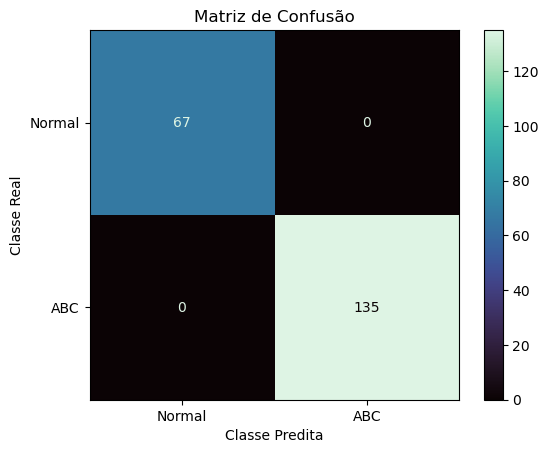

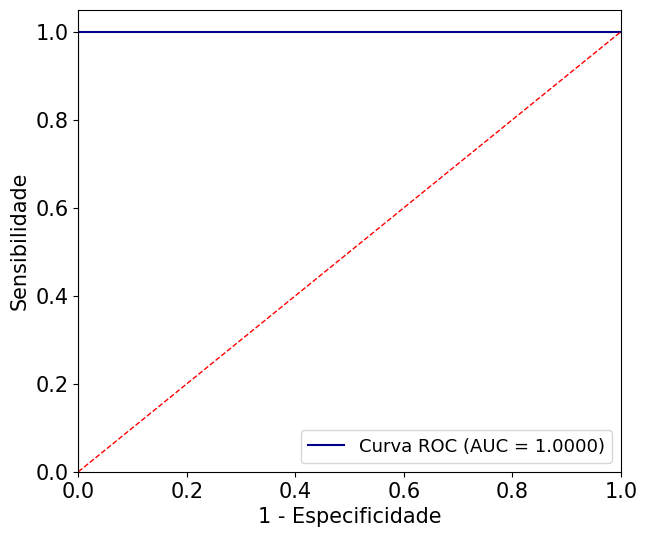

 
 
 
ROC AUC média (macro) de todas as iterações: 0.997661739221568
ROC AUC média (micro) de todas as iterações: 0.9976138184718616
Acurácia média de todas as iterações: 0.9917427289085561
Recall médio (macro) de todas as iterações: 0.9913506360565343
Recall médio (micro) de todas as iterações: 0.9915359539891374
Especificidade média (macro) de todas as iterações: 0.997390790568203
Especificidade média (micro) de todas as iterações: 0.9973844126465848
 
############################################################
Tempo de execução Total: 166.6572 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [AdaBoostClassifier]
param_grid_ab =  {
    'n_estimators': [20,30,50, 100, 150, 200],
    'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.2, 0.5, 0.8, 1.0, 1.5, 2.0, 3.0, 5.0],
    'algorithm': ['SAMME', 'SAMME.R'],
    'random_state': [42]
}
param_grids = [param_grid_ab]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### ART Fuzzy

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

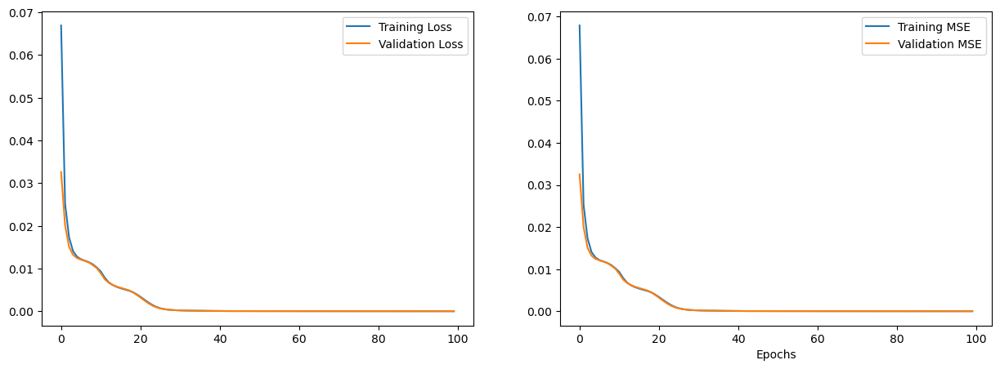

Tempo de execução Busca em grade: 316.43 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9250000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[65  0  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


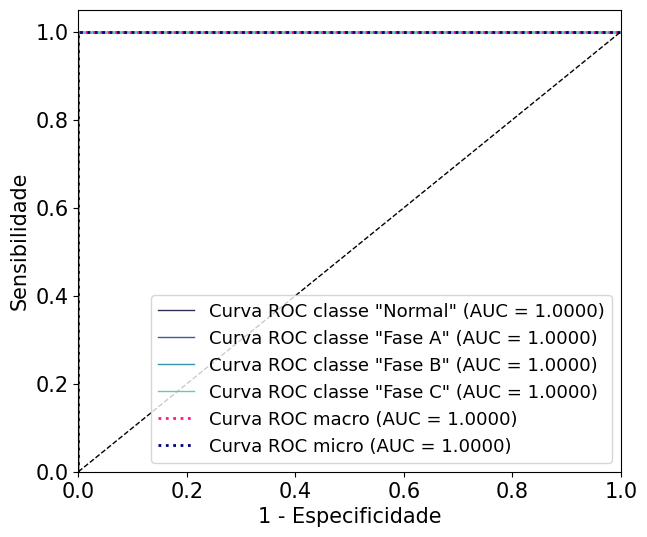

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

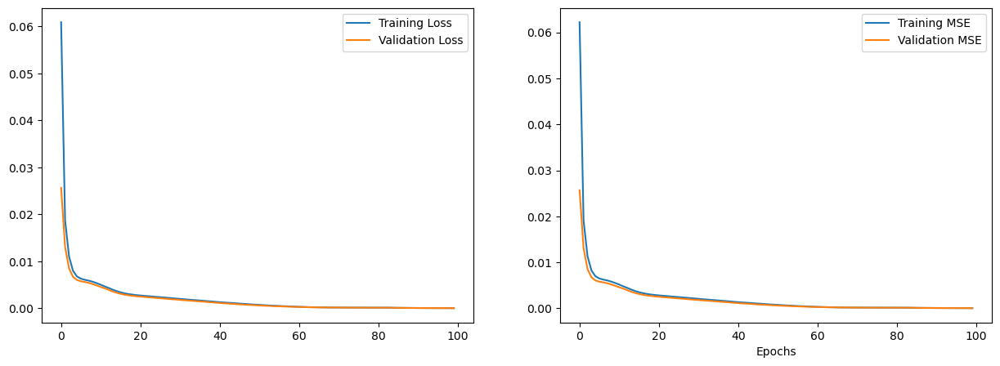

Tempo de execução Busca em grade: 293.49 segundos
Best parameters found: {'beta': 0.43999999999999984, 'rho': 0.9940000000000003}
Best AUC ROC: 0.9985053546652793
Tempo de Treinamento: 0.1000 segundos
Tempo de Previsão: 0.0200 segundos
Acurácia: 96.62921348%
Sensitivity (Recall) Macro:0.9656
Sensitivity (Recall) Micro: 0.9663
Especificidade (specificity) macro: 0.9887
Especificidade (specificity) micro: 0.9888
AUC: 0.9980
Matriz de Confusão
[[58  7  0  0]
 [ 0 68  0  0]
 [ 0  0 67  0]
 [ 2  0  0 65]]
Class 0: Sensitivity = 0.8923, Specificity = 0.9901, F-score = 0.9387
Class 1: Sensitivity = 1.0000, Specificity = 0.9648, F-score = 0.9821
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9701, Specificity = 1.0000, F-score = 0.9848
Macro F-score: 0.9764


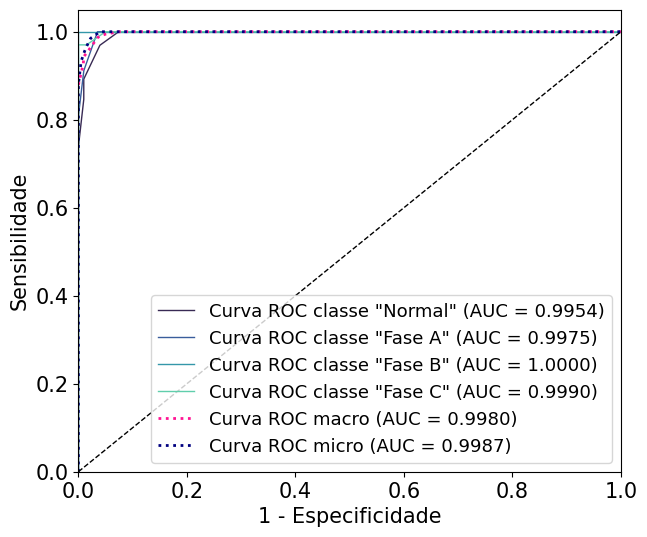

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

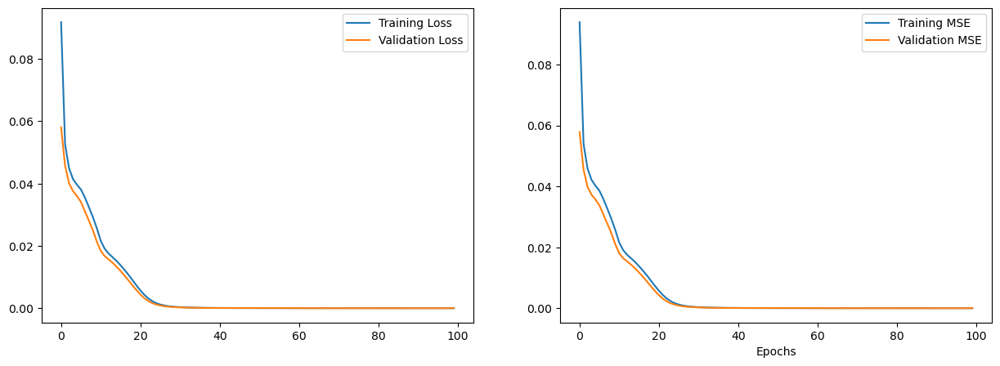

Tempo de execução Busca em grade: 348.29 segundos
Best parameters found: {'beta': 0.14999999999999997, 'rho': 0.9860000000000003}
Best AUC ROC: 0.9981036136312724
Tempo de Treinamento: 0.0700 segundos
Tempo de Previsão: 0.0200 segundos
Acurácia: 96.62921348%
Sensitivity (Recall) Macro:0.9671
Sensitivity (Recall) Micro: 0.9663
Especificidade (specificity) macro: 0.9888
Especificidade (specificity) micro: 0.9888
AUC: 0.9978
Matriz de Confusão
[[65  0  0  0]
 [ 0 65  0  0]
 [ 0  2 66  1]
 [ 0  3  3 62]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 0.9752, F-score = 0.9875
Class 2: Sensitivity = 0.9565, Specificity = 0.9848, F-score = 0.9705
Class 3: Sensitivity = 0.9118, Specificity = 0.9950, F-score = 0.9516
Macro F-score: 0.9774


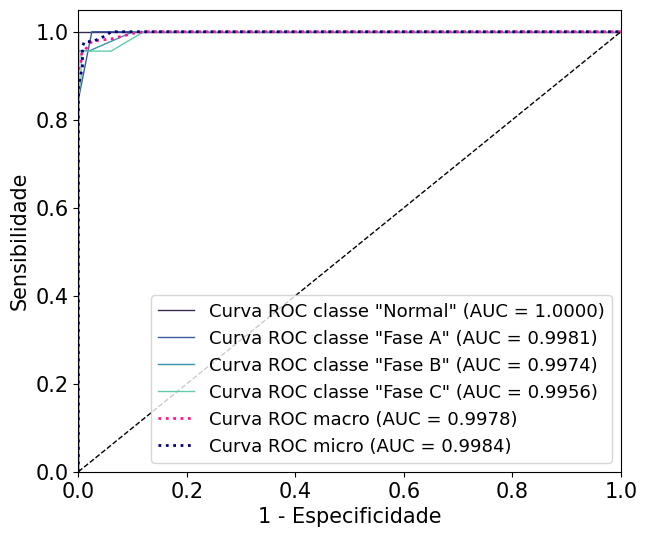

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

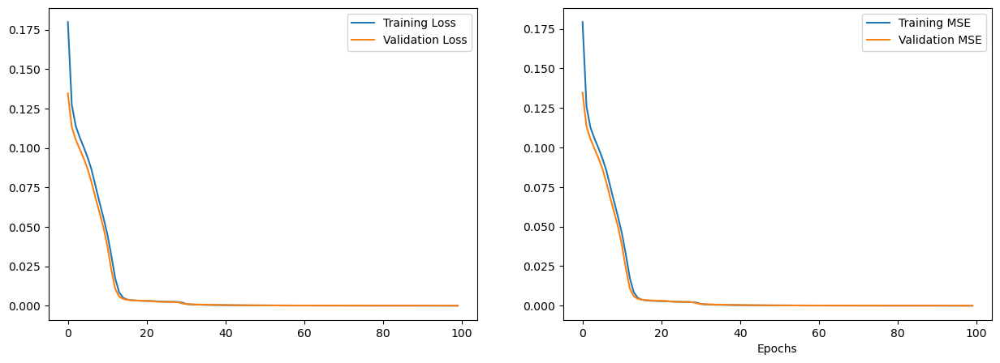

Tempo de execução Busca em grade: 322.77 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9280000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0200 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 99.62546816%
Sensitivity (Recall) Macro:0.9963
Sensitivity (Recall) Micro: 0.9963
Especificidade (specificity) macro: 0.9988
Especificidade (specificity) micro: 0.9988
AUC: 0.9975
Matriz de Confusão
[[65  0  0  0]
 [ 0 67  1  0]
 [ 0  0 67  0]
 [ 0  0  0 67]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 0.9853, Specificity = 1.0000, F-score = 0.9926
Class 2: Sensitivity = 1.0000, Specificity = 0.9950, F-score = 0.9975
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 0.9975


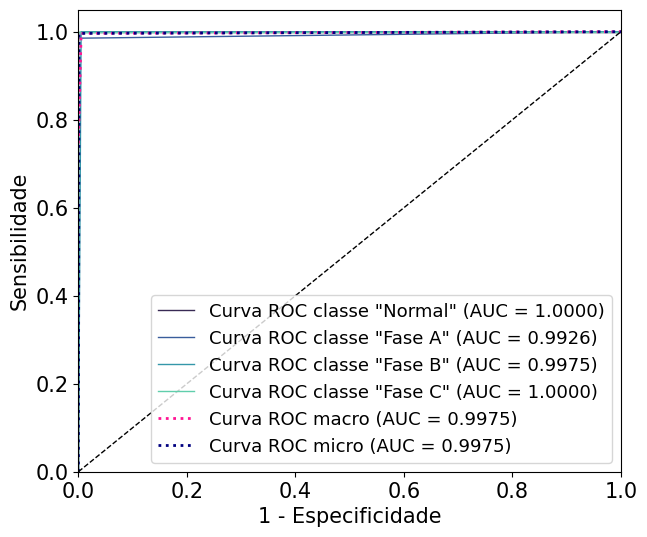

 
 
 
Curto-Bifásico
Total iterations: 12
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

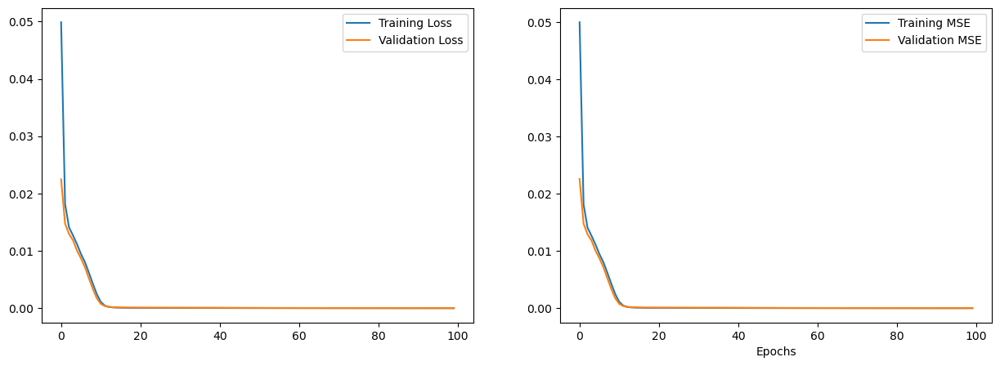

Tempo de execução Busca em grade: 553.22 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9230000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0600 segundos
Tempo de Previsão: 0.0200 segundos
Acurácia: 99.78632479%
Sensitivity (Recall) Macro:0.9981
Sensitivity (Recall) Micro: 0.9979
Especificidade (specificity) macro: 0.9994
Especificidade (specificity) micro: 0.9993
AUC: 0.9994
Matriz de Confusão
[[ 65   0   0   0]
 [  0 134   0   0]
 [  0   0 134   0]
 [  1   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 0.9975, F-score = 0.9988
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 0.9926, Specificity = 1.0000, F-score = 0.9963
Macro F-score: 0.9988


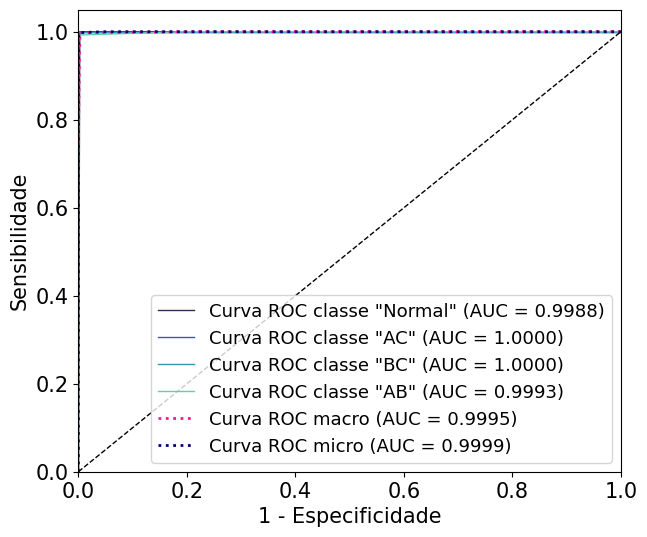

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

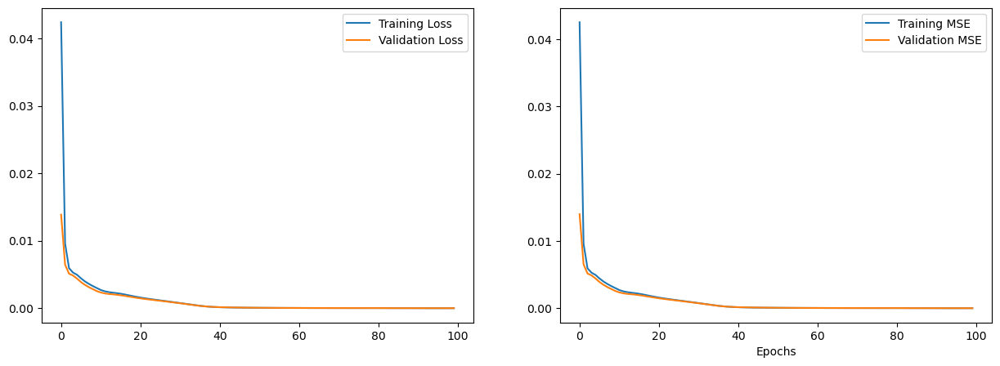

Tempo de execução Busca em grade: 466.38 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9920000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.2540 segundos
Tempo de Previsão: 0.0597 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


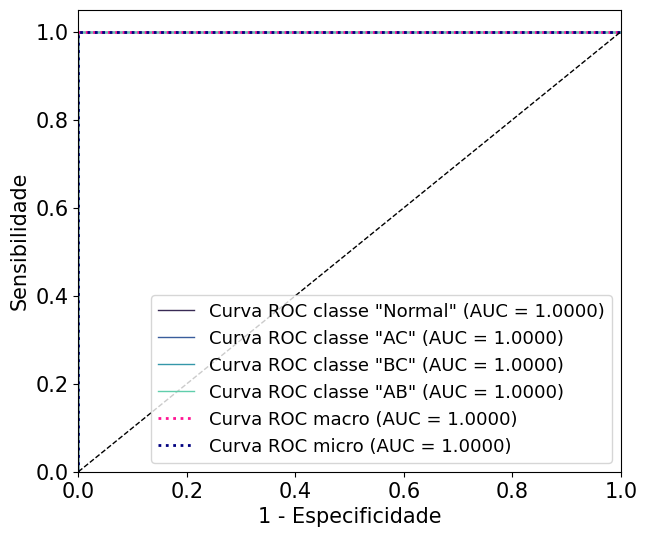

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

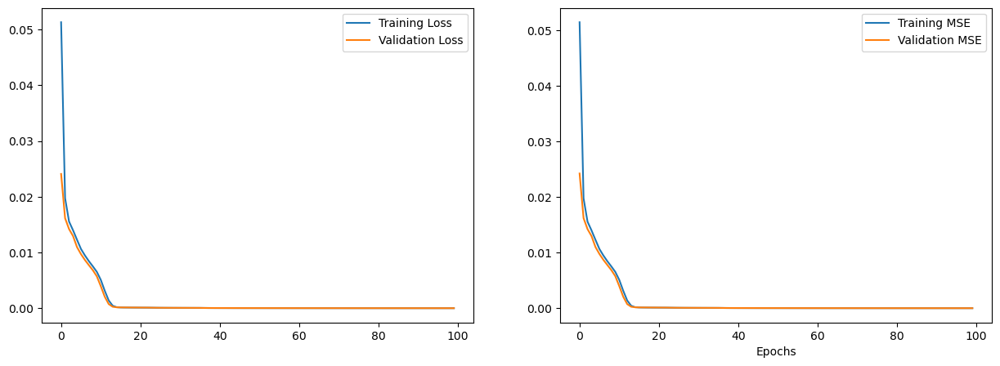

Tempo de execução Busca em grade: 471.87 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.8700000000000002}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0402 segundos
Tempo de Previsão: 0.0200 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 135   0   0]
 [  0   0 134   0]
 [  0   0   0 134]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


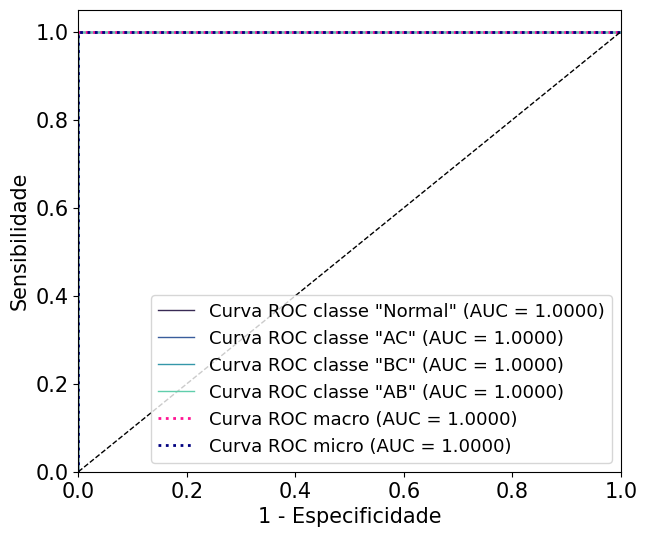

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset Sem GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

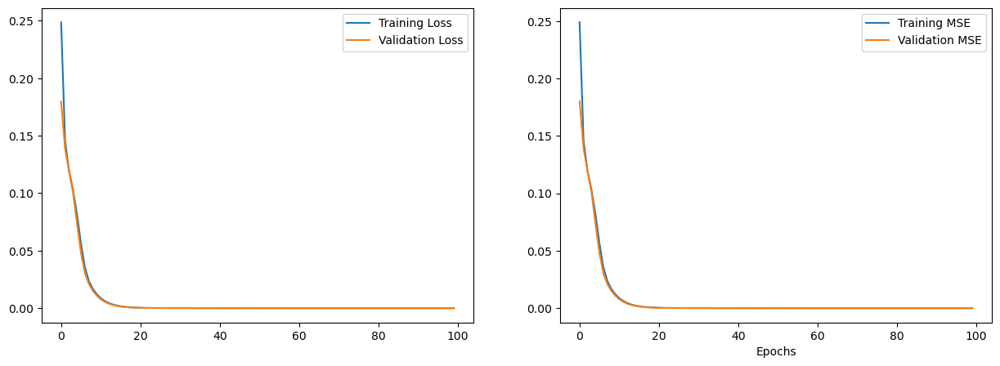

Tempo de execução Busca em grade: 465.90 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.8080000000000002}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0499 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia: 100.00000000%
Sensitivity (Recall) Macro:1.0000
Sensitivity (Recall) Micro: 1.0000
Especificidade (specificity) macro: 1.0000
Especificidade (specificity) micro: 1.0000
AUC: 1.0000
Matriz de Confusão
[[ 65   0   0   0]
 [  0 136   0   0]
 [  0   0 134   0]
 [  0   0   0 135]]
Class 0: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 1: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 2: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Class 3: Sensitivity = 1.0000, Specificity = 1.0000, F-score = 1.0000
Macro F-score: 1.0000


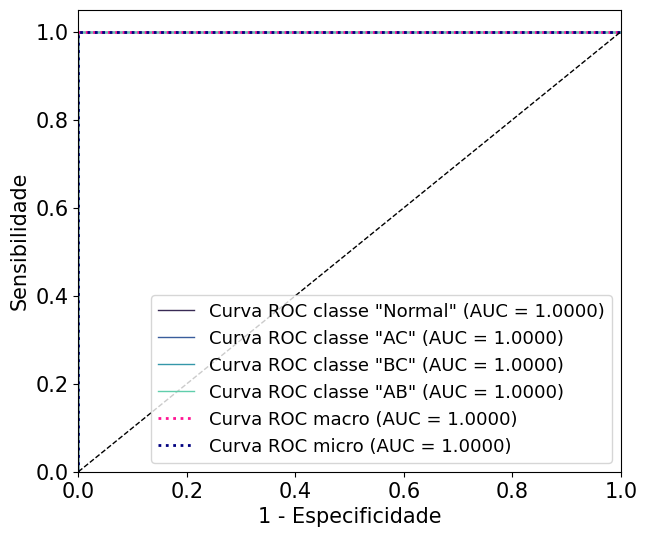

 
 
 
Curto-Trifásico
Total iterations: 12
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

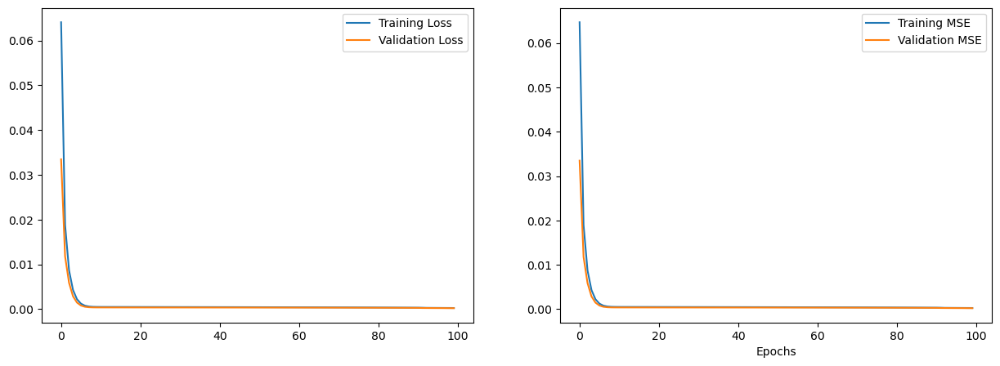

Tempo de execução Busca em grade: 147.95 segundos
Best parameters found: {'beta': 0.13, 'rho': 0.9980000000000003}
Best AUC ROC: 0.9881720430107528
Tempo de Treinamento: 0.0399 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia = 0.9851
Precisão = 0.9783
Sensibilidade = 1.0000
Especificidade = 0.9552
F-score = 0.9890
Coeficiente de Correlação de Matthews = 0.9667
AUC = 0.9949
############################################################


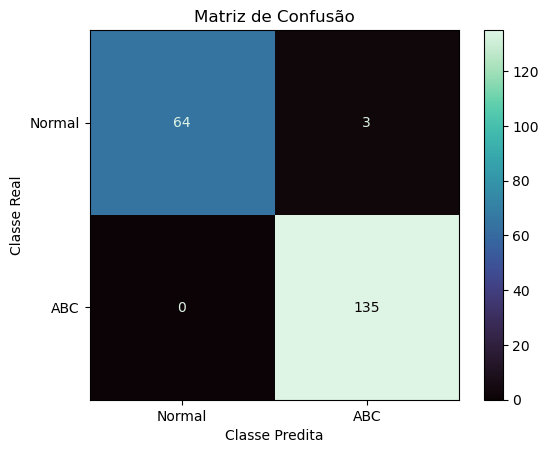

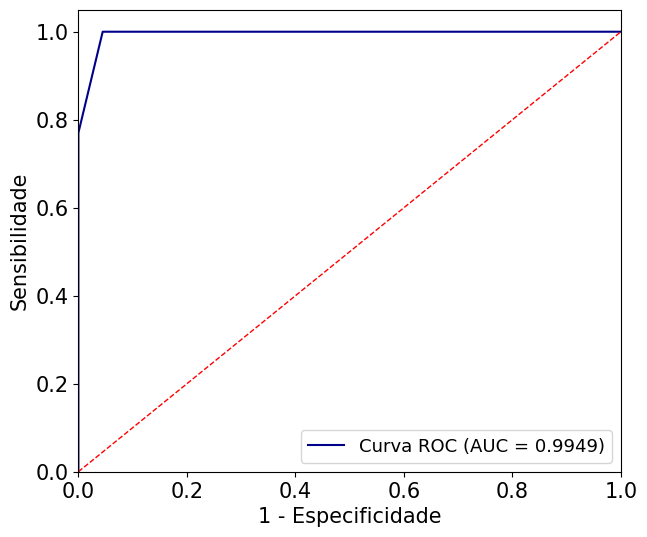

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset 3PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

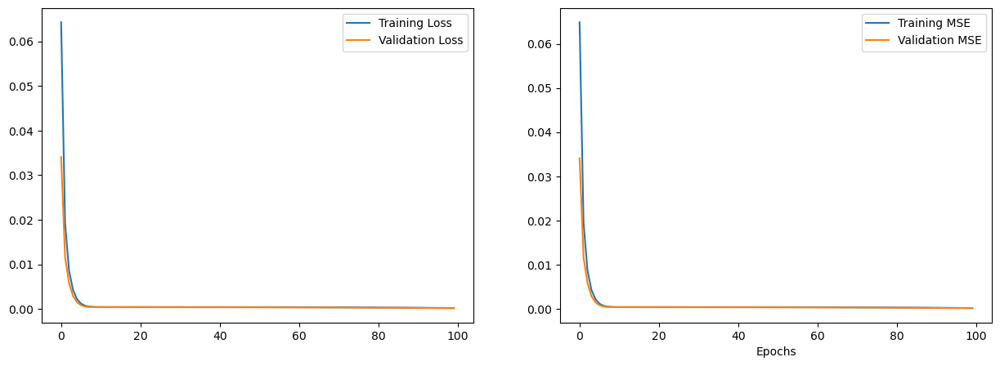

Tempo de execução Busca em grade: 144.86 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9980000000000003}
Best AUC ROC: 0.9935875896057349
Tempo de Treinamento: 0.0196 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


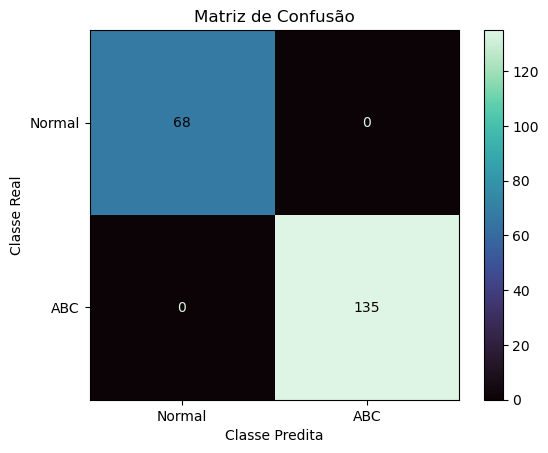

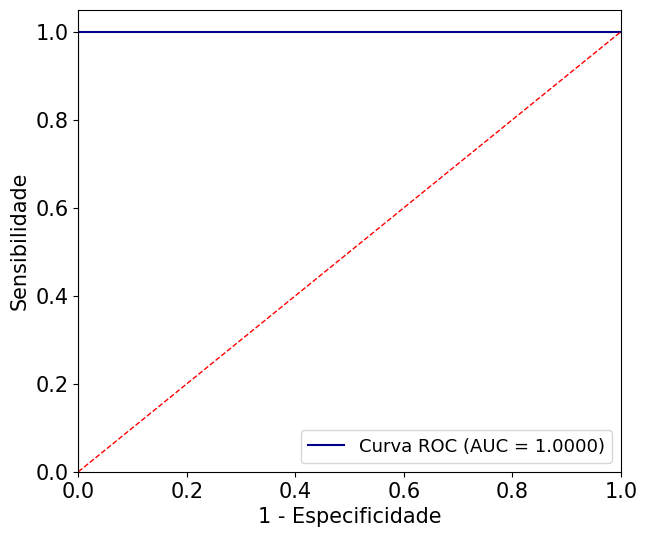

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

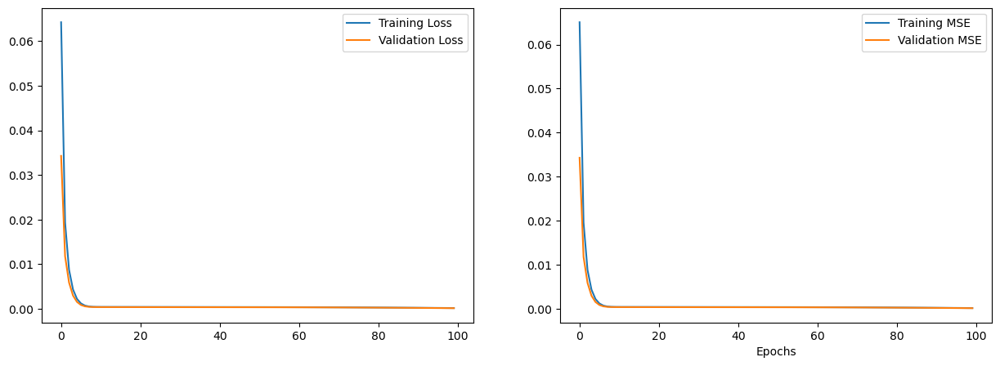

Tempo de execução Busca em grade: 144.91 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9980000000000003}
Best AUC ROC: 1.0
Tempo de Treinamento: 0.0300 segundos
Tempo de Previsão: 0.0100 segundos
Acurácia = 1.0000
Precisão = 1.0000
Sensibilidade = 1.0000
Especificidade = 1.0000
F-score = 1.0000
Coeficiente de Correlação de Matthews = 1.0000
AUC = 1.0000
############################################################


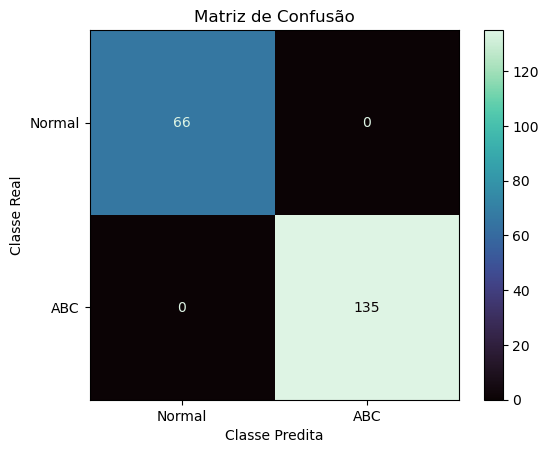

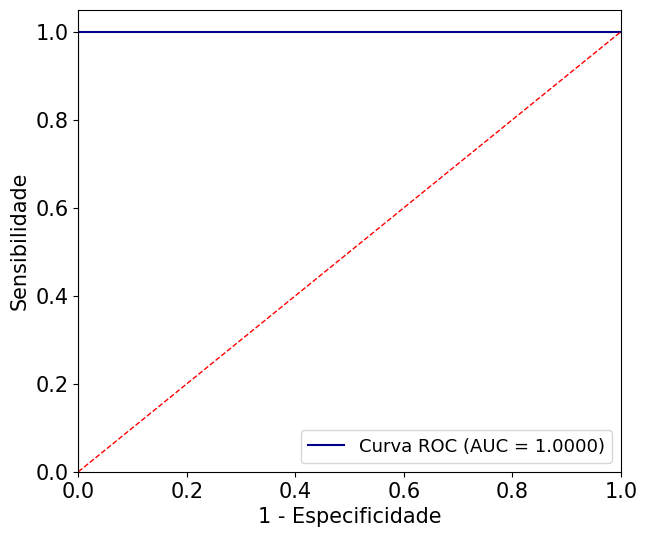

 
 
 
________________________________________
Model: <class '__main__.ART_Fuzzy_AE_Classifier'> - Dataset SEM GD:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

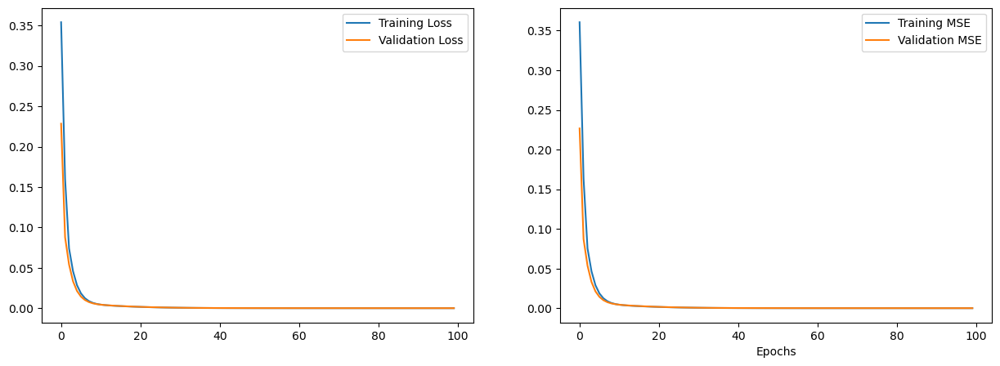

Tempo de execução Busca em grade: 150.75 segundos
Best parameters found: {'beta': 0.1, 'rho': 0.9800000000000003}
Best AUC ROC: 0.8857142857142858
Tempo de Treinamento: 0.0201 segundos
Tempo de Previsão: 0.0000 segundos
Acurácia = 0.8020
Precisão = 1.0000
Sensibilidade = 0.7037
Especificidade = 1.0000
F-score = 0.8261
Coeficiente de Correlação de Matthews = 0.6638
AUC = 0.8541
############################################################


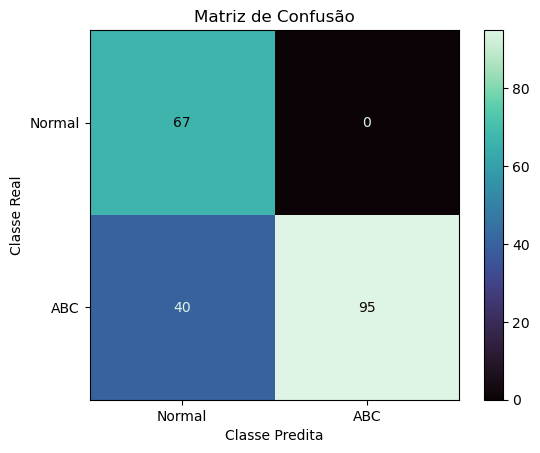

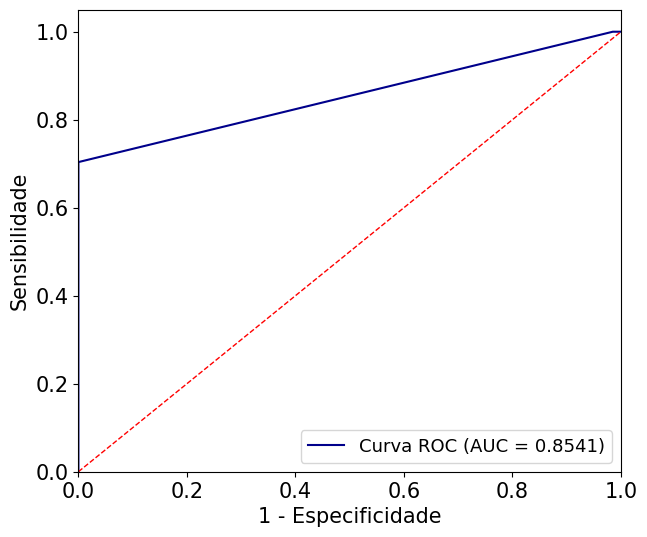

 
 
 
ROC AUC média (macro) de todas as iterações: 0.9868071707390337
ROC AUC média (micro) de todas as iterações: 0.9869519496660945
Acurácia média de todas as iterações: 0.9761525760037829
Recall médio (macro) de todas as iterações: 0.9692384357522145
Recall médio (micro) de todas as iterações: 0.9692004919064844
Especificidade média (macro) de todas as iterações: 0.9942376697351399
Especificidade média (micro) de todas as iterações: 0.9942326066934765
 
############################################################
Tempo de execução Total: 3918.2705 segundos


In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [ART_Fuzzy_AE_Classifier]
param_grid_art_fuzzy = {
    'beta': np.arange(0.1, 0.5, 0.01),
    'rho': np.arange(0.6, 0.999, 0.001)
}
param_grids = [param_grid_art_fuzzy]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)

### ART Euclidiana

Curto-Monofásico
Total iterations: 12
________________________________________
Model: <class '__main__.ART_Minkowski_AE_Classifier'> - Dataset 2PV:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 3)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 6)                   │              24 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │              56 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │              54 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 155 (620.00 B)

 Trainable params: 155 (620.00 B)

 Non-trainable params: 0 (0.00 B)

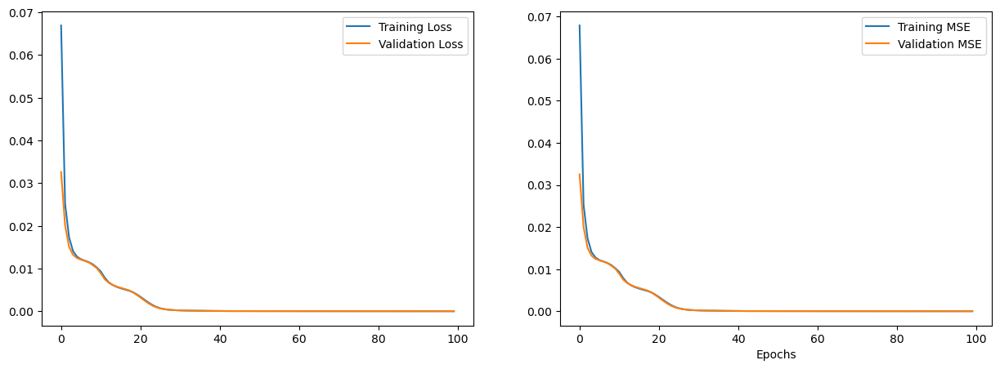

In [ ]:
autoencoder_params = {
    'latent_dim': 8,
    'encoder_layers': [6],
    'decoder_layers': [6],
    'activation': 'relu',
    'optimizer': 'adam',
    'loss': 'mse',
    'metrics': 'mse',
    'epochs': 100,
    'batch_size': 16,
    'verbose' : 0
}

modelos = [ART_Minkowski_AE_Classifier]
param_grid_art_eu = {
    'beta': np.arange(0.1, 0.5, 0.01),
    'rho': np.arange(0.0001, 0.1, 0.0001)
}
param_grids = [param_grid_art_eu]

file_paths = 'D:/Artigo Andreia/Banco de dados-V3.xlsx'
# file_paths = '/content/Banco de dados-V3.xlsx'
file_path_Normal = 'D:/Artigo Andreia/Sistema normal.xlsx'
# file_path_Normal = '/content/Sistema normal.xlsx'
columns = ['Curto', 'Tipo de GD', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
columns_to_open_normal = ['Curto', 'Med_A', 'Med_B', 'Med_C', 'FASE A', 'FASE B', 'FASE C']
sheet_names = ['Curto-Monofásico', 'Curto-Bifásico', 'Curto-Trifásico']

test_models_scenarios_phases_autoencoder(modelos, param_grids, file_paths, file_path_Normal, columns, columns_to_open_normal,
                           sheet_names, autoencoder_params)